# **Importing Libraries**

In [ ]:
from __future__ import print_function, division
from keras.datasets import mnist
from keras.layers import Input, Dense, Reshape, Flatten, Dropout, multiply, Concatenate
from keras.layers import BatchNormalization, Activation, Embedding, ZeroPadding2D, Conv2DTranspose
from keras.layers.advanced_activations import LeakyReLU
from keras.layers.convolutional import UpSampling2D, Conv2D
from keras.models import Sequential, Model
from keras.optimizers import Adam
from keras.models import load_model
from keras.applications.resnet50 import ResNet50
from keras.callbacks import EarlyStopping
import pickle
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from numpy import asarray
import cv2
import os
from google.colab import files
import pickle
import random
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix, plot_confusion_matrix

# **Task 1: Create Synthetic Covid-19 X-Ray Images with Conditional Generative Adversarial Networks**

## Subtask 1.1 - Building and training a cGAN


I have split this subtask into 3 different tasks; data preprocessing, building and training the cGAN model, and generating synthetic images. In each section below there is a short description/explanation of the code that was implemented for it.

### 1.1.1 - Data Preprocessing



In this section of Subtask 1.1, I upload the dataset .zip file 'DMV_Assess_1_Covid-19_Dataset' file to Google Colab. Then, I unzip the dataset file and loop through the images of each class directory. Each image is preprocessed and then added to a dictionary (data) containing the preprocessed image (X_train) and their label (y_train). The data in this dictionary will be used to train the cGAN model. Preprocessing includes;

*   Resizing images to a size of (128 x 128)
*   Normalizing images from [0, 255] to [-1, 1]
*   Expand images to 3D to include channel

#### Uploading the dataset

In [ ]:
# upload the dataset .zip file and then unzip the file - this may take a while
print("Please upload the dataset file named 'CS551G_DMV_Assessment_1_Dataset.zip'.\n")
files.upload()
!unzip /content/CS551G_DMV_Assessment_1_Dataset.zip

Please upload the dataset file named 'CS551G_DMV_Assessment_1_Dataset.zip'.



Saving CS551G_DMV_Assessment_1_Dataset.zip to CS551G_DMV_Assessment_1_Dataset.zip
Uploading dataset... WARNING! This may take a while...

Archive:  /content/CS551G_DMV_Assessment_1_Dataset.zip
   creating: DMV_Assess_1_Covid-19_Dataset/
   creating: DMV_Assess_1_Covid-19_Dataset/Covid-19/
  inflating: DMV_Assess_1_Covid-19_Dataset/Covid-19/03BF7561-A9BA-4C3C-B8A0-D3E585F73F3C.jpeg  
  inflating: DMV_Assess_1_Covid-19_Dataset/Covid-19/1-s2.0-S1684118220300608-main.pdf-001.jpg  
  inflating: DMV_Assess_1_Covid-19_Dataset/Covid-19/1-s2.0-S1684118220300608-main.pdf-002.jpg  
  inflating: DMV_Assess_1_Covid-19_Dataset/Covid-19/1-s2.0-S1684118220300682-main.pdf-002-a1.png  
  inflating: DMV_Assess_1_Covid-19_Dataset/Covid-19/1-s2.0-S1684118220300682-main.pdf-002-a2.png  
  inflating: DMV_Assess_1_Covid-19_Dataset/Covid-19/1-s2.0-S1684118220300682-main.pdf-003-b1.png  
  inflating: DMV_Assess_1_Covid-19_Dataset/Covid-19/1-s2.0-S1684118220300682-main.pdf-003-b2.png  
  inflating: DMV_Assess_1_

#### Preprocessing the dataset

In [ ]:
# directory paths of images for both classes
xray_covid_path = 'DMV_Assess_1_Covid-19_Dataset/Covid-19'
xray_normal_path = 'DMV_Assess_1_Covid-19_Dataset/Normal'

# preprocesses all images in a given directory and returns the preprocessed images
def preprocess_images(path):
  prep_imgs = []  # preprocessed images
  width, height = 128, 128

  for filename in os.listdir(path):
      img = cv2.imread(path + '/' + filename, 0) # read grayscale image
      # resize image to size (128 x 128)
      img = cv2.resize(img, (width, height), interpolation=cv2.INTER_NEAREST)
      # normalize image between range -1 - 1
      img = (img.astype(np.float32) - 127.5) / 127.5
      # add a channel - from shape (128 x 128) to (128 x 128 x 1)
      img = img.reshape(width, height, 1)

      # add image to list of preprocessed images
      prep_imgs.append(img)
  return np.array(prep_imgs)

# get preprocessed images and assign them their correct class labels
xray_covid_imgs = preprocess_images(xray_covid_path)
xray_covid_lbls = np.full(shape=len(xray_covid_imgs), fill_value=1, dtype=np.int)
xray_normal_imgs = preprocess_images(xray_normal_path)
xray_normal_lbls = np.full(shape=len(xray_normal_imgs), fill_value=0, dtype=np.int)

# saving data to a dictionary
data = {
    'X_train': np.concatenate((xray_covid_imgs, xray_normal_imgs)),
    'y_train': np.concatenate((xray_covid_lbls, xray_normal_lbls))
}
# save to .pkl file
pickle.dump(data, open("preprocessed_data.pkl", "wb"))

print("A total of {} images and labels were preprocessed from the dataset.".format(len(data['X_train'])))

A total of 200 images and labels were preprocessed from the dataset.


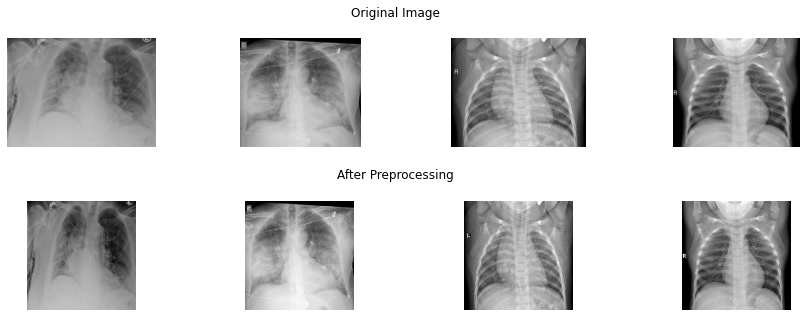

In [ ]:
# visualizing four random images before and after preprocessing
xray_covid_filenames = os.listdir(xray_covid_path)
xray_normal_filenames = os.listdir(xray_normal_path)

fig = plt.figure(figsize=(15,5))

# plot two random covid x-ray images
for x in range(2):
    index = random.randint(0, 99)
    before_img = cv2.imread(xray_covid_path + '/' + xray_covid_filenames[index], 1)
    after_img = data['X_train'][index].reshape((128,128))
    plt.subplot(2, 4, 1 + x)
    plt.axis('off')
    plt.imshow(before_img)
    plt.subplot(2, 4, 5 + x)
    plt.axis('off')
    plt.imshow(after_img, cmap="gray")

# plot two random normal x-ray images
for x in range(2,4):
    index = random.randint(0, 99)
    before_img = cv2.imread(xray_normal_path + '/' + xray_normal_filenames[index], 1)
    after_img = data['X_train'][100+index].reshape((128,128))
    plt.subplot(2, 4, 1 + x)
    plt.axis('off')
    plt.imshow(before_img)
    plt.subplot(2, 4, 5 + x)
    plt.axis('off')
    plt.imshow(after_img, cmap="gray")

plt.subplots_adjust(hspace=0.5)
plt.figtext(0.5, 0.5, 'After Preprocessing', ha='center', va='center', size='large')
plt.figtext(0.5, 0.95, 'Original Image', ha='center', va='center', size='large')

plt.show()

### 1.1.2 - Building and training the cGAN model

In this section of Subtask 1.1, I build the architecture of the cGAN model and train it. I modified the 'CGAN' class that was provided in 'cgan.py' to be used with this dataset. Experimentation was carried out to determine which type of layers to use in the generator and discriminator models so that clearer images were made. The generator and discriminator uses Conv2DTranspose and Conv2D respectively instead of dense layers, as these were determined to yield clearer (less grainy) results. You can specify what **learning rate** (lr) you want to use when initializing the 'CGAN' class, and specify which **batch size**, **epochs** and **model name** to use when training the CGAN object.

The 'train()' function was also altered so that half batches (batch_size/2) were used instead of the batch size when training the discriminator, and the full batch size is only used for training the generator. **At the end of the function when training is complete, the generator model is saved to a file (model_name) which will be loaded in the future to generate any amount of images.**

In the 'Training the cGAN model' section, I train the final cGAN model using the best determined parameters from which were determined from subtask 1.2 later. The model is trained using a learning rate of 0.0002 (default), 500 epochs and batch size of 32. It should be noted that sample images are printed out every 20 epochs in the to monitor the models progress. Also, it should be noted that 500 epochs was used instead of 300 as this was seen carried out in research.

####  Building the cGAN model

In [ ]:
class CGAN():
    def __init__(self, data, lr=0.0002):
        self.img_rows = 128
        self.img_cols = 128
        self.channels = 1
        self.img_shape = (self.img_rows, self.img_cols, self.channels)
        self.num_classes = 2
        self.latent_dim = 100
        self.optimizer = Adam(lr, 0.5)
        self.X_train = data['X_train']
        self.y_train = data['y_train']

        self.discriminator = self.build_discriminator()
        self.generator = self.build_generator()
        self.discriminator.trainable = False

        noise, label = self.generator.input
        img = self.generator.output
        valid = self.discriminator([img, label])

        self.combined = Model([noise, label], valid)
        self.combined.compile(loss=['binary_crossentropy'], optimizer=self.optimizer)

    def build_generator(self):
        # parameters
        strides = 2 # stride to downsample (best practice)
        alpha = 0.2 # leaky relu slope/alpha (best practice)
        dropout = 0.4
        kernel_size = 4
        momentum = 0.8

        # conditional (generator)
        input_label = Input(shape=(1,), dtype='int32')
        label_embedding = Embedding(self.num_classes, self.latent_dim)(input_label)
        label_embedding = Dense(8*8)(label_embedding)
        label_embedding = Reshape((8, 8, 1))(label_embedding)

        input_noise = Input(shape=(self.latent_dim,))
        noise = LeakyReLU(alpha=alpha)(Dense(1024 * 8 * 8)(input_noise))
        noise = Reshape((8, 8, 1024))(noise)
        
        model_input = Concatenate()([noise, label_embedding])

        # generator
        model = Sequential()
        # upsample to 16x16
        model.add(Conv2DTranspose(1024, kernel_size, strides=strides, padding='same'))
        model.add(BatchNormalization(momentum=momentum))
        model.add(LeakyReLU(alpha=alpha))
        # upsample to 32x32
        model.add(Conv2DTranspose(512, kernel_size, strides=strides, padding='same'))
        model.add(BatchNormalization(momentum=momentum))
        model.add(LeakyReLU(alpha=alpha))
        # upsample to 64x64
        model.add(Conv2DTranspose(256, kernel_size, strides=strides, padding='same'))
        model.add(BatchNormalization(momentum=momentum))
        model.add(LeakyReLU(alpha=alpha))
        # # upsample to 128x128
        model.add(Conv2DTranspose(128, kernel_size, strides=strides, padding='same'))
        model.add(BatchNormalization(momentum=momentum))
        model.add(LeakyReLU(alpha=alpha))
        # output layer
        model.add(Conv2D(1, kernel_size, padding='same', activation='tanh'))
        
        output_img = model(model_input)
        model.summary()
        return Model([input_noise, input_label], output_img)

    def build_discriminator(self):
        # parameters
        strides = 2 # stride to downsample (best practice)
        alpha = 0.2 # leaky relu slope/alpha (best practice)
        dropout = 0.4
        kernel_size = 4

        # conditional (discriminator)
        input_image = Input(shape=self.img_shape)
        input_label = Input(shape=(1,), dtype='int32')
        label_embedding = Embedding(self.num_classes, 100)(input_label)
        label_embedding = Dense(self.img_shape[0]*self.img_shape[1])(label_embedding)
        label_embedding = Reshape(self.img_shape)(label_embedding)
        model_input = Concatenate()([input_image, label_embedding])

        # discriminator
        model = Sequential()
        # downsample to 64x64
        model.add(Conv2D(128, kernel_size, strides=strides, padding='same'))
        model.add(LeakyReLU(alpha=alpha))
        # downsample to 32x32
        model.add(Conv2D(256, kernel_size, strides=strides, padding='same'))
        model.add(LeakyReLU(alpha=alpha))
        # downsample to 16x16
        model.add(Conv2D(512, kernel_size, strides=strides, padding='same'))
        model.add(LeakyReLU(alpha=alpha))
        # downsample to 8x8
        model.add(Conv2D(1024, kernel_size, strides=strides, padding='same'))
        model.add(LeakyReLU(alpha=alpha))
        # output layer
        model.add(Flatten())
        model.add(Dropout(dropout))
        model.add(Dense(1, activation='sigmoid'))
      
        classification = model(model_input)
        model.summary()
        discriminator = Model([input_image, input_label], classification)
        discriminator.compile(loss=['binary_crossentropy'], optimizer=self.optimizer, metrics=['accuracy'])
        return discriminator
 

    # generate random noise (points in latent space) and integer class labels
    def generate_noise(self, n):
        # generate random points/noise and reshape into proper size
        noise = np.random.randn(self.latent_dim * n)
        noise = noise.reshape(n, self.latent_dim)
        # generate random labels
        labels = np.random.randint(0, self.num_classes, n)
        return [noise, labels]

    def train(self, epochs=100, batch_size=128, model_name='cgan_generator'):
        batch_per_ep = int(len(self.X_train)/batch_size)  # batches per epoch
        half_batch = int(batch_size/2) # half batch size for training discriminator

        valid = np.ones((half_batch, 1))
        fake = np.zeros((half_batch, 1))
        fake_full = np.ones((batch_size, 1)) # for fake samples

        for e in range(epochs):
              for b in range(batch_per_ep):
                  # ---------------------
                  #  Train Discriminator
                  # ---------------------
                  # select random half batch of 'real' images
                  idx = np.random.randint(0, self.X_train.shape[0], half_batch) # choose random instances
                  real_imgs, labels_real = self.X_train[idx], self.y_train[idx]  # select images and labels
                  # select half batch of 'fake' images
                  noise_fake, labels_fake = self.generate_noise(half_batch)
                  # generate a half batch of new images
                  gen_imgs = self.generator.predict([noise_fake, labels_fake])
                  
                  # update the discriminator model weights
                  d_loss_real = self.discriminator.train_on_batch([real_imgs, labels_real], valid)
                  d_loss_fake = self.discriminator.train_on_batch([gen_imgs, labels_fake], fake)
                  d_loss = 0.5 * np.add(d_loss_real, d_loss_fake)

                  # ---------------------
                  #  Train Generator
                  # ---------------------
                  # get noise and random labels for generator
                  noise, labels = self.generate_noise(batch_size)
                  g_loss = self.combined.train_on_batch([noise, labels], fake_full)
              # summarize progress
              print("Epoch %d/%d Batch %d/%d [D loss: %.5f, acc: %.2f%%] [G loss: %.5f]" % (e+1, epochs, b+1, batch_per_ep, d_loss[0], 100*d_loss[1], g_loss))
              # save generated smaples at every x epochs
              if e % 20 == 0:
                  self.sample_images(e, model_name)
        # save the generator model for future use/evaluation          
        self.generator.save('models/'+model_name+'.h5')

    def sample_images(self, epoch, model_name):
        r, c = 2, 3
        # generate random noise and labels
        noise = np.random.normal(0, 1, (6, 100))
        sampled_labels = np.random.randint(0, self.num_classes, 6)
        # generate random noise and labels
        gen_imgs = self.generator.predict([noise, sampled_labels])
        gen_imgs = 0.5 * gen_imgs + 0.5  # rescale images 0 - 1

        fig, axs = plt.subplots(2, 3)
        cnt = 0
        for i in range(2):
            for j in range(3):
                axs[i,j].imshow(gen_imgs[cnt,:,:,0], cmap='gray')
                axs[i,j].set_title("Covid: %d" % sampled_labels[cnt])
                axs[i,j].axis('off')
                cnt += 1
        fig.savefig("images/"+model_name+"/%d.png" % epoch)
        plt.show()
        plt.close()

#### Training the cGAN model

Model: "sequential_6"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_15 (Conv2D)           (None, 64, 64, 128)       4224      
_________________________________________________________________
leaky_re_lu_27 (LeakyReLU)   (None, 64, 64, 128)       0         
_________________________________________________________________
conv2d_16 (Conv2D)           (None, 32, 32, 256)       524544    
_________________________________________________________________
leaky_re_lu_28 (LeakyReLU)   (None, 32, 32, 256)       0         
_________________________________________________________________
conv2d_17 (Conv2D)           (None, 16, 16, 512)       2097664   
_________________________________________________________________
leaky_re_lu_29 (LeakyReLU)   (None, 16, 16, 512)       0         
_________________________________________________________________
conv2d_18 (Conv2D)           (None, 8, 8, 1024)       

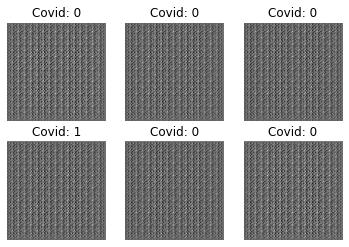

Epoch 2/500 Batch 6/6 [D loss: 1.35861, acc: 78.12%] [G loss: 23.52111]
Epoch 3/500 Batch 6/6 [D loss: 0.01138, acc: 100.00%] [G loss: 29.78287]
Epoch 4/500 Batch 6/6 [D loss: 0.02864, acc: 100.00%] [G loss: 4.82162]
Epoch 5/500 Batch 6/6 [D loss: 0.04502, acc: 96.88%] [G loss: 5.15039]
Epoch 6/500 Batch 6/6 [D loss: 0.00627, acc: 100.00%] [G loss: 1.40371]
Epoch 7/500 Batch 6/6 [D loss: 0.04242, acc: 96.88%] [G loss: 12.17844]
Epoch 8/500 Batch 6/6 [D loss: 0.00829, acc: 100.00%] [G loss: 6.32874]
Epoch 9/500 Batch 6/6 [D loss: 0.02809, acc: 100.00%] [G loss: 7.17149]
Epoch 10/500 Batch 6/6 [D loss: 0.00225, acc: 100.00%] [G loss: 14.05669]
Epoch 11/500 Batch 6/6 [D loss: 0.00118, acc: 100.00%] [G loss: 4.73093]
Epoch 12/500 Batch 6/6 [D loss: 0.17836, acc: 96.88%] [G loss: 3.86190]
Epoch 13/500 Batch 6/6 [D loss: 0.02541, acc: 100.00%] [G loss: 5.24029]
Epoch 14/500 Batch 6/6 [D loss: 0.00469, acc: 100.00%] [G loss: 5.79063]
Epoch 15/500 Batch 6/6 [D loss: 0.00019, acc: 100.00%] [G l

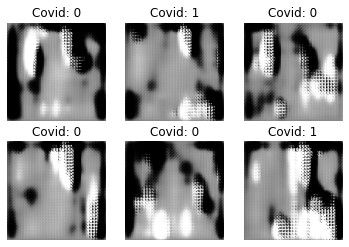

Epoch 22/500 Batch 6/6 [D loss: 0.43657, acc: 78.12%] [G loss: 3.85350]
Epoch 23/500 Batch 6/6 [D loss: 0.35575, acc: 84.38%] [G loss: 2.52372]
Epoch 24/500 Batch 6/6 [D loss: 0.21014, acc: 90.62%] [G loss: 2.67988]
Epoch 25/500 Batch 6/6 [D loss: 0.31852, acc: 90.62%] [G loss: 2.50483]
Epoch 26/500 Batch 6/6 [D loss: 0.31871, acc: 90.62%] [G loss: 2.48737]
Epoch 27/500 Batch 6/6 [D loss: 0.60082, acc: 62.50%] [G loss: 2.78945]
Epoch 28/500 Batch 6/6 [D loss: 0.50380, acc: 75.00%] [G loss: 1.79780]
Epoch 29/500 Batch 6/6 [D loss: 0.36430, acc: 87.50%] [G loss: 2.09439]
Epoch 30/500 Batch 6/6 [D loss: 0.52619, acc: 71.88%] [G loss: 1.96640]
Epoch 31/500 Batch 6/6 [D loss: 0.41999, acc: 84.38%] [G loss: 2.98037]
Epoch 32/500 Batch 6/6 [D loss: 0.51739, acc: 68.75%] [G loss: 2.60676]
Epoch 33/500 Batch 6/6 [D loss: 0.44052, acc: 84.38%] [G loss: 2.22094]
Epoch 34/500 Batch 6/6 [D loss: 0.39430, acc: 84.38%] [G loss: 2.63174]
Epoch 35/500 Batch 6/6 [D loss: 0.38310, acc: 75.00%] [G loss: 3

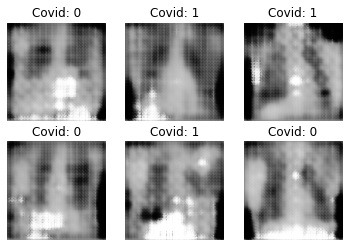

Epoch 42/500 Batch 6/6 [D loss: 0.50735, acc: 78.12%] [G loss: 3.08195]
Epoch 43/500 Batch 6/6 [D loss: 0.24780, acc: 87.50%] [G loss: 2.66485]
Epoch 44/500 Batch 6/6 [D loss: 0.48690, acc: 75.00%] [G loss: 2.11630]
Epoch 45/500 Batch 6/6 [D loss: 0.31363, acc: 90.62%] [G loss: 2.69603]
Epoch 46/500 Batch 6/6 [D loss: 0.30213, acc: 87.50%] [G loss: 3.26673]
Epoch 47/500 Batch 6/6 [D loss: 0.19788, acc: 96.88%] [G loss: 3.00049]
Epoch 48/500 Batch 6/6 [D loss: 0.75746, acc: 68.75%] [G loss: 1.60816]
Epoch 49/500 Batch 6/6 [D loss: 0.34644, acc: 81.25%] [G loss: 2.16606]
Epoch 50/500 Batch 6/6 [D loss: 0.27145, acc: 90.62%] [G loss: 2.05436]
Epoch 51/500 Batch 6/6 [D loss: 0.25716, acc: 87.50%] [G loss: 3.09658]
Epoch 52/500 Batch 6/6 [D loss: 0.13517, acc: 100.00%] [G loss: 2.86364]
Epoch 53/500 Batch 6/6 [D loss: 0.33862, acc: 81.25%] [G loss: 1.94332]
Epoch 54/500 Batch 6/6 [D loss: 0.36852, acc: 90.62%] [G loss: 1.99040]
Epoch 55/500 Batch 6/6 [D loss: 0.26225, acc: 93.75%] [G loss: 

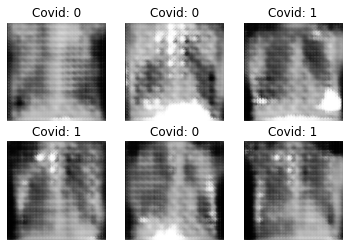

Epoch 62/500 Batch 6/6 [D loss: 0.65919, acc: 62.50%] [G loss: 1.80889]
Epoch 63/500 Batch 6/6 [D loss: 0.26672, acc: 90.62%] [G loss: 2.83255]
Epoch 64/500 Batch 6/6 [D loss: 0.44671, acc: 78.12%] [G loss: 2.08043]
Epoch 65/500 Batch 6/6 [D loss: 0.20775, acc: 100.00%] [G loss: 2.54079]
Epoch 66/500 Batch 6/6 [D loss: 0.38957, acc: 84.38%] [G loss: 2.77886]
Epoch 67/500 Batch 6/6 [D loss: 0.47994, acc: 78.12%] [G loss: 3.33995]
Epoch 68/500 Batch 6/6 [D loss: 0.37227, acc: 87.50%] [G loss: 4.32320]
Epoch 69/500 Batch 6/6 [D loss: 0.35284, acc: 87.50%] [G loss: 2.32073]
Epoch 70/500 Batch 6/6 [D loss: 0.26686, acc: 93.75%] [G loss: 4.67943]
Epoch 71/500 Batch 6/6 [D loss: 0.27774, acc: 87.50%] [G loss: 2.94645]
Epoch 72/500 Batch 6/6 [D loss: 0.31985, acc: 93.75%] [G loss: 2.85978]
Epoch 73/500 Batch 6/6 [D loss: 0.17884, acc: 100.00%] [G loss: 3.01974]
Epoch 74/500 Batch 6/6 [D loss: 0.22890, acc: 90.62%] [G loss: 2.46330]
Epoch 75/500 Batch 6/6 [D loss: 0.17679, acc: 93.75%] [G loss:

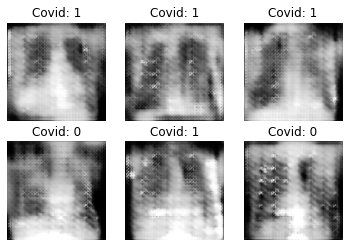

Epoch 82/500 Batch 6/6 [D loss: 0.29689, acc: 87.50%] [G loss: 3.49098]
Epoch 83/500 Batch 6/6 [D loss: 0.12388, acc: 100.00%] [G loss: 2.88416]
Epoch 84/500 Batch 6/6 [D loss: 0.35539, acc: 81.25%] [G loss: 3.32230]
Epoch 85/500 Batch 6/6 [D loss: 0.34004, acc: 84.38%] [G loss: 3.76042]
Epoch 86/500 Batch 6/6 [D loss: 0.21071, acc: 90.62%] [G loss: 1.81169]
Epoch 87/500 Batch 6/6 [D loss: 0.44554, acc: 84.38%] [G loss: 2.91115]
Epoch 88/500 Batch 6/6 [D loss: 0.11481, acc: 100.00%] [G loss: 2.35291]
Epoch 89/500 Batch 6/6 [D loss: 0.41668, acc: 81.25%] [G loss: 3.27891]
Epoch 90/500 Batch 6/6 [D loss: 0.62606, acc: 68.75%] [G loss: 2.75912]
Epoch 91/500 Batch 6/6 [D loss: 0.48916, acc: 78.12%] [G loss: 2.35410]
Epoch 92/500 Batch 6/6 [D loss: 0.34491, acc: 93.75%] [G loss: 2.56463]
Epoch 93/500 Batch 6/6 [D loss: 0.31755, acc: 93.75%] [G loss: 3.60676]
Epoch 94/500 Batch 6/6 [D loss: 0.34278, acc: 90.62%] [G loss: 2.80778]
Epoch 95/500 Batch 6/6 [D loss: 0.29113, acc: 90.62%] [G loss:

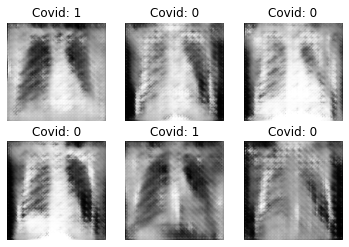

Epoch 102/500 Batch 6/6 [D loss: 0.30574, acc: 87.50%] [G loss: 2.35769]
Epoch 103/500 Batch 6/6 [D loss: 0.31740, acc: 87.50%] [G loss: 2.89232]
Epoch 104/500 Batch 6/6 [D loss: 0.42507, acc: 71.88%] [G loss: 3.17449]
Epoch 105/500 Batch 6/6 [D loss: 0.51363, acc: 75.00%] [G loss: 3.36474]
Epoch 106/500 Batch 6/6 [D loss: 0.26611, acc: 78.12%] [G loss: 3.68113]
Epoch 107/500 Batch 6/6 [D loss: 0.27174, acc: 87.50%] [G loss: 2.15828]
Epoch 108/500 Batch 6/6 [D loss: 0.38438, acc: 81.25%] [G loss: 2.19682]
Epoch 109/500 Batch 6/6 [D loss: 0.56324, acc: 68.75%] [G loss: 2.74899]
Epoch 110/500 Batch 6/6 [D loss: 0.33186, acc: 81.25%] [G loss: 2.72348]
Epoch 111/500 Batch 6/6 [D loss: 0.45093, acc: 78.12%] [G loss: 3.00880]
Epoch 112/500 Batch 6/6 [D loss: 0.24177, acc: 93.75%] [G loss: 2.50524]
Epoch 113/500 Batch 6/6 [D loss: 0.42971, acc: 71.88%] [G loss: 1.63862]
Epoch 114/500 Batch 6/6 [D loss: 0.54382, acc: 68.75%] [G loss: 5.57703]
Epoch 115/500 Batch 6/6 [D loss: 0.16957, acc: 96.8

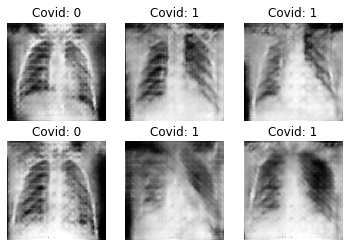

Epoch 122/500 Batch 6/6 [D loss: 0.50249, acc: 71.88%] [G loss: 5.55272]
Epoch 123/500 Batch 6/6 [D loss: 0.46044, acc: 78.12%] [G loss: 3.73568]
Epoch 124/500 Batch 6/6 [D loss: 0.41874, acc: 81.25%] [G loss: 3.04740]
Epoch 125/500 Batch 6/6 [D loss: 0.26424, acc: 87.50%] [G loss: 3.04764]
Epoch 126/500 Batch 6/6 [D loss: 0.40625, acc: 81.25%] [G loss: 2.07215]
Epoch 127/500 Batch 6/6 [D loss: 0.23976, acc: 90.62%] [G loss: 3.59889]
Epoch 128/500 Batch 6/6 [D loss: 0.28703, acc: 93.75%] [G loss: 4.35633]
Epoch 129/500 Batch 6/6 [D loss: 0.49095, acc: 84.38%] [G loss: 2.94276]
Epoch 130/500 Batch 6/6 [D loss: 0.26560, acc: 90.62%] [G loss: 6.41804]
Epoch 131/500 Batch 6/6 [D loss: 0.67041, acc: 62.50%] [G loss: 4.23108]
Epoch 132/500 Batch 6/6 [D loss: 0.38645, acc: 84.38%] [G loss: 3.26757]
Epoch 133/500 Batch 6/6 [D loss: 0.34050, acc: 87.50%] [G loss: 3.14552]
Epoch 134/500 Batch 6/6 [D loss: 0.33723, acc: 75.00%] [G loss: 4.13190]
Epoch 135/500 Batch 6/6 [D loss: 0.38827, acc: 84.3

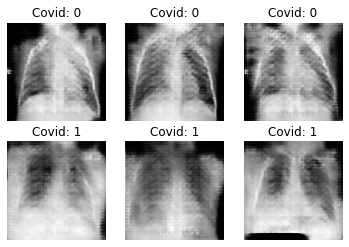

Epoch 142/500 Batch 6/6 [D loss: 0.37477, acc: 81.25%] [G loss: 3.35468]
Epoch 143/500 Batch 6/6 [D loss: 0.20032, acc: 93.75%] [G loss: 3.01882]
Epoch 144/500 Batch 6/6 [D loss: 0.29193, acc: 90.62%] [G loss: 3.43310]
Epoch 145/500 Batch 6/6 [D loss: 0.41181, acc: 75.00%] [G loss: 4.34443]
Epoch 146/500 Batch 6/6 [D loss: 0.25581, acc: 93.75%] [G loss: 3.62267]
Epoch 147/500 Batch 6/6 [D loss: 0.10605, acc: 100.00%] [G loss: 3.41473]
Epoch 148/500 Batch 6/6 [D loss: 0.48177, acc: 81.25%] [G loss: 3.49566]
Epoch 149/500 Batch 6/6 [D loss: 0.35584, acc: 90.62%] [G loss: 3.59160]
Epoch 150/500 Batch 6/6 [D loss: 0.34692, acc: 81.25%] [G loss: 3.66628]
Epoch 151/500 Batch 6/6 [D loss: 0.39539, acc: 81.25%] [G loss: 3.40833]
Epoch 152/500 Batch 6/6 [D loss: 0.15403, acc: 100.00%] [G loss: 3.62129]
Epoch 153/500 Batch 6/6 [D loss: 0.24637, acc: 96.88%] [G loss: 4.16252]
Epoch 154/500 Batch 6/6 [D loss: 0.42397, acc: 87.50%] [G loss: 3.65114]
Epoch 155/500 Batch 6/6 [D loss: 0.21851, acc: 93

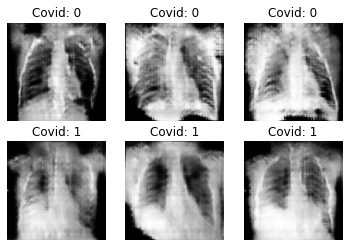

Epoch 162/500 Batch 6/6 [D loss: 0.18112, acc: 96.88%] [G loss: 2.85673]
Epoch 163/500 Batch 6/6 [D loss: 0.21381, acc: 93.75%] [G loss: 4.16432]
Epoch 164/500 Batch 6/6 [D loss: 0.24450, acc: 93.75%] [G loss: 4.15890]
Epoch 165/500 Batch 6/6 [D loss: 0.41659, acc: 75.00%] [G loss: 4.08726]
Epoch 166/500 Batch 6/6 [D loss: 0.20278, acc: 90.62%] [G loss: 4.49652]
Epoch 167/500 Batch 6/6 [D loss: 0.31909, acc: 78.12%] [G loss: 4.61434]
Epoch 168/500 Batch 6/6 [D loss: 0.19800, acc: 90.62%] [G loss: 4.07520]
Epoch 169/500 Batch 6/6 [D loss: 0.49732, acc: 65.62%] [G loss: 4.67541]
Epoch 170/500 Batch 6/6 [D loss: 0.19629, acc: 96.88%] [G loss: 4.96359]
Epoch 171/500 Batch 6/6 [D loss: 0.23748, acc: 93.75%] [G loss: 3.56147]
Epoch 172/500 Batch 6/6 [D loss: 0.14515, acc: 93.75%] [G loss: 3.67481]
Epoch 173/500 Batch 6/6 [D loss: 0.38888, acc: 84.38%] [G loss: 5.29897]
Epoch 174/500 Batch 6/6 [D loss: 0.22441, acc: 93.75%] [G loss: 3.47359]
Epoch 175/500 Batch 6/6 [D loss: 0.09728, acc: 96.8

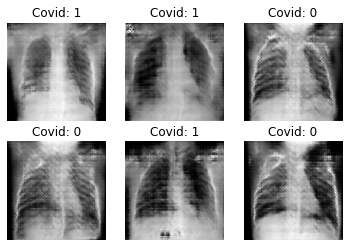

Epoch 182/500 Batch 6/6 [D loss: 0.24046, acc: 96.88%] [G loss: 2.75655]
Epoch 183/500 Batch 6/6 [D loss: 0.42838, acc: 78.12%] [G loss: 2.87827]
Epoch 184/500 Batch 6/6 [D loss: 0.25730, acc: 87.50%] [G loss: 4.72600]
Epoch 185/500 Batch 6/6 [D loss: 0.26867, acc: 87.50%] [G loss: 4.30934]
Epoch 186/500 Batch 6/6 [D loss: 0.28738, acc: 81.25%] [G loss: 4.61355]
Epoch 187/500 Batch 6/6 [D loss: 0.19149, acc: 93.75%] [G loss: 3.39490]
Epoch 188/500 Batch 6/6 [D loss: 0.27569, acc: 87.50%] [G loss: 3.75986]
Epoch 189/500 Batch 6/6 [D loss: 0.14266, acc: 96.88%] [G loss: 3.21424]
Epoch 190/500 Batch 6/6 [D loss: 0.24509, acc: 87.50%] [G loss: 3.83973]
Epoch 191/500 Batch 6/6 [D loss: 0.12931, acc: 96.88%] [G loss: 4.30539]
Epoch 192/500 Batch 6/6 [D loss: 0.33407, acc: 81.25%] [G loss: 4.28695]
Epoch 193/500 Batch 6/6 [D loss: 0.19551, acc: 96.88%] [G loss: 4.05036]
Epoch 194/500 Batch 6/6 [D loss: 0.24717, acc: 90.62%] [G loss: 3.21389]
Epoch 195/500 Batch 6/6 [D loss: 0.29546, acc: 87.5

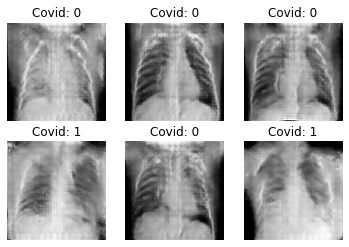

Epoch 202/500 Batch 6/6 [D loss: 0.18681, acc: 93.75%] [G loss: 5.21751]
Epoch 203/500 Batch 6/6 [D loss: 0.21654, acc: 90.62%] [G loss: 4.45346]
Epoch 204/500 Batch 6/6 [D loss: 0.17805, acc: 96.88%] [G loss: 3.73468]
Epoch 205/500 Batch 6/6 [D loss: 0.18866, acc: 96.88%] [G loss: 3.59827]
Epoch 206/500 Batch 6/6 [D loss: 0.29234, acc: 93.75%] [G loss: 3.52126]
Epoch 207/500 Batch 6/6 [D loss: 0.20315, acc: 90.62%] [G loss: 3.48852]
Epoch 208/500 Batch 6/6 [D loss: 0.35855, acc: 84.38%] [G loss: 5.04677]
Epoch 209/500 Batch 6/6 [D loss: 0.29766, acc: 87.50%] [G loss: 4.87374]
Epoch 210/500 Batch 6/6 [D loss: 0.13735, acc: 100.00%] [G loss: 3.56000]
Epoch 211/500 Batch 6/6 [D loss: 0.25731, acc: 81.25%] [G loss: 3.05782]
Epoch 212/500 Batch 6/6 [D loss: 0.12827, acc: 96.88%] [G loss: 4.15335]
Epoch 213/500 Batch 6/6 [D loss: 0.23352, acc: 90.62%] [G loss: 3.83307]
Epoch 214/500 Batch 6/6 [D loss: 0.22378, acc: 96.88%] [G loss: 3.29044]
Epoch 215/500 Batch 6/6 [D loss: 0.10079, acc: 100

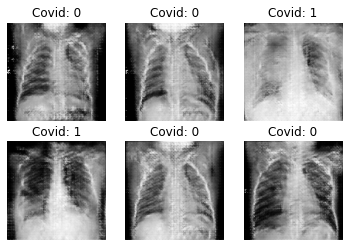

Epoch 222/500 Batch 6/6 [D loss: 0.20789, acc: 90.62%] [G loss: 3.88474]
Epoch 223/500 Batch 6/6 [D loss: 0.79766, acc: 59.38%] [G loss: 4.49440]
Epoch 224/500 Batch 6/6 [D loss: 0.42543, acc: 78.12%] [G loss: 3.77485]
Epoch 225/500 Batch 6/6 [D loss: 0.14284, acc: 96.88%] [G loss: 4.40570]
Epoch 226/500 Batch 6/6 [D loss: 0.30855, acc: 87.50%] [G loss: 3.74955]
Epoch 227/500 Batch 6/6 [D loss: 0.77225, acc: 65.62%] [G loss: 4.49802]
Epoch 228/500 Batch 6/6 [D loss: 0.21973, acc: 90.62%] [G loss: 4.52616]
Epoch 229/500 Batch 6/6 [D loss: 0.19126, acc: 93.75%] [G loss: 3.55522]
Epoch 230/500 Batch 6/6 [D loss: 0.07333, acc: 100.00%] [G loss: 4.64602]
Epoch 231/500 Batch 6/6 [D loss: 0.12652, acc: 96.88%] [G loss: 3.77905]
Epoch 232/500 Batch 6/6 [D loss: 0.14275, acc: 96.88%] [G loss: 3.31024]
Epoch 233/500 Batch 6/6 [D loss: 0.24967, acc: 90.62%] [G loss: 2.87304]
Epoch 234/500 Batch 6/6 [D loss: 0.16431, acc: 93.75%] [G loss: 2.95587]
Epoch 235/500 Batch 6/6 [D loss: 0.03987, acc: 100

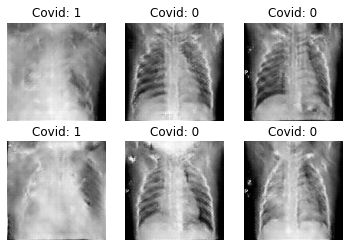

Epoch 242/500 Batch 6/6 [D loss: 0.12918, acc: 100.00%] [G loss: 4.27009]
Epoch 243/500 Batch 6/6 [D loss: 0.09871, acc: 100.00%] [G loss: 3.60123]
Epoch 244/500 Batch 6/6 [D loss: 0.18918, acc: 93.75%] [G loss: 3.56199]
Epoch 245/500 Batch 6/6 [D loss: 0.16680, acc: 93.75%] [G loss: 5.32955]
Epoch 246/500 Batch 6/6 [D loss: 0.38893, acc: 81.25%] [G loss: 4.26977]
Epoch 247/500 Batch 6/6 [D loss: 0.26797, acc: 84.38%] [G loss: 2.94580]
Epoch 248/500 Batch 6/6 [D loss: 0.14354, acc: 93.75%] [G loss: 3.87346]
Epoch 249/500 Batch 6/6 [D loss: 0.38171, acc: 81.25%] [G loss: 4.60201]
Epoch 250/500 Batch 6/6 [D loss: 0.27051, acc: 87.50%] [G loss: 3.53502]
Epoch 251/500 Batch 6/6 [D loss: 0.21605, acc: 87.50%] [G loss: 3.77934]
Epoch 252/500 Batch 6/6 [D loss: 0.12763, acc: 96.88%] [G loss: 3.46803]
Epoch 253/500 Batch 6/6 [D loss: 0.26268, acc: 93.75%] [G loss: 4.01131]
Epoch 254/500 Batch 6/6 [D loss: 0.21875, acc: 90.62%] [G loss: 4.50975]
Epoch 255/500 Batch 6/6 [D loss: 0.21998, acc: 90

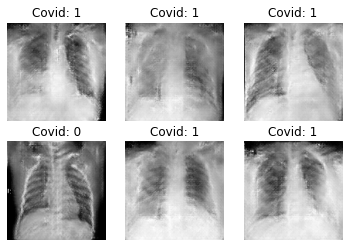

Epoch 262/500 Batch 6/6 [D loss: 0.07531, acc: 100.00%] [G loss: 3.73679]
Epoch 263/500 Batch 6/6 [D loss: 0.05187, acc: 100.00%] [G loss: 3.61188]
Epoch 264/500 Batch 6/6 [D loss: 0.27654, acc: 87.50%] [G loss: 3.80401]
Epoch 265/500 Batch 6/6 [D loss: 0.18666, acc: 96.88%] [G loss: 3.14633]
Epoch 266/500 Batch 6/6 [D loss: 0.15432, acc: 93.75%] [G loss: 4.34993]
Epoch 267/500 Batch 6/6 [D loss: 0.09728, acc: 93.75%] [G loss: 5.05926]
Epoch 268/500 Batch 6/6 [D loss: 0.20872, acc: 90.62%] [G loss: 6.05187]
Epoch 269/500 Batch 6/6 [D loss: 0.25842, acc: 90.62%] [G loss: 4.30281]
Epoch 270/500 Batch 6/6 [D loss: 0.14374, acc: 93.75%] [G loss: 6.32634]
Epoch 271/500 Batch 6/6 [D loss: 0.16044, acc: 96.88%] [G loss: 4.62691]
Epoch 272/500 Batch 6/6 [D loss: 0.10405, acc: 100.00%] [G loss: 2.48804]
Epoch 273/500 Batch 6/6 [D loss: 0.39809, acc: 81.25%] [G loss: 4.44179]
Epoch 274/500 Batch 6/6 [D loss: 0.21811, acc: 87.50%] [G loss: 4.27351]
Epoch 275/500 Batch 6/6 [D loss: 0.22830, acc: 9

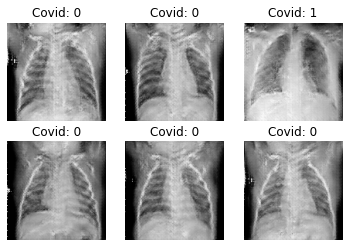

Epoch 282/500 Batch 6/6 [D loss: 0.20492, acc: 90.62%] [G loss: 3.62498]
Epoch 283/500 Batch 6/6 [D loss: 0.08324, acc: 96.88%] [G loss: 4.54922]
Epoch 284/500 Batch 6/6 [D loss: 0.02765, acc: 100.00%] [G loss: 3.68183]
Epoch 285/500 Batch 6/6 [D loss: 0.21678, acc: 93.75%] [G loss: 4.23609]
Epoch 286/500 Batch 6/6 [D loss: 0.17097, acc: 96.88%] [G loss: 3.59590]
Epoch 287/500 Batch 6/6 [D loss: 0.14638, acc: 93.75%] [G loss: 3.61448]
Epoch 288/500 Batch 6/6 [D loss: 0.17369, acc: 93.75%] [G loss: 5.45839]
Epoch 289/500 Batch 6/6 [D loss: 0.15616, acc: 90.62%] [G loss: 4.68283]
Epoch 290/500 Batch 6/6 [D loss: 0.18774, acc: 87.50%] [G loss: 4.56459]
Epoch 291/500 Batch 6/6 [D loss: 0.08136, acc: 96.88%] [G loss: 3.77146]
Epoch 292/500 Batch 6/6 [D loss: 0.18952, acc: 90.62%] [G loss: 3.94288]
Epoch 293/500 Batch 6/6 [D loss: 0.12266, acc: 96.88%] [G loss: 3.74593]
Epoch 294/500 Batch 6/6 [D loss: 0.07638, acc: 96.88%] [G loss: 4.94185]
Epoch 295/500 Batch 6/6 [D loss: 0.11479, acc: 100

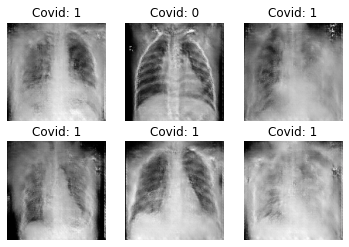

Epoch 302/500 Batch 6/6 [D loss: 0.24400, acc: 93.75%] [G loss: 4.40711]
Epoch 303/500 Batch 6/6 [D loss: 0.12292, acc: 96.88%] [G loss: 3.99834]
Epoch 304/500 Batch 6/6 [D loss: 0.21091, acc: 93.75%] [G loss: 4.56350]
Epoch 305/500 Batch 6/6 [D loss: 0.09287, acc: 96.88%] [G loss: 4.48833]
Epoch 306/500 Batch 6/6 [D loss: 0.25429, acc: 87.50%] [G loss: 6.60082]
Epoch 307/500 Batch 6/6 [D loss: 0.21435, acc: 87.50%] [G loss: 5.39208]
Epoch 308/500 Batch 6/6 [D loss: 2.50165, acc: 46.88%] [G loss: 8.70217]
Epoch 309/500 Batch 6/6 [D loss: 0.58605, acc: 71.88%] [G loss: 4.33417]
Epoch 310/500 Batch 6/6 [D loss: 0.77811, acc: 62.50%] [G loss: 9.65558]
Epoch 311/500 Batch 6/6 [D loss: 0.16528, acc: 90.62%] [G loss: 3.41799]
Epoch 312/500 Batch 6/6 [D loss: 0.11222, acc: 96.88%] [G loss: 3.74563]
Epoch 313/500 Batch 6/6 [D loss: 0.05069, acc: 100.00%] [G loss: 6.65515]
Epoch 314/500 Batch 6/6 [D loss: 0.21227, acc: 96.88%] [G loss: 3.51150]
Epoch 315/500 Batch 6/6 [D loss: 0.10716, acc: 96.

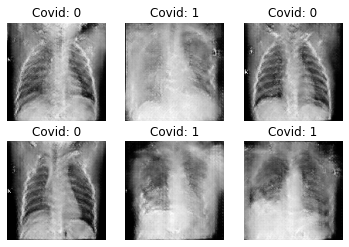

Epoch 322/500 Batch 6/6 [D loss: 0.10875, acc: 100.00%] [G loss: 3.18672]
Epoch 323/500 Batch 6/6 [D loss: 0.04857, acc: 100.00%] [G loss: 3.91868]
Epoch 324/500 Batch 6/6 [D loss: 0.13067, acc: 96.88%] [G loss: 4.00008]
Epoch 325/500 Batch 6/6 [D loss: 0.19617, acc: 90.62%] [G loss: 4.01596]
Epoch 326/500 Batch 6/6 [D loss: 0.05149, acc: 100.00%] [G loss: 3.98424]
Epoch 327/500 Batch 6/6 [D loss: 0.05606, acc: 100.00%] [G loss: 3.14767]
Epoch 328/500 Batch 6/6 [D loss: 0.29655, acc: 87.50%] [G loss: 5.65725]
Epoch 329/500 Batch 6/6 [D loss: 0.09012, acc: 96.88%] [G loss: 3.54768]
Epoch 330/500 Batch 6/6 [D loss: 0.06771, acc: 100.00%] [G loss: 3.97654]
Epoch 331/500 Batch 6/6 [D loss: 0.18937, acc: 90.62%] [G loss: 5.19849]
Epoch 332/500 Batch 6/6 [D loss: 0.10354, acc: 93.75%] [G loss: 4.95888]
Epoch 333/500 Batch 6/6 [D loss: 0.05656, acc: 100.00%] [G loss: 4.38295]
Epoch 334/500 Batch 6/6 [D loss: 0.16264, acc: 90.62%] [G loss: 3.99407]
Epoch 335/500 Batch 6/6 [D loss: 0.08111, acc

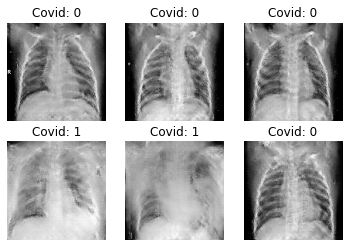

Epoch 342/500 Batch 6/6 [D loss: 0.05850, acc: 100.00%] [G loss: 4.42588]
Epoch 343/500 Batch 6/6 [D loss: 0.03632, acc: 100.00%] [G loss: 4.83099]
Epoch 344/500 Batch 6/6 [D loss: 0.09680, acc: 100.00%] [G loss: 4.27123]
Epoch 345/500 Batch 6/6 [D loss: 0.05575, acc: 100.00%] [G loss: 4.01666]
Epoch 346/500 Batch 6/6 [D loss: 0.10656, acc: 100.00%] [G loss: 4.00403]
Epoch 347/500 Batch 6/6 [D loss: 0.18012, acc: 93.75%] [G loss: 5.55928]
Epoch 348/500 Batch 6/6 [D loss: 0.04838, acc: 100.00%] [G loss: 4.02597]
Epoch 349/500 Batch 6/6 [D loss: 0.01248, acc: 100.00%] [G loss: 4.27753]
Epoch 350/500 Batch 6/6 [D loss: 0.04874, acc: 100.00%] [G loss: 5.33759]
Epoch 351/500 Batch 6/6 [D loss: 0.09357, acc: 100.00%] [G loss: 3.23479]
Epoch 352/500 Batch 6/6 [D loss: 0.05234, acc: 100.00%] [G loss: 4.69112]
Epoch 353/500 Batch 6/6 [D loss: 0.09022, acc: 100.00%] [G loss: 4.51350]
Epoch 354/500 Batch 6/6 [D loss: 0.03371, acc: 100.00%] [G loss: 4.55823]
Epoch 355/500 Batch 6/6 [D loss: 0.0796

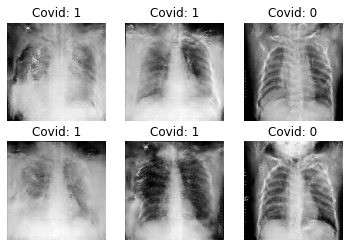

Epoch 362/500 Batch 6/6 [D loss: 0.07254, acc: 100.00%] [G loss: 3.77045]
Epoch 363/500 Batch 6/6 [D loss: 0.03736, acc: 100.00%] [G loss: 4.72811]
Epoch 364/500 Batch 6/6 [D loss: 0.27302, acc: 87.50%] [G loss: 7.05623]
Epoch 365/500 Batch 6/6 [D loss: 0.16962, acc: 93.75%] [G loss: 5.34751]
Epoch 366/500 Batch 6/6 [D loss: 0.08184, acc: 96.88%] [G loss: 5.79408]
Epoch 367/500 Batch 6/6 [D loss: 0.03325, acc: 100.00%] [G loss: 4.63495]
Epoch 368/500 Batch 6/6 [D loss: 0.19023, acc: 90.62%] [G loss: 4.57043]
Epoch 369/500 Batch 6/6 [D loss: 0.09292, acc: 93.75%] [G loss: 4.80270]
Epoch 370/500 Batch 6/6 [D loss: 0.07156, acc: 100.00%] [G loss: 3.95050]
Epoch 371/500 Batch 6/6 [D loss: 0.09206, acc: 100.00%] [G loss: 5.38410]
Epoch 372/500 Batch 6/6 [D loss: 0.05449, acc: 100.00%] [G loss: 4.88243]
Epoch 373/500 Batch 6/6 [D loss: 0.11215, acc: 100.00%] [G loss: 4.32276]
Epoch 374/500 Batch 6/6 [D loss: 0.05719, acc: 100.00%] [G loss: 4.68187]
Epoch 375/500 Batch 6/6 [D loss: 0.03497, a

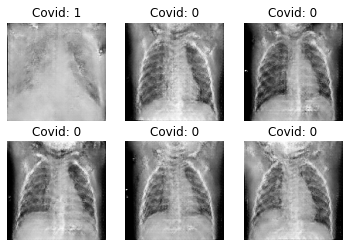

Epoch 382/500 Batch 6/6 [D loss: 0.04766, acc: 100.00%] [G loss: 6.63524]
Epoch 383/500 Batch 6/6 [D loss: 0.13751, acc: 93.75%] [G loss: 5.43667]
Epoch 384/500 Batch 6/6 [D loss: 0.06272, acc: 100.00%] [G loss: 4.36340]
Epoch 385/500 Batch 6/6 [D loss: 0.04939, acc: 100.00%] [G loss: 4.64586]
Epoch 386/500 Batch 6/6 [D loss: 0.04729, acc: 100.00%] [G loss: 6.32968]
Epoch 387/500 Batch 6/6 [D loss: 0.06863, acc: 93.75%] [G loss: 6.89838]
Epoch 388/500 Batch 6/6 [D loss: 0.06341, acc: 100.00%] [G loss: 5.23009]
Epoch 389/500 Batch 6/6 [D loss: 0.07366, acc: 96.88%] [G loss: 5.30708]
Epoch 390/500 Batch 6/6 [D loss: 0.15903, acc: 93.75%] [G loss: 6.42904]
Epoch 391/500 Batch 6/6 [D loss: 0.01955, acc: 100.00%] [G loss: 6.51233]
Epoch 392/500 Batch 6/6 [D loss: 0.10018, acc: 96.88%] [G loss: 5.41275]
Epoch 393/500 Batch 6/6 [D loss: 0.07960, acc: 96.88%] [G loss: 4.62604]
Epoch 394/500 Batch 6/6 [D loss: 0.01272, acc: 100.00%] [G loss: 5.35907]
Epoch 395/500 Batch 6/6 [D loss: 0.14282, ac

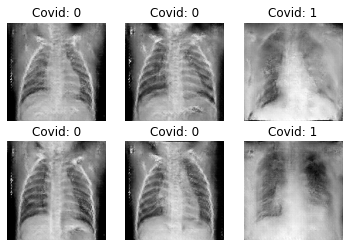

Epoch 402/500 Batch 6/6 [D loss: 0.10174, acc: 96.88%] [G loss: 6.57655]
Epoch 403/500 Batch 6/6 [D loss: 0.12467, acc: 96.88%] [G loss: 6.53693]
Epoch 404/500 Batch 6/6 [D loss: 0.06089, acc: 96.88%] [G loss: 7.06069]
Epoch 405/500 Batch 6/6 [D loss: 0.13221, acc: 90.62%] [G loss: 4.94668]
Epoch 406/500 Batch 6/6 [D loss: 0.05362, acc: 96.88%] [G loss: 4.95587]
Epoch 407/500 Batch 6/6 [D loss: 0.23562, acc: 90.62%] [G loss: 4.81390]
Epoch 408/500 Batch 6/6 [D loss: 0.05352, acc: 100.00%] [G loss: 5.78701]
Epoch 409/500 Batch 6/6 [D loss: 0.05719, acc: 96.88%] [G loss: 6.20982]
Epoch 410/500 Batch 6/6 [D loss: 0.01594, acc: 100.00%] [G loss: 5.98769]
Epoch 411/500 Batch 6/6 [D loss: 0.02592, acc: 100.00%] [G loss: 5.96556]
Epoch 412/500 Batch 6/6 [D loss: 0.05284, acc: 96.88%] [G loss: 6.51682]
Epoch 413/500 Batch 6/6 [D loss: 0.02630, acc: 100.00%] [G loss: 6.13028]
Epoch 414/500 Batch 6/6 [D loss: 0.09794, acc: 96.88%] [G loss: 5.72550]
Epoch 415/500 Batch 6/6 [D loss: 0.02803, acc: 

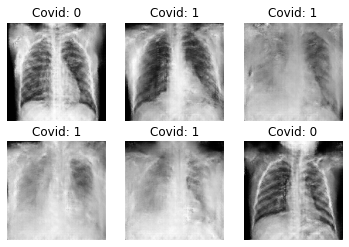

Epoch 422/500 Batch 6/6 [D loss: 0.02186, acc: 100.00%] [G loss: 6.51773]
Epoch 423/500 Batch 6/6 [D loss: 0.06554, acc: 100.00%] [G loss: 5.91186]
Epoch 424/500 Batch 6/6 [D loss: 0.04090, acc: 100.00%] [G loss: 5.52505]
Epoch 425/500 Batch 6/6 [D loss: 0.07391, acc: 93.75%] [G loss: 5.18125]
Epoch 426/500 Batch 6/6 [D loss: 0.01773, acc: 100.00%] [G loss: 6.35120]
Epoch 427/500 Batch 6/6 [D loss: 0.10987, acc: 96.88%] [G loss: 7.94248]
Epoch 428/500 Batch 6/6 [D loss: 0.02013, acc: 100.00%] [G loss: 6.16216]
Epoch 429/500 Batch 6/6 [D loss: 0.26813, acc: 87.50%] [G loss: 3.91742]
Epoch 430/500 Batch 6/6 [D loss: 0.15586, acc: 90.62%] [G loss: 6.60751]
Epoch 431/500 Batch 6/6 [D loss: 0.18634, acc: 90.62%] [G loss: 5.97121]
Epoch 432/500 Batch 6/6 [D loss: 0.17029, acc: 93.75%] [G loss: 7.71012]
Epoch 433/500 Batch 6/6 [D loss: 0.18469, acc: 90.62%] [G loss: 4.97915]
Epoch 434/500 Batch 6/6 [D loss: 0.03196, acc: 100.00%] [G loss: 4.68421]
Epoch 435/500 Batch 6/6 [D loss: 0.06767, acc

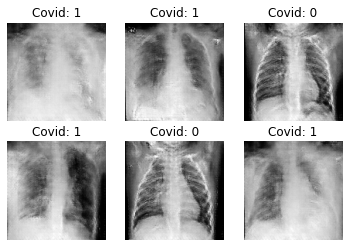

Epoch 442/500 Batch 6/6 [D loss: 0.06874, acc: 93.75%] [G loss: 7.05397]
Epoch 443/500 Batch 6/6 [D loss: 0.03048, acc: 100.00%] [G loss: 6.08504]
Epoch 444/500 Batch 6/6 [D loss: 0.04707, acc: 100.00%] [G loss: 7.34887]
Epoch 445/500 Batch 6/6 [D loss: 0.00529, acc: 100.00%] [G loss: 6.21774]
Epoch 446/500 Batch 6/6 [D loss: 0.04869, acc: 96.88%] [G loss: 6.27701]
Epoch 447/500 Batch 6/6 [D loss: 0.00975, acc: 100.00%] [G loss: 6.26834]
Epoch 448/500 Batch 6/6 [D loss: 0.09077, acc: 96.88%] [G loss: 5.40301]
Epoch 449/500 Batch 6/6 [D loss: 0.08639, acc: 93.75%] [G loss: 10.60619]
Epoch 450/500 Batch 6/6 [D loss: 0.07495, acc: 100.00%] [G loss: 8.07734]
Epoch 451/500 Batch 6/6 [D loss: 0.02011, acc: 100.00%] [G loss: 5.41518]
Epoch 452/500 Batch 6/6 [D loss: 0.20078, acc: 84.38%] [G loss: 7.89797]
Epoch 453/500 Batch 6/6 [D loss: 0.31416, acc: 87.50%] [G loss: 8.42642]
Epoch 454/500 Batch 6/6 [D loss: 0.07140, acc: 96.88%] [G loss: 5.37750]
Epoch 455/500 Batch 6/6 [D loss: 0.04638, ac

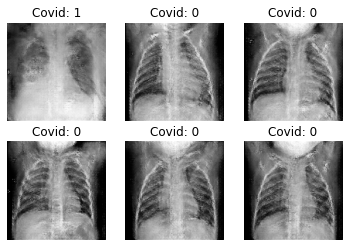

Epoch 462/500 Batch 6/6 [D loss: 0.26831, acc: 81.25%] [G loss: 10.46975]
Epoch 463/500 Batch 6/6 [D loss: 0.04277, acc: 100.00%] [G loss: 4.92531]
Epoch 464/500 Batch 6/6 [D loss: 0.03242, acc: 100.00%] [G loss: 5.70146]
Epoch 465/500 Batch 6/6 [D loss: 0.12170, acc: 93.75%] [G loss: 7.32142]
Epoch 466/500 Batch 6/6 [D loss: 0.01661, acc: 100.00%] [G loss: 5.63169]
Epoch 467/500 Batch 6/6 [D loss: 0.07141, acc: 96.88%] [G loss: 6.79011]
Epoch 468/500 Batch 6/6 [D loss: 0.03963, acc: 100.00%] [G loss: 5.55243]
Epoch 469/500 Batch 6/6 [D loss: 0.02842, acc: 100.00%] [G loss: 5.47376]
Epoch 470/500 Batch 6/6 [D loss: 0.01002, acc: 100.00%] [G loss: 6.30542]
Epoch 471/500 Batch 6/6 [D loss: 0.27199, acc: 93.75%] [G loss: 11.66153]
Epoch 472/500 Batch 6/6 [D loss: 0.03573, acc: 100.00%] [G loss: 6.06372]
Epoch 473/500 Batch 6/6 [D loss: 0.03666, acc: 100.00%] [G loss: 5.27912]
Epoch 474/500 Batch 6/6 [D loss: 0.25828, acc: 90.62%] [G loss: 6.21043]
Epoch 475/500 Batch 6/6 [D loss: 0.03423,

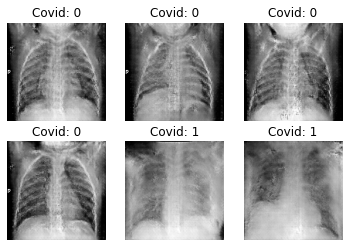

Epoch 482/500 Batch 6/6 [D loss: 0.28805, acc: 93.75%] [G loss: 7.73943]
Epoch 483/500 Batch 6/6 [D loss: 0.13045, acc: 93.75%] [G loss: 6.34121]
Epoch 484/500 Batch 6/6 [D loss: 0.16589, acc: 93.75%] [G loss: 6.82560]
Epoch 485/500 Batch 6/6 [D loss: 0.12040, acc: 93.75%] [G loss: 6.31214]
Epoch 486/500 Batch 6/6 [D loss: 0.02061, acc: 100.00%] [G loss: 4.74025]
Epoch 487/500 Batch 6/6 [D loss: 0.01915, acc: 100.00%] [G loss: 5.85968]
Epoch 488/500 Batch 6/6 [D loss: 0.03884, acc: 100.00%] [G loss: 7.11433]
Epoch 489/500 Batch 6/6 [D loss: 0.03256, acc: 100.00%] [G loss: 6.88442]
Epoch 490/500 Batch 6/6 [D loss: 0.02659, acc: 100.00%] [G loss: 6.09137]
Epoch 491/500 Batch 6/6 [D loss: 0.11499, acc: 93.75%] [G loss: 8.59747]
Epoch 492/500 Batch 6/6 [D loss: 0.00933, acc: 100.00%] [G loss: 6.98551]
Epoch 493/500 Batch 6/6 [D loss: 0.05798, acc: 100.00%] [G loss: 5.29481]
Epoch 494/500 Batch 6/6 [D loss: 0.02509, acc: 100.00%] [G loss: 6.10019]
Epoch 495/500 Batch 6/6 [D loss: 0.01419, a

In [ ]:
# load dictionary of preprocessed data
data = pickle.load(open("preprocessed_data.pkl", "rb"))

# example of training process
cgan = CGAN(data)  # learning rate 0.0002
cgan.train(500, 32, 'final_model')  # epochs 500 and batch size 32

### 1.1.3 - Generating synthetic images using pre-trained models


In this subsection of subtask 1.1, I create two functions 'generate_images' and 'plot_images' which generates images from a **pretrained generator model** and plots them for visualization. It should be noted that *r* and *c* refers to the *rows* and *columns* of the graph (a.k.a how many images you want). In this example I plotted 50 (5 x 10) images that were randomly generated from the model that was trained in the previous  (the final model).

I also made a code to generate two images (1 COVID and 1 Normal) using a pretrained model and compare it to a randomly selected image (1 COVID and 1 Normal) from the preprocessed dataset.

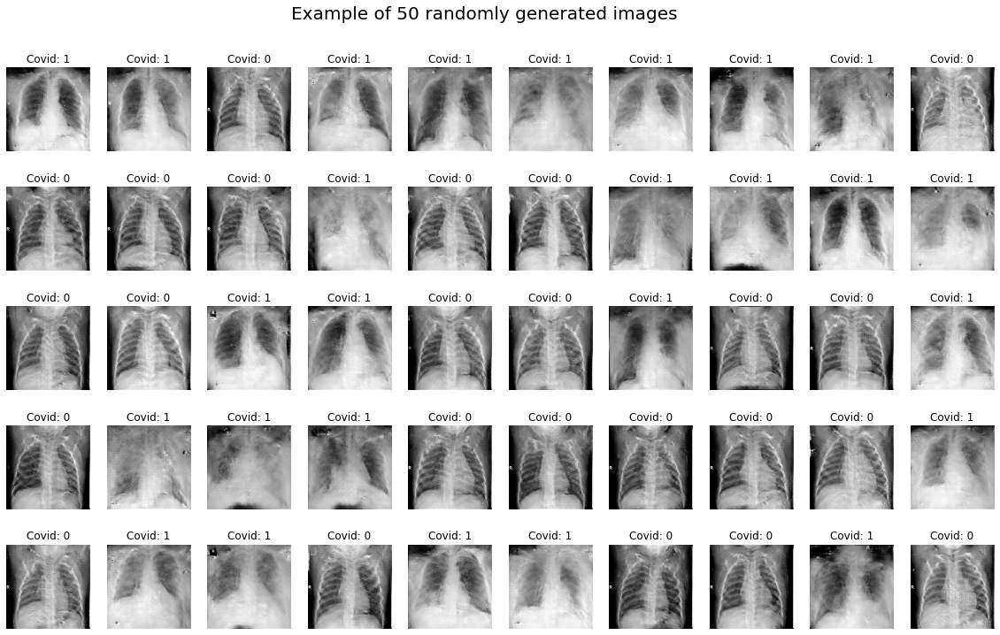

In [ ]:
def generate_images(model_name, r, c, title, latent_dim=100, num_classes=2):
    # load model
    model = load_model('models/'+model_name+'.h5')
    # generate random noise + labels
    noise = np.random.normal(0, 1, (r*c, 100))
    labels = np.random.randint(0, num_classes, r*c)
    # generate images
    imgs = model.predict([noise, labels])
    imgs = 0.5 * imgs + 0.5  # rescale images 0 - 1
    plot_images(imgs, labels, r, c, title) # visualize images

# create plot of generated images
def plot_images(imgs, labels, r, c, title):
    fig, axs = plt.subplots(r, c)
    fig.set_figheight(12)
    fig.set_figwidth(20)
    fig.suptitle(title, size=20, y=0.95)
    cnt = 0
    for i in range(r):
      for j in range(c):
        axs[i,j].imshow(imgs[cnt,:,:,0], cmap='gray')
        axs[i,j].set_title("Covid: %d" % labels[cnt])
        axs[i,j].axis('off')
        cnt += 1
    plt.show()
    plt.close()

# generate 50 images using pretrained model
generate_images('final_model', 5, 10, 'Example of 50 randomly generated images',)

(2, 128, 128, 1)


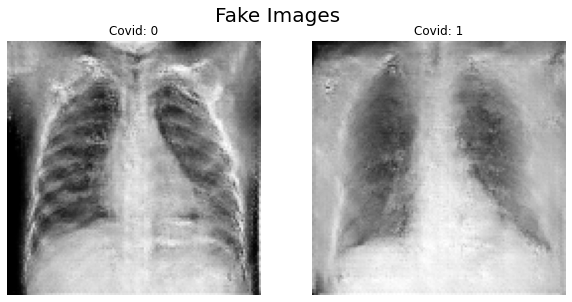

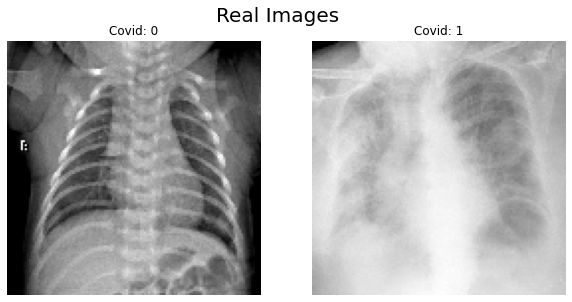

In [ ]:
def generate_images(model_name, r, c, title, latent_dim=100, num_classes=2):
    # load model
    model = load_model('models/'+model_name+'.h5')
    # generate random noise + labels
    noise = np.random.normal(0, 1, (r*c, 100))
    labels = np.array([0, 1])
    # generate images
    imgs = model.predict([noise, labels])
    imgs = 0.5 * imgs + 0.5  # rescale images 0 - 1
    print(imgs.shape)
    plot_images(imgs, labels, r, c, title) # visualize images

# create plot of generated images
def plot_images(imgs, labels, r, c, title):
    fig, axs = plt.subplots(r, c)
    fig.set_figheight(5)
    fig.set_figwidth(10)
    fig.suptitle(title, size=20, y=0.95)
    cnt = 0
    for j in range(c):
      axs[j].imshow(imgs[cnt,:,:,0], cmap='gray')
      axs[j].set_title("Covid: %d" % labels[cnt])
      axs[j].axis('off')
      cnt += 1
    plt.show()
    plt.close()

# generate 2 images COVID and NORMAL from pretrained model
generate_images('final_model', 1, 2, 'Fake Images',)
# choose random COVID and NORMAl image from dataset to compare
rc = random.choice(np.array(np.where(data['y_train'] == 1)).T)
rn = random.choice(np.array(np.where(data['y_train'] == 0)).T)
imgc = data['X_train'][rc[0]]
imgn = data['X_train'][rn[0]]
imgs = np.array([imgn, imgc])

imgs = 0.5 * imgs + 0.5  # rescale images 0 - 1
plot_images(imgs, np.array([0, 1]), 1, 2, "Real Images")

## Subtask 1.2 - Exploring different hyperparameters and outputting generated images


I have split this task into two different tasks as well; training and generating images. Below is the code containing the hyperparameters (params) which will be explored in the 'Training' section below. I will be exploring different epochs, batch sizes and learning rates. The code in the 'Training' section will create a model for each combination hyperparameters and save the trained model (and training images) to their respective folders. Then, the code in the 'Generating Images' will generate a Covid and Normal image for each trained model to be evaluated in the report.

Please note - **I had to split the 'Training' into three instances because the first part wasn't able to explore all the models as the runtime timed out (twice) in Colab.I also had to split the 'Generating Image' into three instances, because the page would crash due to an overload of memory (when all models are uploaded).**

In [ ]:
data = pickle.load(open("preprocessed_data.pkl", "rb"))

# hyperparameters to explore
params = {
    'epochs': [100, 200, 300],
    'batch_size': [16, 32, 64],
    'learning_rate': [0.002, 0.0002, 0.00002],
}

### 1.2.1 - Training (Part 1)

Model: "sequential_18"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_45 (Conv2D)           (None, 64, 64, 128)       4224      
_________________________________________________________________
leaky_re_lu_81 (LeakyReLU)   (None, 64, 64, 128)       0         
_________________________________________________________________
conv2d_46 (Conv2D)           (None, 32, 32, 256)       524544    
_________________________________________________________________
leaky_re_lu_82 (LeakyReLU)   (None, 32, 32, 256)       0         
_________________________________________________________________
conv2d_47 (Conv2D)           (None, 16, 16, 512)       2097664   
_________________________________________________________________
leaky_re_lu_83 (LeakyReLU)   (None, 16, 16, 512)       0         
_________________________________________________________________
conv2d_48 (Conv2D)           (None, 8, 8, 1024)      

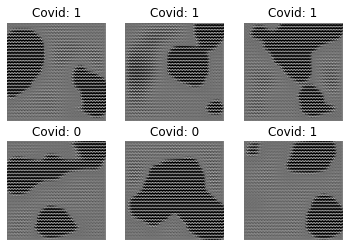

Epoch 2/100 Batch 12/12 [D loss: 361.41415, acc: 87.50%] [G loss: 4449.22412]
Epoch 3/100 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 786.14124]
Epoch 4/100 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 311.08203]
Epoch 5/100 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 422.68207]
Epoch 6/100 Batch 12/12 [D loss: 7.87650, acc: 87.50%] [G loss: 709.74786]
Epoch 7/100 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 5864.31055]
Epoch 8/100 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 955.74182]
Epoch 9/100 Batch 12/12 [D loss: 7.15446, acc: 93.75%] [G loss: 277.52628]
Epoch 10/100 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 301.51123]
Epoch 11/100 Batch 12/12 [D loss: 7.72064, acc: 93.75%] [G loss: 266.97168]
Epoch 12/100 Batch 12/12 [D loss: 4.03006, acc: 93.75%] [G loss: 399.00482]
Epoch 13/100 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 312.25116]
Epoch 14/100 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 73.89268]
Epoch 15/

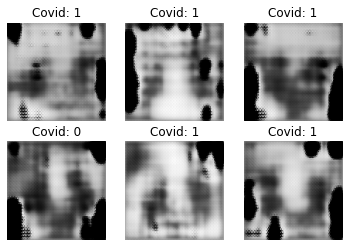

Epoch 22/100 Batch 12/12 [D loss: 9.65949, acc: 62.50%] [G loss: 21.11105]
Epoch 23/100 Batch 12/12 [D loss: 2.53921, acc: 50.00%] [G loss: 23.14272]
Epoch 24/100 Batch 12/12 [D loss: 0.76008, acc: 87.50%] [G loss: 20.70853]
Epoch 25/100 Batch 12/12 [D loss: 0.16096, acc: 93.75%] [G loss: 17.42896]
Epoch 26/100 Batch 12/12 [D loss: 0.00999, acc: 100.00%] [G loss: 27.07247]
Epoch 27/100 Batch 12/12 [D loss: 0.02259, acc: 100.00%] [G loss: 12.13265]
Epoch 28/100 Batch 12/12 [D loss: 2.99764, acc: 68.75%] [G loss: 9.62574]
Epoch 29/100 Batch 12/12 [D loss: 0.21118, acc: 81.25%] [G loss: 8.41587]
Epoch 30/100 Batch 12/12 [D loss: 1.80318, acc: 62.50%] [G loss: 10.64234]
Epoch 31/100 Batch 12/12 [D loss: 0.00910, acc: 100.00%] [G loss: 18.94116]
Epoch 32/100 Batch 12/12 [D loss: 0.09593, acc: 100.00%] [G loss: 13.28526]
Epoch 33/100 Batch 12/12 [D loss: 0.81791, acc: 81.25%] [G loss: 5.40213]
Epoch 34/100 Batch 12/12 [D loss: 0.77503, acc: 93.75%] [G loss: 9.69321]
Epoch 35/100 Batch 12/12 

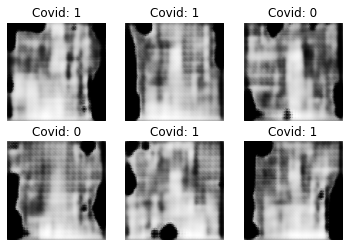

Epoch 42/100 Batch 12/12 [D loss: 0.22026, acc: 87.50%] [G loss: 9.33356]
Epoch 43/100 Batch 12/12 [D loss: 0.94773, acc: 87.50%] [G loss: 9.05105]
Epoch 44/100 Batch 12/12 [D loss: 1.11646, acc: 75.00%] [G loss: 11.74279]
Epoch 45/100 Batch 12/12 [D loss: 0.15790, acc: 93.75%] [G loss: 7.77028]
Epoch 46/100 Batch 12/12 [D loss: 0.26578, acc: 81.25%] [G loss: 8.05559]
Epoch 47/100 Batch 12/12 [D loss: 0.60045, acc: 75.00%] [G loss: 5.57437]
Epoch 48/100 Batch 12/12 [D loss: 0.04028, acc: 100.00%] [G loss: 7.49044]
Epoch 49/100 Batch 12/12 [D loss: 0.33998, acc: 81.25%] [G loss: 10.90298]
Epoch 50/100 Batch 12/12 [D loss: 0.10927, acc: 100.00%] [G loss: 9.26185]
Epoch 51/100 Batch 12/12 [D loss: 0.35381, acc: 87.50%] [G loss: 5.51950]
Epoch 52/100 Batch 12/12 [D loss: 0.47593, acc: 93.75%] [G loss: 4.53035]
Epoch 53/100 Batch 12/12 [D loss: 0.09709, acc: 93.75%] [G loss: 6.40725]
Epoch 54/100 Batch 12/12 [D loss: 0.31339, acc: 81.25%] [G loss: 10.24837]
Epoch 55/100 Batch 12/12 [D loss:

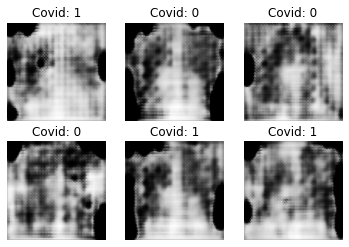

Epoch 62/100 Batch 12/12 [D loss: 1.04469, acc: 62.50%] [G loss: 11.49241]
Epoch 63/100 Batch 12/12 [D loss: 0.30758, acc: 93.75%] [G loss: 7.81658]
Epoch 64/100 Batch 12/12 [D loss: 0.12922, acc: 93.75%] [G loss: 9.67484]
Epoch 65/100 Batch 12/12 [D loss: 0.32308, acc: 87.50%] [G loss: 5.72597]
Epoch 66/100 Batch 12/12 [D loss: 0.07938, acc: 100.00%] [G loss: 5.79639]
Epoch 67/100 Batch 12/12 [D loss: 1.20060, acc: 68.75%] [G loss: 3.65741]
Epoch 68/100 Batch 12/12 [D loss: 0.86586, acc: 56.25%] [G loss: 6.40647]
Epoch 69/100 Batch 12/12 [D loss: 0.07916, acc: 93.75%] [G loss: 5.91931]
Epoch 70/100 Batch 12/12 [D loss: 0.63116, acc: 75.00%] [G loss: 6.51453]
Epoch 71/100 Batch 12/12 [D loss: 0.55996, acc: 75.00%] [G loss: 8.94288]
Epoch 72/100 Batch 12/12 [D loss: 0.34915, acc: 93.75%] [G loss: 5.53834]
Epoch 73/100 Batch 12/12 [D loss: 0.08782, acc: 93.75%] [G loss: 8.80465]
Epoch 74/100 Batch 12/12 [D loss: 0.07859, acc: 100.00%] [G loss: 6.02683]
Epoch 75/100 Batch 12/12 [D loss: 1

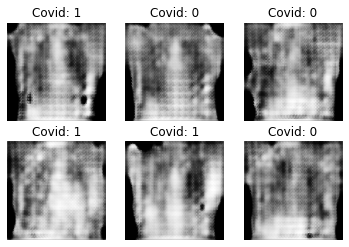

Epoch 82/100 Batch 12/12 [D loss: 0.02709, acc: 100.00%] [G loss: 5.09189]
Epoch 83/100 Batch 12/12 [D loss: 0.03312, acc: 100.00%] [G loss: 5.73344]
Epoch 84/100 Batch 12/12 [D loss: 0.04052, acc: 100.00%] [G loss: 7.68867]
Epoch 85/100 Batch 12/12 [D loss: 0.13985, acc: 93.75%] [G loss: 3.50248]
Epoch 86/100 Batch 12/12 [D loss: 0.37339, acc: 93.75%] [G loss: 5.35561]
Epoch 87/100 Batch 12/12 [D loss: 0.09875, acc: 93.75%] [G loss: 5.58843]
Epoch 88/100 Batch 12/12 [D loss: 0.11189, acc: 93.75%] [G loss: 5.85967]
Epoch 89/100 Batch 12/12 [D loss: 0.03035, acc: 100.00%] [G loss: 6.11601]
Epoch 90/100 Batch 12/12 [D loss: 0.30662, acc: 87.50%] [G loss: 5.92604]
Epoch 91/100 Batch 12/12 [D loss: 0.31275, acc: 87.50%] [G loss: 4.49187]
Epoch 92/100 Batch 12/12 [D loss: 0.19050, acc: 87.50%] [G loss: 6.81828]
Epoch 93/100 Batch 12/12 [D loss: 0.18840, acc: 87.50%] [G loss: 6.13373]
Epoch 94/100 Batch 12/12 [D loss: 0.08371, acc: 100.00%] [G loss: 3.98194]
Epoch 95/100 Batch 12/12 [D loss:

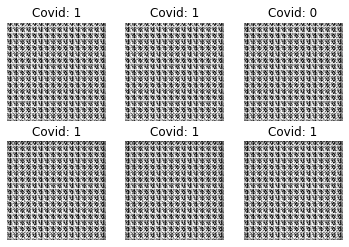

Epoch 2/100 Batch 12/12 [D loss: 0.00023, acc: 100.00%] [G loss: 9.86951]
Epoch 3/100 Batch 12/12 [D loss: 2.21872, acc: 75.00%] [G loss: 3.28419]
Epoch 4/100 Batch 12/12 [D loss: 0.01726, acc: 100.00%] [G loss: 4.47826]
Epoch 5/100 Batch 12/12 [D loss: 0.04358, acc: 100.00%] [G loss: 5.21030]
Epoch 6/100 Batch 12/12 [D loss: 0.01803, acc: 100.00%] [G loss: 6.19517]
Epoch 7/100 Batch 12/12 [D loss: 0.02290, acc: 100.00%] [G loss: 8.40810]
Epoch 8/100 Batch 12/12 [D loss: 0.01774, acc: 100.00%] [G loss: 6.90249]
Epoch 9/100 Batch 12/12 [D loss: 0.45826, acc: 81.25%] [G loss: 1.06154]
Epoch 10/100 Batch 12/12 [D loss: 0.34968, acc: 87.50%] [G loss: 2.03049]
Epoch 11/100 Batch 12/12 [D loss: 0.71645, acc: 56.25%] [G loss: 1.01394]
Epoch 12/100 Batch 12/12 [D loss: 0.70990, acc: 43.75%] [G loss: 1.14043]
Epoch 13/100 Batch 12/12 [D loss: 0.54665, acc: 56.25%] [G loss: 1.13487]
Epoch 14/100 Batch 12/12 [D loss: 0.65883, acc: 68.75%] [G loss: 1.10194]
Epoch 15/100 Batch 12/12 [D loss: 0.6003

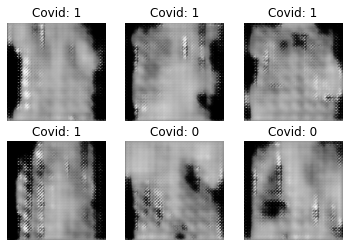

Epoch 22/100 Batch 12/12 [D loss: 0.53531, acc: 68.75%] [G loss: 3.20827]
Epoch 23/100 Batch 12/12 [D loss: 0.35130, acc: 81.25%] [G loss: 1.91695]
Epoch 24/100 Batch 12/12 [D loss: 0.61966, acc: 68.75%] [G loss: 1.64111]
Epoch 25/100 Batch 12/12 [D loss: 0.29594, acc: 93.75%] [G loss: 2.01791]
Epoch 26/100 Batch 12/12 [D loss: 0.51330, acc: 68.75%] [G loss: 1.69252]
Epoch 27/100 Batch 12/12 [D loss: 0.38664, acc: 81.25%] [G loss: 2.47869]
Epoch 28/100 Batch 12/12 [D loss: 0.57677, acc: 68.75%] [G loss: 1.79793]
Epoch 29/100 Batch 12/12 [D loss: 0.31626, acc: 93.75%] [G loss: 1.92169]
Epoch 30/100 Batch 12/12 [D loss: 0.35739, acc: 87.50%] [G loss: 2.47929]
Epoch 31/100 Batch 12/12 [D loss: 0.49265, acc: 75.00%] [G loss: 4.04522]
Epoch 32/100 Batch 12/12 [D loss: 0.42478, acc: 87.50%] [G loss: 1.91050]
Epoch 33/100 Batch 12/12 [D loss: 0.20400, acc: 100.00%] [G loss: 2.20410]
Epoch 34/100 Batch 12/12 [D loss: 0.39457, acc: 81.25%] [G loss: 2.74588]
Epoch 35/100 Batch 12/12 [D loss: 0.4

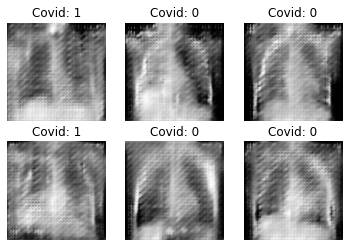

Epoch 42/100 Batch 12/12 [D loss: 0.53788, acc: 81.25%] [G loss: 1.96848]
Epoch 43/100 Batch 12/12 [D loss: 0.18878, acc: 93.75%] [G loss: 2.79234]
Epoch 44/100 Batch 12/12 [D loss: 0.38456, acc: 87.50%] [G loss: 3.33212]
Epoch 45/100 Batch 12/12 [D loss: 0.42558, acc: 75.00%] [G loss: 2.90728]
Epoch 46/100 Batch 12/12 [D loss: 0.65797, acc: 56.25%] [G loss: 2.08638]
Epoch 47/100 Batch 12/12 [D loss: 0.52744, acc: 75.00%] [G loss: 2.56953]
Epoch 48/100 Batch 12/12 [D loss: 0.31193, acc: 100.00%] [G loss: 1.85543]
Epoch 49/100 Batch 12/12 [D loss: 0.20062, acc: 93.75%] [G loss: 2.50468]
Epoch 50/100 Batch 12/12 [D loss: 0.33724, acc: 87.50%] [G loss: 3.01523]
Epoch 51/100 Batch 12/12 [D loss: 0.35605, acc: 93.75%] [G loss: 2.07749]
Epoch 52/100 Batch 12/12 [D loss: 0.38570, acc: 81.25%] [G loss: 2.66140]
Epoch 53/100 Batch 12/12 [D loss: 0.36388, acc: 100.00%] [G loss: 1.73792]
Epoch 54/100 Batch 12/12 [D loss: 0.39236, acc: 87.50%] [G loss: 1.96194]
Epoch 55/100 Batch 12/12 [D loss: 0.

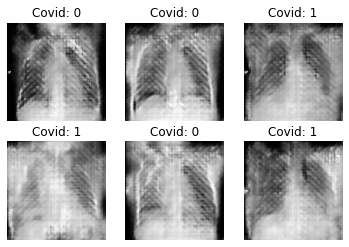

Epoch 62/100 Batch 12/12 [D loss: 0.24382, acc: 93.75%] [G loss: 2.30813]
Epoch 63/100 Batch 12/12 [D loss: 0.33552, acc: 87.50%] [G loss: 3.24168]
Epoch 64/100 Batch 12/12 [D loss: 0.43298, acc: 68.75%] [G loss: 2.13273]
Epoch 65/100 Batch 12/12 [D loss: 0.28762, acc: 87.50%] [G loss: 2.16504]
Epoch 66/100 Batch 12/12 [D loss: 0.52038, acc: 75.00%] [G loss: 1.75711]
Epoch 67/100 Batch 12/12 [D loss: 0.70024, acc: 56.25%] [G loss: 2.35808]
Epoch 68/100 Batch 12/12 [D loss: 0.44625, acc: 75.00%] [G loss: 1.85707]
Epoch 69/100 Batch 12/12 [D loss: 0.38320, acc: 87.50%] [G loss: 2.01028]
Epoch 70/100 Batch 12/12 [D loss: 0.30211, acc: 81.25%] [G loss: 3.16914]
Epoch 71/100 Batch 12/12 [D loss: 0.54723, acc: 75.00%] [G loss: 2.80672]
Epoch 72/100 Batch 12/12 [D loss: 0.58243, acc: 62.50%] [G loss: 1.53255]
Epoch 73/100 Batch 12/12 [D loss: 0.52271, acc: 75.00%] [G loss: 2.68482]
Epoch 74/100 Batch 12/12 [D loss: 0.52470, acc: 68.75%] [G loss: 2.10389]
Epoch 75/100 Batch 12/12 [D loss: 0.78

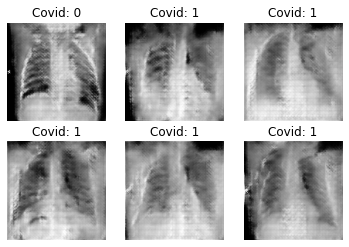

Epoch 82/100 Batch 12/12 [D loss: 0.27458, acc: 87.50%] [G loss: 3.24459]
Epoch 83/100 Batch 12/12 [D loss: 0.27354, acc: 87.50%] [G loss: 2.36607]
Epoch 84/100 Batch 12/12 [D loss: 0.30856, acc: 93.75%] [G loss: 3.28341]
Epoch 85/100 Batch 12/12 [D loss: 0.46519, acc: 87.50%] [G loss: 2.39426]
Epoch 86/100 Batch 12/12 [D loss: 0.56533, acc: 62.50%] [G loss: 2.09676]
Epoch 87/100 Batch 12/12 [D loss: 0.48109, acc: 68.75%] [G loss: 3.03510]
Epoch 88/100 Batch 12/12 [D loss: 0.24840, acc: 87.50%] [G loss: 2.96823]
Epoch 89/100 Batch 12/12 [D loss: 0.26108, acc: 100.00%] [G loss: 3.30511]
Epoch 90/100 Batch 12/12 [D loss: 0.68760, acc: 62.50%] [G loss: 2.58284]
Epoch 91/100 Batch 12/12 [D loss: 0.53931, acc: 56.25%] [G loss: 4.46156]
Epoch 92/100 Batch 12/12 [D loss: 0.31421, acc: 93.75%] [G loss: 2.90527]
Epoch 93/100 Batch 12/12 [D loss: 0.26189, acc: 87.50%] [G loss: 2.67540]
Epoch 94/100 Batch 12/12 [D loss: 0.74235, acc: 56.25%] [G loss: 4.14958]
Epoch 95/100 Batch 12/12 [D loss: 0.4

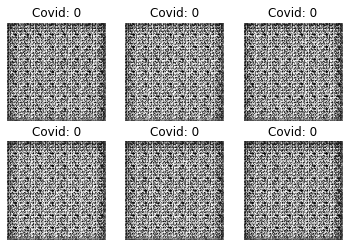

Epoch 2/100 Batch 12/12 [D loss: 0.18290, acc: 100.00%] [G loss: 2.50740]
Epoch 3/100 Batch 12/12 [D loss: 0.43060, acc: 81.25%] [G loss: 2.56742]
Epoch 4/100 Batch 12/12 [D loss: 0.44269, acc: 81.25%] [G loss: 1.92174]
Epoch 5/100 Batch 12/12 [D loss: 0.54888, acc: 81.25%] [G loss: 0.84390]
Epoch 6/100 Batch 12/12 [D loss: 0.52273, acc: 87.50%] [G loss: 1.05255]
Epoch 7/100 Batch 12/12 [D loss: 0.81180, acc: 25.00%] [G loss: 1.00668]
Epoch 8/100 Batch 12/12 [D loss: 0.78110, acc: 37.50%] [G loss: 0.73881]
Epoch 9/100 Batch 12/12 [D loss: 0.64420, acc: 56.25%] [G loss: 0.76980]
Epoch 10/100 Batch 12/12 [D loss: 0.69421, acc: 62.50%] [G loss: 0.87069]
Epoch 11/100 Batch 12/12 [D loss: 0.55670, acc: 75.00%] [G loss: 0.72079]
Epoch 12/100 Batch 12/12 [D loss: 0.67205, acc: 37.50%] [G loss: 0.68436]
Epoch 13/100 Batch 12/12 [D loss: 0.64110, acc: 68.75%] [G loss: 0.83625]
Epoch 14/100 Batch 12/12 [D loss: 0.72522, acc: 62.50%] [G loss: 0.61660]
Epoch 15/100 Batch 12/12 [D loss: 0.66564, ac

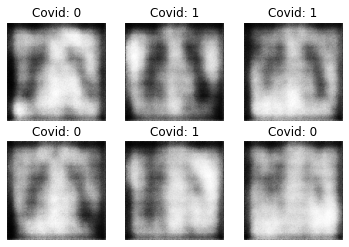

Epoch 22/100 Batch 12/12 [D loss: 0.67250, acc: 68.75%] [G loss: 0.68115]
Epoch 23/100 Batch 12/12 [D loss: 0.75256, acc: 31.25%] [G loss: 0.65149]
Epoch 24/100 Batch 12/12 [D loss: 0.64133, acc: 56.25%] [G loss: 0.71410]
Epoch 25/100 Batch 12/12 [D loss: 0.61240, acc: 50.00%] [G loss: 0.62264]
Epoch 26/100 Batch 12/12 [D loss: 0.76952, acc: 43.75%] [G loss: 0.63031]
Epoch 27/100 Batch 12/12 [D loss: 0.67463, acc: 56.25%] [G loss: 0.65401]
Epoch 28/100 Batch 12/12 [D loss: 0.62543, acc: 68.75%] [G loss: 0.68750]
Epoch 29/100 Batch 12/12 [D loss: 0.71195, acc: 50.00%] [G loss: 0.62741]
Epoch 30/100 Batch 12/12 [D loss: 0.64560, acc: 75.00%] [G loss: 0.70905]
Epoch 31/100 Batch 12/12 [D loss: 0.62841, acc: 43.75%] [G loss: 0.62580]
Epoch 32/100 Batch 12/12 [D loss: 0.67525, acc: 56.25%] [G loss: 0.74166]
Epoch 33/100 Batch 12/12 [D loss: 0.67367, acc: 62.50%] [G loss: 0.67633]
Epoch 34/100 Batch 12/12 [D loss: 0.69603, acc: 43.75%] [G loss: 0.63683]
Epoch 35/100 Batch 12/12 [D loss: 0.64

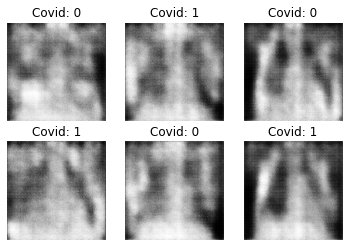

Epoch 42/100 Batch 12/12 [D loss: 0.68196, acc: 62.50%] [G loss: 0.71895]
Epoch 43/100 Batch 12/12 [D loss: 0.66855, acc: 62.50%] [G loss: 0.73842]
Epoch 44/100 Batch 12/12 [D loss: 0.67673, acc: 43.75%] [G loss: 0.70688]
Epoch 45/100 Batch 12/12 [D loss: 0.66011, acc: 56.25%] [G loss: 0.73968]
Epoch 46/100 Batch 12/12 [D loss: 0.69985, acc: 50.00%] [G loss: 0.70532]
Epoch 47/100 Batch 12/12 [D loss: 0.62606, acc: 87.50%] [G loss: 0.71118]
Epoch 48/100 Batch 12/12 [D loss: 0.68242, acc: 62.50%] [G loss: 0.73620]
Epoch 49/100 Batch 12/12 [D loss: 0.68573, acc: 50.00%] [G loss: 0.76126]
Epoch 50/100 Batch 12/12 [D loss: 0.64238, acc: 68.75%] [G loss: 0.74836]
Epoch 51/100 Batch 12/12 [D loss: 0.71088, acc: 56.25%] [G loss: 0.71064]
Epoch 52/100 Batch 12/12 [D loss: 0.61456, acc: 75.00%] [G loss: 0.74640]
Epoch 53/100 Batch 12/12 [D loss: 0.67529, acc: 56.25%] [G loss: 0.80087]
Epoch 54/100 Batch 12/12 [D loss: 0.67471, acc: 56.25%] [G loss: 0.70452]
Epoch 55/100 Batch 12/12 [D loss: 0.57

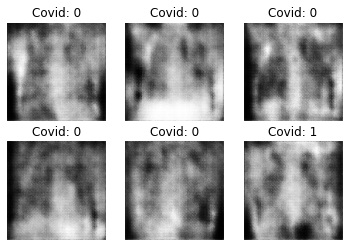

Epoch 62/100 Batch 12/12 [D loss: 0.66358, acc: 43.75%] [G loss: 0.76573]
Epoch 63/100 Batch 12/12 [D loss: 0.63002, acc: 62.50%] [G loss: 0.78008]
Epoch 64/100 Batch 12/12 [D loss: 0.60319, acc: 87.50%] [G loss: 0.96975]
Epoch 65/100 Batch 12/12 [D loss: 0.52120, acc: 93.75%] [G loss: 1.00136]
Epoch 66/100 Batch 12/12 [D loss: 0.53073, acc: 68.75%] [G loss: 1.28975]
Epoch 67/100 Batch 12/12 [D loss: 0.56905, acc: 68.75%] [G loss: 1.18858]
Epoch 68/100 Batch 12/12 [D loss: 0.51651, acc: 81.25%] [G loss: 1.07428]
Epoch 69/100 Batch 12/12 [D loss: 0.50718, acc: 68.75%] [G loss: 1.73384]
Epoch 70/100 Batch 12/12 [D loss: 0.61537, acc: 62.50%] [G loss: 1.27597]
Epoch 71/100 Batch 12/12 [D loss: 0.39664, acc: 87.50%] [G loss: 1.30611]
Epoch 72/100 Batch 12/12 [D loss: 0.45461, acc: 87.50%] [G loss: 1.80605]
Epoch 73/100 Batch 12/12 [D loss: 0.50864, acc: 93.75%] [G loss: 1.25980]
Epoch 74/100 Batch 12/12 [D loss: 0.23847, acc: 100.00%] [G loss: 2.49466]
Epoch 75/100 Batch 12/12 [D loss: 0.5

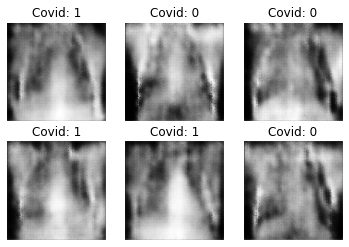

Epoch 82/100 Batch 12/12 [D loss: 0.34511, acc: 100.00%] [G loss: 1.62837]
Epoch 83/100 Batch 12/12 [D loss: 0.53758, acc: 81.25%] [G loss: 1.54606]
Epoch 84/100 Batch 12/12 [D loss: 0.74519, acc: 37.50%] [G loss: 0.77468]
Epoch 85/100 Batch 12/12 [D loss: 0.79033, acc: 31.25%] [G loss: 0.55483]
Epoch 86/100 Batch 12/12 [D loss: 0.65908, acc: 56.25%] [G loss: 0.68796]
Epoch 87/100 Batch 12/12 [D loss: 0.69224, acc: 50.00%] [G loss: 0.68964]
Epoch 88/100 Batch 12/12 [D loss: 0.48315, acc: 93.75%] [G loss: 0.82649]
Epoch 89/100 Batch 12/12 [D loss: 0.50355, acc: 93.75%] [G loss: 0.95234]
Epoch 90/100 Batch 12/12 [D loss: 0.51439, acc: 75.00%] [G loss: 0.87567]
Epoch 91/100 Batch 12/12 [D loss: 0.65912, acc: 56.25%] [G loss: 0.70058]
Epoch 92/100 Batch 12/12 [D loss: 0.59985, acc: 87.50%] [G loss: 0.93662]
Epoch 93/100 Batch 12/12 [D loss: 0.51155, acc: 75.00%] [G loss: 1.22582]
Epoch 94/100 Batch 12/12 [D loss: 0.51075, acc: 87.50%] [G loss: 1.05905]
Epoch 95/100 Batch 12/12 [D loss: 0.6

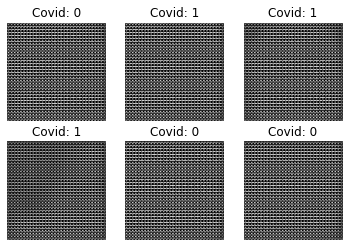

Epoch 2/100 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 251.04848]
Epoch 3/100 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 201.30112]
Epoch 4/100 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 188.83154]
Epoch 5/100 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 187.02533]
Epoch 6/100 Batch 6/6 [D loss: 9.41483, acc: 50.00%] [G loss: 2218.63916]
Epoch 7/100 Batch 6/6 [D loss: 92.15619, acc: 78.12%] [G loss: 52.29185]
Epoch 8/100 Batch 6/6 [D loss: 316.93076, acc: 56.25%] [G loss: 10214.13477]
Epoch 9/100 Batch 6/6 [D loss: 24.93575, acc: 93.75%] [G loss: 2859.58496]
Epoch 10/100 Batch 6/6 [D loss: 561017.12500, acc: 53.12%] [G loss: 26859.64258]
Epoch 11/100 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 122724.67188]
Epoch 12/100 Batch 6/6 [D loss: 4259.42383, acc: 65.62%] [G loss: 181239.60938]
Epoch 13/100 Batch 6/6 [D loss: 9.65839, acc: 96.88%] [G loss: 42085.58594]
Epoch 14/100 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 26386.64453]
Epoch 15/100 

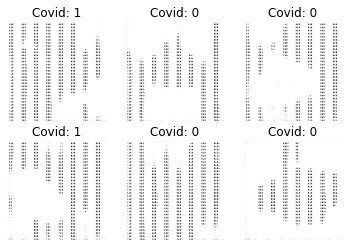

Epoch 22/100 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 13065.77246]
Epoch 23/100 Batch 6/6 [D loss: 12.76536, acc: 96.88%] [G loss: 4087.19971]
Epoch 24/100 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 53881.14062]
Epoch 25/100 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 33760.46094]
Epoch 26/100 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 25775.50195]
Epoch 27/100 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 16409.58008]
Epoch 28/100 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 15582.57812]
Epoch 29/100 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 16415.39453]
Epoch 30/100 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 16414.27734]
Epoch 31/100 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 17635.82812]
Epoch 32/100 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 14037.06348]
Epoch 33/100 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 13650.68164]
Epoch 34/100 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 13180.33398]


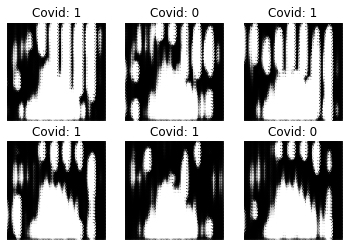

Epoch 42/100 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 11975.62988]
Epoch 43/100 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 9369.75977]
Epoch 44/100 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 7809.58594]
Epoch 45/100 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 12865.23828]
Epoch 46/100 Batch 6/6 [D loss: 224.55450, acc: 96.88%] [G loss: 7970.47900]
Epoch 47/100 Batch 6/6 [D loss: 56.46469, acc: 96.88%] [G loss: 8088.49268]
Epoch 48/100 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 16906.56641]
Epoch 49/100 Batch 6/6 [D loss: 172.99808, acc: 96.88%] [G loss: 9966.96680]
Epoch 50/100 Batch 6/6 [D loss: 150.22278, acc: 93.75%] [G loss: 7314.05273]
Epoch 51/100 Batch 6/6 [D loss: 42.13954, acc: 93.75%] [G loss: 4810.37695]
Epoch 52/100 Batch 6/6 [D loss: 142.39145, acc: 93.75%] [G loss: 10719.12891]
Epoch 53/100 Batch 6/6 [D loss: 321.90320, acc: 87.50%] [G loss: 7651.21973]
Epoch 54/100 Batch 6/6 [D loss: 178.69998, acc: 78.12%] [G loss: 7356.22852]
Ep

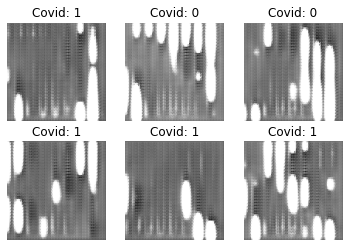

Epoch 62/100 Batch 6/6 [D loss: 19.47137, acc: 96.88%] [G loss: 1513.99976]
Epoch 63/100 Batch 6/6 [D loss: 5.65597, acc: 96.88%] [G loss: 1365.93604]
Epoch 64/100 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 742.95892]
Epoch 65/100 Batch 6/6 [D loss: 14.45107, acc: 87.50%] [G loss: 1239.17017]
Epoch 66/100 Batch 6/6 [D loss: 313.16290, acc: 71.88%] [G loss: 1532.34180]
Epoch 67/100 Batch 6/6 [D loss: 11.37404, acc: 96.88%] [G loss: 2927.80469]
Epoch 68/100 Batch 6/6 [D loss: 16.15020, acc: 93.75%] [G loss: 1111.17603]
Epoch 69/100 Batch 6/6 [D loss: 6.35927, acc: 96.88%] [G loss: 1061.70154]
Epoch 70/100 Batch 6/6 [D loss: 336.75293, acc: 78.12%] [G loss: 371.97995]
Epoch 71/100 Batch 6/6 [D loss: 107.92729, acc: 75.00%] [G loss: 969.61487]
Epoch 72/100 Batch 6/6 [D loss: 14.59399, acc: 90.62%] [G loss: 2774.02197]
Epoch 73/100 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 2873.34717]
Epoch 74/100 Batch 6/6 [D loss: 2.35728, acc: 96.88%] [G loss: 698.66455]
Epoch 75/100 Bat

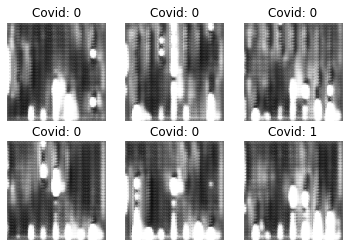

Epoch 82/100 Batch 6/6 [D loss: 35.48891, acc: 93.75%] [G loss: 1334.36414]
Epoch 83/100 Batch 6/6 [D loss: 10.63864, acc: 96.88%] [G loss: 538.60522]
Epoch 84/100 Batch 6/6 [D loss: 35.60084, acc: 81.25%] [G loss: 896.52588]
Epoch 85/100 Batch 6/6 [D loss: 10.58354, acc: 93.75%] [G loss: 661.59515]
Epoch 86/100 Batch 6/6 [D loss: 26.13581, acc: 87.50%] [G loss: 591.67749]
Epoch 87/100 Batch 6/6 [D loss: 24.50446, acc: 87.50%] [G loss: 799.05273]
Epoch 88/100 Batch 6/6 [D loss: 562.15800, acc: 25.00%] [G loss: 787.53082]
Epoch 89/100 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 926.05438]
Epoch 90/100 Batch 6/6 [D loss: 6.79367, acc: 96.88%] [G loss: 1393.33398]
Epoch 91/100 Batch 6/6 [D loss: 24.59288, acc: 93.75%] [G loss: 985.50104]
Epoch 92/100 Batch 6/6 [D loss: 5.87701, acc: 96.88%] [G loss: 739.72241]
Epoch 93/100 Batch 6/6 [D loss: 13.39478, acc: 87.50%] [G loss: 959.02325]
Epoch 94/100 Batch 6/6 [D loss: 36.67134, acc: 84.38%] [G loss: 781.17957]
Epoch 95/100 Batch 6/6 [

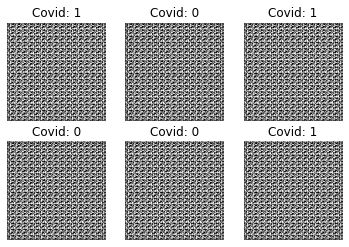

Epoch 2/100 Batch 6/6 [D loss: 0.00108, acc: 100.00%] [G loss: 12.41097]
Epoch 3/100 Batch 6/6 [D loss: 0.02759, acc: 96.88%] [G loss: 6.12688]
Epoch 4/100 Batch 6/6 [D loss: 0.01099, acc: 100.00%] [G loss: 8.26188]
Epoch 5/100 Batch 6/6 [D loss: 0.10172, acc: 100.00%] [G loss: 3.77231]
Epoch 6/100 Batch 6/6 [D loss: 0.04426, acc: 100.00%] [G loss: 3.63588]
Epoch 7/100 Batch 6/6 [D loss: 0.30107, acc: 90.62%] [G loss: 27.15980]
Epoch 8/100 Batch 6/6 [D loss: 0.05040, acc: 100.00%] [G loss: 3.60733]
Epoch 9/100 Batch 6/6 [D loss: 0.04837, acc: 100.00%] [G loss: 4.99877]
Epoch 10/100 Batch 6/6 [D loss: 0.02989, acc: 96.88%] [G loss: 7.07905]
Epoch 11/100 Batch 6/6 [D loss: 0.15958, acc: 90.62%] [G loss: 27.42202]
Epoch 12/100 Batch 6/6 [D loss: 0.52059, acc: 75.00%] [G loss: 7.93163]
Epoch 13/100 Batch 6/6 [D loss: 0.03764, acc: 100.00%] [G loss: 3.80941]
Epoch 14/100 Batch 6/6 [D loss: 0.01035, acc: 100.00%] [G loss: 5.21081]
Epoch 15/100 Batch 6/6 [D loss: 0.03096, acc: 100.00%] [G los

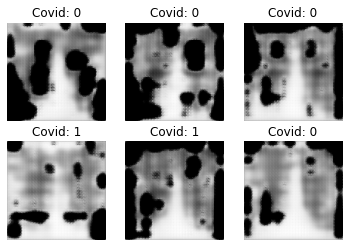

Epoch 22/100 Batch 6/6 [D loss: 0.47759, acc: 78.12%] [G loss: 1.90543]
Epoch 23/100 Batch 6/6 [D loss: 0.45286, acc: 87.50%] [G loss: 1.67061]
Epoch 24/100 Batch 6/6 [D loss: 0.65252, acc: 71.88%] [G loss: 1.43645]
Epoch 25/100 Batch 6/6 [D loss: 0.37909, acc: 87.50%] [G loss: 1.78995]
Epoch 26/100 Batch 6/6 [D loss: 0.33145, acc: 93.75%] [G loss: 1.96639]
Epoch 27/100 Batch 6/6 [D loss: 0.30972, acc: 93.75%] [G loss: 1.64333]
Epoch 28/100 Batch 6/6 [D loss: 0.43767, acc: 75.00%] [G loss: 2.99088]
Epoch 29/100 Batch 6/6 [D loss: 0.69848, acc: 71.88%] [G loss: 3.08087]
Epoch 30/100 Batch 6/6 [D loss: 0.30965, acc: 93.75%] [G loss: 1.68886]
Epoch 31/100 Batch 6/6 [D loss: 0.34361, acc: 90.62%] [G loss: 3.04205]
Epoch 32/100 Batch 6/6 [D loss: 0.40693, acc: 90.62%] [G loss: 1.75673]
Epoch 33/100 Batch 6/6 [D loss: 0.46760, acc: 68.75%] [G loss: 2.38419]
Epoch 34/100 Batch 6/6 [D loss: 0.24546, acc: 93.75%] [G loss: 2.16127]
Epoch 35/100 Batch 6/6 [D loss: 0.26663, acc: 87.50%] [G loss: 2

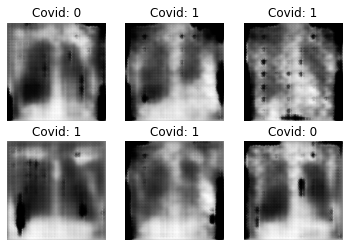

Epoch 42/100 Batch 6/6 [D loss: 0.18859, acc: 90.62%] [G loss: 3.26338]
Epoch 43/100 Batch 6/6 [D loss: 0.30831, acc: 87.50%] [G loss: 2.94249]
Epoch 44/100 Batch 6/6 [D loss: 0.26365, acc: 96.88%] [G loss: 2.44960]
Epoch 45/100 Batch 6/6 [D loss: 0.54928, acc: 71.88%] [G loss: 2.25341]
Epoch 46/100 Batch 6/6 [D loss: 0.25940, acc: 90.62%] [G loss: 2.84079]
Epoch 47/100 Batch 6/6 [D loss: 0.39127, acc: 87.50%] [G loss: 1.65305]
Epoch 48/100 Batch 6/6 [D loss: 0.37415, acc: 87.50%] [G loss: 2.42790]
Epoch 49/100 Batch 6/6 [D loss: 0.46079, acc: 81.25%] [G loss: 2.23821]
Epoch 50/100 Batch 6/6 [D loss: 0.47119, acc: 78.12%] [G loss: 2.33834]
Epoch 51/100 Batch 6/6 [D loss: 0.24456, acc: 90.62%] [G loss: 2.98375]
Epoch 52/100 Batch 6/6 [D loss: 0.24183, acc: 96.88%] [G loss: 2.98032]
Epoch 53/100 Batch 6/6 [D loss: 0.29934, acc: 90.62%] [G loss: 2.47592]
Epoch 54/100 Batch 6/6 [D loss: 0.20768, acc: 96.88%] [G loss: 2.65514]
Epoch 55/100 Batch 6/6 [D loss: 0.55128, acc: 68.75%] [G loss: 4

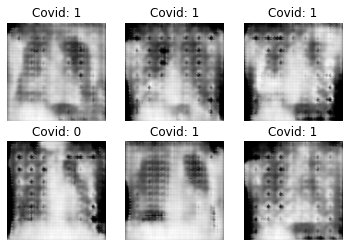

Epoch 62/100 Batch 6/6 [D loss: 0.30971, acc: 87.50%] [G loss: 4.76869]
Epoch 63/100 Batch 6/6 [D loss: 0.25885, acc: 90.62%] [G loss: 3.52957]
Epoch 64/100 Batch 6/6 [D loss: 0.26482, acc: 87.50%] [G loss: 2.60391]
Epoch 65/100 Batch 6/6 [D loss: 0.29472, acc: 93.75%] [G loss: 2.86806]
Epoch 66/100 Batch 6/6 [D loss: 0.20648, acc: 93.75%] [G loss: 2.55092]
Epoch 67/100 Batch 6/6 [D loss: 0.38929, acc: 84.38%] [G loss: 2.97312]
Epoch 68/100 Batch 6/6 [D loss: 0.25927, acc: 90.62%] [G loss: 4.02530]
Epoch 69/100 Batch 6/6 [D loss: 0.41494, acc: 78.12%] [G loss: 3.56341]
Epoch 70/100 Batch 6/6 [D loss: 0.15352, acc: 93.75%] [G loss: 3.43829]
Epoch 71/100 Batch 6/6 [D loss: 0.34981, acc: 81.25%] [G loss: 2.54460]
Epoch 72/100 Batch 6/6 [D loss: 0.26460, acc: 87.50%] [G loss: 3.12181]
Epoch 73/100 Batch 6/6 [D loss: 0.29956, acc: 90.62%] [G loss: 2.50492]
Epoch 74/100 Batch 6/6 [D loss: 0.40337, acc: 84.38%] [G loss: 3.97704]
Epoch 75/100 Batch 6/6 [D loss: 0.35501, acc: 81.25%] [G loss: 2

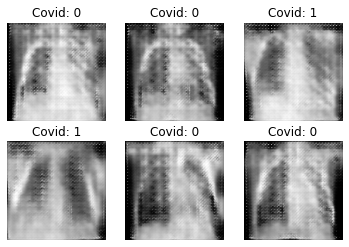

Epoch 82/100 Batch 6/6 [D loss: 0.18008, acc: 93.75%] [G loss: 7.04098]
Epoch 83/100 Batch 6/6 [D loss: 0.35966, acc: 87.50%] [G loss: 3.17246]
Epoch 84/100 Batch 6/6 [D loss: 0.60006, acc: 65.62%] [G loss: 3.82777]
Epoch 85/100 Batch 6/6 [D loss: 0.18389, acc: 100.00%] [G loss: 2.78662]
Epoch 86/100 Batch 6/6 [D loss: 0.32215, acc: 90.62%] [G loss: 4.94903]
Epoch 87/100 Batch 6/6 [D loss: 0.44857, acc: 81.25%] [G loss: 5.98644]
Epoch 88/100 Batch 6/6 [D loss: 0.28786, acc: 93.75%] [G loss: 3.39184]
Epoch 89/100 Batch 6/6 [D loss: 0.38057, acc: 78.12%] [G loss: 3.49227]
Epoch 90/100 Batch 6/6 [D loss: 0.15455, acc: 96.88%] [G loss: 3.48738]
Epoch 91/100 Batch 6/6 [D loss: 0.33408, acc: 81.25%] [G loss: 3.35860]
Epoch 92/100 Batch 6/6 [D loss: 0.37709, acc: 75.00%] [G loss: 3.95440]
Epoch 93/100 Batch 6/6 [D loss: 0.26747, acc: 84.38%] [G loss: 3.27548]
Epoch 94/100 Batch 6/6 [D loss: 0.35370, acc: 87.50%] [G loss: 3.48605]
Epoch 95/100 Batch 6/6 [D loss: 0.39881, acc: 71.88%] [G loss: 

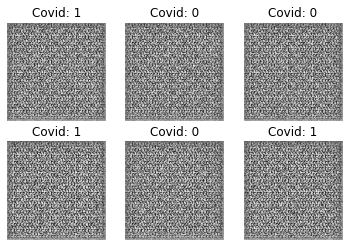

Epoch 2/100 Batch 6/6 [D loss: 0.50874, acc: 100.00%] [G loss: 0.92103]
Epoch 3/100 Batch 6/6 [D loss: 0.31430, acc: 100.00%] [G loss: 1.54811]
Epoch 4/100 Batch 6/6 [D loss: 0.28195, acc: 100.00%] [G loss: 1.86716]
Epoch 5/100 Batch 6/6 [D loss: 0.35664, acc: 93.75%] [G loss: 1.96381]
Epoch 6/100 Batch 6/6 [D loss: 0.44154, acc: 81.25%] [G loss: 2.54892]
Epoch 7/100 Batch 6/6 [D loss: 0.48831, acc: 75.00%] [G loss: 1.59716]
Epoch 8/100 Batch 6/6 [D loss: 0.61502, acc: 62.50%] [G loss: 0.60452]
Epoch 9/100 Batch 6/6 [D loss: 0.71043, acc: 78.12%] [G loss: 1.85272]
Epoch 10/100 Batch 6/6 [D loss: 0.62660, acc: 59.38%] [G loss: 1.68316]
Epoch 11/100 Batch 6/6 [D loss: 0.60110, acc: 75.00%] [G loss: 1.37062]
Epoch 12/100 Batch 6/6 [D loss: 0.65549, acc: 56.25%] [G loss: 1.28369]
Epoch 13/100 Batch 6/6 [D loss: 0.98044, acc: 25.00%] [G loss: 0.88923]
Epoch 14/100 Batch 6/6 [D loss: 0.71397, acc: 50.00%] [G loss: 0.76294]
Epoch 15/100 Batch 6/6 [D loss: 0.71782, acc: 56.25%] [G loss: 0.9479

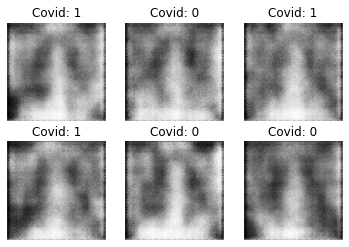

Epoch 22/100 Batch 6/6 [D loss: 0.70519, acc: 50.00%] [G loss: 0.67984]
Epoch 23/100 Batch 6/6 [D loss: 0.58201, acc: 87.50%] [G loss: 0.85293]
Epoch 24/100 Batch 6/6 [D loss: 0.45859, acc: 90.62%] [G loss: 0.99624]
Epoch 25/100 Batch 6/6 [D loss: 0.37144, acc: 100.00%] [G loss: 0.88986]
Epoch 26/100 Batch 6/6 [D loss: 0.62537, acc: 59.38%] [G loss: 0.34127]
Epoch 27/100 Batch 6/6 [D loss: 0.85553, acc: 37.50%] [G loss: 0.54526]
Epoch 28/100 Batch 6/6 [D loss: 0.77731, acc: 37.50%] [G loss: 0.73825]
Epoch 29/100 Batch 6/6 [D loss: 0.68387, acc: 65.62%] [G loss: 0.91113]
Epoch 30/100 Batch 6/6 [D loss: 0.56051, acc: 87.50%] [G loss: 0.94738]
Epoch 31/100 Batch 6/6 [D loss: 0.65192, acc: 68.75%] [G loss: 0.71664]
Epoch 32/100 Batch 6/6 [D loss: 0.71745, acc: 43.75%] [G loss: 0.59681]
Epoch 33/100 Batch 6/6 [D loss: 0.63585, acc: 50.00%] [G loss: 0.70791]
Epoch 34/100 Batch 6/6 [D loss: 0.68191, acc: 62.50%] [G loss: 0.61480]
Epoch 35/100 Batch 6/6 [D loss: 0.67011, acc: 59.38%] [G loss: 

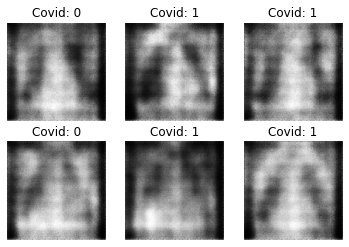

Epoch 42/100 Batch 6/6 [D loss: 0.67460, acc: 56.25%] [G loss: 0.79015]
Epoch 43/100 Batch 6/6 [D loss: 0.74211, acc: 40.62%] [G loss: 0.58254]
Epoch 44/100 Batch 6/6 [D loss: 0.70973, acc: 40.62%] [G loss: 0.58862]
Epoch 45/100 Batch 6/6 [D loss: 0.71807, acc: 50.00%] [G loss: 0.60845]
Epoch 46/100 Batch 6/6 [D loss: 0.71578, acc: 40.62%] [G loss: 0.64372]
Epoch 47/100 Batch 6/6 [D loss: 0.66140, acc: 53.12%] [G loss: 0.71020]
Epoch 48/100 Batch 6/6 [D loss: 0.66827, acc: 50.00%] [G loss: 0.73518]
Epoch 49/100 Batch 6/6 [D loss: 0.69743, acc: 53.12%] [G loss: 0.72741]
Epoch 50/100 Batch 6/6 [D loss: 0.69848, acc: 37.50%] [G loss: 0.64423]
Epoch 51/100 Batch 6/6 [D loss: 0.69830, acc: 43.75%] [G loss: 0.65141]
Epoch 52/100 Batch 6/6 [D loss: 0.68178, acc: 50.00%] [G loss: 0.67687]
Epoch 53/100 Batch 6/6 [D loss: 0.66224, acc: 53.12%] [G loss: 0.71851]
Epoch 54/100 Batch 6/6 [D loss: 0.62989, acc: 71.88%] [G loss: 0.71431]
Epoch 55/100 Batch 6/6 [D loss: 0.62916, acc: 78.12%] [G loss: 0

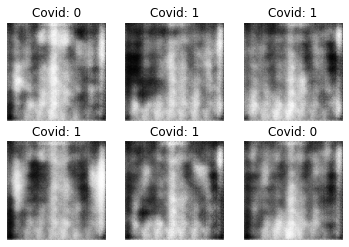

Epoch 62/100 Batch 6/6 [D loss: 0.62615, acc: 65.62%] [G loss: 0.73538]
Epoch 63/100 Batch 6/6 [D loss: 0.66817, acc: 53.12%] [G loss: 0.64693]
Epoch 64/100 Batch 6/6 [D loss: 0.66829, acc: 53.12%] [G loss: 0.71032]
Epoch 65/100 Batch 6/6 [D loss: 0.63263, acc: 65.62%] [G loss: 0.73941]
Epoch 66/100 Batch 6/6 [D loss: 0.64899, acc: 62.50%] [G loss: 0.60620]
Epoch 67/100 Batch 6/6 [D loss: 0.66586, acc: 53.12%] [G loss: 0.68665]
Epoch 68/100 Batch 6/6 [D loss: 0.68031, acc: 62.50%] [G loss: 0.64548]
Epoch 69/100 Batch 6/6 [D loss: 0.72469, acc: 34.38%] [G loss: 0.69788]
Epoch 70/100 Batch 6/6 [D loss: 0.58342, acc: 87.50%] [G loss: 0.85332]
Epoch 71/100 Batch 6/6 [D loss: 0.62385, acc: 62.50%] [G loss: 0.75157]
Epoch 72/100 Batch 6/6 [D loss: 0.70150, acc: 43.75%] [G loss: 0.76172]
Epoch 73/100 Batch 6/6 [D loss: 0.71569, acc: 40.62%] [G loss: 0.68435]
Epoch 74/100 Batch 6/6 [D loss: 0.65116, acc: 68.75%] [G loss: 0.78504]
Epoch 75/100 Batch 6/6 [D loss: 0.61297, acc: 78.12%] [G loss: 0

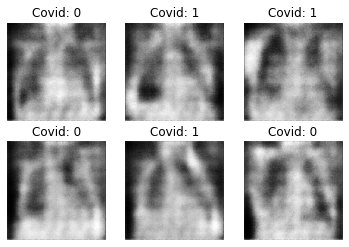

Epoch 82/100 Batch 6/6 [D loss: 0.70028, acc: 46.88%] [G loss: 0.67347]
Epoch 83/100 Batch 6/6 [D loss: 0.66927, acc: 43.75%] [G loss: 0.67297]
Epoch 84/100 Batch 6/6 [D loss: 0.64611, acc: 59.38%] [G loss: 0.67790]
Epoch 85/100 Batch 6/6 [D loss: 0.66226, acc: 53.12%] [G loss: 0.66782]
Epoch 86/100 Batch 6/6 [D loss: 0.67073, acc: 56.25%] [G loss: 0.68015]
Epoch 87/100 Batch 6/6 [D loss: 0.65198, acc: 62.50%] [G loss: 0.71357]
Epoch 88/100 Batch 6/6 [D loss: 0.65431, acc: 65.62%] [G loss: 0.74762]
Epoch 89/100 Batch 6/6 [D loss: 0.68802, acc: 40.62%] [G loss: 0.70002]
Epoch 90/100 Batch 6/6 [D loss: 0.67446, acc: 40.62%] [G loss: 0.67570]
Epoch 91/100 Batch 6/6 [D loss: 0.66005, acc: 56.25%] [G loss: 0.70245]
Epoch 92/100 Batch 6/6 [D loss: 0.63986, acc: 68.75%] [G loss: 0.73505]
Epoch 93/100 Batch 6/6 [D loss: 0.64974, acc: 65.62%] [G loss: 0.74909]
Epoch 94/100 Batch 6/6 [D loss: 0.64831, acc: 62.50%] [G loss: 0.72013]
Epoch 95/100 Batch 6/6 [D loss: 0.67631, acc: 53.12%] [G loss: 0

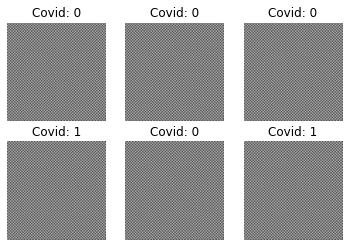

Epoch 2/100 Batch 3/3 [D loss: 324.94086, acc: 50.00%] [G loss: 333.25204]
Epoch 3/100 Batch 3/3 [D loss: 3.59320, acc: 89.06%] [G loss: 559.65576]
Epoch 4/100 Batch 3/3 [D loss: 1.48840, acc: 89.06%] [G loss: 428.01773]
Epoch 5/100 Batch 3/3 [D loss: 1.99510, acc: 95.31%] [G loss: 193.37958]
Epoch 6/100 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 127.96072]
Epoch 7/100 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 15.94284]
Epoch 8/100 Batch 3/3 [D loss: 2.57120, acc: 71.88%] [G loss: 143.59433]
Epoch 9/100 Batch 3/3 [D loss: 1.98884, acc: 95.31%] [G loss: 34.81228]
Epoch 10/100 Batch 3/3 [D loss: 0.09645, acc: 98.44%] [G loss: 69.24669]
Epoch 11/100 Batch 3/3 [D loss: 0.97519, acc: 93.75%] [G loss: 16.78532]
Epoch 12/100 Batch 3/3 [D loss: 3.58983, acc: 76.56%] [G loss: 15.11584]
Epoch 13/100 Batch 3/3 [D loss: 0.04126, acc: 98.44%] [G loss: 12.83485]
Epoch 14/100 Batch 3/3 [D loss: 0.04927, acc: 96.88%] [G loss: 7.38985]
Epoch 15/100 Batch 3/3 [D loss: 0.43113, acc: 95.3

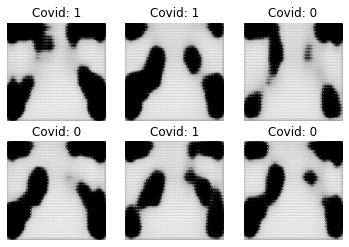

Epoch 22/100 Batch 3/3 [D loss: 0.18366, acc: 95.31%] [G loss: 7.23325]
Epoch 23/100 Batch 3/3 [D loss: 0.10917, acc: 98.44%] [G loss: 5.62507]
Epoch 24/100 Batch 3/3 [D loss: 0.47888, acc: 82.81%] [G loss: 7.02132]
Epoch 25/100 Batch 3/3 [D loss: 0.33737, acc: 92.19%] [G loss: 5.85545]
Epoch 26/100 Batch 3/3 [D loss: 0.13463, acc: 96.88%] [G loss: 4.71716]
Epoch 27/100 Batch 3/3 [D loss: 0.24145, acc: 90.62%] [G loss: 5.90450]
Epoch 28/100 Batch 3/3 [D loss: 0.15702, acc: 95.31%] [G loss: 4.10285]
Epoch 29/100 Batch 3/3 [D loss: 0.06947, acc: 98.44%] [G loss: 3.55342]
Epoch 30/100 Batch 3/3 [D loss: 0.06428, acc: 100.00%] [G loss: 4.76713]
Epoch 31/100 Batch 3/3 [D loss: 0.11484, acc: 96.88%] [G loss: 4.47087]
Epoch 32/100 Batch 3/3 [D loss: 0.09515, acc: 98.44%] [G loss: 3.76515]
Epoch 33/100 Batch 3/3 [D loss: 0.29132, acc: 93.75%] [G loss: 3.65341]
Epoch 34/100 Batch 3/3 [D loss: 0.14741, acc: 98.44%] [G loss: 5.44803]
Epoch 35/100 Batch 3/3 [D loss: 0.00906, acc: 100.00%] [G loss:

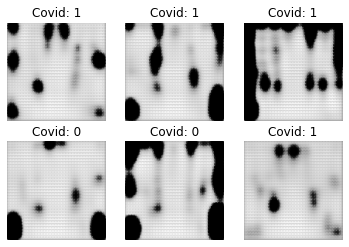

Epoch 42/100 Batch 3/3 [D loss: 0.50867, acc: 87.50%] [G loss: 5.69296]
Epoch 43/100 Batch 3/3 [D loss: 0.53077, acc: 90.62%] [G loss: 3.15831]
Epoch 44/100 Batch 3/3 [D loss: 0.84859, acc: 71.88%] [G loss: 9.96608]
Epoch 45/100 Batch 3/3 [D loss: 0.29629, acc: 89.06%] [G loss: 3.99158]
Epoch 46/100 Batch 3/3 [D loss: 0.15246, acc: 93.75%] [G loss: 6.68250]
Epoch 47/100 Batch 3/3 [D loss: 0.75087, acc: 62.50%] [G loss: 6.41323]
Epoch 48/100 Batch 3/3 [D loss: 0.42261, acc: 81.25%] [G loss: 1.89809]
Epoch 49/100 Batch 3/3 [D loss: 1.74463, acc: 53.12%] [G loss: 11.35112]
Epoch 50/100 Batch 3/3 [D loss: 0.50889, acc: 71.88%] [G loss: 6.28365]
Epoch 51/100 Batch 3/3 [D loss: 0.41826, acc: 78.12%] [G loss: 4.04227]
Epoch 52/100 Batch 3/3 [D loss: 0.28411, acc: 82.81%] [G loss: 17.49921]
Epoch 53/100 Batch 3/3 [D loss: 2.42893, acc: 53.12%] [G loss: 12.94116]
Epoch 54/100 Batch 3/3 [D loss: 0.09416, acc: 100.00%] [G loss: 4.86024]
Epoch 55/100 Batch 3/3 [D loss: 0.14174, acc: 95.31%] [G los

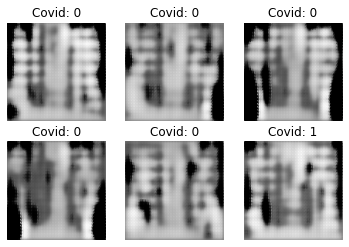

Epoch 62/100 Batch 3/3 [D loss: 0.33942, acc: 89.06%] [G loss: 2.45449]
Epoch 63/100 Batch 3/3 [D loss: 0.38161, acc: 87.50%] [G loss: 3.01874]
Epoch 64/100 Batch 3/3 [D loss: 0.32253, acc: 87.50%] [G loss: 3.65522]
Epoch 65/100 Batch 3/3 [D loss: 0.26696, acc: 95.31%] [G loss: 2.63949]
Epoch 66/100 Batch 3/3 [D loss: 0.27594, acc: 93.75%] [G loss: 2.60782]
Epoch 67/100 Batch 3/3 [D loss: 0.42062, acc: 79.69%] [G loss: 2.55461]
Epoch 68/100 Batch 3/3 [D loss: 0.54065, acc: 76.56%] [G loss: 7.69681]
Epoch 69/100 Batch 3/3 [D loss: 0.25151, acc: 96.88%] [G loss: 4.18464]
Epoch 70/100 Batch 3/3 [D loss: 0.50400, acc: 76.56%] [G loss: 2.92989]
Epoch 71/100 Batch 3/3 [D loss: 0.23070, acc: 90.62%] [G loss: 2.94385]
Epoch 72/100 Batch 3/3 [D loss: 0.24679, acc: 87.50%] [G loss: 2.60591]
Epoch 73/100 Batch 3/3 [D loss: 0.33840, acc: 84.38%] [G loss: 3.01612]
Epoch 74/100 Batch 3/3 [D loss: 0.28940, acc: 90.62%] [G loss: 3.88417]
Epoch 75/100 Batch 3/3 [D loss: 0.25682, acc: 92.19%] [G loss: 2

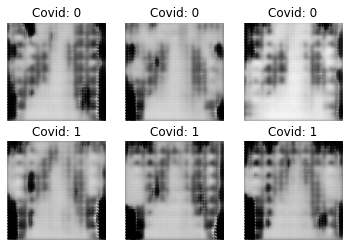

Epoch 82/100 Batch 3/3 [D loss: 0.60872, acc: 62.50%] [G loss: 3.84870]
Epoch 83/100 Batch 3/3 [D loss: 0.17436, acc: 95.31%] [G loss: 4.14619]
Epoch 84/100 Batch 3/3 [D loss: 0.81240, acc: 57.81%] [G loss: 4.42519]
Epoch 85/100 Batch 3/3 [D loss: 0.51209, acc: 76.56%] [G loss: 4.24287]
Epoch 86/100 Batch 3/3 [D loss: 0.59710, acc: 78.12%] [G loss: 10.30319]
Epoch 87/100 Batch 3/3 [D loss: 0.10354, acc: 100.00%] [G loss: 4.35256]
Epoch 88/100 Batch 3/3 [D loss: 0.16067, acc: 93.75%] [G loss: 3.17325]
Epoch 89/100 Batch 3/3 [D loss: 0.47627, acc: 89.06%] [G loss: 2.60402]
Epoch 90/100 Batch 3/3 [D loss: 0.30438, acc: 89.06%] [G loss: 2.57133]
Epoch 91/100 Batch 3/3 [D loss: 0.29174, acc: 89.06%] [G loss: 3.43527]
Epoch 92/100 Batch 3/3 [D loss: 0.45836, acc: 81.25%] [G loss: 3.46394]
Epoch 93/100 Batch 3/3 [D loss: 7.25060, acc: 28.12%] [G loss: 17.54080]
Epoch 94/100 Batch 3/3 [D loss: 7.02704, acc: 37.50%] [G loss: 95.08992]
Epoch 95/100 Batch 3/3 [D loss: 762.16689, acc: 0.00%] [G lo

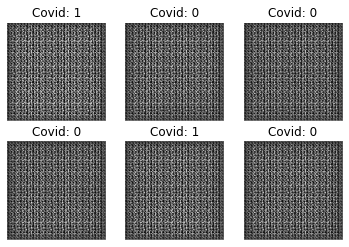

Epoch 2/100 Batch 3/3 [D loss: 0.03287, acc: 100.00%] [G loss: 17.70599]
Epoch 3/100 Batch 3/3 [D loss: 0.00064, acc: 100.00%] [G loss: 7.33035]
Epoch 4/100 Batch 3/3 [D loss: 0.00074, acc: 100.00%] [G loss: 31.93992]
Epoch 5/100 Batch 3/3 [D loss: 0.10601, acc: 96.88%] [G loss: 25.92049]
Epoch 6/100 Batch 3/3 [D loss: 0.00071, acc: 100.00%] [G loss: 15.06300]
Epoch 7/100 Batch 3/3 [D loss: 0.40652, acc: 84.38%] [G loss: 15.83473]
Epoch 8/100 Batch 3/3 [D loss: 0.00374, acc: 100.00%] [G loss: 5.98998]
Epoch 9/100 Batch 3/3 [D loss: 0.00179, acc: 100.00%] [G loss: 6.52327]
Epoch 10/100 Batch 3/3 [D loss: 0.00261, acc: 100.00%] [G loss: 5.46783]
Epoch 11/100 Batch 3/3 [D loss: 0.35050, acc: 70.31%] [G loss: 5.10521]
Epoch 12/100 Batch 3/3 [D loss: 0.00216, acc: 100.00%] [G loss: 9.84960]
Epoch 13/100 Batch 3/3 [D loss: 0.00169, acc: 100.00%] [G loss: 7.55741]
Epoch 14/100 Batch 3/3 [D loss: 0.01558, acc: 100.00%] [G loss: 8.49560]
Epoch 15/100 Batch 3/3 [D loss: 0.00112, acc: 100.00%] [G

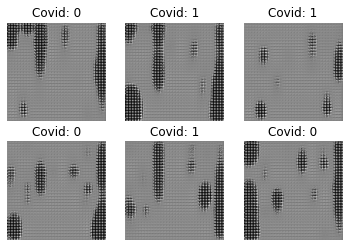

Epoch 22/100 Batch 3/3 [D loss: 0.05915, acc: 100.00%] [G loss: 3.82618]
Epoch 23/100 Batch 3/3 [D loss: 0.05017, acc: 100.00%] [G loss: 4.65413]
Epoch 24/100 Batch 3/3 [D loss: 0.05088, acc: 96.88%] [G loss: 6.09249]
Epoch 25/100 Batch 3/3 [D loss: 0.04635, acc: 100.00%] [G loss: 6.07626]
Epoch 26/100 Batch 3/3 [D loss: 0.04404, acc: 98.44%] [G loss: 6.56084]
Epoch 27/100 Batch 3/3 [D loss: 0.07023, acc: 96.88%] [G loss: 6.08180]
Epoch 28/100 Batch 3/3 [D loss: 0.01131, acc: 100.00%] [G loss: 8.98527]
Epoch 29/100 Batch 3/3 [D loss: 0.01748, acc: 100.00%] [G loss: 6.89530]
Epoch 30/100 Batch 3/3 [D loss: 0.03348, acc: 100.00%] [G loss: 6.49983]
Epoch 31/100 Batch 3/3 [D loss: 0.41792, acc: 82.81%] [G loss: 2.36132]
Epoch 32/100 Batch 3/3 [D loss: 2.80861, acc: 31.25%] [G loss: 0.88465]
Epoch 33/100 Batch 3/3 [D loss: 0.30399, acc: 92.19%] [G loss: 1.89772]
Epoch 34/100 Batch 3/3 [D loss: 0.42506, acc: 85.94%] [G loss: 2.08500]
Epoch 35/100 Batch 3/3 [D loss: 0.55610, acc: 68.75%] [G l

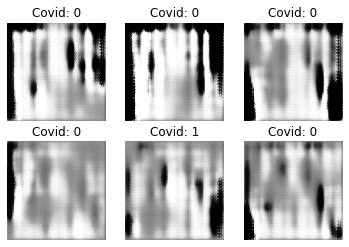

Epoch 42/100 Batch 3/3 [D loss: 0.49166, acc: 76.56%] [G loss: 1.64868]
Epoch 43/100 Batch 3/3 [D loss: 0.53628, acc: 70.31%] [G loss: 1.13183]
Epoch 44/100 Batch 3/3 [D loss: 0.66898, acc: 59.38%] [G loss: 1.48373]
Epoch 45/100 Batch 3/3 [D loss: 0.53078, acc: 76.56%] [G loss: 1.68961]
Epoch 46/100 Batch 3/3 [D loss: 0.55903, acc: 73.44%] [G loss: 1.48712]
Epoch 47/100 Batch 3/3 [D loss: 0.67785, acc: 54.69%] [G loss: 1.20873]
Epoch 48/100 Batch 3/3 [D loss: 0.46655, acc: 90.62%] [G loss: 1.54691]
Epoch 49/100 Batch 3/3 [D loss: 0.63075, acc: 60.94%] [G loss: 1.26031]
Epoch 50/100 Batch 3/3 [D loss: 0.60512, acc: 70.31%] [G loss: 1.75710]
Epoch 51/100 Batch 3/3 [D loss: 0.45518, acc: 79.69%] [G loss: 1.44597]
Epoch 52/100 Batch 3/3 [D loss: 0.42423, acc: 89.06%] [G loss: 1.09234]
Epoch 53/100 Batch 3/3 [D loss: 0.50885, acc: 70.31%] [G loss: 1.12018]
Epoch 54/100 Batch 3/3 [D loss: 0.76050, acc: 53.12%] [G loss: 1.32317]
Epoch 55/100 Batch 3/3 [D loss: 0.55093, acc: 78.12%] [G loss: 1

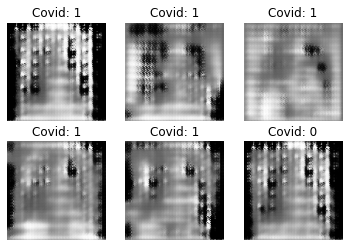

Epoch 62/100 Batch 3/3 [D loss: 0.59402, acc: 75.00%] [G loss: 1.08835]
Epoch 63/100 Batch 3/3 [D loss: 0.61914, acc: 67.19%] [G loss: 1.29499]
Epoch 64/100 Batch 3/3 [D loss: 0.75543, acc: 59.38%] [G loss: 0.80913]
Epoch 65/100 Batch 3/3 [D loss: 0.54378, acc: 81.25%] [G loss: 1.25509]
Epoch 66/100 Batch 3/3 [D loss: 0.58476, acc: 71.88%] [G loss: 1.15272]
Epoch 67/100 Batch 3/3 [D loss: 0.63345, acc: 62.50%] [G loss: 0.78530]
Epoch 68/100 Batch 3/3 [D loss: 0.69198, acc: 57.81%] [G loss: 1.34590]
Epoch 69/100 Batch 3/3 [D loss: 0.52596, acc: 78.12%] [G loss: 1.28921]
Epoch 70/100 Batch 3/3 [D loss: 0.52443, acc: 84.38%] [G loss: 1.19900]
Epoch 71/100 Batch 3/3 [D loss: 0.55952, acc: 79.69%] [G loss: 0.97430]
Epoch 72/100 Batch 3/3 [D loss: 0.56597, acc: 78.12%] [G loss: 1.17276]
Epoch 73/100 Batch 3/3 [D loss: 0.53783, acc: 76.56%] [G loss: 1.30963]
Epoch 74/100 Batch 3/3 [D loss: 0.53075, acc: 79.69%] [G loss: 1.28574]
Epoch 75/100 Batch 3/3 [D loss: 0.47231, acc: 79.69%] [G loss: 1

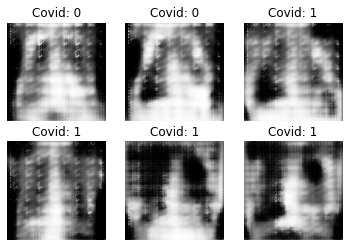

Epoch 82/100 Batch 3/3 [D loss: 0.37168, acc: 89.06%] [G loss: 1.60622]
Epoch 83/100 Batch 3/3 [D loss: 0.48136, acc: 78.12%] [G loss: 1.46408]
Epoch 84/100 Batch 3/3 [D loss: 0.41702, acc: 82.81%] [G loss: 1.45116]
Epoch 85/100 Batch 3/3 [D loss: 0.62004, acc: 68.75%] [G loss: 2.01912]
Epoch 86/100 Batch 3/3 [D loss: 0.43492, acc: 76.56%] [G loss: 1.52106]
Epoch 87/100 Batch 3/3 [D loss: 0.62912, acc: 65.62%] [G loss: 1.97705]
Epoch 88/100 Batch 3/3 [D loss: 0.47834, acc: 73.44%] [G loss: 1.65304]
Epoch 89/100 Batch 3/3 [D loss: 0.29891, acc: 89.06%] [G loss: 1.56215]
Epoch 90/100 Batch 3/3 [D loss: 0.35681, acc: 85.94%] [G loss: 2.08582]
Epoch 91/100 Batch 3/3 [D loss: 0.50675, acc: 71.88%] [G loss: 2.19966]
Epoch 92/100 Batch 3/3 [D loss: 0.47161, acc: 81.25%] [G loss: 1.52762]
Epoch 93/100 Batch 3/3 [D loss: 0.49242, acc: 76.56%] [G loss: 1.61229]
Epoch 94/100 Batch 3/3 [D loss: 0.51288, acc: 73.44%] [G loss: 1.15178]
Epoch 95/100 Batch 3/3 [D loss: 0.59471, acc: 67.19%] [G loss: 2

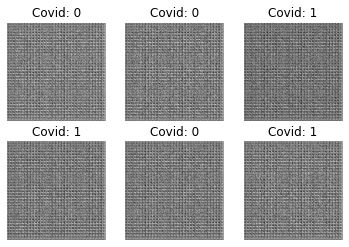

Epoch 2/100 Batch 3/3 [D loss: 0.65218, acc: 50.00%] [G loss: 0.61688]
Epoch 3/100 Batch 3/3 [D loss: 0.54177, acc: 100.00%] [G loss: 0.86581]
Epoch 4/100 Batch 3/3 [D loss: 0.43732, acc: 100.00%] [G loss: 1.12470]
Epoch 5/100 Batch 3/3 [D loss: 0.35531, acc: 100.00%] [G loss: 1.46528]
Epoch 6/100 Batch 3/3 [D loss: 0.31033, acc: 98.44%] [G loss: 1.65892]
Epoch 7/100 Batch 3/3 [D loss: 0.30704, acc: 96.88%] [G loss: 1.93389]
Epoch 8/100 Batch 3/3 [D loss: 0.36509, acc: 90.62%] [G loss: 2.05730]
Epoch 9/100 Batch 3/3 [D loss: 0.37562, acc: 93.75%] [G loss: 1.65057]
Epoch 10/100 Batch 3/3 [D loss: 0.45007, acc: 78.12%] [G loss: 2.70755]
Epoch 11/100 Batch 3/3 [D loss: 0.48400, acc: 84.38%] [G loss: 2.53866]
Epoch 12/100 Batch 3/3 [D loss: 0.49686, acc: 70.31%] [G loss: 1.78452]
Epoch 13/100 Batch 3/3 [D loss: 0.49745, acc: 75.00%] [G loss: 0.53696]
Epoch 14/100 Batch 3/3 [D loss: 0.59349, acc: 68.75%] [G loss: 0.76752]
Epoch 15/100 Batch 3/3 [D loss: 0.74174, acc: 62.50%] [G loss: 0.8605

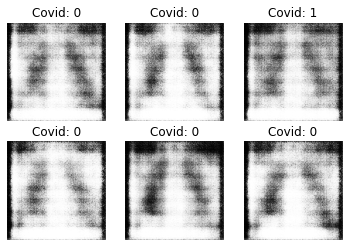

Epoch 22/100 Batch 3/3 [D loss: 0.74611, acc: 43.75%] [G loss: 0.98691]
Epoch 23/100 Batch 3/3 [D loss: 0.82219, acc: 59.38%] [G loss: 1.20314]
Epoch 24/100 Batch 3/3 [D loss: 0.54842, acc: 76.56%] [G loss: 0.85559]
Epoch 25/100 Batch 3/3 [D loss: 0.75594, acc: 42.19%] [G loss: 0.90825]
Epoch 26/100 Batch 3/3 [D loss: 0.65669, acc: 65.62%] [G loss: 1.14248]
Epoch 27/100 Batch 3/3 [D loss: 0.78380, acc: 39.06%] [G loss: 0.72748]
Epoch 28/100 Batch 3/3 [D loss: 0.72481, acc: 48.44%] [G loss: 0.84533]
Epoch 29/100 Batch 3/3 [D loss: 0.61911, acc: 70.31%] [G loss: 1.02199]
Epoch 30/100 Batch 3/3 [D loss: 0.75756, acc: 35.94%] [G loss: 0.77922]
Epoch 31/100 Batch 3/3 [D loss: 0.73342, acc: 48.44%] [G loss: 0.88426]
Epoch 32/100 Batch 3/3 [D loss: 0.67145, acc: 62.50%] [G loss: 0.83015]
Epoch 33/100 Batch 3/3 [D loss: 0.69682, acc: 43.75%] [G loss: 0.77112]
Epoch 34/100 Batch 3/3 [D loss: 0.67694, acc: 64.06%] [G loss: 0.83113]
Epoch 35/100 Batch 3/3 [D loss: 0.61887, acc: 78.12%] [G loss: 0

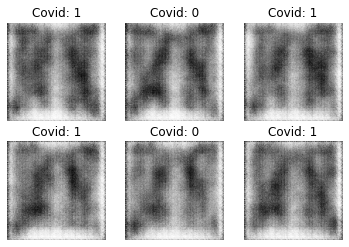

Epoch 42/100 Batch 3/3 [D loss: 0.58345, acc: 71.88%] [G loss: 0.92289]
Epoch 43/100 Batch 3/3 [D loss: 0.46124, acc: 92.19%] [G loss: 1.04474]
Epoch 44/100 Batch 3/3 [D loss: 0.41749, acc: 89.06%] [G loss: 1.08811]
Epoch 45/100 Batch 3/3 [D loss: 0.40369, acc: 93.75%] [G loss: 1.00329]
Epoch 46/100 Batch 3/3 [D loss: 0.44276, acc: 87.50%] [G loss: 0.41513]
Epoch 47/100 Batch 3/3 [D loss: 0.79106, acc: 48.44%] [G loss: 0.68933]
Epoch 48/100 Batch 3/3 [D loss: 0.66315, acc: 67.19%] [G loss: 1.49756]
Epoch 49/100 Batch 3/3 [D loss: 0.61507, acc: 73.44%] [G loss: 0.55954]
Epoch 50/100 Batch 3/3 [D loss: 0.78757, acc: 42.19%] [G loss: 0.43001]
Epoch 51/100 Batch 3/3 [D loss: 0.75815, acc: 46.88%] [G loss: 0.78242]
Epoch 52/100 Batch 3/3 [D loss: 0.81473, acc: 34.38%] [G loss: 0.75653]
Epoch 53/100 Batch 3/3 [D loss: 0.78206, acc: 43.75%] [G loss: 0.94372]
Epoch 54/100 Batch 3/3 [D loss: 0.65596, acc: 64.06%] [G loss: 1.00750]
Epoch 55/100 Batch 3/3 [D loss: 0.56611, acc: 84.38%] [G loss: 1

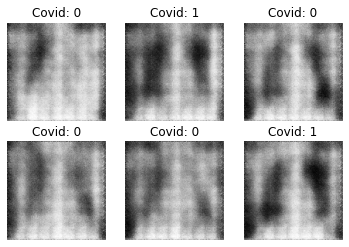

Epoch 62/100 Batch 3/3 [D loss: 0.67705, acc: 59.38%] [G loss: 0.76966]
Epoch 63/100 Batch 3/3 [D loss: 0.76372, acc: 43.75%] [G loss: 0.77892]
Epoch 64/100 Batch 3/3 [D loss: 0.86343, acc: 31.25%] [G loss: 0.70383]
Epoch 65/100 Batch 3/3 [D loss: 0.77814, acc: 37.50%] [G loss: 0.69514]
Epoch 66/100 Batch 3/3 [D loss: 0.69611, acc: 57.81%] [G loss: 0.72300]
Epoch 67/100 Batch 3/3 [D loss: 0.70596, acc: 53.12%] [G loss: 0.74149]
Epoch 68/100 Batch 3/3 [D loss: 0.66723, acc: 64.06%] [G loss: 0.75679]
Epoch 69/100 Batch 3/3 [D loss: 0.71477, acc: 51.56%] [G loss: 0.72187]
Epoch 70/100 Batch 3/3 [D loss: 0.70926, acc: 45.31%] [G loss: 0.71898]
Epoch 71/100 Batch 3/3 [D loss: 0.74056, acc: 42.19%] [G loss: 0.69336]
Epoch 72/100 Batch 3/3 [D loss: 0.73285, acc: 40.62%] [G loss: 0.66326]
Epoch 73/100 Batch 3/3 [D loss: 0.73894, acc: 29.69%] [G loss: 0.65639]
Epoch 74/100 Batch 3/3 [D loss: 0.71595, acc: 40.62%] [G loss: 0.66907]
Epoch 75/100 Batch 3/3 [D loss: 0.71573, acc: 46.88%] [G loss: 0

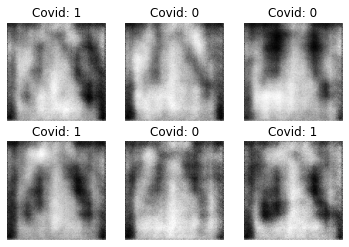

Epoch 82/100 Batch 3/3 [D loss: 0.70597, acc: 48.44%] [G loss: 0.66565]
Epoch 83/100 Batch 3/3 [D loss: 0.72027, acc: 42.19%] [G loss: 0.66354]
Epoch 84/100 Batch 3/3 [D loss: 0.70844, acc: 45.31%] [G loss: 0.70439]
Epoch 85/100 Batch 3/3 [D loss: 0.68588, acc: 56.25%] [G loss: 0.72486]
Epoch 86/100 Batch 3/3 [D loss: 0.70537, acc: 48.44%] [G loss: 0.68941]
Epoch 87/100 Batch 3/3 [D loss: 0.67339, acc: 60.94%] [G loss: 0.69719]
Epoch 88/100 Batch 3/3 [D loss: 0.65940, acc: 70.31%] [G loss: 0.66898]
Epoch 89/100 Batch 3/3 [D loss: 0.68746, acc: 53.12%] [G loss: 0.65433]
Epoch 90/100 Batch 3/3 [D loss: 0.67717, acc: 59.38%] [G loss: 0.64055]
Epoch 91/100 Batch 3/3 [D loss: 0.68283, acc: 57.81%] [G loss: 0.61653]
Epoch 92/100 Batch 3/3 [D loss: 0.67973, acc: 51.56%] [G loss: 0.64216]
Epoch 93/100 Batch 3/3 [D loss: 0.68794, acc: 50.00%] [G loss: 0.63948]
Epoch 94/100 Batch 3/3 [D loss: 0.65168, acc: 65.62%] [G loss: 0.65952]
Epoch 95/100 Batch 3/3 [D loss: 0.67076, acc: 60.94%] [G loss: 0

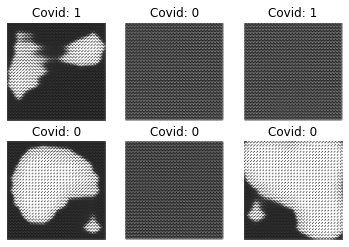

Epoch 2/200 Batch 12/12 [D loss: 0.01874, acc: 100.00%] [G loss: 135.75470]
Epoch 3/200 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 312.23752]
Epoch 4/200 Batch 12/12 [D loss: 1.62487, acc: 87.50%] [G loss: 248.40721]
Epoch 5/200 Batch 12/12 [D loss: 0.44127, acc: 93.75%] [G loss: 17.83794]
Epoch 6/200 Batch 12/12 [D loss: 4.98578, acc: 56.25%] [G loss: 32.54979]
Epoch 7/200 Batch 12/12 [D loss: 0.01194, acc: 100.00%] [G loss: 3.48227]
Epoch 8/200 Batch 12/12 [D loss: 0.04495, acc: 93.75%] [G loss: 7.30100]
Epoch 9/200 Batch 12/12 [D loss: 1.18501, acc: 62.50%] [G loss: 9.76686]
Epoch 10/200 Batch 12/12 [D loss: 0.00280, acc: 100.00%] [G loss: 5.57101]
Epoch 11/200 Batch 12/12 [D loss: 0.02277, acc: 100.00%] [G loss: 5.95186]
Epoch 12/200 Batch 12/12 [D loss: 0.01353, acc: 100.00%] [G loss: 5.21709]
Epoch 13/200 Batch 12/12 [D loss: 0.00070, acc: 100.00%] [G loss: 7.22459]
Epoch 14/200 Batch 12/12 [D loss: 0.03978, acc: 100.00%] [G loss: 3.73919]
Epoch 15/200 Batch 12/12 [D lo

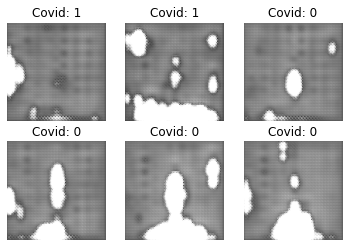

Epoch 22/200 Batch 12/12 [D loss: 0.09634, acc: 93.75%] [G loss: 3.75082]
Epoch 23/200 Batch 12/12 [D loss: 0.00739, acc: 100.00%] [G loss: 5.60661]
Epoch 24/200 Batch 12/12 [D loss: 0.43026, acc: 87.50%] [G loss: 3.48096]
Epoch 25/200 Batch 12/12 [D loss: 0.03897, acc: 100.00%] [G loss: 3.24970]
Epoch 26/200 Batch 12/12 [D loss: 0.09115, acc: 93.75%] [G loss: 5.74109]
Epoch 27/200 Batch 12/12 [D loss: 0.05897, acc: 100.00%] [G loss: 4.40687]
Epoch 28/200 Batch 12/12 [D loss: 0.26731, acc: 93.75%] [G loss: 3.92383]
Epoch 29/200 Batch 12/12 [D loss: 0.11724, acc: 93.75%] [G loss: 3.52667]
Epoch 30/200 Batch 12/12 [D loss: 0.29321, acc: 87.50%] [G loss: 3.66291]
Epoch 31/200 Batch 12/12 [D loss: 0.14440, acc: 93.75%] [G loss: 3.48024]
Epoch 32/200 Batch 12/12 [D loss: 0.18855, acc: 87.50%] [G loss: 4.01515]
Epoch 33/200 Batch 12/12 [D loss: 0.24572, acc: 81.25%] [G loss: 3.62348]
Epoch 34/200 Batch 12/12 [D loss: 1.63158, acc: 56.25%] [G loss: 20.16587]
Epoch 35/200 Batch 12/12 [D loss: 

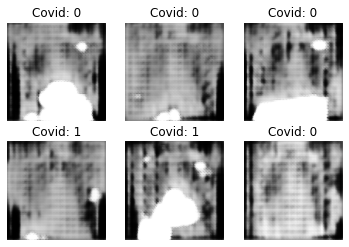

Epoch 42/200 Batch 12/12 [D loss: 0.07464, acc: 100.00%] [G loss: 4.93454]
Epoch 43/200 Batch 12/12 [D loss: 0.28436, acc: 87.50%] [G loss: 2.98185]
Epoch 44/200 Batch 12/12 [D loss: 0.42963, acc: 93.75%] [G loss: 2.51856]
Epoch 45/200 Batch 12/12 [D loss: 0.28997, acc: 93.75%] [G loss: 2.38971]
Epoch 46/200 Batch 12/12 [D loss: 0.31354, acc: 87.50%] [G loss: 3.05868]
Epoch 47/200 Batch 12/12 [D loss: 0.19126, acc: 87.50%] [G loss: 5.01172]
Epoch 48/200 Batch 12/12 [D loss: 0.12382, acc: 100.00%] [G loss: 3.60626]
Epoch 49/200 Batch 12/12 [D loss: 0.04432, acc: 100.00%] [G loss: 5.32072]
Epoch 50/200 Batch 12/12 [D loss: 0.07374, acc: 100.00%] [G loss: 4.32028]
Epoch 51/200 Batch 12/12 [D loss: 0.13057, acc: 93.75%] [G loss: 5.33761]
Epoch 52/200 Batch 12/12 [D loss: 0.92424, acc: 75.00%] [G loss: 5.61729]
Epoch 53/200 Batch 12/12 [D loss: 0.16953, acc: 100.00%] [G loss: 2.85133]
Epoch 54/200 Batch 12/12 [D loss: 0.16272, acc: 93.75%] [G loss: 3.96230]
Epoch 55/200 Batch 12/12 [D loss:

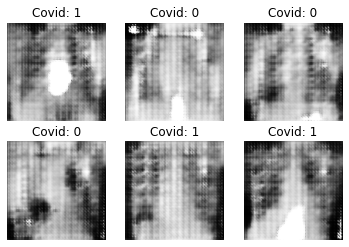

Epoch 62/200 Batch 12/12 [D loss: 0.35840, acc: 75.00%] [G loss: 7.44891]
Epoch 63/200 Batch 12/12 [D loss: 0.58199, acc: 75.00%] [G loss: 4.61218]
Epoch 64/200 Batch 12/12 [D loss: 0.53635, acc: 75.00%] [G loss: 2.74561]
Epoch 65/200 Batch 12/12 [D loss: 0.14236, acc: 93.75%] [G loss: 2.85598]
Epoch 66/200 Batch 12/12 [D loss: 0.68417, acc: 62.50%] [G loss: 6.91038]
Epoch 67/200 Batch 12/12 [D loss: 1.17751, acc: 62.50%] [G loss: 5.37031]
Epoch 68/200 Batch 12/12 [D loss: 0.52098, acc: 81.25%] [G loss: 9.01223]
Epoch 69/200 Batch 12/12 [D loss: 0.06850, acc: 100.00%] [G loss: 3.64958]
Epoch 70/200 Batch 12/12 [D loss: 0.09899, acc: 100.00%] [G loss: 4.34962]
Epoch 71/200 Batch 12/12 [D loss: 0.24361, acc: 93.75%] [G loss: 7.63806]
Epoch 72/200 Batch 12/12 [D loss: 0.14689, acc: 100.00%] [G loss: 4.69297]
Epoch 73/200 Batch 12/12 [D loss: 0.03790, acc: 100.00%] [G loss: 5.14050]
Epoch 74/200 Batch 12/12 [D loss: 0.02933, acc: 100.00%] [G loss: 5.44419]
Epoch 75/200 Batch 12/12 [D loss:

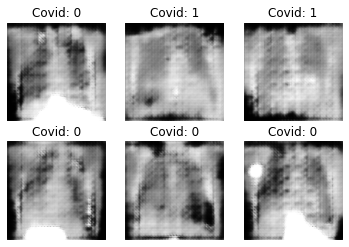

Epoch 82/200 Batch 12/12 [D loss: 0.20111, acc: 87.50%] [G loss: 4.74901]
Epoch 83/200 Batch 12/12 [D loss: 0.09310, acc: 100.00%] [G loss: 2.80840]
Epoch 84/200 Batch 12/12 [D loss: 0.10299, acc: 100.00%] [G loss: 2.81167]
Epoch 85/200 Batch 12/12 [D loss: 0.11323, acc: 93.75%] [G loss: 3.82910]
Epoch 86/200 Batch 12/12 [D loss: 0.34952, acc: 81.25%] [G loss: 4.87071]
Epoch 87/200 Batch 12/12 [D loss: 0.03364, acc: 100.00%] [G loss: 4.97525]
Epoch 88/200 Batch 12/12 [D loss: 0.09755, acc: 93.75%] [G loss: 5.71866]
Epoch 89/200 Batch 12/12 [D loss: 0.51815, acc: 81.25%] [G loss: 7.96021]
Epoch 90/200 Batch 12/12 [D loss: 0.39180, acc: 81.25%] [G loss: 4.62151]
Epoch 91/200 Batch 12/12 [D loss: 0.12826, acc: 93.75%] [G loss: 3.85247]
Epoch 92/200 Batch 12/12 [D loss: 0.14133, acc: 93.75%] [G loss: 4.23108]
Epoch 93/200 Batch 12/12 [D loss: 0.37066, acc: 87.50%] [G loss: 7.43064]
Epoch 94/200 Batch 12/12 [D loss: 0.17300, acc: 87.50%] [G loss: 13.20384]
Epoch 95/200 Batch 12/12 [D loss: 

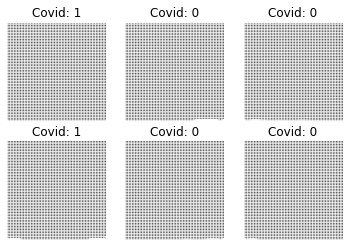

Epoch 102/200 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 44871104.00000]
Epoch 103/200 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 44601392.00000]
Epoch 104/200 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 33698176.00000]
Epoch 105/200 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 33625612.00000]
Epoch 106/200 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 33420962.00000]
Epoch 107/200 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 33230438.00000]
Epoch 108/200 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 33009490.00000]
Epoch 109/200 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 33406852.00000]
Epoch 110/200 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 28795668.00000]
Epoch 111/200 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 25571428.00000]
Epoch 112/200 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 20433632.00000]
Epoch 113/200 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 20256030.00000]
Epoc

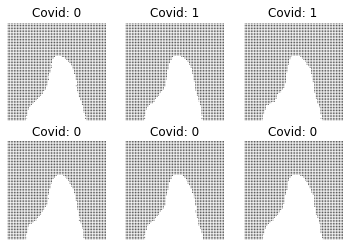

Epoch 122/200 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 20280136.00000]
Epoch 123/200 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 20276790.00000]
Epoch 124/200 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 20012324.00000]
Epoch 125/200 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 19452776.00000]
Epoch 126/200 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 20152324.00000]
Epoch 127/200 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 20063992.00000]
Epoch 128/200 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 19564728.00000]
Epoch 129/200 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 20168340.00000]
Epoch 130/200 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 19321462.00000]
Epoch 131/200 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 20314036.00000]
Epoch 132/200 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 20185740.00000]
Epoch 133/200 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 19767954.00000]
Epoc

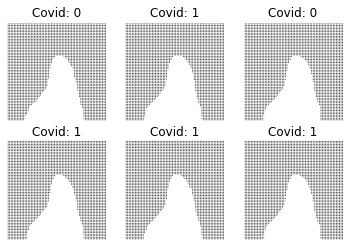

Epoch 142/200 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 19820120.00000]
Epoch 143/200 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 19410162.00000]
Epoch 144/200 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 19805132.00000]
Epoch 145/200 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 20458396.00000]
Epoch 146/200 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 19033928.00000]
Epoch 147/200 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 20225158.00000]
Epoch 148/200 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 20004368.00000]
Epoch 149/200 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 20326586.00000]
Epoch 150/200 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 20490348.00000]
Epoch 151/200 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 19362800.00000]
Epoch 152/200 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 20160252.00000]
Epoch 153/200 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 19865880.00000]
Epoc

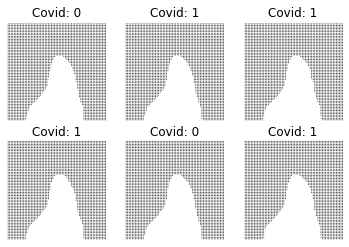

Epoch 162/200 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 19273250.00000]
Epoch 163/200 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 20073728.00000]
Epoch 164/200 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 19011848.00000]
Epoch 165/200 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 20372200.00000]
Epoch 166/200 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 20017664.00000]
Epoch 167/200 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 20033740.00000]
Epoch 168/200 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 19878870.00000]
Epoch 169/200 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 20155416.00000]
Epoch 170/200 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 19868190.00000]
Epoch 171/200 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 20202136.00000]
Epoch 172/200 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 20549392.00000]
Epoch 173/200 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 19523844.00000]
Epoc

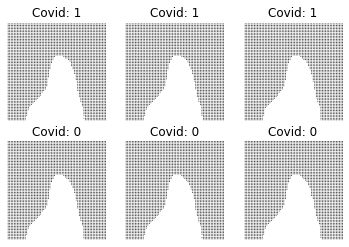

Epoch 182/200 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 20005338.00000]
Epoch 183/200 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 19751620.00000]
Epoch 184/200 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 19593198.00000]
Epoch 185/200 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 19373872.00000]
Epoch 186/200 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 20372904.00000]
Epoch 187/200 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 20341366.00000]
Epoch 188/200 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 20140558.00000]
Epoch 189/200 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 20013054.00000]
Epoch 190/200 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 19431012.00000]
Epoch 191/200 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 19614154.00000]
Epoch 192/200 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 20412228.00000]
Epoch 193/200 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 19236372.00000]
Epoc

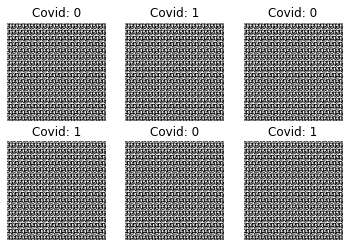

Epoch 2/200 Batch 12/12 [D loss: 0.00082, acc: 100.00%] [G loss: 6.99049]
Epoch 3/200 Batch 12/12 [D loss: 0.00773, acc: 100.00%] [G loss: 6.80310]
Epoch 4/200 Batch 12/12 [D loss: 0.07621, acc: 100.00%] [G loss: 6.19374]
Epoch 5/200 Batch 12/12 [D loss: 0.02938, acc: 100.00%] [G loss: 6.29767]
Epoch 6/200 Batch 12/12 [D loss: 0.05096, acc: 100.00%] [G loss: 5.72211]
Epoch 7/200 Batch 12/12 [D loss: 2.67935, acc: 50.00%] [G loss: 5.23505]
Epoch 8/200 Batch 12/12 [D loss: 0.23961, acc: 93.75%] [G loss: 3.10917]
Epoch 9/200 Batch 12/12 [D loss: 0.51784, acc: 87.50%] [G loss: 12.77561]
Epoch 10/200 Batch 12/12 [D loss: 0.68022, acc: 56.25%] [G loss: 1.53734]
Epoch 11/200 Batch 12/12 [D loss: 0.64039, acc: 75.00%] [G loss: 1.16304]
Epoch 12/200 Batch 12/12 [D loss: 0.45890, acc: 93.75%] [G loss: 1.82402]
Epoch 13/200 Batch 12/12 [D loss: 0.49629, acc: 68.75%] [G loss: 1.38259]
Epoch 14/200 Batch 12/12 [D loss: 0.54056, acc: 81.25%] [G loss: 1.29888]
Epoch 15/200 Batch 12/12 [D loss: 0.5272

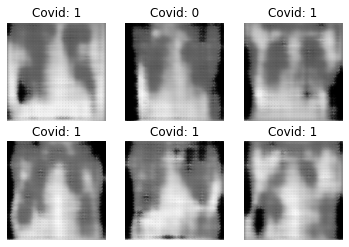

Epoch 22/200 Batch 12/12 [D loss: 0.41047, acc: 81.25%] [G loss: 1.57245]
Epoch 23/200 Batch 12/12 [D loss: 0.37375, acc: 87.50%] [G loss: 1.74469]
Epoch 24/200 Batch 12/12 [D loss: 0.38709, acc: 81.25%] [G loss: 2.10557]
Epoch 25/200 Batch 12/12 [D loss: 0.42495, acc: 81.25%] [G loss: 2.63155]
Epoch 26/200 Batch 12/12 [D loss: 0.21322, acc: 93.75%] [G loss: 2.23834]
Epoch 27/200 Batch 12/12 [D loss: 0.38720, acc: 75.00%] [G loss: 2.13222]
Epoch 28/200 Batch 12/12 [D loss: 0.37504, acc: 81.25%] [G loss: 2.25853]
Epoch 29/200 Batch 12/12 [D loss: 0.31338, acc: 93.75%] [G loss: 3.14570]
Epoch 30/200 Batch 12/12 [D loss: 0.25058, acc: 100.00%] [G loss: 2.34774]
Epoch 31/200 Batch 12/12 [D loss: 0.19483, acc: 100.00%] [G loss: 2.61758]
Epoch 32/200 Batch 12/12 [D loss: 0.17502, acc: 93.75%] [G loss: 2.18213]
Epoch 33/200 Batch 12/12 [D loss: 0.22386, acc: 93.75%] [G loss: 2.57538]
Epoch 34/200 Batch 12/12 [D loss: 0.30106, acc: 87.50%] [G loss: 1.99671]
Epoch 35/200 Batch 12/12 [D loss: 0.

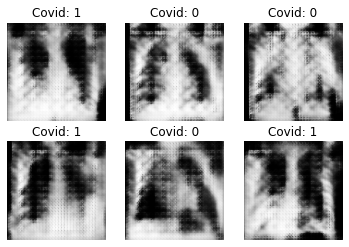

Epoch 42/200 Batch 12/12 [D loss: 0.24163, acc: 87.50%] [G loss: 2.17701]
Epoch 43/200 Batch 12/12 [D loss: 0.16151, acc: 93.75%] [G loss: 3.11668]
Epoch 44/200 Batch 12/12 [D loss: 0.26862, acc: 93.75%] [G loss: 3.00692]
Epoch 45/200 Batch 12/12 [D loss: 0.34846, acc: 81.25%] [G loss: 4.39766]
Epoch 46/200 Batch 12/12 [D loss: 0.75203, acc: 68.75%] [G loss: 5.76356]
Epoch 47/200 Batch 12/12 [D loss: 0.25570, acc: 93.75%] [G loss: 3.97085]
Epoch 48/200 Batch 12/12 [D loss: 0.19155, acc: 93.75%] [G loss: 3.92639]
Epoch 49/200 Batch 12/12 [D loss: 0.48085, acc: 75.00%] [G loss: 1.96665]
Epoch 50/200 Batch 12/12 [D loss: 0.19296, acc: 100.00%] [G loss: 2.25153]
Epoch 51/200 Batch 12/12 [D loss: 0.36302, acc: 87.50%] [G loss: 4.60226]
Epoch 52/200 Batch 12/12 [D loss: 0.08616, acc: 100.00%] [G loss: 3.08400]
Epoch 53/200 Batch 12/12 [D loss: 0.20817, acc: 93.75%] [G loss: 4.82276]
Epoch 54/200 Batch 12/12 [D loss: 0.20046, acc: 100.00%] [G loss: 2.56009]
Epoch 55/200 Batch 12/12 [D loss: 0

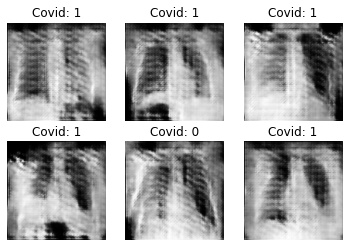

Epoch 62/200 Batch 12/12 [D loss: 0.52369, acc: 68.75%] [G loss: 3.78127]
Epoch 63/200 Batch 12/12 [D loss: 0.21049, acc: 100.00%] [G loss: 3.76906]
Epoch 64/200 Batch 12/12 [D loss: 0.32576, acc: 81.25%] [G loss: 3.00931]
Epoch 65/200 Batch 12/12 [D loss: 0.47098, acc: 81.25%] [G loss: 2.41865]
Epoch 66/200 Batch 12/12 [D loss: 0.43857, acc: 81.25%] [G loss: 3.62726]
Epoch 67/200 Batch 12/12 [D loss: 0.26804, acc: 93.75%] [G loss: 2.39316]
Epoch 68/200 Batch 12/12 [D loss: 0.18154, acc: 93.75%] [G loss: 2.15729]
Epoch 69/200 Batch 12/12 [D loss: 0.18716, acc: 100.00%] [G loss: 2.82951]
Epoch 70/200 Batch 12/12 [D loss: 0.10469, acc: 100.00%] [G loss: 3.25658]
Epoch 71/200 Batch 12/12 [D loss: 0.23565, acc: 87.50%] [G loss: 2.75963]
Epoch 72/200 Batch 12/12 [D loss: 0.10724, acc: 100.00%] [G loss: 3.52615]
Epoch 73/200 Batch 12/12 [D loss: 0.38949, acc: 87.50%] [G loss: 2.38137]
Epoch 74/200 Batch 12/12 [D loss: 0.12536, acc: 100.00%] [G loss: 2.07105]
Epoch 75/200 Batch 12/12 [D loss:

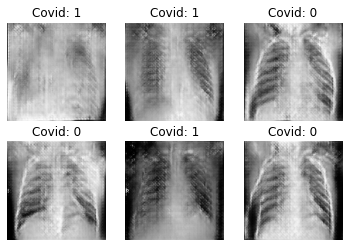

Epoch 82/200 Batch 12/12 [D loss: 0.28951, acc: 93.75%] [G loss: 5.53466]
Epoch 83/200 Batch 12/12 [D loss: 0.25838, acc: 87.50%] [G loss: 3.82729]
Epoch 84/200 Batch 12/12 [D loss: 0.19717, acc: 100.00%] [G loss: 3.74528]
Epoch 85/200 Batch 12/12 [D loss: 0.16556, acc: 100.00%] [G loss: 4.34395]
Epoch 86/200 Batch 12/12 [D loss: 0.16949, acc: 100.00%] [G loss: 3.52084]
Epoch 87/200 Batch 12/12 [D loss: 0.16880, acc: 100.00%] [G loss: 2.41505]
Epoch 88/200 Batch 12/12 [D loss: 0.24572, acc: 93.75%] [G loss: 3.25708]
Epoch 89/200 Batch 12/12 [D loss: 0.36504, acc: 87.50%] [G loss: 5.24774]
Epoch 90/200 Batch 12/12 [D loss: 0.51617, acc: 62.50%] [G loss: 5.15747]
Epoch 91/200 Batch 12/12 [D loss: 0.12201, acc: 93.75%] [G loss: 4.80059]
Epoch 92/200 Batch 12/12 [D loss: 0.16206, acc: 100.00%] [G loss: 3.16405]
Epoch 93/200 Batch 12/12 [D loss: 0.45710, acc: 68.75%] [G loss: 4.52768]
Epoch 94/200 Batch 12/12 [D loss: 0.29832, acc: 87.50%] [G loss: 2.21797]
Epoch 95/200 Batch 12/12 [D loss:

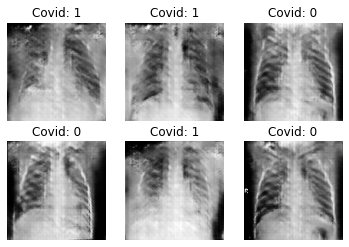

Epoch 102/200 Batch 12/12 [D loss: 0.10089, acc: 93.75%] [G loss: 3.98052]
Epoch 103/200 Batch 12/12 [D loss: 0.18330, acc: 93.75%] [G loss: 4.43597]
Epoch 104/200 Batch 12/12 [D loss: 0.21537, acc: 93.75%] [G loss: 2.38588]
Epoch 105/200 Batch 12/12 [D loss: 0.16708, acc: 93.75%] [G loss: 3.42162]
Epoch 106/200 Batch 12/12 [D loss: 0.22940, acc: 93.75%] [G loss: 4.73082]
Epoch 107/200 Batch 12/12 [D loss: 0.20733, acc: 93.75%] [G loss: 5.20005]
Epoch 108/200 Batch 12/12 [D loss: 0.30291, acc: 87.50%] [G loss: 4.76385]
Epoch 109/200 Batch 12/12 [D loss: 0.15400, acc: 93.75%] [G loss: 3.93920]
Epoch 110/200 Batch 12/12 [D loss: 0.20194, acc: 93.75%] [G loss: 4.52307]
Epoch 111/200 Batch 12/12 [D loss: 0.08366, acc: 100.00%] [G loss: 3.29273]
Epoch 112/200 Batch 12/12 [D loss: 0.23051, acc: 93.75%] [G loss: 2.57274]
Epoch 113/200 Batch 12/12 [D loss: 0.13813, acc: 93.75%] [G loss: 3.65457]
Epoch 114/200 Batch 12/12 [D loss: 0.21304, acc: 93.75%] [G loss: 5.59782]
Epoch 115/200 Batch 12/1

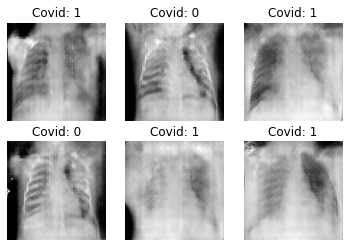

Epoch 122/200 Batch 12/12 [D loss: 0.11526, acc: 100.00%] [G loss: 5.43397]
Epoch 123/200 Batch 12/12 [D loss: 0.15452, acc: 100.00%] [G loss: 3.70820]
Epoch 124/200 Batch 12/12 [D loss: 0.33062, acc: 87.50%] [G loss: 2.91247]
Epoch 125/200 Batch 12/12 [D loss: 0.14842, acc: 100.00%] [G loss: 3.35872]
Epoch 126/200 Batch 12/12 [D loss: 0.25911, acc: 93.75%] [G loss: 4.77541]
Epoch 127/200 Batch 12/12 [D loss: 0.12391, acc: 100.00%] [G loss: 5.44647]
Epoch 128/200 Batch 12/12 [D loss: 0.23422, acc: 87.50%] [G loss: 3.01801]
Epoch 129/200 Batch 12/12 [D loss: 0.13909, acc: 93.75%] [G loss: 5.41874]
Epoch 130/200 Batch 12/12 [D loss: 0.28241, acc: 87.50%] [G loss: 6.79647]
Epoch 131/200 Batch 12/12 [D loss: 0.07753, acc: 100.00%] [G loss: 4.88008]
Epoch 132/200 Batch 12/12 [D loss: 0.13604, acc: 100.00%] [G loss: 3.71505]
Epoch 133/200 Batch 12/12 [D loss: 0.10798, acc: 93.75%] [G loss: 5.22028]
Epoch 134/200 Batch 12/12 [D loss: 0.40694, acc: 75.00%] [G loss: 8.46233]
Epoch 135/200 Batch

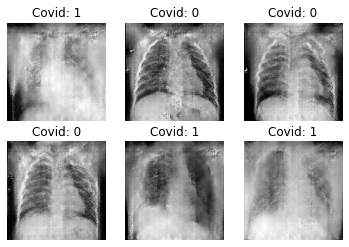

Epoch 142/200 Batch 12/12 [D loss: 0.15312, acc: 100.00%] [G loss: 4.96219]
Epoch 143/200 Batch 12/12 [D loss: 0.11322, acc: 100.00%] [G loss: 4.32107]
Epoch 144/200 Batch 12/12 [D loss: 0.14567, acc: 100.00%] [G loss: 8.09055]
Epoch 145/200 Batch 12/12 [D loss: 0.08708, acc: 100.00%] [G loss: 3.46538]
Epoch 146/200 Batch 12/12 [D loss: 0.14955, acc: 93.75%] [G loss: 5.84536]
Epoch 147/200 Batch 12/12 [D loss: 0.16974, acc: 93.75%] [G loss: 3.59511]
Epoch 148/200 Batch 12/12 [D loss: 0.57115, acc: 81.25%] [G loss: 6.74367]
Epoch 149/200 Batch 12/12 [D loss: 0.20579, acc: 87.50%] [G loss: 3.56939]
Epoch 150/200 Batch 12/12 [D loss: 0.23964, acc: 93.75%] [G loss: 5.48721]
Epoch 151/200 Batch 12/12 [D loss: 0.18335, acc: 93.75%] [G loss: 3.29775]
Epoch 152/200 Batch 12/12 [D loss: 0.23467, acc: 87.50%] [G loss: 4.50165]
Epoch 153/200 Batch 12/12 [D loss: 0.06493, acc: 100.00%] [G loss: 5.06119]
Epoch 154/200 Batch 12/12 [D loss: 0.07963, acc: 100.00%] [G loss: 3.08319]
Epoch 155/200 Batch

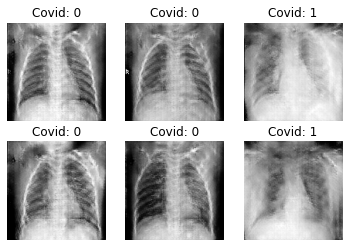

Epoch 162/200 Batch 12/12 [D loss: 0.05254, acc: 100.00%] [G loss: 3.80847]
Epoch 163/200 Batch 12/12 [D loss: 0.06159, acc: 100.00%] [G loss: 5.19198]
Epoch 164/200 Batch 12/12 [D loss: 0.26771, acc: 87.50%] [G loss: 4.67062]
Epoch 165/200 Batch 12/12 [D loss: 0.57060, acc: 75.00%] [G loss: 5.59283]
Epoch 166/200 Batch 12/12 [D loss: 0.43410, acc: 93.75%] [G loss: 8.41004]
Epoch 167/200 Batch 12/12 [D loss: 0.05089, acc: 100.00%] [G loss: 6.09545]
Epoch 168/200 Batch 12/12 [D loss: 0.00272, acc: 100.00%] [G loss: 8.17872]
Epoch 169/200 Batch 12/12 [D loss: 0.46367, acc: 81.25%] [G loss: 5.48398]
Epoch 170/200 Batch 12/12 [D loss: 0.09637, acc: 93.75%] [G loss: 7.25465]
Epoch 171/200 Batch 12/12 [D loss: 0.19158, acc: 93.75%] [G loss: 4.02450]
Epoch 172/200 Batch 12/12 [D loss: 0.04406, acc: 100.00%] [G loss: 5.06810]
Epoch 173/200 Batch 12/12 [D loss: 0.11975, acc: 93.75%] [G loss: 4.28362]
Epoch 174/200 Batch 12/12 [D loss: 0.05012, acc: 100.00%] [G loss: 4.69062]
Epoch 175/200 Batch

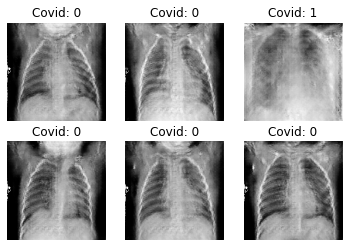

Epoch 182/200 Batch 12/12 [D loss: 0.05018, acc: 100.00%] [G loss: 4.21894]
Epoch 183/200 Batch 12/12 [D loss: 0.08094, acc: 100.00%] [G loss: 5.86087]
Epoch 184/200 Batch 12/12 [D loss: 0.22507, acc: 81.25%] [G loss: 9.23437]
Epoch 185/200 Batch 12/12 [D loss: 0.03042, acc: 100.00%] [G loss: 5.95060]
Epoch 186/200 Batch 12/12 [D loss: 0.17912, acc: 87.50%] [G loss: 4.77458]
Epoch 187/200 Batch 12/12 [D loss: 0.31507, acc: 81.25%] [G loss: 4.53726]
Epoch 188/200 Batch 12/12 [D loss: 0.21422, acc: 87.50%] [G loss: 9.38534]
Epoch 189/200 Batch 12/12 [D loss: 0.03841, acc: 100.00%] [G loss: 3.86575]
Epoch 190/200 Batch 12/12 [D loss: 0.16790, acc: 93.75%] [G loss: 4.01807]
Epoch 191/200 Batch 12/12 [D loss: 0.39672, acc: 87.50%] [G loss: 4.93114]
Epoch 192/200 Batch 12/12 [D loss: 0.12829, acc: 93.75%] [G loss: 4.84285]
Epoch 193/200 Batch 12/12 [D loss: 0.05778, acc: 100.00%] [G loss: 5.19900]
Epoch 194/200 Batch 12/12 [D loss: 0.03020, acc: 100.00%] [G loss: 5.02237]
Epoch 195/200 Batch

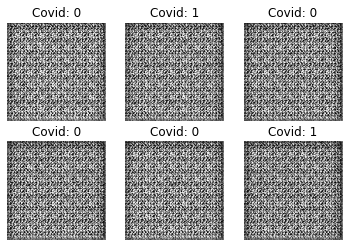

Epoch 2/200 Batch 12/12 [D loss: 0.17940, acc: 100.00%] [G loss: 2.27312]
Epoch 3/200 Batch 12/12 [D loss: 0.63329, acc: 87.50%] [G loss: 2.03505]
Epoch 4/200 Batch 12/12 [D loss: 0.47717, acc: 81.25%] [G loss: 1.18019]
Epoch 5/200 Batch 12/12 [D loss: 0.55171, acc: 68.75%] [G loss: 1.13945]
Epoch 6/200 Batch 12/12 [D loss: 0.68593, acc: 50.00%] [G loss: 1.22357]
Epoch 7/200 Batch 12/12 [D loss: 0.66257, acc: 75.00%] [G loss: 0.96618]
Epoch 8/200 Batch 12/12 [D loss: 0.64493, acc: 62.50%] [G loss: 0.88746]
Epoch 9/200 Batch 12/12 [D loss: 0.79856, acc: 37.50%] [G loss: 0.83172]
Epoch 10/200 Batch 12/12 [D loss: 0.60137, acc: 75.00%] [G loss: 0.79652]
Epoch 11/200 Batch 12/12 [D loss: 0.55616, acc: 81.25%] [G loss: 1.02711]
Epoch 12/200 Batch 12/12 [D loss: 0.70398, acc: 56.25%] [G loss: 0.72083]
Epoch 13/200 Batch 12/12 [D loss: 0.68028, acc: 56.25%] [G loss: 0.91640]
Epoch 14/200 Batch 12/12 [D loss: 0.94279, acc: 18.75%] [G loss: 0.53945]
Epoch 15/200 Batch 12/12 [D loss: 0.68014, ac

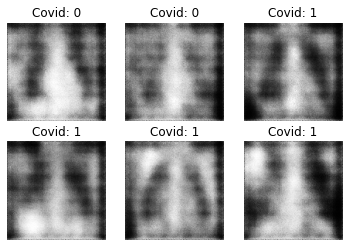

Epoch 22/200 Batch 12/12 [D loss: 0.71483, acc: 56.25%] [G loss: 0.73404]
Epoch 23/200 Batch 12/12 [D loss: 0.70740, acc: 68.75%] [G loss: 0.71799]
Epoch 24/200 Batch 12/12 [D loss: 0.70961, acc: 50.00%] [G loss: 0.61143]
Epoch 25/200 Batch 12/12 [D loss: 0.68307, acc: 43.75%] [G loss: 0.69333]
Epoch 26/200 Batch 12/12 [D loss: 0.73284, acc: 31.25%] [G loss: 0.63465]
Epoch 27/200 Batch 12/12 [D loss: 0.65078, acc: 68.75%] [G loss: 0.63223]
Epoch 28/200 Batch 12/12 [D loss: 0.66923, acc: 50.00%] [G loss: 0.67177]
Epoch 29/200 Batch 12/12 [D loss: 0.65842, acc: 62.50%] [G loss: 0.65887]
Epoch 30/200 Batch 12/12 [D loss: 0.72401, acc: 43.75%] [G loss: 0.62455]
Epoch 31/200 Batch 12/12 [D loss: 0.66922, acc: 68.75%] [G loss: 0.69610]
Epoch 32/200 Batch 12/12 [D loss: 0.68300, acc: 56.25%] [G loss: 0.63075]
Epoch 33/200 Batch 12/12 [D loss: 0.68473, acc: 50.00%] [G loss: 0.71186]
Epoch 34/200 Batch 12/12 [D loss: 0.67827, acc: 56.25%] [G loss: 0.73640]
Epoch 35/200 Batch 12/12 [D loss: 0.67

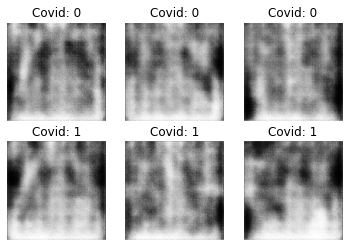

Epoch 42/200 Batch 12/12 [D loss: 0.69333, acc: 56.25%] [G loss: 0.63231]
Epoch 43/200 Batch 12/12 [D loss: 0.65567, acc: 50.00%] [G loss: 0.74353]
Epoch 44/200 Batch 12/12 [D loss: 0.66142, acc: 68.75%] [G loss: 0.73083]
Epoch 45/200 Batch 12/12 [D loss: 0.64035, acc: 81.25%] [G loss: 0.73252]
Epoch 46/200 Batch 12/12 [D loss: 0.65257, acc: 56.25%] [G loss: 0.72764]
Epoch 47/200 Batch 12/12 [D loss: 0.66403, acc: 62.50%] [G loss: 0.63977]
Epoch 48/200 Batch 12/12 [D loss: 0.62734, acc: 81.25%] [G loss: 0.78198]
Epoch 49/200 Batch 12/12 [D loss: 0.65601, acc: 56.25%] [G loss: 0.67823]
Epoch 50/200 Batch 12/12 [D loss: 0.67060, acc: 62.50%] [G loss: 0.79455]
Epoch 51/200 Batch 12/12 [D loss: 0.65449, acc: 56.25%] [G loss: 0.70996]
Epoch 52/200 Batch 12/12 [D loss: 0.62661, acc: 87.50%] [G loss: 0.70276]
Epoch 53/200 Batch 12/12 [D loss: 0.59866, acc: 75.00%] [G loss: 0.74955]
Epoch 54/200 Batch 12/12 [D loss: 0.64198, acc: 68.75%] [G loss: 0.83394]
Epoch 55/200 Batch 12/12 [D loss: 0.62

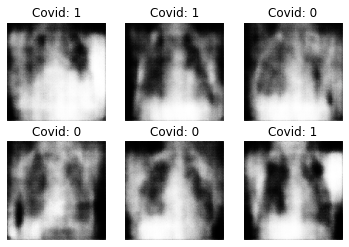

Epoch 62/200 Batch 12/12 [D loss: 0.67676, acc: 68.75%] [G loss: 0.84819]
Epoch 63/200 Batch 12/12 [D loss: 0.44001, acc: 93.75%] [G loss: 1.51865]
Epoch 64/200 Batch 12/12 [D loss: 0.49349, acc: 81.25%] [G loss: 1.36447]
Epoch 65/200 Batch 12/12 [D loss: 0.42428, acc: 87.50%] [G loss: 1.02864]
Epoch 66/200 Batch 12/12 [D loss: 0.45009, acc: 87.50%] [G loss: 1.37504]
Epoch 67/200 Batch 12/12 [D loss: 0.35847, acc: 93.75%] [G loss: 1.52473]
Epoch 68/200 Batch 12/12 [D loss: 0.35644, acc: 93.75%] [G loss: 1.20948]
Epoch 69/200 Batch 12/12 [D loss: 0.25439, acc: 100.00%] [G loss: 1.87203]
Epoch 70/200 Batch 12/12 [D loss: 0.68745, acc: 50.00%] [G loss: 1.44903]
Epoch 71/200 Batch 12/12 [D loss: 0.50711, acc: 81.25%] [G loss: 1.17067]
Epoch 72/200 Batch 12/12 [D loss: 0.64423, acc: 56.25%] [G loss: 0.78458]
Epoch 73/200 Batch 12/12 [D loss: 0.53266, acc: 81.25%] [G loss: 1.23745]
Epoch 74/200 Batch 12/12 [D loss: 0.28990, acc: 87.50%] [G loss: 2.24482]
Epoch 75/200 Batch 12/12 [D loss: 0.6

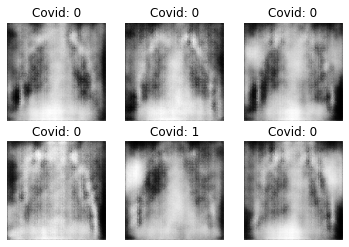

Epoch 82/200 Batch 12/12 [D loss: 0.41504, acc: 87.50%] [G loss: 1.09696]
Epoch 83/200 Batch 12/12 [D loss: 0.55567, acc: 68.75%] [G loss: 0.96030]
Epoch 84/200 Batch 12/12 [D loss: 0.53609, acc: 75.00%] [G loss: 0.92673]
Epoch 85/200 Batch 12/12 [D loss: 0.45711, acc: 87.50%] [G loss: 0.86553]
Epoch 86/200 Batch 12/12 [D loss: 0.48812, acc: 87.50%] [G loss: 1.16833]
Epoch 87/200 Batch 12/12 [D loss: 0.50719, acc: 87.50%] [G loss: 0.96209]
Epoch 88/200 Batch 12/12 [D loss: 0.58416, acc: 62.50%] [G loss: 0.91004]
Epoch 89/200 Batch 12/12 [D loss: 0.44250, acc: 75.00%] [G loss: 1.11890]
Epoch 90/200 Batch 12/12 [D loss: 0.40017, acc: 93.75%] [G loss: 1.00180]
Epoch 91/200 Batch 12/12 [D loss: 0.69660, acc: 56.25%] [G loss: 0.90926]
Epoch 92/200 Batch 12/12 [D loss: 0.65588, acc: 62.50%] [G loss: 1.15104]
Epoch 93/200 Batch 12/12 [D loss: 0.57549, acc: 75.00%] [G loss: 1.01032]
Epoch 94/200 Batch 12/12 [D loss: 0.44203, acc: 93.75%] [G loss: 1.01698]
Epoch 95/200 Batch 12/12 [D loss: 0.46

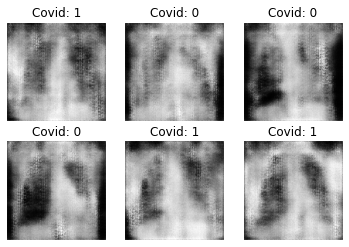

Epoch 102/200 Batch 12/12 [D loss: 0.60421, acc: 68.75%] [G loss: 1.08845]
Epoch 103/200 Batch 12/12 [D loss: 0.56665, acc: 62.50%] [G loss: 1.00402]
Epoch 104/200 Batch 12/12 [D loss: 0.50142, acc: 81.25%] [G loss: 0.98175]
Epoch 105/200 Batch 12/12 [D loss: 0.63133, acc: 62.50%] [G loss: 1.10289]
Epoch 106/200 Batch 12/12 [D loss: 0.59168, acc: 81.25%] [G loss: 1.11297]
Epoch 107/200 Batch 12/12 [D loss: 0.61853, acc: 62.50%] [G loss: 1.11985]
Epoch 108/200 Batch 12/12 [D loss: 0.50244, acc: 75.00%] [G loss: 0.92620]
Epoch 109/200 Batch 12/12 [D loss: 0.58257, acc: 75.00%] [G loss: 1.03750]
Epoch 110/200 Batch 12/12 [D loss: 0.60819, acc: 68.75%] [G loss: 1.02718]
Epoch 111/200 Batch 12/12 [D loss: 0.53555, acc: 68.75%] [G loss: 1.11021]
Epoch 112/200 Batch 12/12 [D loss: 0.45330, acc: 87.50%] [G loss: 0.99661]
Epoch 113/200 Batch 12/12 [D loss: 0.45446, acc: 87.50%] [G loss: 1.10614]
Epoch 114/200 Batch 12/12 [D loss: 0.50540, acc: 87.50%] [G loss: 1.14524]
Epoch 115/200 Batch 12/12

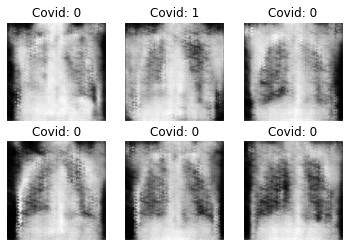

Epoch 122/200 Batch 12/12 [D loss: 0.64659, acc: 56.25%] [G loss: 1.16348]
Epoch 123/200 Batch 12/12 [D loss: 0.56624, acc: 62.50%] [G loss: 1.09276]
Epoch 124/200 Batch 12/12 [D loss: 0.36835, acc: 93.75%] [G loss: 1.61631]
Epoch 125/200 Batch 12/12 [D loss: 0.50176, acc: 81.25%] [G loss: 1.08091]
Epoch 126/200 Batch 12/12 [D loss: 0.41201, acc: 87.50%] [G loss: 1.65349]
Epoch 127/200 Batch 12/12 [D loss: 0.53901, acc: 62.50%] [G loss: 1.21015]
Epoch 128/200 Batch 12/12 [D loss: 0.53151, acc: 93.75%] [G loss: 1.16588]
Epoch 129/200 Batch 12/12 [D loss: 0.49165, acc: 75.00%] [G loss: 0.98891]
Epoch 130/200 Batch 12/12 [D loss: 0.57709, acc: 68.75%] [G loss: 1.37261]
Epoch 131/200 Batch 12/12 [D loss: 0.71956, acc: 68.75%] [G loss: 1.12698]
Epoch 132/200 Batch 12/12 [D loss: 0.46743, acc: 81.25%] [G loss: 1.17649]
Epoch 133/200 Batch 12/12 [D loss: 0.51355, acc: 81.25%] [G loss: 1.02652]
Epoch 134/200 Batch 12/12 [D loss: 0.50482, acc: 81.25%] [G loss: 1.21357]
Epoch 135/200 Batch 12/12

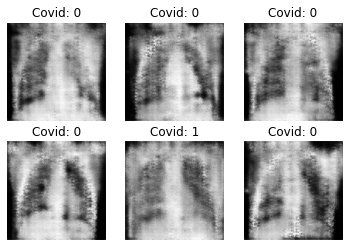

Epoch 142/200 Batch 12/12 [D loss: 0.52447, acc: 75.00%] [G loss: 0.84410]
Epoch 143/200 Batch 12/12 [D loss: 0.48406, acc: 68.75%] [G loss: 0.92700]
Epoch 144/200 Batch 12/12 [D loss: 0.52304, acc: 75.00%] [G loss: 0.88218]
Epoch 145/200 Batch 12/12 [D loss: 0.57951, acc: 68.75%] [G loss: 0.95830]
Epoch 146/200 Batch 12/12 [D loss: 0.52235, acc: 81.25%] [G loss: 0.97749]
Epoch 147/200 Batch 12/12 [D loss: 0.51823, acc: 68.75%] [G loss: 1.05336]
Epoch 148/200 Batch 12/12 [D loss: 0.59337, acc: 75.00%] [G loss: 1.07388]
Epoch 149/200 Batch 12/12 [D loss: 0.51650, acc: 87.50%] [G loss: 0.97325]
Epoch 150/200 Batch 12/12 [D loss: 0.57120, acc: 75.00%] [G loss: 0.84542]
Epoch 151/200 Batch 12/12 [D loss: 0.43208, acc: 93.75%] [G loss: 0.95038]
Epoch 152/200 Batch 12/12 [D loss: 0.67802, acc: 56.25%] [G loss: 0.92585]
Epoch 153/200 Batch 12/12 [D loss: 0.57598, acc: 75.00%] [G loss: 0.97029]
Epoch 154/200 Batch 12/12 [D loss: 0.64882, acc: 56.25%] [G loss: 0.95354]
Epoch 155/200 Batch 12/12

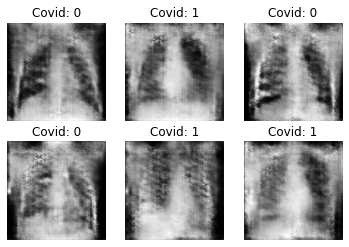

Epoch 162/200 Batch 12/12 [D loss: 0.57886, acc: 68.75%] [G loss: 0.78492]
Epoch 163/200 Batch 12/12 [D loss: 0.58225, acc: 87.50%] [G loss: 1.01461]
Epoch 164/200 Batch 12/12 [D loss: 0.49506, acc: 81.25%] [G loss: 1.00246]
Epoch 165/200 Batch 12/12 [D loss: 0.54446, acc: 75.00%] [G loss: 0.99285]
Epoch 166/200 Batch 12/12 [D loss: 0.60618, acc: 68.75%] [G loss: 0.93002]
Epoch 167/200 Batch 12/12 [D loss: 0.58904, acc: 75.00%] [G loss: 0.96345]
Epoch 168/200 Batch 12/12 [D loss: 0.52031, acc: 81.25%] [G loss: 0.92951]
Epoch 169/200 Batch 12/12 [D loss: 0.57740, acc: 62.50%] [G loss: 1.16213]
Epoch 170/200 Batch 12/12 [D loss: 0.57613, acc: 68.75%] [G loss: 0.90506]
Epoch 171/200 Batch 12/12 [D loss: 0.62366, acc: 68.75%] [G loss: 0.95447]
Epoch 172/200 Batch 12/12 [D loss: 0.59740, acc: 75.00%] [G loss: 0.97506]
Epoch 173/200 Batch 12/12 [D loss: 0.55217, acc: 87.50%] [G loss: 1.01226]
Epoch 174/200 Batch 12/12 [D loss: 0.52806, acc: 81.25%] [G loss: 0.88950]
Epoch 175/200 Batch 12/12

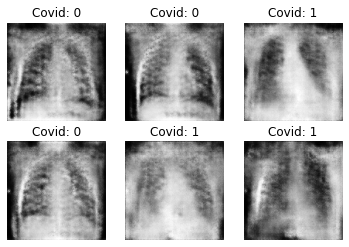

Epoch 182/200 Batch 12/12 [D loss: 0.49375, acc: 87.50%] [G loss: 1.07600]
Epoch 183/200 Batch 12/12 [D loss: 0.58807, acc: 75.00%] [G loss: 0.77951]
Epoch 184/200 Batch 12/12 [D loss: 0.60427, acc: 62.50%] [G loss: 0.96498]
Epoch 185/200 Batch 12/12 [D loss: 0.54869, acc: 75.00%] [G loss: 0.98025]
Epoch 186/200 Batch 12/12 [D loss: 0.52575, acc: 87.50%] [G loss: 0.86738]
Epoch 187/200 Batch 12/12 [D loss: 0.57951, acc: 68.75%] [G loss: 0.97845]
Epoch 188/200 Batch 12/12 [D loss: 0.58185, acc: 68.75%] [G loss: 0.98140]
Epoch 189/200 Batch 12/12 [D loss: 0.63425, acc: 68.75%] [G loss: 0.89360]
Epoch 190/200 Batch 12/12 [D loss: 0.58712, acc: 75.00%] [G loss: 0.96001]
Epoch 191/200 Batch 12/12 [D loss: 0.59211, acc: 68.75%] [G loss: 0.89081]
Epoch 192/200 Batch 12/12 [D loss: 0.51778, acc: 87.50%] [G loss: 1.07369]
Epoch 193/200 Batch 12/12 [D loss: 0.57469, acc: 75.00%] [G loss: 0.97346]
Epoch 194/200 Batch 12/12 [D loss: 0.57452, acc: 68.75%] [G loss: 0.99808]
Epoch 195/200 Batch 12/12

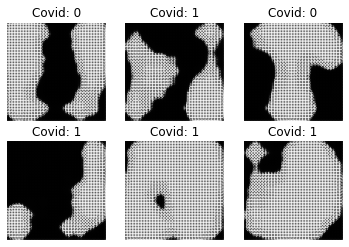

Epoch 2/200 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 306.00494]
Epoch 3/200 Batch 6/6 [D loss: 0.02846, acc: 96.88%] [G loss: 134.28201]
Epoch 4/200 Batch 6/6 [D loss: 0.18582, acc: 93.75%] [G loss: 39.90019]
Epoch 5/200 Batch 6/6 [D loss: 0.38970, acc: 96.88%] [G loss: 40.07854]
Epoch 6/200 Batch 6/6 [D loss: 0.00187, acc: 100.00%] [G loss: 18.13410]
Epoch 7/200 Batch 6/6 [D loss: 0.65697, acc: 87.50%] [G loss: 150.60060]
Epoch 8/200 Batch 6/6 [D loss: 0.26739, acc: 93.75%] [G loss: 22.46157]
Epoch 9/200 Batch 6/6 [D loss: 0.22928, acc: 96.88%] [G loss: 15.12520]
Epoch 10/200 Batch 6/6 [D loss: 0.10251, acc: 96.88%] [G loss: 5.09833]
Epoch 11/200 Batch 6/6 [D loss: 0.23041, acc: 87.50%] [G loss: 5.62553]
Epoch 12/200 Batch 6/6 [D loss: 0.13245, acc: 96.88%] [G loss: 13.36172]
Epoch 13/200 Batch 6/6 [D loss: 0.29665, acc: 90.62%] [G loss: 3.10528]
Epoch 14/200 Batch 6/6 [D loss: 0.06056, acc: 100.00%] [G loss: 5.03269]
Epoch 15/200 Batch 6/6 [D loss: 0.04222, acc: 100.00%] [G

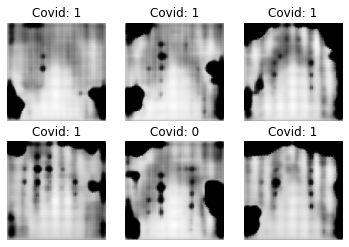

Epoch 22/200 Batch 6/6 [D loss: 0.62529, acc: 65.62%] [G loss: 4.65339]
Epoch 23/200 Batch 6/6 [D loss: 0.68317, acc: 71.88%] [G loss: 2.72614]
Epoch 24/200 Batch 6/6 [D loss: 0.39631, acc: 75.00%] [G loss: 3.67954]
Epoch 25/200 Batch 6/6 [D loss: 0.93583, acc: 65.62%] [G loss: 7.21380]
Epoch 26/200 Batch 6/6 [D loss: 0.26189, acc: 90.62%] [G loss: 2.91426]
Epoch 27/200 Batch 6/6 [D loss: 0.15477, acc: 96.88%] [G loss: 3.38753]
Epoch 28/200 Batch 6/6 [D loss: 0.52658, acc: 71.88%] [G loss: 4.14751]
Epoch 29/200 Batch 6/6 [D loss: 0.37492, acc: 90.62%] [G loss: 2.34936]
Epoch 30/200 Batch 6/6 [D loss: 0.19878, acc: 100.00%] [G loss: 3.24171]
Epoch 31/200 Batch 6/6 [D loss: 0.66661, acc: 62.50%] [G loss: 3.79694]
Epoch 32/200 Batch 6/6 [D loss: 0.33067, acc: 90.62%] [G loss: 3.53912]
Epoch 33/200 Batch 6/6 [D loss: 0.15147, acc: 93.75%] [G loss: 4.29702]
Epoch 34/200 Batch 6/6 [D loss: 0.59441, acc: 71.88%] [G loss: 5.41259]
Epoch 35/200 Batch 6/6 [D loss: 0.17692, acc: 96.88%] [G loss: 

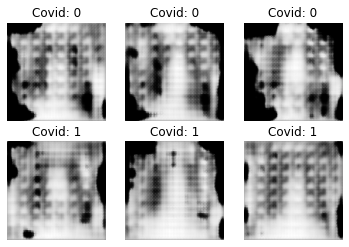

Epoch 42/200 Batch 6/6 [D loss: 0.18218, acc: 100.00%] [G loss: 4.43670]
Epoch 43/200 Batch 6/6 [D loss: 0.17441, acc: 96.88%] [G loss: 5.51675]
Epoch 44/200 Batch 6/6 [D loss: 0.20251, acc: 96.88%] [G loss: 5.80293]
Epoch 45/200 Batch 6/6 [D loss: 0.27727, acc: 87.50%] [G loss: 6.65428]
Epoch 46/200 Batch 6/6 [D loss: 0.42008, acc: 90.62%] [G loss: 3.21743]
Epoch 47/200 Batch 6/6 [D loss: 0.46502, acc: 84.38%] [G loss: 2.96472]
Epoch 48/200 Batch 6/6 [D loss: 0.41677, acc: 87.50%] [G loss: 3.22219]
Epoch 49/200 Batch 6/6 [D loss: 0.38070, acc: 87.50%] [G loss: 3.20084]
Epoch 50/200 Batch 6/6 [D loss: 0.22829, acc: 100.00%] [G loss: 3.18474]
Epoch 51/200 Batch 6/6 [D loss: 0.19282, acc: 96.88%] [G loss: 3.55386]
Epoch 52/200 Batch 6/6 [D loss: 0.18405, acc: 96.88%] [G loss: 2.88558]
Epoch 53/200 Batch 6/6 [D loss: 0.23398, acc: 90.62%] [G loss: 3.44964]
Epoch 54/200 Batch 6/6 [D loss: 0.32777, acc: 84.38%] [G loss: 3.28478]
Epoch 55/200 Batch 6/6 [D loss: 0.84573, acc: 71.88%] [G loss:

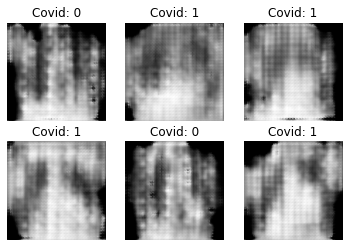

Epoch 62/200 Batch 6/6 [D loss: 0.33947, acc: 87.50%] [G loss: 3.62148]
Epoch 63/200 Batch 6/6 [D loss: 0.43474, acc: 75.00%] [G loss: 3.83232]
Epoch 64/200 Batch 6/6 [D loss: 0.15351, acc: 100.00%] [G loss: 3.47768]
Epoch 65/200 Batch 6/6 [D loss: 0.09488, acc: 100.00%] [G loss: 2.87425]
Epoch 66/200 Batch 6/6 [D loss: 0.23374, acc: 90.62%] [G loss: 3.40694]
Epoch 67/200 Batch 6/6 [D loss: 0.78178, acc: 65.62%] [G loss: 4.05364]
Epoch 68/200 Batch 6/6 [D loss: 0.12317, acc: 100.00%] [G loss: 3.05494]
Epoch 69/200 Batch 6/6 [D loss: 0.54776, acc: 75.00%] [G loss: 3.76264]
Epoch 70/200 Batch 6/6 [D loss: 0.24620, acc: 93.75%] [G loss: 3.53398]
Epoch 71/200 Batch 6/6 [D loss: 0.58000, acc: 75.00%] [G loss: 5.73763]
Epoch 72/200 Batch 6/6 [D loss: 0.30143, acc: 84.38%] [G loss: 4.20386]
Epoch 73/200 Batch 6/6 [D loss: 0.15368, acc: 93.75%] [G loss: 2.91014]
Epoch 74/200 Batch 6/6 [D loss: 0.21809, acc: 87.50%] [G loss: 3.55705]
Epoch 75/200 Batch 6/6 [D loss: 0.43154, acc: 84.38%] [G loss

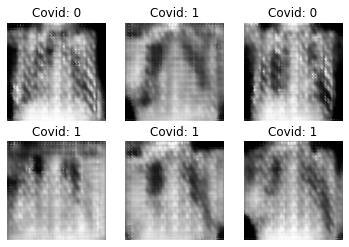

Epoch 82/200 Batch 6/6 [D loss: 0.77473, acc: 65.62%] [G loss: 8.38715]
Epoch 83/200 Batch 6/6 [D loss: 0.26288, acc: 96.88%] [G loss: 3.04209]
Epoch 84/200 Batch 6/6 [D loss: 0.26029, acc: 87.50%] [G loss: 3.38275]
Epoch 85/200 Batch 6/6 [D loss: 0.57963, acc: 71.88%] [G loss: 8.12249]
Epoch 86/200 Batch 6/6 [D loss: 0.34608, acc: 78.12%] [G loss: 3.81799]
Epoch 87/200 Batch 6/6 [D loss: 0.38130, acc: 78.12%] [G loss: 3.42944]
Epoch 88/200 Batch 6/6 [D loss: 0.32656, acc: 84.38%] [G loss: 4.44473]
Epoch 89/200 Batch 6/6 [D loss: 0.26329, acc: 90.62%] [G loss: 3.86470]
Epoch 90/200 Batch 6/6 [D loss: 1.79362, acc: 31.25%] [G loss: 4.35575]
Epoch 91/200 Batch 6/6 [D loss: 0.28107, acc: 90.62%] [G loss: 3.27476]
Epoch 92/200 Batch 6/6 [D loss: 0.27999, acc: 93.75%] [G loss: 3.71976]
Epoch 93/200 Batch 6/6 [D loss: 0.18725, acc: 90.62%] [G loss: 4.51015]
Epoch 94/200 Batch 6/6 [D loss: 0.27400, acc: 90.62%] [G loss: 5.51315]
Epoch 95/200 Batch 6/6 [D loss: 0.20956, acc: 93.75%] [G loss: 2

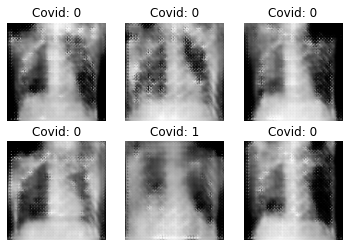

Epoch 102/200 Batch 6/6 [D loss: 0.20419, acc: 90.62%] [G loss: 5.89995]
Epoch 103/200 Batch 6/6 [D loss: 0.29763, acc: 93.75%] [G loss: 3.84263]
Epoch 104/200 Batch 6/6 [D loss: 0.24129, acc: 84.38%] [G loss: 3.52048]
Epoch 105/200 Batch 6/6 [D loss: 0.08977, acc: 96.88%] [G loss: 4.30339]
Epoch 106/200 Batch 6/6 [D loss: 0.16415, acc: 96.88%] [G loss: 4.16177]
Epoch 107/200 Batch 6/6 [D loss: 0.27340, acc: 90.62%] [G loss: 4.31292]
Epoch 108/200 Batch 6/6 [D loss: 0.21600, acc: 90.62%] [G loss: 3.79133]
Epoch 109/200 Batch 6/6 [D loss: 0.59027, acc: 68.75%] [G loss: 3.90309]
Epoch 110/200 Batch 6/6 [D loss: 0.18199, acc: 93.75%] [G loss: 4.92345]
Epoch 111/200 Batch 6/6 [D loss: 0.33418, acc: 81.25%] [G loss: 3.78373]
Epoch 112/200 Batch 6/6 [D loss: 0.35532, acc: 84.38%] [G loss: 5.27072]
Epoch 113/200 Batch 6/6 [D loss: 0.20869, acc: 96.88%] [G loss: 5.23254]
Epoch 114/200 Batch 6/6 [D loss: 0.22901, acc: 93.75%] [G loss: 5.35818]
Epoch 115/200 Batch 6/6 [D loss: 0.53517, acc: 68.7

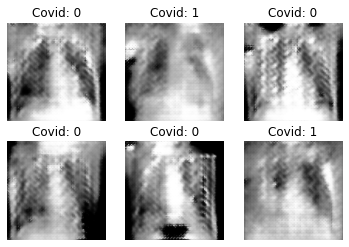

Epoch 122/200 Batch 6/6 [D loss: 0.43781, acc: 84.38%] [G loss: 3.95800]
Epoch 123/200 Batch 6/6 [D loss: 0.37987, acc: 90.62%] [G loss: 3.97835]
Epoch 124/200 Batch 6/6 [D loss: 0.14876, acc: 96.88%] [G loss: 3.57250]
Epoch 125/200 Batch 6/6 [D loss: 0.07507, acc: 96.88%] [G loss: 4.78615]
Epoch 126/200 Batch 6/6 [D loss: 1.15568, acc: 59.38%] [G loss: 5.83719]
Epoch 127/200 Batch 6/6 [D loss: 0.30037, acc: 84.38%] [G loss: 4.98391]
Epoch 128/200 Batch 6/6 [D loss: 0.32279, acc: 81.25%] [G loss: 4.64669]
Epoch 129/200 Batch 6/6 [D loss: 0.13739, acc: 100.00%] [G loss: 3.50533]
Epoch 130/200 Batch 6/6 [D loss: 0.29360, acc: 81.25%] [G loss: 4.67950]
Epoch 131/200 Batch 6/6 [D loss: 0.14735, acc: 96.88%] [G loss: 4.00334]
Epoch 132/200 Batch 6/6 [D loss: 0.05885, acc: 100.00%] [G loss: 3.86775]
Epoch 133/200 Batch 6/6 [D loss: 0.30914, acc: 87.50%] [G loss: 5.42729]
Epoch 134/200 Batch 6/6 [D loss: 0.33494, acc: 75.00%] [G loss: 5.35228]
Epoch 135/200 Batch 6/6 [D loss: 0.17660, acc: 90

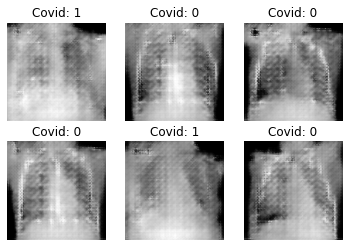

Epoch 142/200 Batch 6/6 [D loss: 0.15932, acc: 96.88%] [G loss: 3.88784]
Epoch 143/200 Batch 6/6 [D loss: 0.23248, acc: 87.50%] [G loss: 4.87654]
Epoch 144/200 Batch 6/6 [D loss: 0.21593, acc: 87.50%] [G loss: 3.41300]
Epoch 145/200 Batch 6/6 [D loss: 0.19695, acc: 93.75%] [G loss: 6.60859]
Epoch 146/200 Batch 6/6 [D loss: 0.20195, acc: 93.75%] [G loss: 5.91898]
Epoch 147/200 Batch 6/6 [D loss: 0.33607, acc: 81.25%] [G loss: 3.35987]
Epoch 148/200 Batch 6/6 [D loss: 0.07068, acc: 100.00%] [G loss: 4.61258]
Epoch 149/200 Batch 6/6 [D loss: 0.13690, acc: 93.75%] [G loss: 5.58408]
Epoch 150/200 Batch 6/6 [D loss: 0.50054, acc: 75.00%] [G loss: 4.76078]
Epoch 151/200 Batch 6/6 [D loss: 0.09767, acc: 100.00%] [G loss: 3.11399]
Epoch 152/200 Batch 6/6 [D loss: 0.51167, acc: 78.12%] [G loss: 4.79995]
Epoch 153/200 Batch 6/6 [D loss: 0.48223, acc: 71.88%] [G loss: 3.87290]
Epoch 154/200 Batch 6/6 [D loss: 0.12387, acc: 96.88%] [G loss: 5.66294]
Epoch 155/200 Batch 6/6 [D loss: 0.10676, acc: 93

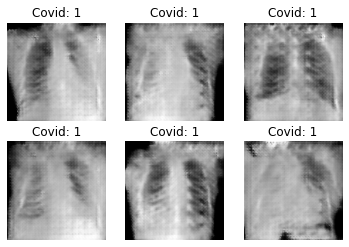

Epoch 162/200 Batch 6/6 [D loss: 0.14861, acc: 93.75%] [G loss: 4.31848]
Epoch 163/200 Batch 6/6 [D loss: 0.11288, acc: 96.88%] [G loss: 5.39477]
Epoch 164/200 Batch 6/6 [D loss: 0.09769, acc: 100.00%] [G loss: 4.28232]
Epoch 165/200 Batch 6/6 [D loss: 0.04916, acc: 100.00%] [G loss: 2.98666]
Epoch 166/200 Batch 6/6 [D loss: 0.22335, acc: 90.62%] [G loss: 3.54516]
Epoch 167/200 Batch 6/6 [D loss: 0.25077, acc: 84.38%] [G loss: 6.39505]
Epoch 168/200 Batch 6/6 [D loss: 0.28969, acc: 84.38%] [G loss: 5.17062]
Epoch 169/200 Batch 6/6 [D loss: 0.79042, acc: 62.50%] [G loss: 7.40452]
Epoch 170/200 Batch 6/6 [D loss: 0.37974, acc: 78.12%] [G loss: 3.54930]
Epoch 171/200 Batch 6/6 [D loss: 0.39917, acc: 84.38%] [G loss: 7.60499]
Epoch 172/200 Batch 6/6 [D loss: 0.11627, acc: 100.00%] [G loss: 3.66485]
Epoch 173/200 Batch 6/6 [D loss: 0.48038, acc: 75.00%] [G loss: 8.36478]
Epoch 174/200 Batch 6/6 [D loss: 0.14951, acc: 96.88%] [G loss: 3.94281]
Epoch 175/200 Batch 6/6 [D loss: 0.19719, acc: 9

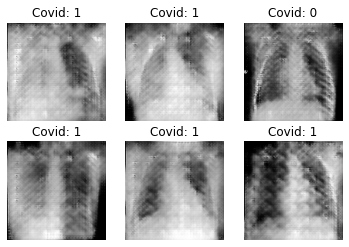

Epoch 182/200 Batch 6/6 [D loss: 0.22843, acc: 87.50%] [G loss: 5.94427]
Epoch 183/200 Batch 6/6 [D loss: 0.11258, acc: 96.88%] [G loss: 6.31072]
Epoch 184/200 Batch 6/6 [D loss: 0.20446, acc: 90.62%] [G loss: 4.67496]
Epoch 185/200 Batch 6/6 [D loss: 0.17961, acc: 93.75%] [G loss: 3.74682]
Epoch 186/200 Batch 6/6 [D loss: 0.15254, acc: 96.88%] [G loss: 5.35082]
Epoch 187/200 Batch 6/6 [D loss: 0.20666, acc: 90.62%] [G loss: 7.32521]
Epoch 188/200 Batch 6/6 [D loss: 0.42837, acc: 84.38%] [G loss: 7.13369]
Epoch 189/200 Batch 6/6 [D loss: 0.20122, acc: 93.75%] [G loss: 4.46211]
Epoch 190/200 Batch 6/6 [D loss: 0.13627, acc: 93.75%] [G loss: 5.83313]
Epoch 191/200 Batch 6/6 [D loss: 0.13080, acc: 96.88%] [G loss: 5.18269]
Epoch 192/200 Batch 6/6 [D loss: 0.35777, acc: 81.25%] [G loss: 4.77169]
Epoch 193/200 Batch 6/6 [D loss: 0.48340, acc: 81.25%] [G loss: 4.32812]
Epoch 194/200 Batch 6/6 [D loss: 0.12059, acc: 96.88%] [G loss: 5.17203]
Epoch 195/200 Batch 6/6 [D loss: 0.15784, acc: 93.7

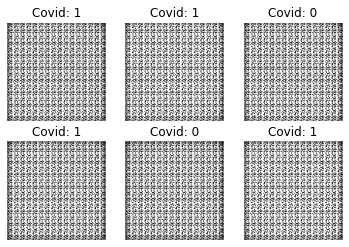

Epoch 2/200 Batch 6/6 [D loss: 1.20101, acc: 46.88%] [G loss: 31.69087]
Epoch 3/200 Batch 6/6 [D loss: 0.01622, acc: 100.00%] [G loss: 7.09777]
Epoch 4/200 Batch 6/6 [D loss: 3.11835, acc: 59.38%] [G loss: 43.61184]
Epoch 5/200 Batch 6/6 [D loss: 0.00021, acc: 100.00%] [G loss: 11.02302]
Epoch 6/200 Batch 6/6 [D loss: 0.29651, acc: 81.25%] [G loss: 5.53602]
Epoch 7/200 Batch 6/6 [D loss: 0.10574, acc: 100.00%] [G loss: 2.56231]
Epoch 8/200 Batch 6/6 [D loss: 0.01628, acc: 100.00%] [G loss: 4.04330]
Epoch 9/200 Batch 6/6 [D loss: 0.00875, acc: 100.00%] [G loss: 5.09217]
Epoch 10/200 Batch 6/6 [D loss: 0.01637, acc: 100.00%] [G loss: 6.16865]
Epoch 11/200 Batch 6/6 [D loss: 0.02069, acc: 100.00%] [G loss: 8.80121]
Epoch 12/200 Batch 6/6 [D loss: 0.05079, acc: 100.00%] [G loss: 9.51249]
Epoch 13/200 Batch 6/6 [D loss: 0.01164, acc: 100.00%] [G loss: 6.92423]
Epoch 14/200 Batch 6/6 [D loss: 0.00327, acc: 100.00%] [G loss: 6.99767]
Epoch 15/200 Batch 6/6 [D loss: 0.43608, acc: 78.12%] [G lo

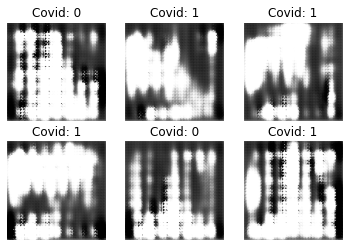

Epoch 22/200 Batch 6/6 [D loss: 0.39159, acc: 81.25%] [G loss: 3.91311]
Epoch 23/200 Batch 6/6 [D loss: 0.41145, acc: 84.38%] [G loss: 2.44809]
Epoch 24/200 Batch 6/6 [D loss: 0.41058, acc: 84.38%] [G loss: 2.25338]
Epoch 25/200 Batch 6/6 [D loss: 0.55678, acc: 68.75%] [G loss: 1.63267]
Epoch 26/200 Batch 6/6 [D loss: 0.46748, acc: 84.38%] [G loss: 1.94346]
Epoch 27/200 Batch 6/6 [D loss: 0.45070, acc: 84.38%] [G loss: 1.95692]
Epoch 28/200 Batch 6/6 [D loss: 0.41859, acc: 90.62%] [G loss: 2.02665]
Epoch 29/200 Batch 6/6 [D loss: 0.41557, acc: 75.00%] [G loss: 1.84788]
Epoch 30/200 Batch 6/6 [D loss: 0.39697, acc: 87.50%] [G loss: 1.91493]
Epoch 31/200 Batch 6/6 [D loss: 0.50295, acc: 75.00%] [G loss: 2.16914]
Epoch 32/200 Batch 6/6 [D loss: 0.25917, acc: 90.62%] [G loss: 3.44778]
Epoch 33/200 Batch 6/6 [D loss: 0.74622, acc: 62.50%] [G loss: 1.44060]
Epoch 34/200 Batch 6/6 [D loss: 0.49540, acc: 75.00%] [G loss: 2.50239]
Epoch 35/200 Batch 6/6 [D loss: 0.38557, acc: 87.50%] [G loss: 1

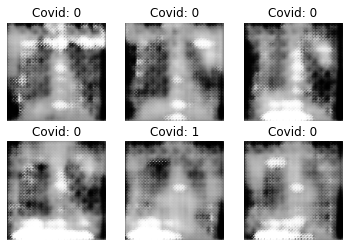

Epoch 42/200 Batch 6/6 [D loss: 0.67894, acc: 65.62%] [G loss: 1.90802]
Epoch 43/200 Batch 6/6 [D loss: 0.54633, acc: 68.75%] [G loss: 1.36070]
Epoch 44/200 Batch 6/6 [D loss: 0.49023, acc: 75.00%] [G loss: 1.22246]
Epoch 45/200 Batch 6/6 [D loss: 0.73057, acc: 59.38%] [G loss: 1.24164]
Epoch 46/200 Batch 6/6 [D loss: 0.47801, acc: 90.62%] [G loss: 1.74918]
Epoch 47/200 Batch 6/6 [D loss: 0.49876, acc: 81.25%] [G loss: 1.43986]
Epoch 48/200 Batch 6/6 [D loss: 0.66126, acc: 56.25%] [G loss: 1.20885]
Epoch 49/200 Batch 6/6 [D loss: 0.49866, acc: 81.25%] [G loss: 1.37996]
Epoch 50/200 Batch 6/6 [D loss: 0.42010, acc: 84.38%] [G loss: 1.56727]
Epoch 51/200 Batch 6/6 [D loss: 0.33415, acc: 90.62%] [G loss: 1.52334]
Epoch 52/200 Batch 6/6 [D loss: 0.40607, acc: 87.50%] [G loss: 1.89547]
Epoch 53/200 Batch 6/6 [D loss: 0.51121, acc: 71.88%] [G loss: 3.18094]
Epoch 54/200 Batch 6/6 [D loss: 0.40266, acc: 81.25%] [G loss: 2.18887]
Epoch 55/200 Batch 6/6 [D loss: 0.43237, acc: 81.25%] [G loss: 2

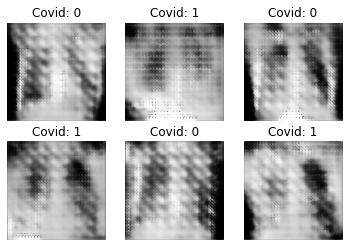

Epoch 62/200 Batch 6/6 [D loss: 0.42252, acc: 81.25%] [G loss: 2.15847]
Epoch 63/200 Batch 6/6 [D loss: 0.27387, acc: 90.62%] [G loss: 1.84569]
Epoch 64/200 Batch 6/6 [D loss: 0.30924, acc: 81.25%] [G loss: 2.41752]
Epoch 65/200 Batch 6/6 [D loss: 0.31765, acc: 81.25%] [G loss: 3.15418]
Epoch 66/200 Batch 6/6 [D loss: 0.51250, acc: 71.88%] [G loss: 1.26040]
Epoch 67/200 Batch 6/6 [D loss: 0.41000, acc: 87.50%] [G loss: 2.27074]
Epoch 68/200 Batch 6/6 [D loss: 0.13605, acc: 96.88%] [G loss: 2.80199]
Epoch 69/200 Batch 6/6 [D loss: 0.43199, acc: 84.38%] [G loss: 2.39396]
Epoch 70/200 Batch 6/6 [D loss: 0.32272, acc: 90.62%] [G loss: 3.15086]
Epoch 71/200 Batch 6/6 [D loss: 0.41424, acc: 75.00%] [G loss: 1.85044]
Epoch 72/200 Batch 6/6 [D loss: 0.50261, acc: 78.12%] [G loss: 2.67916]
Epoch 73/200 Batch 6/6 [D loss: 0.37432, acc: 81.25%] [G loss: 2.45798]
Epoch 74/200 Batch 6/6 [D loss: 0.36580, acc: 87.50%] [G loss: 2.38295]
Epoch 75/200 Batch 6/6 [D loss: 0.54684, acc: 68.75%] [G loss: 3

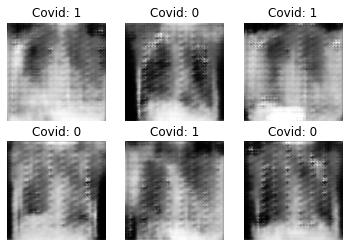

Epoch 82/200 Batch 6/6 [D loss: 0.29404, acc: 84.38%] [G loss: 2.64918]
Epoch 83/200 Batch 6/6 [D loss: 0.40608, acc: 78.12%] [G loss: 2.67634]
Epoch 84/200 Batch 6/6 [D loss: 0.60691, acc: 59.38%] [G loss: 2.32648]
Epoch 85/200 Batch 6/6 [D loss: 0.69840, acc: 59.38%] [G loss: 4.21171]
Epoch 86/200 Batch 6/6 [D loss: 0.36176, acc: 81.25%] [G loss: 2.13328]
Epoch 87/200 Batch 6/6 [D loss: 0.56353, acc: 81.25%] [G loss: 2.22442]
Epoch 88/200 Batch 6/6 [D loss: 0.27537, acc: 90.62%] [G loss: 2.69319]
Epoch 89/200 Batch 6/6 [D loss: 0.40704, acc: 78.12%] [G loss: 2.81349]
Epoch 90/200 Batch 6/6 [D loss: 0.33457, acc: 84.38%] [G loss: 2.13720]
Epoch 91/200 Batch 6/6 [D loss: 0.38019, acc: 84.38%] [G loss: 2.26520]
Epoch 92/200 Batch 6/6 [D loss: 0.27548, acc: 96.88%] [G loss: 2.71258]
Epoch 93/200 Batch 6/6 [D loss: 0.30072, acc: 84.38%] [G loss: 2.67225]
Epoch 94/200 Batch 6/6 [D loss: 0.39508, acc: 84.38%] [G loss: 2.13006]
Epoch 95/200 Batch 6/6 [D loss: 0.54253, acc: 71.88%] [G loss: 2

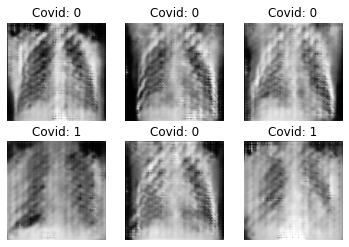

Epoch 102/200 Batch 6/6 [D loss: 0.34589, acc: 93.75%] [G loss: 2.64468]
Epoch 103/200 Batch 6/6 [D loss: 0.38688, acc: 81.25%] [G loss: 1.68528]
Epoch 104/200 Batch 6/6 [D loss: 0.33191, acc: 81.25%] [G loss: 2.57061]
Epoch 105/200 Batch 6/6 [D loss: 0.50865, acc: 75.00%] [G loss: 2.67526]
Epoch 106/200 Batch 6/6 [D loss: 0.45762, acc: 84.38%] [G loss: 3.49589]
Epoch 107/200 Batch 6/6 [D loss: 0.45422, acc: 84.38%] [G loss: 2.42208]
Epoch 108/200 Batch 6/6 [D loss: 0.41737, acc: 75.00%] [G loss: 2.46339]
Epoch 109/200 Batch 6/6 [D loss: 0.59633, acc: 71.88%] [G loss: 2.20182]
Epoch 110/200 Batch 6/6 [D loss: 0.28834, acc: 84.38%] [G loss: 2.76925]
Epoch 111/200 Batch 6/6 [D loss: 0.62447, acc: 68.75%] [G loss: 2.01129]
Epoch 112/200 Batch 6/6 [D loss: 0.26167, acc: 90.62%] [G loss: 3.05634]
Epoch 113/200 Batch 6/6 [D loss: 0.33551, acc: 90.62%] [G loss: 3.91758]
Epoch 114/200 Batch 6/6 [D loss: 0.62641, acc: 65.62%] [G loss: 3.09686]
Epoch 115/200 Batch 6/6 [D loss: 0.39885, acc: 84.3

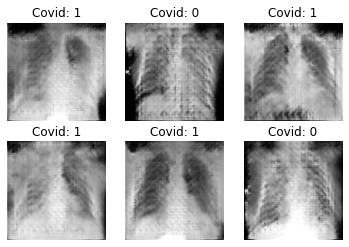

Epoch 122/200 Batch 6/6 [D loss: 0.38474, acc: 90.62%] [G loss: 2.70320]
Epoch 123/200 Batch 6/6 [D loss: 0.38290, acc: 87.50%] [G loss: 2.03136]
Epoch 124/200 Batch 6/6 [D loss: 0.53698, acc: 68.75%] [G loss: 2.76213]
Epoch 125/200 Batch 6/6 [D loss: 0.45513, acc: 75.00%] [G loss: 2.38103]
Epoch 126/200 Batch 6/6 [D loss: 0.34716, acc: 84.38%] [G loss: 2.93169]
Epoch 127/200 Batch 6/6 [D loss: 0.42898, acc: 71.88%] [G loss: 1.66855]
Epoch 128/200 Batch 6/6 [D loss: 0.35991, acc: 87.50%] [G loss: 4.11639]
Epoch 129/200 Batch 6/6 [D loss: 0.40388, acc: 84.38%] [G loss: 3.03071]
Epoch 130/200 Batch 6/6 [D loss: 0.35148, acc: 87.50%] [G loss: 2.61686]
Epoch 131/200 Batch 6/6 [D loss: 0.21047, acc: 96.88%] [G loss: 2.95305]
Epoch 132/200 Batch 6/6 [D loss: 0.29073, acc: 90.62%] [G loss: 2.32655]
Epoch 133/200 Batch 6/6 [D loss: 0.41907, acc: 81.25%] [G loss: 3.08043]
Epoch 134/200 Batch 6/6 [D loss: 0.42045, acc: 75.00%] [G loss: 2.25721]
Epoch 135/200 Batch 6/6 [D loss: 0.44387, acc: 78.1

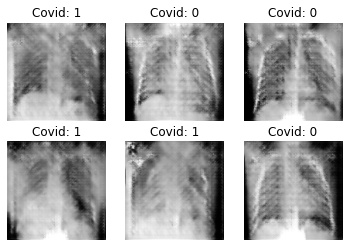

Epoch 142/200 Batch 6/6 [D loss: 0.39089, acc: 87.50%] [G loss: 2.39611]
Epoch 143/200 Batch 6/6 [D loss: 0.22730, acc: 93.75%] [G loss: 2.83904]
Epoch 144/200 Batch 6/6 [D loss: 0.32407, acc: 93.75%] [G loss: 2.83057]
Epoch 145/200 Batch 6/6 [D loss: 0.27734, acc: 90.62%] [G loss: 2.54587]
Epoch 146/200 Batch 6/6 [D loss: 0.31578, acc: 87.50%] [G loss: 2.51151]
Epoch 147/200 Batch 6/6 [D loss: 0.43065, acc: 78.12%] [G loss: 2.84836]
Epoch 148/200 Batch 6/6 [D loss: 0.43417, acc: 78.12%] [G loss: 3.67560]
Epoch 149/200 Batch 6/6 [D loss: 0.32433, acc: 93.75%] [G loss: 3.09419]
Epoch 150/200 Batch 6/6 [D loss: 0.30933, acc: 90.62%] [G loss: 3.15468]
Epoch 151/200 Batch 6/6 [D loss: 0.27568, acc: 90.62%] [G loss: 2.59557]
Epoch 152/200 Batch 6/6 [D loss: 0.57028, acc: 68.75%] [G loss: 2.79366]
Epoch 153/200 Batch 6/6 [D loss: 0.29936, acc: 87.50%] [G loss: 2.95367]
Epoch 154/200 Batch 6/6 [D loss: 0.22263, acc: 96.88%] [G loss: 2.29681]
Epoch 155/200 Batch 6/6 [D loss: 0.35822, acc: 87.5

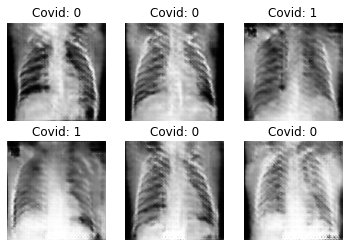

Epoch 162/200 Batch 6/6 [D loss: 0.22564, acc: 93.75%] [G loss: 3.86982]
Epoch 163/200 Batch 6/6 [D loss: 0.18353, acc: 93.75%] [G loss: 2.11122]
Epoch 164/200 Batch 6/6 [D loss: 0.38558, acc: 87.50%] [G loss: 2.01695]
Epoch 165/200 Batch 6/6 [D loss: 0.24154, acc: 96.88%] [G loss: 2.56451]
Epoch 166/200 Batch 6/6 [D loss: 0.10999, acc: 100.00%] [G loss: 3.33656]
Epoch 167/200 Batch 6/6 [D loss: 0.23417, acc: 93.75%] [G loss: 3.35319]
Epoch 168/200 Batch 6/6 [D loss: 0.39956, acc: 87.50%] [G loss: 3.86295]
Epoch 169/200 Batch 6/6 [D loss: 0.37603, acc: 84.38%] [G loss: 3.29707]
Epoch 170/200 Batch 6/6 [D loss: 0.24664, acc: 87.50%] [G loss: 4.45487]
Epoch 171/200 Batch 6/6 [D loss: 0.38383, acc: 87.50%] [G loss: 2.74151]
Epoch 172/200 Batch 6/6 [D loss: 0.29837, acc: 90.62%] [G loss: 3.89559]
Epoch 173/200 Batch 6/6 [D loss: 0.37516, acc: 87.50%] [G loss: 3.10434]
Epoch 174/200 Batch 6/6 [D loss: 0.25216, acc: 96.88%] [G loss: 3.44628]
Epoch 175/200 Batch 6/6 [D loss: 0.35690, acc: 84.

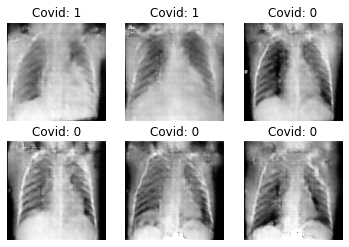

Epoch 182/200 Batch 6/6 [D loss: 0.18083, acc: 93.75%] [G loss: 3.20990]
Epoch 183/200 Batch 6/6 [D loss: 0.30705, acc: 90.62%] [G loss: 3.53303]
Epoch 184/200 Batch 6/6 [D loss: 0.27180, acc: 84.38%] [G loss: 2.87514]
Epoch 185/200 Batch 6/6 [D loss: 0.35577, acc: 78.12%] [G loss: 4.22898]
Epoch 186/200 Batch 6/6 [D loss: 0.20901, acc: 96.88%] [G loss: 3.62243]
Epoch 187/200 Batch 6/6 [D loss: 0.36805, acc: 81.25%] [G loss: 5.23293]
Epoch 188/200 Batch 6/6 [D loss: 0.33790, acc: 75.00%] [G loss: 3.64947]
Epoch 189/200 Batch 6/6 [D loss: 0.61292, acc: 75.00%] [G loss: 8.62862]
Epoch 190/200 Batch 6/6 [D loss: 0.39588, acc: 81.25%] [G loss: 2.68238]
Epoch 191/200 Batch 6/6 [D loss: 0.47015, acc: 78.12%] [G loss: 3.98039]
Epoch 192/200 Batch 6/6 [D loss: 0.32507, acc: 84.38%] [G loss: 3.25052]
Epoch 193/200 Batch 6/6 [D loss: 0.35326, acc: 78.12%] [G loss: 3.45674]
Epoch 194/200 Batch 6/6 [D loss: 0.32574, acc: 84.38%] [G loss: 3.47542]
Epoch 195/200 Batch 6/6 [D loss: 0.21013, acc: 93.7

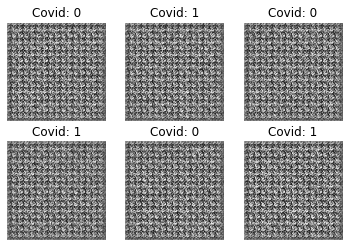

Epoch 2/200 Batch 6/6 [D loss: 0.44181, acc: 100.00%] [G loss: 1.04427]
Epoch 3/200 Batch 6/6 [D loss: 0.29620, acc: 100.00%] [G loss: 1.82118]
Epoch 4/200 Batch 6/6 [D loss: 0.12689, acc: 100.00%] [G loss: 2.73769]
Epoch 5/200 Batch 6/6 [D loss: 0.40001, acc: 87.50%] [G loss: 2.96134]
Epoch 6/200 Batch 6/6 [D loss: 0.36136, acc: 93.75%] [G loss: 2.96664]
Epoch 7/200 Batch 6/6 [D loss: 0.41744, acc: 87.50%] [G loss: 2.60224]
Epoch 8/200 Batch 6/6 [D loss: 1.02374, acc: 37.50%] [G loss: 1.33588]
Epoch 9/200 Batch 6/6 [D loss: 0.72336, acc: 56.25%] [G loss: 0.77808]
Epoch 10/200 Batch 6/6 [D loss: 0.62600, acc: 56.25%] [G loss: 1.65940]
Epoch 11/200 Batch 6/6 [D loss: 0.65576, acc: 53.12%] [G loss: 1.18748]
Epoch 12/200 Batch 6/6 [D loss: 0.68758, acc: 59.38%] [G loss: 1.58039]
Epoch 13/200 Batch 6/6 [D loss: 0.48040, acc: 81.25%] [G loss: 1.06088]
Epoch 14/200 Batch 6/6 [D loss: 0.69376, acc: 59.38%] [G loss: 0.94015]
Epoch 15/200 Batch 6/6 [D loss: 0.59242, acc: 59.38%] [G loss: 0.7100

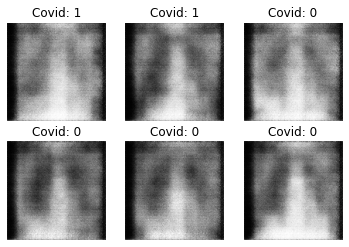

Epoch 22/200 Batch 6/6 [D loss: 0.57937, acc: 87.50%] [G loss: 0.92858]
Epoch 23/200 Batch 6/6 [D loss: 0.64459, acc: 71.88%] [G loss: 0.81733]
Epoch 24/200 Batch 6/6 [D loss: 0.62096, acc: 68.75%] [G loss: 0.73507]
Epoch 25/200 Batch 6/6 [D loss: 0.76434, acc: 18.75%] [G loss: 0.69891]
Epoch 26/200 Batch 6/6 [D loss: 0.68532, acc: 53.12%] [G loss: 0.80056]
Epoch 27/200 Batch 6/6 [D loss: 0.63783, acc: 59.38%] [G loss: 0.81335]
Epoch 28/200 Batch 6/6 [D loss: 0.71921, acc: 50.00%] [G loss: 0.67856]
Epoch 29/200 Batch 6/6 [D loss: 0.64820, acc: 56.25%] [G loss: 0.64264]
Epoch 30/200 Batch 6/6 [D loss: 0.66560, acc: 50.00%] [G loss: 0.66821]
Epoch 31/200 Batch 6/6 [D loss: 0.72641, acc: 50.00%] [G loss: 0.74053]
Epoch 32/200 Batch 6/6 [D loss: 0.65498, acc: 59.38%] [G loss: 0.76112]
Epoch 33/200 Batch 6/6 [D loss: 0.58897, acc: 71.88%] [G loss: 0.69397]
Epoch 34/200 Batch 6/6 [D loss: 0.69750, acc: 46.88%] [G loss: 0.50259]
Epoch 35/200 Batch 6/6 [D loss: 0.69276, acc: 43.75%] [G loss: 0

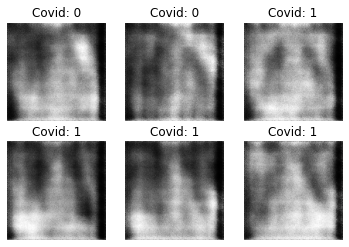

Epoch 42/200 Batch 6/6 [D loss: 0.73514, acc: 43.75%] [G loss: 0.66752]
Epoch 43/200 Batch 6/6 [D loss: 0.67774, acc: 65.62%] [G loss: 0.78998]
Epoch 44/200 Batch 6/6 [D loss: 0.65731, acc: 71.88%] [G loss: 0.83635]
Epoch 45/200 Batch 6/6 [D loss: 0.61192, acc: 81.25%] [G loss: 0.74987]
Epoch 46/200 Batch 6/6 [D loss: 0.64607, acc: 65.62%] [G loss: 0.61638]
Epoch 47/200 Batch 6/6 [D loss: 0.78618, acc: 31.25%] [G loss: 0.54170]
Epoch 48/200 Batch 6/6 [D loss: 0.72440, acc: 50.00%] [G loss: 0.65189]
Epoch 49/200 Batch 6/6 [D loss: 0.67405, acc: 59.38%] [G loss: 0.81296]
Epoch 50/200 Batch 6/6 [D loss: 0.67495, acc: 59.38%] [G loss: 0.70820]
Epoch 51/200 Batch 6/6 [D loss: 0.68332, acc: 46.88%] [G loss: 0.66637]
Epoch 52/200 Batch 6/6 [D loss: 0.72335, acc: 34.38%] [G loss: 0.65516]
Epoch 53/200 Batch 6/6 [D loss: 0.72464, acc: 34.38%] [G loss: 0.64744]
Epoch 54/200 Batch 6/6 [D loss: 0.70813, acc: 31.25%] [G loss: 0.66458]
Epoch 55/200 Batch 6/6 [D loss: 0.67232, acc: 59.38%] [G loss: 0

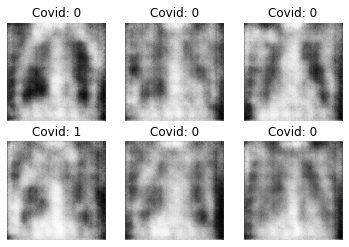

Epoch 62/200 Batch 6/6 [D loss: 0.65439, acc: 68.75%] [G loss: 0.69990]
Epoch 63/200 Batch 6/6 [D loss: 0.65118, acc: 53.12%] [G loss: 0.64343]
Epoch 64/200 Batch 6/6 [D loss: 0.67841, acc: 50.00%] [G loss: 0.69759]
Epoch 65/200 Batch 6/6 [D loss: 0.66490, acc: 50.00%] [G loss: 0.68801]
Epoch 66/200 Batch 6/6 [D loss: 0.63799, acc: 75.00%] [G loss: 0.74883]
Epoch 67/200 Batch 6/6 [D loss: 0.65138, acc: 56.25%] [G loss: 0.67265]
Epoch 68/200 Batch 6/6 [D loss: 0.71079, acc: 50.00%] [G loss: 0.64367]
Epoch 69/200 Batch 6/6 [D loss: 0.71644, acc: 50.00%] [G loss: 0.66939]
Epoch 70/200 Batch 6/6 [D loss: 0.67635, acc: 59.38%] [G loss: 0.73304]
Epoch 71/200 Batch 6/6 [D loss: 0.71364, acc: 50.00%] [G loss: 0.68716]
Epoch 72/200 Batch 6/6 [D loss: 0.66427, acc: 62.50%] [G loss: 0.70708]
Epoch 73/200 Batch 6/6 [D loss: 0.61789, acc: 62.50%] [G loss: 0.72495]
Epoch 74/200 Batch 6/6 [D loss: 0.69360, acc: 40.62%] [G loss: 0.63799]
Epoch 75/200 Batch 6/6 [D loss: 0.69645, acc: 56.25%] [G loss: 0

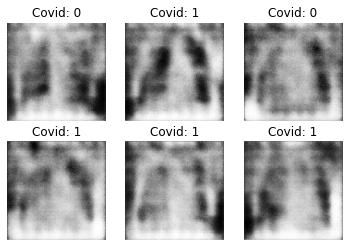

Epoch 82/200 Batch 6/6 [D loss: 0.64905, acc: 68.75%] [G loss: 0.75906]
Epoch 83/200 Batch 6/6 [D loss: 0.65645, acc: 56.25%] [G loss: 0.77021]
Epoch 84/200 Batch 6/6 [D loss: 0.64279, acc: 71.88%] [G loss: 0.72568]
Epoch 85/200 Batch 6/6 [D loss: 0.63685, acc: 81.25%] [G loss: 0.68080]
Epoch 86/200 Batch 6/6 [D loss: 0.68502, acc: 50.00%] [G loss: 0.71057]
Epoch 87/200 Batch 6/6 [D loss: 0.63317, acc: 84.38%] [G loss: 0.79027]
Epoch 88/200 Batch 6/6 [D loss: 0.64185, acc: 75.00%] [G loss: 0.75867]
Epoch 89/200 Batch 6/6 [D loss: 0.69198, acc: 68.75%] [G loss: 0.69651]
Epoch 90/200 Batch 6/6 [D loss: 0.71420, acc: 37.50%] [G loss: 0.62961]
Epoch 91/200 Batch 6/6 [D loss: 0.65973, acc: 62.50%] [G loss: 0.75329]
Epoch 92/200 Batch 6/6 [D loss: 0.65887, acc: 65.62%] [G loss: 0.79189]
Epoch 93/200 Batch 6/6 [D loss: 0.62853, acc: 68.75%] [G loss: 0.70940]
Epoch 94/200 Batch 6/6 [D loss: 0.69996, acc: 40.62%] [G loss: 0.64656]
Epoch 95/200 Batch 6/6 [D loss: 0.67022, acc: 59.38%] [G loss: 0

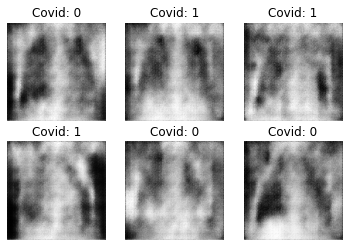

Epoch 102/200 Batch 6/6 [D loss: 0.62311, acc: 62.50%] [G loss: 0.67205]
Epoch 103/200 Batch 6/6 [D loss: 0.66742, acc: 56.25%] [G loss: 0.70023]
Epoch 104/200 Batch 6/6 [D loss: 0.64143, acc: 68.75%] [G loss: 0.71025]
Epoch 105/200 Batch 6/6 [D loss: 0.62910, acc: 78.12%] [G loss: 0.75492]
Epoch 106/200 Batch 6/6 [D loss: 0.62581, acc: 81.25%] [G loss: 0.75288]
Epoch 107/200 Batch 6/6 [D loss: 0.69990, acc: 46.88%] [G loss: 0.65892]
Epoch 108/200 Batch 6/6 [D loss: 0.65365, acc: 65.62%] [G loss: 0.82667]
Epoch 109/200 Batch 6/6 [D loss: 0.60290, acc: 81.25%] [G loss: 0.84153]
Epoch 110/200 Batch 6/6 [D loss: 0.61727, acc: 65.62%] [G loss: 0.70091]
Epoch 111/200 Batch 6/6 [D loss: 0.63285, acc: 65.62%] [G loss: 0.80219]
Epoch 112/200 Batch 6/6 [D loss: 0.63961, acc: 65.62%] [G loss: 0.82607]
Epoch 113/200 Batch 6/6 [D loss: 0.58454, acc: 84.38%] [G loss: 0.86716]
Epoch 114/200 Batch 6/6 [D loss: 0.59847, acc: 71.88%] [G loss: 0.80497]
Epoch 115/200 Batch 6/6 [D loss: 0.62985, acc: 65.6

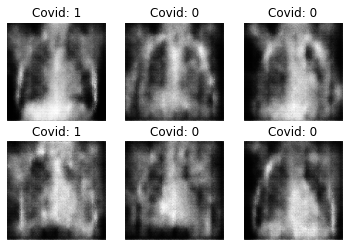

Epoch 122/200 Batch 6/6 [D loss: 0.59086, acc: 75.00%] [G loss: 1.16463]
Epoch 123/200 Batch 6/6 [D loss: 0.63350, acc: 68.75%] [G loss: 1.04396]
Epoch 124/200 Batch 6/6 [D loss: 0.54604, acc: 81.25%] [G loss: 0.92294]
Epoch 125/200 Batch 6/6 [D loss: 0.41603, acc: 90.62%] [G loss: 1.00132]
Epoch 126/200 Batch 6/6 [D loss: 0.38675, acc: 96.88%] [G loss: 1.47430]
Epoch 127/200 Batch 6/6 [D loss: 0.69478, acc: 56.25%] [G loss: 1.07688]
Epoch 128/200 Batch 6/6 [D loss: 0.59300, acc: 71.88%] [G loss: 1.35025]
Epoch 129/200 Batch 6/6 [D loss: 0.59981, acc: 78.12%] [G loss: 1.15083]
Epoch 130/200 Batch 6/6 [D loss: 0.42124, acc: 87.50%] [G loss: 1.44308]
Epoch 131/200 Batch 6/6 [D loss: 0.47876, acc: 84.38%] [G loss: 1.49775]
Epoch 132/200 Batch 6/6 [D loss: 0.40906, acc: 84.38%] [G loss: 1.26664]
Epoch 133/200 Batch 6/6 [D loss: 0.37517, acc: 87.50%] [G loss: 1.40815]
Epoch 134/200 Batch 6/6 [D loss: 0.40943, acc: 90.62%] [G loss: 1.53116]
Epoch 135/200 Batch 6/6 [D loss: 0.37570, acc: 87.5

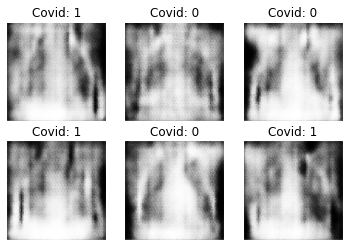

Epoch 142/200 Batch 6/6 [D loss: 0.58252, acc: 68.75%] [G loss: 1.31630]
Epoch 143/200 Batch 6/6 [D loss: 0.40866, acc: 87.50%] [G loss: 1.64054]
Epoch 144/200 Batch 6/6 [D loss: 0.48623, acc: 71.88%] [G loss: 1.22868]
Epoch 145/200 Batch 6/6 [D loss: 0.38378, acc: 87.50%] [G loss: 2.04481]
Epoch 146/200 Batch 6/6 [D loss: 0.71866, acc: 56.25%] [G loss: 1.44308]
Epoch 147/200 Batch 6/6 [D loss: 0.48341, acc: 90.62%] [G loss: 1.51175]
Epoch 148/200 Batch 6/6 [D loss: 0.65814, acc: 56.25%] [G loss: 0.78479]
Epoch 149/200 Batch 6/6 [D loss: 0.57642, acc: 75.00%] [G loss: 0.68458]
Epoch 150/200 Batch 6/6 [D loss: 0.48446, acc: 90.62%] [G loss: 1.17865]
Epoch 151/200 Batch 6/6 [D loss: 0.98932, acc: 31.25%] [G loss: 1.08341]
Epoch 152/200 Batch 6/6 [D loss: 0.56041, acc: 81.25%] [G loss: 1.03498]
Epoch 153/200 Batch 6/6 [D loss: 0.88449, acc: 28.12%] [G loss: 0.65940]
Epoch 154/200 Batch 6/6 [D loss: 0.68076, acc: 56.25%] [G loss: 0.73958]
Epoch 155/200 Batch 6/6 [D loss: 0.70329, acc: 53.1

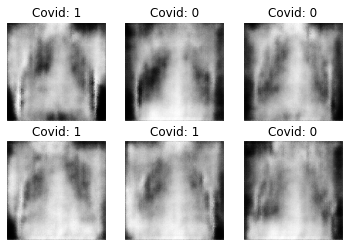

Epoch 162/200 Batch 6/6 [D loss: 0.51541, acc: 78.12%] [G loss: 1.02548]
Epoch 163/200 Batch 6/6 [D loss: 0.64097, acc: 53.12%] [G loss: 0.90422]
Epoch 164/200 Batch 6/6 [D loss: 0.52924, acc: 87.50%] [G loss: 0.87721]
Epoch 165/200 Batch 6/6 [D loss: 0.60111, acc: 65.62%] [G loss: 0.93127]
Epoch 166/200 Batch 6/6 [D loss: 0.60777, acc: 62.50%] [G loss: 0.78621]
Epoch 167/200 Batch 6/6 [D loss: 0.58165, acc: 56.25%] [G loss: 0.79957]
Epoch 168/200 Batch 6/6 [D loss: 0.49466, acc: 84.38%] [G loss: 0.98058]
Epoch 169/200 Batch 6/6 [D loss: 0.54483, acc: 78.12%] [G loss: 0.88200]
Epoch 170/200 Batch 6/6 [D loss: 0.60802, acc: 65.62%] [G loss: 0.95939]
Epoch 171/200 Batch 6/6 [D loss: 0.65107, acc: 53.12%] [G loss: 0.89326]
Epoch 172/200 Batch 6/6 [D loss: 0.54989, acc: 84.38%] [G loss: 0.93356]
Epoch 173/200 Batch 6/6 [D loss: 0.61408, acc: 68.75%] [G loss: 0.96931]
Epoch 174/200 Batch 6/6 [D loss: 0.57270, acc: 71.88%] [G loss: 1.01719]
Epoch 175/200 Batch 6/6 [D loss: 0.55071, acc: 81.2

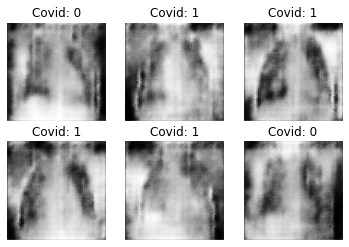

Epoch 182/200 Batch 6/6 [D loss: 0.56537, acc: 71.88%] [G loss: 1.02935]
Epoch 183/200 Batch 6/6 [D loss: 0.56811, acc: 68.75%] [G loss: 1.07084]
Epoch 184/200 Batch 6/6 [D loss: 0.53592, acc: 78.12%] [G loss: 1.04429]
Epoch 185/200 Batch 6/6 [D loss: 0.60045, acc: 62.50%] [G loss: 1.05527]
Epoch 186/200 Batch 6/6 [D loss: 0.57835, acc: 78.12%] [G loss: 1.00627]
Epoch 187/200 Batch 6/6 [D loss: 0.50224, acc: 78.12%] [G loss: 0.98542]
Epoch 188/200 Batch 6/6 [D loss: 0.55045, acc: 75.00%] [G loss: 1.08005]
Epoch 189/200 Batch 6/6 [D loss: 0.49123, acc: 81.25%] [G loss: 0.93474]
Epoch 190/200 Batch 6/6 [D loss: 0.55492, acc: 71.88%] [G loss: 1.05081]
Epoch 191/200 Batch 6/6 [D loss: 0.41228, acc: 90.62%] [G loss: 1.09493]
Epoch 192/200 Batch 6/6 [D loss: 0.58817, acc: 65.62%] [G loss: 0.95905]
Epoch 193/200 Batch 6/6 [D loss: 0.44209, acc: 87.50%] [G loss: 0.98749]
Epoch 194/200 Batch 6/6 [D loss: 0.57426, acc: 71.88%] [G loss: 0.98295]
Epoch 195/200 Batch 6/6 [D loss: 0.54132, acc: 71.8

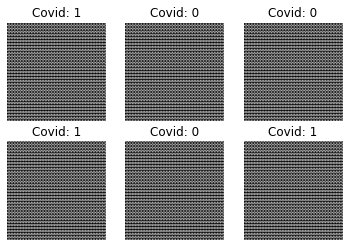

Epoch 2/200 Batch 3/3 [D loss: 2597.77692, acc: 3.12%] [G loss: 2018.47668]
Epoch 3/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 812.22131]
Epoch 4/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 368.33859]
Epoch 5/200 Batch 3/3 [D loss: 17.81683, acc: 51.56%] [G loss: 3265.95117]
Epoch 6/200 Batch 3/3 [D loss: 2.35222, acc: 98.44%] [G loss: 6498.30078]
Epoch 7/200 Batch 3/3 [D loss: 0.59197, acc: 98.44%] [G loss: 304.48157]
Epoch 8/200 Batch 3/3 [D loss: 1069.45996, acc: 50.00%] [G loss: 735.05640]
Epoch 9/200 Batch 3/3 [D loss: 0.42703, acc: 98.44%] [G loss: 465.59534]
Epoch 10/200 Batch 3/3 [D loss: 4.30969, acc: 96.88%] [G loss: 248.69417]
Epoch 11/200 Batch 3/3 [D loss: 5.24683, acc: 93.75%] [G loss: 452.56885]
Epoch 12/200 Batch 3/3 [D loss: 0.42377, acc: 98.44%] [G loss: 114.55447]
Epoch 13/200 Batch 3/3 [D loss: 0.71538, acc: 96.88%] [G loss: 222.95831]
Epoch 14/200 Batch 3/3 [D loss: 0.01319, acc: 98.44%] [G loss: 199.98053]
Epoch 15/200 Batch 3/3 [D loss: 0.0

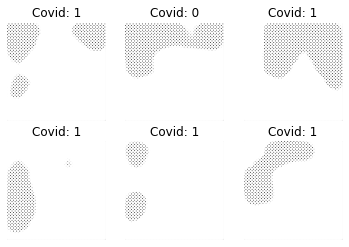

Epoch 22/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 396.84665]
Epoch 23/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 393.93643]
Epoch 24/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 401.68817]
Epoch 25/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 396.32910]
Epoch 26/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 394.12177]
Epoch 27/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 390.57599]
Epoch 28/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 388.43530]
Epoch 29/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 391.32227]
Epoch 30/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 384.58234]
Epoch 31/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 387.63516]
Epoch 32/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 384.41296]
Epoch 33/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 379.60892]
Epoch 34/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 379.43481]
Epoch 35/200 Batch 3/3 [D

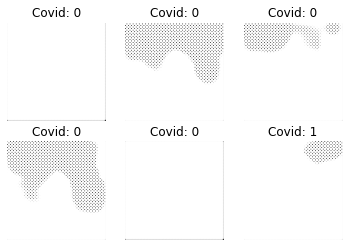

Epoch 42/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 362.21191]
Epoch 43/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 355.77277]
Epoch 44/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 355.27454]
Epoch 45/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 344.39832]
Epoch 46/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 339.89340]
Epoch 47/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 335.21655]
Epoch 48/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 334.83008]
Epoch 49/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 334.01428]
Epoch 50/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 328.25482]
Epoch 51/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 332.26465]
Epoch 52/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 328.44714]
Epoch 53/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 327.75446]
Epoch 54/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 327.73056]
Epoch 55/200 Batch 3/3 [D

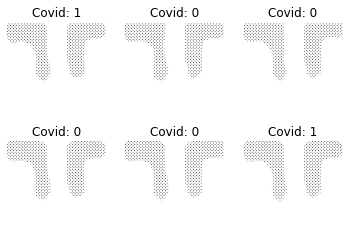

Epoch 62/200 Batch 3/3 [D loss: 0.00001, acc: 100.00%] [G loss: 321.32947]
Epoch 63/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 320.84186]
Epoch 64/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 322.63528]
Epoch 65/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 320.73749]
Epoch 66/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 321.79669]
Epoch 67/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 321.15292]
Epoch 68/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 318.44089]
Epoch 69/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 319.67273]
Epoch 70/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 321.75882]
Epoch 71/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 317.56021]
Epoch 72/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 325.28793]
Epoch 73/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 319.36774]
Epoch 74/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 315.09619]
Epoch 75/200 Batch 3/3 [D

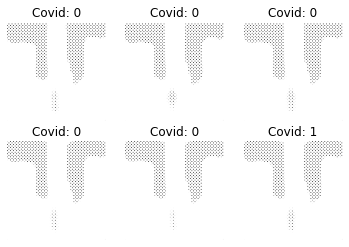

Epoch 82/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 321.54755]
Epoch 83/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 312.87753]
Epoch 84/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 314.95871]
Epoch 85/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 310.84344]
Epoch 86/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 312.54181]
Epoch 87/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 309.95941]
Epoch 88/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 311.05432]
Epoch 89/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 310.30838]
Epoch 90/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 310.21503]
Epoch 91/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 312.05276]
Epoch 92/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 309.30237]
Epoch 93/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 311.53247]
Epoch 94/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 313.19104]
Epoch 95/200 Batch 3/3 [D

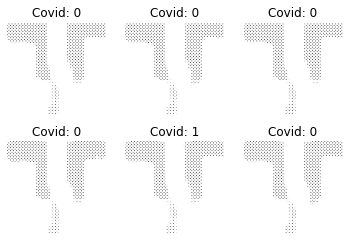

Epoch 102/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 311.53754]
Epoch 103/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 308.19727]
Epoch 104/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 309.08600]
Epoch 105/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 312.58209]
Epoch 106/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 309.41956]
Epoch 107/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 307.62912]
Epoch 108/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 310.98633]
Epoch 109/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 307.94513]
Epoch 110/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 309.69614]
Epoch 111/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 308.64771]
Epoch 112/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 308.12088]
Epoch 113/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 308.56427]
Epoch 114/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 307.84665]
Epoch 115/20

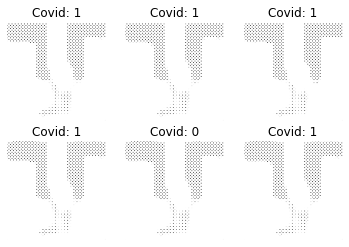

Epoch 122/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 305.78238]
Epoch 123/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 302.27585]
Epoch 124/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 307.51907]
Epoch 125/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 303.68704]
Epoch 126/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 305.59485]
Epoch 127/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 303.37225]
Epoch 128/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 307.58990]
Epoch 129/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 304.36032]
Epoch 130/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 303.55914]
Epoch 131/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 306.80673]
Epoch 132/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 300.96011]
Epoch 133/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 305.21011]
Epoch 134/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 303.80371]
Epoch 135/20

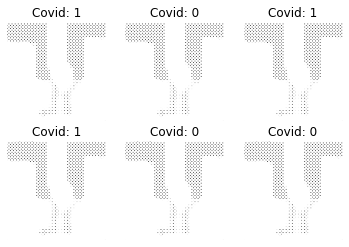

Epoch 142/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 255.37706]
Epoch 143/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 254.92053]
Epoch 144/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 252.25642]
Epoch 145/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 253.94106]
Epoch 146/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 259.01056]
Epoch 147/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 250.86711]
Epoch 148/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 254.86711]
Epoch 149/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 252.75281]
Epoch 150/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 254.28201]
Epoch 151/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 252.83615]
Epoch 152/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 253.15424]
Epoch 153/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 252.77792]
Epoch 154/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 252.33820]
Epoch 155/20

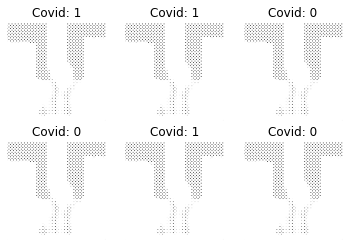

Epoch 162/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 253.55836]
Epoch 163/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 253.47192]
Epoch 164/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 254.45177]
Epoch 165/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 251.37082]
Epoch 166/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 254.10489]
Epoch 167/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 252.30237]
Epoch 168/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 252.12238]
Epoch 169/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 255.34328]
Epoch 170/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 254.54741]
Epoch 171/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 252.92456]
Epoch 172/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 252.42117]
Epoch 173/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 256.30569]
Epoch 174/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 252.66132]
Epoch 175/20

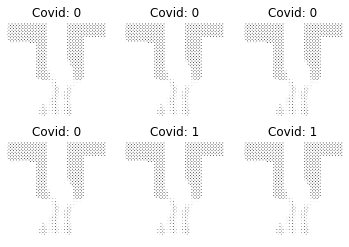

Epoch 182/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 252.41676]
Epoch 183/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 253.20033]
Epoch 184/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 251.83226]
Epoch 185/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 249.24231]
Epoch 186/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 251.75098]
Epoch 187/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 253.42409]
Epoch 188/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 252.77534]
Epoch 189/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 254.18045]
Epoch 190/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 253.60345]
Epoch 191/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 249.68979]
Epoch 192/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 253.00749]
Epoch 193/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 251.61049]
Epoch 194/200 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 251.67027]
Epoch 195/20

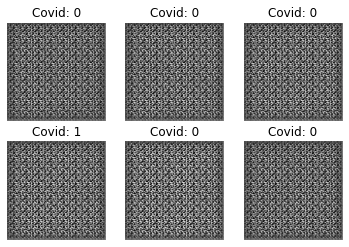

Epoch 2/200 Batch 3/3 [D loss: 0.04629, acc: 100.00%] [G loss: 17.74046]
Epoch 3/200 Batch 3/3 [D loss: 4.06390, acc: 50.00%] [G loss: 11.75568]
Epoch 4/200 Batch 3/3 [D loss: 0.00481, acc: 100.00%] [G loss: 6.48520]
Epoch 5/200 Batch 3/3 [D loss: 0.00113, acc: 100.00%] [G loss: 8.14527]
Epoch 6/200 Batch 3/3 [D loss: 0.72026, acc: 90.62%] [G loss: 6.47566]
Epoch 7/200 Batch 3/3 [D loss: 0.01445, acc: 98.44%] [G loss: 7.20459]
Epoch 8/200 Batch 3/3 [D loss: 0.08218, acc: 100.00%] [G loss: 7.10849]
Epoch 9/200 Batch 3/3 [D loss: 0.01060, acc: 100.00%] [G loss: 5.10238]
Epoch 10/200 Batch 3/3 [D loss: 0.02015, acc: 100.00%] [G loss: 5.23430]
Epoch 11/200 Batch 3/3 [D loss: 0.02923, acc: 100.00%] [G loss: 3.71449]
Epoch 12/200 Batch 3/3 [D loss: 0.03469, acc: 98.44%] [G loss: 8.14420]
Epoch 13/200 Batch 3/3 [D loss: 0.26587, acc: 84.38%] [G loss: 2.94100]
Epoch 14/200 Batch 3/3 [D loss: 0.02772, acc: 98.44%] [G loss: 5.53164]
Epoch 15/200 Batch 3/3 [D loss: 0.03834, acc: 100.00%] [G loss:

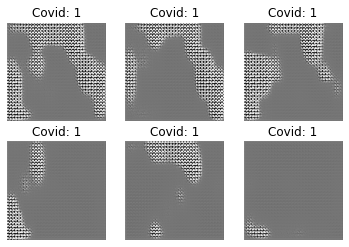

Epoch 22/200 Batch 3/3 [D loss: 0.01980, acc: 98.44%] [G loss: 7.50849]
Epoch 23/200 Batch 3/3 [D loss: 0.00661, acc: 100.00%] [G loss: 7.59397]
Epoch 24/200 Batch 3/3 [D loss: 0.00303, acc: 100.00%] [G loss: 7.53942]
Epoch 25/200 Batch 3/3 [D loss: 0.65390, acc: 81.25%] [G loss: 20.12558]
Epoch 26/200 Batch 3/3 [D loss: 0.00026, acc: 100.00%] [G loss: 9.38657]
Epoch 27/200 Batch 3/3 [D loss: 0.21586, acc: 95.31%] [G loss: 4.30865]
Epoch 28/200 Batch 3/3 [D loss: 0.16076, acc: 96.88%] [G loss: 2.45781]
Epoch 29/200 Batch 3/3 [D loss: 0.05565, acc: 100.00%] [G loss: 3.85436]
Epoch 30/200 Batch 3/3 [D loss: 0.38663, acc: 82.81%] [G loss: 5.61409]
Epoch 31/200 Batch 3/3 [D loss: 0.97273, acc: 45.31%] [G loss: 1.61838]
Epoch 32/200 Batch 3/3 [D loss: 0.48131, acc: 81.25%] [G loss: 2.07699]
Epoch 33/200 Batch 3/3 [D loss: 0.43425, acc: 81.25%] [G loss: 0.66667]
Epoch 34/200 Batch 3/3 [D loss: 0.41956, acc: 87.50%] [G loss: 1.12976]
Epoch 35/200 Batch 3/3 [D loss: 0.52105, acc: 81.25%] [G lo

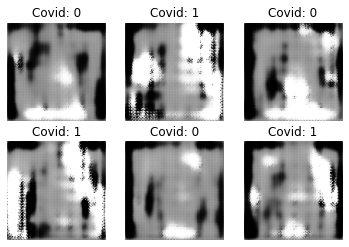

Epoch 42/200 Batch 3/3 [D loss: 0.57924, acc: 76.56%] [G loss: 1.36035]
Epoch 43/200 Batch 3/3 [D loss: 0.58048, acc: 76.56%] [G loss: 1.17917]
Epoch 44/200 Batch 3/3 [D loss: 0.53151, acc: 71.88%] [G loss: 1.44971]
Epoch 45/200 Batch 3/3 [D loss: 0.60791, acc: 67.19%] [G loss: 1.16322]
Epoch 46/200 Batch 3/3 [D loss: 0.60897, acc: 68.75%] [G loss: 1.10337]
Epoch 47/200 Batch 3/3 [D loss: 0.63856, acc: 60.94%] [G loss: 1.43855]
Epoch 48/200 Batch 3/3 [D loss: 0.49536, acc: 73.44%] [G loss: 1.36263]
Epoch 49/200 Batch 3/3 [D loss: 0.54921, acc: 76.56%] [G loss: 1.51788]
Epoch 50/200 Batch 3/3 [D loss: 0.56522, acc: 68.75%] [G loss: 1.44900]
Epoch 51/200 Batch 3/3 [D loss: 0.62531, acc: 60.94%] [G loss: 1.32901]
Epoch 52/200 Batch 3/3 [D loss: 0.53121, acc: 76.56%] [G loss: 1.80443]
Epoch 53/200 Batch 3/3 [D loss: 0.50608, acc: 76.56%] [G loss: 2.13874]
Epoch 54/200 Batch 3/3 [D loss: 0.58024, acc: 71.88%] [G loss: 1.38059]
Epoch 55/200 Batch 3/3 [D loss: 0.56337, acc: 73.44%] [G loss: 1

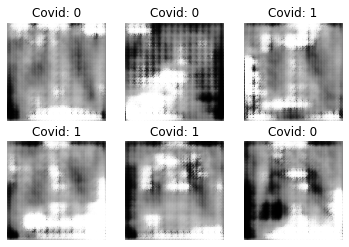

Epoch 62/200 Batch 3/3 [D loss: 0.55857, acc: 71.88%] [G loss: 1.50353]
Epoch 63/200 Batch 3/3 [D loss: 0.54914, acc: 73.44%] [G loss: 2.51455]
Epoch 64/200 Batch 3/3 [D loss: 0.56211, acc: 59.38%] [G loss: 2.35650]
Epoch 65/200 Batch 3/3 [D loss: 0.37501, acc: 82.81%] [G loss: 2.74538]
Epoch 66/200 Batch 3/3 [D loss: 0.42602, acc: 81.25%] [G loss: 1.65441]
Epoch 67/200 Batch 3/3 [D loss: 0.45578, acc: 84.38%] [G loss: 2.07199]
Epoch 68/200 Batch 3/3 [D loss: 0.48260, acc: 75.00%] [G loss: 1.58005]
Epoch 69/200 Batch 3/3 [D loss: 0.39945, acc: 89.06%] [G loss: 1.83291]
Epoch 70/200 Batch 3/3 [D loss: 0.39982, acc: 81.25%] [G loss: 2.23933]
Epoch 71/200 Batch 3/3 [D loss: 0.54024, acc: 75.00%] [G loss: 1.92049]
Epoch 72/200 Batch 3/3 [D loss: 0.33099, acc: 89.06%] [G loss: 2.10191]
Epoch 73/200 Batch 3/3 [D loss: 0.64815, acc: 67.19%] [G loss: 1.54325]
Epoch 74/200 Batch 3/3 [D loss: 0.75960, acc: 62.50%] [G loss: 1.97357]
Epoch 75/200 Batch 3/3 [D loss: 0.44305, acc: 78.12%] [G loss: 1

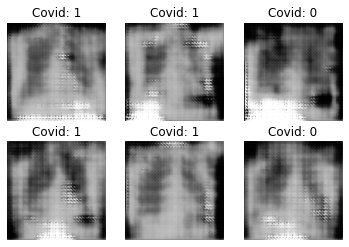

Epoch 82/200 Batch 3/3 [D loss: 0.66075, acc: 60.94%] [G loss: 1.96421]
Epoch 83/200 Batch 3/3 [D loss: 0.47476, acc: 75.00%] [G loss: 2.09917]
Epoch 84/200 Batch 3/3 [D loss: 0.55190, acc: 71.88%] [G loss: 1.47373]
Epoch 85/200 Batch 3/3 [D loss: 0.52838, acc: 70.31%] [G loss: 1.45158]
Epoch 86/200 Batch 3/3 [D loss: 0.59688, acc: 68.75%] [G loss: 2.03714]
Epoch 87/200 Batch 3/3 [D loss: 0.45892, acc: 87.50%] [G loss: 1.95831]
Epoch 88/200 Batch 3/3 [D loss: 0.46064, acc: 76.56%] [G loss: 2.10786]
Epoch 89/200 Batch 3/3 [D loss: 0.40489, acc: 78.12%] [G loss: 1.73840]
Epoch 90/200 Batch 3/3 [D loss: 0.47708, acc: 78.12%] [G loss: 1.77895]
Epoch 91/200 Batch 3/3 [D loss: 0.49853, acc: 75.00%] [G loss: 1.95363]
Epoch 92/200 Batch 3/3 [D loss: 0.34236, acc: 87.50%] [G loss: 2.43836]
Epoch 93/200 Batch 3/3 [D loss: 0.67351, acc: 64.06%] [G loss: 1.20207]
Epoch 94/200 Batch 3/3 [D loss: 0.52882, acc: 73.44%] [G loss: 1.76640]
Epoch 95/200 Batch 3/3 [D loss: 0.53758, acc: 70.31%] [G loss: 1

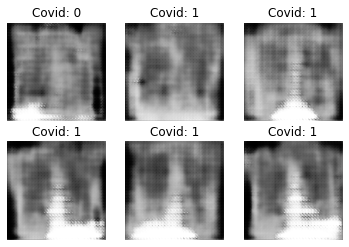

Epoch 102/200 Batch 3/3 [D loss: 0.42536, acc: 81.25%] [G loss: 2.12284]
Epoch 103/200 Batch 3/3 [D loss: 0.37848, acc: 81.25%] [G loss: 2.16851]
Epoch 104/200 Batch 3/3 [D loss: 0.26471, acc: 90.62%] [G loss: 1.88011]
Epoch 105/200 Batch 3/3 [D loss: 0.44099, acc: 75.00%] [G loss: 2.06021]
Epoch 106/200 Batch 3/3 [D loss: 0.42417, acc: 82.81%] [G loss: 2.23380]
Epoch 107/200 Batch 3/3 [D loss: 0.46911, acc: 82.81%] [G loss: 2.08569]
Epoch 108/200 Batch 3/3 [D loss: 0.56102, acc: 68.75%] [G loss: 1.58673]
Epoch 109/200 Batch 3/3 [D loss: 0.44750, acc: 79.69%] [G loss: 1.79561]
Epoch 110/200 Batch 3/3 [D loss: 0.51744, acc: 68.75%] [G loss: 1.91023]
Epoch 111/200 Batch 3/3 [D loss: 0.44237, acc: 79.69%] [G loss: 2.10222]
Epoch 112/200 Batch 3/3 [D loss: 0.41529, acc: 89.06%] [G loss: 1.94228]
Epoch 113/200 Batch 3/3 [D loss: 0.43801, acc: 76.56%] [G loss: 1.67710]
Epoch 114/200 Batch 3/3 [D loss: 0.47082, acc: 81.25%] [G loss: 2.02175]
Epoch 115/200 Batch 3/3 [D loss: 0.50201, acc: 70.3

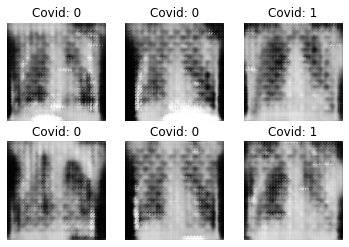

Epoch 122/200 Batch 3/3 [D loss: 0.45470, acc: 82.81%] [G loss: 2.09451]
Epoch 123/200 Batch 3/3 [D loss: 0.32473, acc: 95.31%] [G loss: 2.01917]
Epoch 124/200 Batch 3/3 [D loss: 0.45465, acc: 78.12%] [G loss: 2.61813]
Epoch 125/200 Batch 3/3 [D loss: 0.42427, acc: 81.25%] [G loss: 2.02860]
Epoch 126/200 Batch 3/3 [D loss: 0.46868, acc: 79.69%] [G loss: 2.10972]
Epoch 127/200 Batch 3/3 [D loss: 0.38418, acc: 85.94%] [G loss: 1.92528]
Epoch 128/200 Batch 3/3 [D loss: 0.43952, acc: 75.00%] [G loss: 2.44745]
Epoch 129/200 Batch 3/3 [D loss: 0.52247, acc: 73.44%] [G loss: 1.94762]
Epoch 130/200 Batch 3/3 [D loss: 0.43001, acc: 84.38%] [G loss: 2.40241]
Epoch 131/200 Batch 3/3 [D loss: 0.39224, acc: 82.81%] [G loss: 2.30691]
Epoch 132/200 Batch 3/3 [D loss: 0.66092, acc: 62.50%] [G loss: 1.85626]
Epoch 133/200 Batch 3/3 [D loss: 0.66764, acc: 57.81%] [G loss: 1.86607]
Epoch 134/200 Batch 3/3 [D loss: 0.59501, acc: 64.06%] [G loss: 1.50908]
Epoch 135/200 Batch 3/3 [D loss: 0.57939, acc: 67.1

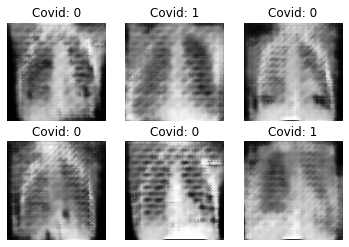

Epoch 142/200 Batch 3/3 [D loss: 0.47051, acc: 81.25%] [G loss: 1.83245]
Epoch 143/200 Batch 3/3 [D loss: 0.45252, acc: 84.38%] [G loss: 1.48276]
Epoch 144/200 Batch 3/3 [D loss: 0.52286, acc: 71.88%] [G loss: 1.77124]
Epoch 145/200 Batch 3/3 [D loss: 0.47414, acc: 73.44%] [G loss: 1.94350]
Epoch 146/200 Batch 3/3 [D loss: 0.38053, acc: 87.50%] [G loss: 2.16743]
Epoch 147/200 Batch 3/3 [D loss: 0.52740, acc: 71.88%] [G loss: 1.97417]
Epoch 148/200 Batch 3/3 [D loss: 0.41308, acc: 92.19%] [G loss: 1.70777]
Epoch 149/200 Batch 3/3 [D loss: 0.51943, acc: 70.31%] [G loss: 1.78766]
Epoch 150/200 Batch 3/3 [D loss: 0.51796, acc: 71.88%] [G loss: 1.65381]
Epoch 151/200 Batch 3/3 [D loss: 0.52175, acc: 73.44%] [G loss: 1.72244]
Epoch 152/200 Batch 3/3 [D loss: 0.51042, acc: 71.88%] [G loss: 1.47916]
Epoch 153/200 Batch 3/3 [D loss: 0.53382, acc: 71.88%] [G loss: 1.52408]
Epoch 154/200 Batch 3/3 [D loss: 0.48547, acc: 75.00%] [G loss: 1.91206]
Epoch 155/200 Batch 3/3 [D loss: 0.59919, acc: 62.5

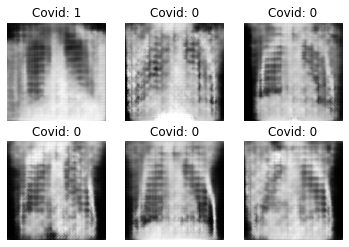

Epoch 162/200 Batch 3/3 [D loss: 0.49087, acc: 73.44%] [G loss: 1.90346]
Epoch 163/200 Batch 3/3 [D loss: 0.54080, acc: 70.31%] [G loss: 1.78324]
Epoch 164/200 Batch 3/3 [D loss: 0.40657, acc: 89.06%] [G loss: 2.14787]
Epoch 165/200 Batch 3/3 [D loss: 0.40251, acc: 82.81%] [G loss: 2.13536]
Epoch 166/200 Batch 3/3 [D loss: 0.35950, acc: 89.06%] [G loss: 2.42544]
Epoch 167/200 Batch 3/3 [D loss: 0.39136, acc: 82.81%] [G loss: 2.03763]
Epoch 168/200 Batch 3/3 [D loss: 0.59973, acc: 64.06%] [G loss: 2.41143]
Epoch 169/200 Batch 3/3 [D loss: 0.51921, acc: 70.31%] [G loss: 2.00840]
Epoch 170/200 Batch 3/3 [D loss: 0.40999, acc: 84.38%] [G loss: 2.42823]
Epoch 171/200 Batch 3/3 [D loss: 0.34362, acc: 89.06%] [G loss: 2.19271]
Epoch 172/200 Batch 3/3 [D loss: 0.44063, acc: 84.38%] [G loss: 2.48034]
Epoch 173/200 Batch 3/3 [D loss: 0.53554, acc: 71.88%] [G loss: 2.10146]
Epoch 174/200 Batch 3/3 [D loss: 0.40960, acc: 85.94%] [G loss: 1.68466]
Epoch 175/200 Batch 3/3 [D loss: 0.33809, acc: 87.5

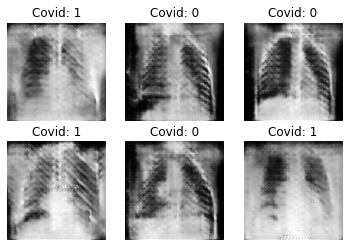

Epoch 182/200 Batch 3/3 [D loss: 0.48830, acc: 75.00%] [G loss: 5.23639]
Epoch 183/200 Batch 3/3 [D loss: 0.31163, acc: 87.50%] [G loss: 2.29261]
Epoch 184/200 Batch 3/3 [D loss: 0.34255, acc: 90.62%] [G loss: 2.21465]
Epoch 185/200 Batch 3/3 [D loss: 0.39540, acc: 84.38%] [G loss: 2.23491]
Epoch 186/200 Batch 3/3 [D loss: 0.35624, acc: 82.81%] [G loss: 2.14897]
Epoch 187/200 Batch 3/3 [D loss: 0.39433, acc: 79.69%] [G loss: 2.64574]
Epoch 188/200 Batch 3/3 [D loss: 0.48919, acc: 76.56%] [G loss: 3.16721]
Epoch 189/200 Batch 3/3 [D loss: 0.36107, acc: 82.81%] [G loss: 2.60910]
Epoch 190/200 Batch 3/3 [D loss: 0.30914, acc: 90.62%] [G loss: 2.88554]
Epoch 191/200 Batch 3/3 [D loss: 0.54386, acc: 68.75%] [G loss: 2.98571]
Epoch 192/200 Batch 3/3 [D loss: 0.50680, acc: 73.44%] [G loss: 2.65507]
Epoch 193/200 Batch 3/3 [D loss: 0.32879, acc: 85.94%] [G loss: 2.93362]
Epoch 194/200 Batch 3/3 [D loss: 0.60594, acc: 76.56%] [G loss: 2.10712]
Epoch 195/200 Batch 3/3 [D loss: 0.34445, acc: 87.5

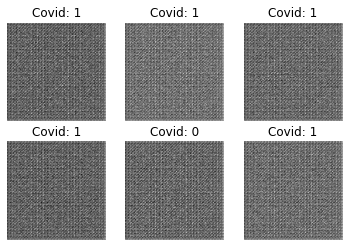

Epoch 2/200 Batch 3/3 [D loss: 0.64353, acc: 50.00%] [G loss: 0.68855]
Epoch 3/200 Batch 3/3 [D loss: 0.49697, acc: 100.00%] [G loss: 1.03288]
Epoch 4/200 Batch 3/3 [D loss: 0.33340, acc: 95.31%] [G loss: 1.62811]
Epoch 5/200 Batch 3/3 [D loss: 0.20270, acc: 98.44%] [G loss: 2.21024]
Epoch 6/200 Batch 3/3 [D loss: 0.11892, acc: 100.00%] [G loss: 2.69682]
Epoch 7/200 Batch 3/3 [D loss: 0.07100, acc: 100.00%] [G loss: 3.35007]
Epoch 8/200 Batch 3/3 [D loss: 0.07480, acc: 98.44%] [G loss: 3.61341]
Epoch 9/200 Batch 3/3 [D loss: 0.04229, acc: 100.00%] [G loss: 3.77027]
Epoch 10/200 Batch 3/3 [D loss: 0.08267, acc: 96.88%] [G loss: 4.61253]
Epoch 11/200 Batch 3/3 [D loss: 0.04141, acc: 98.44%] [G loss: 3.85782]
Epoch 12/200 Batch 3/3 [D loss: 0.07990, acc: 100.00%] [G loss: 5.22311]
Epoch 13/200 Batch 3/3 [D loss: 0.67853, acc: 56.25%] [G loss: 6.34058]
Epoch 14/200 Batch 3/3 [D loss: 0.75359, acc: 60.94%] [G loss: 2.92110]
Epoch 15/200 Batch 3/3 [D loss: 0.43506, acc: 90.62%] [G loss: 2.41

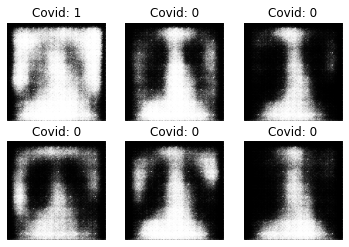

Epoch 22/200 Batch 3/3 [D loss: 0.61305, acc: 65.62%] [G loss: 1.77100]
Epoch 23/200 Batch 3/3 [D loss: 0.63862, acc: 65.62%] [G loss: 2.16419]
Epoch 24/200 Batch 3/3 [D loss: 0.78231, acc: 39.06%] [G loss: 0.99265]
Epoch 25/200 Batch 3/3 [D loss: 0.80807, acc: 50.00%] [G loss: 1.20179]
Epoch 26/200 Batch 3/3 [D loss: 0.75443, acc: 54.69%] [G loss: 1.25444]
Epoch 27/200 Batch 3/3 [D loss: 0.83188, acc: 40.62%] [G loss: 1.32689]
Epoch 28/200 Batch 3/3 [D loss: 0.65959, acc: 62.50%] [G loss: 1.42481]
Epoch 29/200 Batch 3/3 [D loss: 0.60288, acc: 78.12%] [G loss: 1.26183]
Epoch 30/200 Batch 3/3 [D loss: 0.55776, acc: 78.12%] [G loss: 1.35760]
Epoch 31/200 Batch 3/3 [D loss: 0.57708, acc: 68.75%] [G loss: 1.10016]
Epoch 32/200 Batch 3/3 [D loss: 0.59127, acc: 75.00%] [G loss: 1.11930]
Epoch 33/200 Batch 3/3 [D loss: 0.70280, acc: 60.94%] [G loss: 0.82264]
Epoch 34/200 Batch 3/3 [D loss: 0.70299, acc: 62.50%] [G loss: 1.02904]
Epoch 35/200 Batch 3/3 [D loss: 0.81075, acc: 37.50%] [G loss: 0

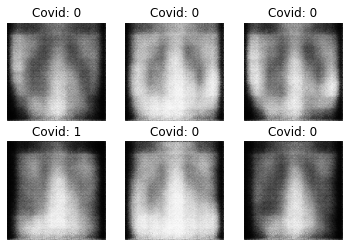

Epoch 42/200 Batch 3/3 [D loss: 0.68743, acc: 56.25%] [G loss: 0.88634]
Epoch 43/200 Batch 3/3 [D loss: 0.65557, acc: 65.62%] [G loss: 0.91159]
Epoch 44/200 Batch 3/3 [D loss: 0.63156, acc: 76.56%] [G loss: 0.86630]
Epoch 45/200 Batch 3/3 [D loss: 0.60353, acc: 84.38%] [G loss: 0.88478]
Epoch 46/200 Batch 3/3 [D loss: 0.59743, acc: 87.50%] [G loss: 0.94171]
Epoch 47/200 Batch 3/3 [D loss: 0.63695, acc: 65.62%] [G loss: 0.86557]
Epoch 48/200 Batch 3/3 [D loss: 0.60964, acc: 79.69%] [G loss: 0.93683]
Epoch 49/200 Batch 3/3 [D loss: 0.64098, acc: 79.69%] [G loss: 0.89340]
Epoch 50/200 Batch 3/3 [D loss: 0.59935, acc: 78.12%] [G loss: 0.87444]
Epoch 51/200 Batch 3/3 [D loss: 0.66207, acc: 51.56%] [G loss: 0.78262]
Epoch 52/200 Batch 3/3 [D loss: 0.63585, acc: 70.31%] [G loss: 0.76376]
Epoch 53/200 Batch 3/3 [D loss: 0.72269, acc: 48.44%] [G loss: 0.75296]
Epoch 54/200 Batch 3/3 [D loss: 0.67291, acc: 57.81%] [G loss: 0.74160]
Epoch 55/200 Batch 3/3 [D loss: 0.70755, acc: 54.69%] [G loss: 0

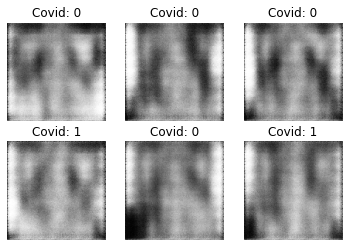

Epoch 62/200 Batch 3/3 [D loss: 0.72617, acc: 43.75%] [G loss: 0.65074]
Epoch 63/200 Batch 3/3 [D loss: 0.65873, acc: 54.69%] [G loss: 0.62387]
Epoch 64/200 Batch 3/3 [D loss: 0.68741, acc: 43.75%] [G loss: 0.64469]
Epoch 65/200 Batch 3/3 [D loss: 0.60636, acc: 57.81%] [G loss: 0.65795]
Epoch 66/200 Batch 3/3 [D loss: 0.59908, acc: 59.38%] [G loss: 0.71622]
Epoch 67/200 Batch 3/3 [D loss: 0.63470, acc: 56.25%] [G loss: 0.68498]
Epoch 68/200 Batch 3/3 [D loss: 0.66129, acc: 50.00%] [G loss: 0.64111]
Epoch 69/200 Batch 3/3 [D loss: 0.63937, acc: 59.38%] [G loss: 0.65653]
Epoch 70/200 Batch 3/3 [D loss: 0.63086, acc: 62.50%] [G loss: 0.71303]
Epoch 71/200 Batch 3/3 [D loss: 0.59554, acc: 68.75%] [G loss: 0.69950]
Epoch 72/200 Batch 3/3 [D loss: 0.58833, acc: 67.19%] [G loss: 0.70440]
Epoch 73/200 Batch 3/3 [D loss: 0.61298, acc: 67.19%] [G loss: 0.68767]
Epoch 74/200 Batch 3/3 [D loss: 0.63184, acc: 60.94%] [G loss: 0.60747]
Epoch 75/200 Batch 3/3 [D loss: 0.62117, acc: 60.94%] [G loss: 0

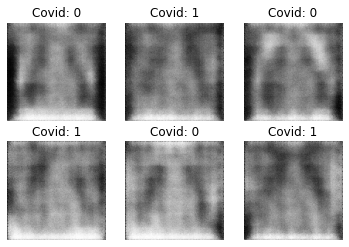

Epoch 82/200 Batch 3/3 [D loss: 0.74345, acc: 45.31%] [G loss: 0.51862]
Epoch 83/200 Batch 3/3 [D loss: 0.70675, acc: 46.88%] [G loss: 0.56259]
Epoch 84/200 Batch 3/3 [D loss: 0.70868, acc: 45.31%] [G loss: 0.57894]
Epoch 85/200 Batch 3/3 [D loss: 0.70110, acc: 48.44%] [G loss: 0.66130]
Epoch 86/200 Batch 3/3 [D loss: 0.70285, acc: 42.19%] [G loss: 0.66463]
Epoch 87/200 Batch 3/3 [D loss: 0.66669, acc: 62.50%] [G loss: 0.67034]
Epoch 88/200 Batch 3/3 [D loss: 0.66659, acc: 60.94%] [G loss: 0.66389]
Epoch 89/200 Batch 3/3 [D loss: 0.66305, acc: 60.94%] [G loss: 0.64830]
Epoch 90/200 Batch 3/3 [D loss: 0.69996, acc: 50.00%] [G loss: 0.60384]
Epoch 91/200 Batch 3/3 [D loss: 0.73934, acc: 45.31%] [G loss: 0.56594]
Epoch 92/200 Batch 3/3 [D loss: 0.73983, acc: 43.75%] [G loss: 0.59655]
Epoch 93/200 Batch 3/3 [D loss: 0.73662, acc: 40.62%] [G loss: 0.61304]
Epoch 94/200 Batch 3/3 [D loss: 0.70723, acc: 50.00%] [G loss: 0.63796]
Epoch 95/200 Batch 3/3 [D loss: 0.70156, acc: 46.88%] [G loss: 0

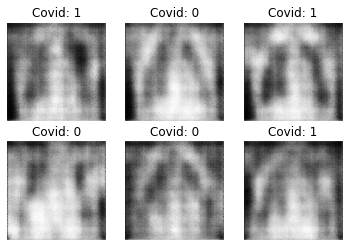

Epoch 102/200 Batch 3/3 [D loss: 0.69691, acc: 42.19%] [G loss: 0.69753]
Epoch 103/200 Batch 3/3 [D loss: 0.68803, acc: 54.69%] [G loss: 0.68964]
Epoch 104/200 Batch 3/3 [D loss: 0.68424, acc: 54.69%] [G loss: 0.66559]
Epoch 105/200 Batch 3/3 [D loss: 0.66836, acc: 57.81%] [G loss: 0.67922]
Epoch 106/200 Batch 3/3 [D loss: 0.69821, acc: 42.19%] [G loss: 0.67670]
Epoch 107/200 Batch 3/3 [D loss: 0.65228, acc: 54.69%] [G loss: 0.66779]
Epoch 108/200 Batch 3/3 [D loss: 0.66374, acc: 53.12%] [G loss: 0.67119]
Epoch 109/200 Batch 3/3 [D loss: 0.66377, acc: 48.44%] [G loss: 0.66653]
Epoch 110/200 Batch 3/3 [D loss: 0.67389, acc: 48.44%] [G loss: 0.66315]
Epoch 111/200 Batch 3/3 [D loss: 0.69131, acc: 42.19%] [G loss: 0.66484]
Epoch 112/200 Batch 3/3 [D loss: 0.65073, acc: 51.56%] [G loss: 0.65028]
Epoch 113/200 Batch 3/3 [D loss: 0.65729, acc: 51.56%] [G loss: 0.65834]
Epoch 114/200 Batch 3/3 [D loss: 0.66482, acc: 56.25%] [G loss: 0.65955]
Epoch 115/200 Batch 3/3 [D loss: 0.65473, acc: 54.6

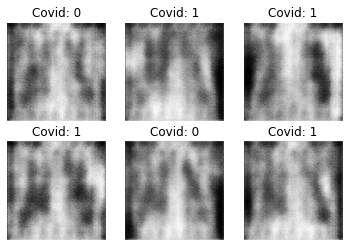

Epoch 122/200 Batch 3/3 [D loss: 0.66341, acc: 57.81%] [G loss: 0.68825]
Epoch 123/200 Batch 3/3 [D loss: 0.64451, acc: 65.62%] [G loss: 0.66600]
Epoch 124/200 Batch 3/3 [D loss: 0.66461, acc: 60.94%] [G loss: 0.69424]
Epoch 125/200 Batch 3/3 [D loss: 0.63809, acc: 65.62%] [G loss: 0.69177]
Epoch 126/200 Batch 3/3 [D loss: 0.64734, acc: 62.50%] [G loss: 0.69365]
Epoch 127/200 Batch 3/3 [D loss: 0.66138, acc: 60.94%] [G loss: 0.67382]
Epoch 128/200 Batch 3/3 [D loss: 0.66757, acc: 64.06%] [G loss: 0.67579]
Epoch 129/200 Batch 3/3 [D loss: 0.66692, acc: 64.06%] [G loss: 0.66915]
Epoch 130/200 Batch 3/3 [D loss: 0.68596, acc: 51.56%] [G loss: 0.67494]
Epoch 131/200 Batch 3/3 [D loss: 0.68598, acc: 53.12%] [G loss: 0.65195]
Epoch 132/200 Batch 3/3 [D loss: 0.66810, acc: 56.25%] [G loss: 0.66408]
Epoch 133/200 Batch 3/3 [D loss: 0.68860, acc: 48.44%] [G loss: 0.67649]
Epoch 134/200 Batch 3/3 [D loss: 0.67683, acc: 51.56%] [G loss: 0.65085]
Epoch 135/200 Batch 3/3 [D loss: 0.63540, acc: 57.8

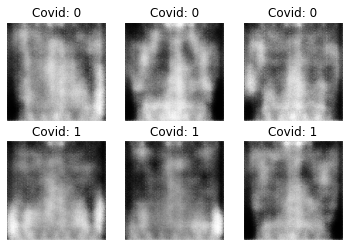

Epoch 142/200 Batch 3/3 [D loss: 0.67270, acc: 50.00%] [G loss: 0.65018]
Epoch 143/200 Batch 3/3 [D loss: 0.67100, acc: 59.38%] [G loss: 0.68073]
Epoch 144/200 Batch 3/3 [D loss: 0.66424, acc: 56.25%] [G loss: 0.70419]
Epoch 145/200 Batch 3/3 [D loss: 0.65962, acc: 65.62%] [G loss: 0.68716]
Epoch 146/200 Batch 3/3 [D loss: 0.65887, acc: 57.81%] [G loss: 0.68160]
Epoch 147/200 Batch 3/3 [D loss: 0.67646, acc: 46.88%] [G loss: 0.67166]
Epoch 148/200 Batch 3/3 [D loss: 0.69052, acc: 54.69%] [G loss: 0.66348]
Epoch 149/200 Batch 3/3 [D loss: 0.69126, acc: 50.00%] [G loss: 0.67663]
Epoch 150/200 Batch 3/3 [D loss: 0.69440, acc: 51.56%] [G loss: 0.66625]
Epoch 151/200 Batch 3/3 [D loss: 0.67905, acc: 50.00%] [G loss: 0.69345]
Epoch 152/200 Batch 3/3 [D loss: 0.66756, acc: 54.69%] [G loss: 0.72160]
Epoch 153/200 Batch 3/3 [D loss: 0.67959, acc: 45.31%] [G loss: 0.69686]
Epoch 154/200 Batch 3/3 [D loss: 0.64990, acc: 60.94%] [G loss: 0.72299]
Epoch 155/200 Batch 3/3 [D loss: 0.65326, acc: 54.6

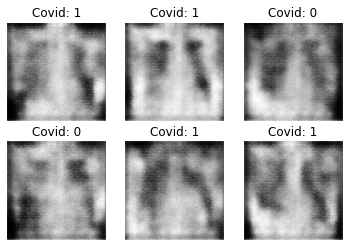

Epoch 162/200 Batch 3/3 [D loss: 0.64445, acc: 70.31%] [G loss: 0.71327]
Epoch 163/200 Batch 3/3 [D loss: 0.63799, acc: 67.19%] [G loss: 0.71624]
Epoch 164/200 Batch 3/3 [D loss: 0.64640, acc: 64.06%] [G loss: 0.73250]
Epoch 165/200 Batch 3/3 [D loss: 0.65152, acc: 59.38%] [G loss: 0.72273]
Epoch 166/200 Batch 3/3 [D loss: 0.65213, acc: 64.06%] [G loss: 0.68537]
Epoch 167/200 Batch 3/3 [D loss: 0.64981, acc: 62.50%] [G loss: 0.68466]
Epoch 168/200 Batch 3/3 [D loss: 0.65275, acc: 60.94%] [G loss: 0.69231]
Epoch 169/200 Batch 3/3 [D loss: 0.65522, acc: 60.94%] [G loss: 0.69679]
Epoch 170/200 Batch 3/3 [D loss: 0.62919, acc: 67.19%] [G loss: 0.69789]
Epoch 171/200 Batch 3/3 [D loss: 0.66924, acc: 53.12%] [G loss: 0.71309]
Epoch 172/200 Batch 3/3 [D loss: 0.61461, acc: 64.06%] [G loss: 0.71848]
Epoch 173/200 Batch 3/3 [D loss: 0.65452, acc: 53.12%] [G loss: 0.65990]
Epoch 174/200 Batch 3/3 [D loss: 0.62883, acc: 59.38%] [G loss: 0.67372]
Epoch 175/200 Batch 3/3 [D loss: 0.66283, acc: 50.0

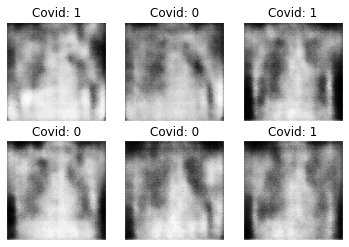

Epoch 182/200 Batch 3/3 [D loss: 0.67625, acc: 53.12%] [G loss: 0.70296]
Epoch 183/200 Batch 3/3 [D loss: 0.67327, acc: 57.81%] [G loss: 0.71251]
Epoch 184/200 Batch 3/3 [D loss: 0.66227, acc: 54.69%] [G loss: 0.69783]
Epoch 185/200 Batch 3/3 [D loss: 0.68237, acc: 46.88%] [G loss: 0.67481]
Epoch 186/200 Batch 3/3 [D loss: 0.65329, acc: 57.81%] [G loss: 0.68739]
Epoch 187/200 Batch 3/3 [D loss: 0.64584, acc: 59.38%] [G loss: 0.69560]
Epoch 188/200 Batch 3/3 [D loss: 0.68222, acc: 54.69%] [G loss: 0.70295]
Epoch 189/200 Batch 3/3 [D loss: 0.67057, acc: 54.69%] [G loss: 0.65552]
Epoch 190/200 Batch 3/3 [D loss: 0.70468, acc: 43.75%] [G loss: 0.65962]
Epoch 191/200 Batch 3/3 [D loss: 0.68922, acc: 45.31%] [G loss: 0.68939]
Epoch 192/200 Batch 3/3 [D loss: 0.66765, acc: 54.69%] [G loss: 0.70592]
Epoch 193/200 Batch 3/3 [D loss: 0.66303, acc: 62.50%] [G loss: 0.71682]
Epoch 194/200 Batch 3/3 [D loss: 0.62842, acc: 78.12%] [G loss: 0.74813]
Epoch 195/200 Batch 3/3 [D loss: 0.64101, acc: 75.0

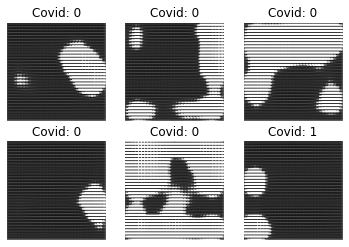

Epoch 2/300 Batch 12/12 [D loss: 16.57652, acc: 87.50%] [G loss: 421.41589]
Epoch 3/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 220.79614]
Epoch 4/300 Batch 12/12 [D loss: 1.12153, acc: 93.75%] [G loss: 128.62228]
Epoch 5/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 22.39573]
Epoch 6/300 Batch 12/12 [D loss: 2.21082, acc: 81.25%] [G loss: 69.86214]
Epoch 7/300 Batch 12/12 [D loss: 0.00110, acc: 100.00%] [G loss: 6.16806]
Epoch 8/300 Batch 12/12 [D loss: 0.00093, acc: 100.00%] [G loss: 8.56427]
Epoch 9/300 Batch 12/12 [D loss: 0.00145, acc: 100.00%] [G loss: 10.29564]
Epoch 10/300 Batch 12/12 [D loss: 0.03143, acc: 100.00%] [G loss: 8.81384]
Epoch 11/300 Batch 12/12 [D loss: 0.00004, acc: 100.00%] [G loss: 13.75088]
Epoch 12/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 39.76857]
Epoch 13/300 Batch 12/12 [D loss: 10588.06406, acc: 31.25%] [G loss: 1286316.50000]
Epoch 14/300 Batch 12/12 [D loss: 46151.37476, acc: 81.25%] [G loss: 2693380.50000]
Epoch 

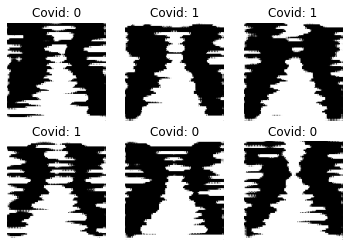

Epoch 22/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 286029.59375]
Epoch 23/300 Batch 12/12 [D loss: 7556.89551, acc: 87.50%] [G loss: 163251.50000]
Epoch 24/300 Batch 12/12 [D loss: 1475.88135, acc: 93.75%] [G loss: 142176.75000]
Epoch 25/300 Batch 12/12 [D loss: 1820.08093, acc: 93.75%] [G loss: 108656.82031]
Epoch 26/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 50333.48438]
Epoch 27/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 31557.17578]
Epoch 28/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 27878.25781]
Epoch 29/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 26140.79297]
Epoch 30/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 24879.21875]
Epoch 31/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 23107.12500]
Epoch 32/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 21447.67969]
Epoch 33/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 18691.90625]
Epoch 34/300 Batch 12/12 [D loss: 0.00000,

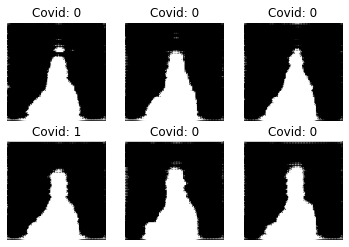

Epoch 42/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 9897.36133]
Epoch 43/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 9610.30273]
Epoch 44/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 45624.77344]
Epoch 45/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 47018.39453]
Epoch 46/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 46317.12500]
Epoch 47/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 43112.70312]
Epoch 48/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 42677.35938]
Epoch 49/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 41332.80469]
Epoch 50/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 41922.33594]
Epoch 51/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 39981.23047]
Epoch 52/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 40877.79688]
Epoch 53/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 38617.44922]
Epoch 54/300 Batch 12/12 [D loss: 0.00000, acc: 100.00

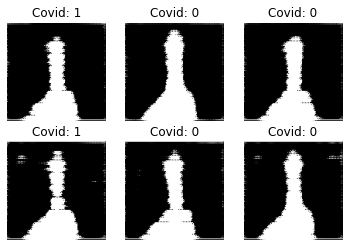

Epoch 62/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 30525.25586]
Epoch 63/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 130226.10938]
Epoch 64/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 100823.02344]
Epoch 65/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 79279.78906]
Epoch 66/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 30736.41016]
Epoch 67/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 128604.11719]
Epoch 68/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 110788.72656]
Epoch 69/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 92108.56250]
Epoch 70/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 61817.44922]
Epoch 71/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 139510.17188]
Epoch 72/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 63852.78125]
Epoch 73/300 Batch 12/12 [D loss: 7000.95020, acc: 93.75%] [G loss: 445995.12500]
Epoch 74/300 Batch 12/12 [D loss: 0.00000, a

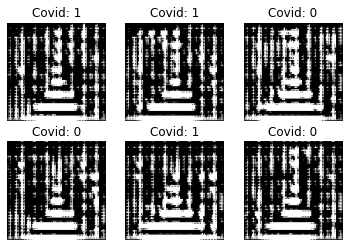

Epoch 82/300 Batch 12/12 [D loss: 1694.57239, acc: 93.75%] [G loss: 56505.92578]
Epoch 83/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 104780.44531]
Epoch 84/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 123416.83594]
Epoch 85/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 65598.08594]
Epoch 86/300 Batch 12/12 [D loss: 17863.97919, acc: 56.25%] [G loss: 2215479.00000]
Epoch 87/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 178824.37500]
Epoch 88/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 131049.23438]
Epoch 89/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 48952.81250]
Epoch 90/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 51740.37891]
Epoch 91/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 68081.28125]
Epoch 92/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 61440.59375]
Epoch 93/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 44193.92578]
Epoch 94/300 Batch 12/12 [D loss: 0.00000

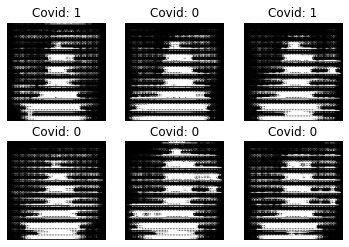

Epoch 102/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 42411.14453]
Epoch 103/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 45970.55469]
Epoch 104/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 31622.86719]
Epoch 105/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 20210.16406]
Epoch 106/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 311810.75000]
Epoch 107/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 25672.79492]
Epoch 108/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 86428.62500]
Epoch 109/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 182039.59375]
Epoch 110/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 176799.28125]
Epoch 111/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 154576.09375]
Epoch 112/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 121730.80469]
Epoch 113/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 93272.68750]
Epoch 114/300 Batch 12/12 [D loss: 

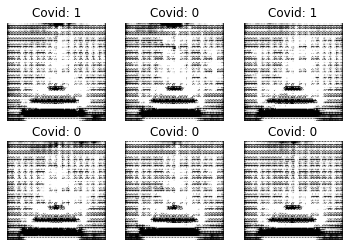

Epoch 122/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 375262.31250]
Epoch 123/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 47646.37891]
Epoch 124/300 Batch 12/12 [D loss: 1537.30481, acc: 93.75%] [G loss: 13851.72852]
Epoch 125/300 Batch 12/12 [D loss: 420.81311, acc: 93.75%] [G loss: 13772.29688]
Epoch 126/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 3797.03613]
Epoch 127/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 7290.39209]
Epoch 128/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 13863.60742]
Epoch 129/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 30897.49609]
Epoch 130/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 6969.05957]
Epoch 131/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 9464.54492]
Epoch 132/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 16312.90625]
Epoch 133/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 13114.27930]
Epoch 134/300 Batch 12/12 [D loss: 118.2

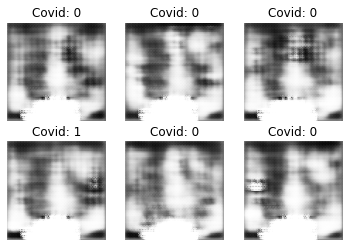

Epoch 142/300 Batch 12/12 [D loss: 359.46115, acc: 81.25%] [G loss: 5195.16309]
Epoch 143/300 Batch 12/12 [D loss: 557.04419, acc: 81.25%] [G loss: 5144.08496]
Epoch 144/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 4781.48926]
Epoch 145/300 Batch 12/12 [D loss: 29.18294, acc: 93.75%] [G loss: 3482.95557]
Epoch 146/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 2429.01660]
Epoch 147/300 Batch 12/12 [D loss: 69.83020, acc: 93.75%] [G loss: 2073.61743]
Epoch 148/300 Batch 12/12 [D loss: 787.93042, acc: 81.25%] [G loss: 5942.93945]
Epoch 149/300 Batch 12/12 [D loss: 529.40161, acc: 62.50%] [G loss: 5828.48633]
Epoch 150/300 Batch 12/12 [D loss: 43.98993, acc: 93.75%] [G loss: 2494.11914]
Epoch 151/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 3359.88477]
Epoch 152/300 Batch 12/12 [D loss: 165.56908, acc: 81.25%] [G loss: 4768.73291]
Epoch 153/300 Batch 12/12 [D loss: 29.07975, acc: 93.75%] [G loss: 3636.23120]
Epoch 154/300 Batch 12/12 [D loss: 0.00000, acc

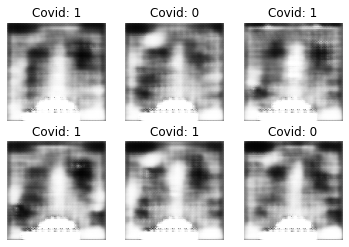

Epoch 162/300 Batch 12/12 [D loss: 12.35166, acc: 87.50%] [G loss: 1871.27637]
Epoch 163/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 1874.32434]
Epoch 164/300 Batch 12/12 [D loss: 29.13164, acc: 93.75%] [G loss: 913.77606]
Epoch 165/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 1170.18311]
Epoch 166/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 4723.43359]
Epoch 167/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 2968.42969]
Epoch 168/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 2499.15161]
Epoch 169/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 951.48779]
Epoch 170/300 Batch 12/12 [D loss: 52.33858, acc: 93.75%] [G loss: 1792.36023]
Epoch 171/300 Batch 12/12 [D loss: 2.55636, acc: 93.75%] [G loss: 3417.28687]
Epoch 172/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 3441.32739]
Epoch 173/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 1677.15808]
Epoch 174/300 Batch 12/12 [D loss: 0.00001, acc: 100.00

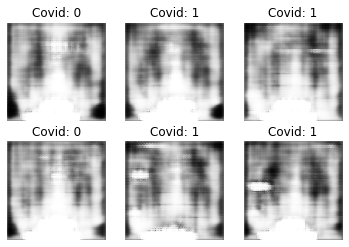

Epoch 182/300 Batch 12/12 [D loss: 247.45632, acc: 62.50%] [G loss: 3434.52661]
Epoch 183/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 2284.57764]
Epoch 184/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 2724.16040]
Epoch 185/300 Batch 12/12 [D loss: 53.47666, acc: 93.75%] [G loss: 945.76123]
Epoch 186/300 Batch 12/12 [D loss: 24.64751, acc: 93.75%] [G loss: 999.78748]
Epoch 187/300 Batch 12/12 [D loss: 62.07987, acc: 93.75%] [G loss: 726.96606]
Epoch 188/300 Batch 12/12 [D loss: 27.68848, acc: 93.75%] [G loss: 1836.09717]
Epoch 189/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 2029.20532]
Epoch 190/300 Batch 12/12 [D loss: 57.44821, acc: 75.00%] [G loss: 2426.55176]
Epoch 191/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 1416.76794]
Epoch 192/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 776.71344]
Epoch 193/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 1409.58093]
Epoch 194/300 Batch 12/12 [D loss: 0.00000, acc: 100.00

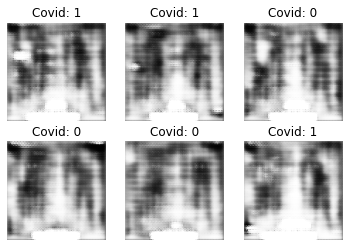

Epoch 202/300 Batch 12/12 [D loss: 44.07928, acc: 93.75%] [G loss: 532.08575]
Epoch 203/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 1661.56445]
Epoch 204/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 2445.00293]
Epoch 205/300 Batch 12/12 [D loss: 27.75557, acc: 87.50%] [G loss: 1526.47510]
Epoch 206/300 Batch 12/12 [D loss: 35.02156, acc: 93.75%] [G loss: 2739.12866]
Epoch 207/300 Batch 12/12 [D loss: 83.79626, acc: 93.75%] [G loss: 1548.44995]
Epoch 208/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 1078.35034]
Epoch 209/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 1623.47998]
Epoch 210/300 Batch 12/12 [D loss: 7.05070, acc: 93.75%] [G loss: 1671.21753]
Epoch 211/300 Batch 12/12 [D loss: 27.94787, acc: 93.75%] [G loss: 1011.35339]
Epoch 212/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 1403.14905]
Epoch 213/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 1338.95264]
Epoch 214/300 Batch 12/12 [D loss: 0.00000, acc: 100.0

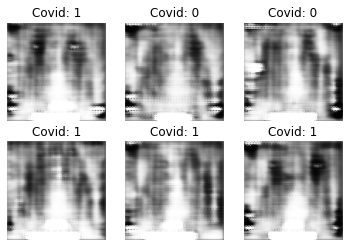

Epoch 222/300 Batch 12/12 [D loss: 49.90385, acc: 93.75%] [G loss: 2644.68896]
Epoch 223/300 Batch 12/12 [D loss: 195.94080, acc: 87.50%] [G loss: 1683.32129]
Epoch 224/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 2509.98682]
Epoch 225/300 Batch 12/12 [D loss: 52.15424, acc: 87.50%] [G loss: 2217.68457]
Epoch 226/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 1755.02368]
Epoch 227/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 1385.38159]
Epoch 228/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 2423.57593]
Epoch 229/300 Batch 12/12 [D loss: 7.67028, acc: 93.75%] [G loss: 1173.05774]
Epoch 230/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 1819.40698]
Epoch 231/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 2417.28662]
Epoch 232/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 1777.36646]
Epoch 233/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 2322.54150]
Epoch 234/300 Batch 12/12 [D loss: 0.00000, acc: 100

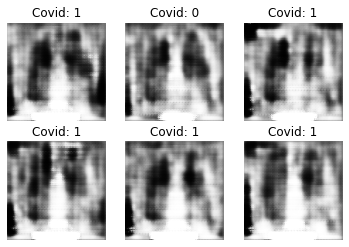

Epoch 242/300 Batch 12/12 [D loss: 3.64686, acc: 93.75%] [G loss: 2122.26611]
Epoch 243/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 1718.19580]
Epoch 244/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 1341.31238]
Epoch 245/300 Batch 12/12 [D loss: 18.58024, acc: 93.75%] [G loss: 1413.93872]
Epoch 246/300 Batch 12/12 [D loss: 10.29338, acc: 93.75%] [G loss: 1769.22485]
Epoch 247/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 4088.46216]
Epoch 248/300 Batch 12/12 [D loss: 243.01196, acc: 81.25%] [G loss: 1516.02637]
Epoch 249/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 1200.35437]
Epoch 250/300 Batch 12/12 [D loss: 29.46469, acc: 93.75%] [G loss: 2100.20972]
Epoch 251/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 1448.29224]
Epoch 252/300 Batch 12/12 [D loss: 414.02505, acc: 62.50%] [G loss: 823.09576]
Epoch 253/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 2012.61450]
Epoch 254/300 Batch 12/12 [D loss: 0.00000, acc: 100

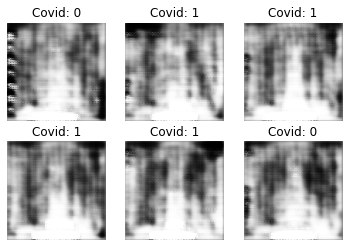

Epoch 262/300 Batch 12/12 [D loss: 68.09235, acc: 75.00%] [G loss: 887.26489]
Epoch 263/300 Batch 12/12 [D loss: 99.31541, acc: 87.50%] [G loss: 980.42957]
Epoch 264/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 2024.76929]
Epoch 265/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 1436.72864]
Epoch 266/300 Batch 12/12 [D loss: 38.46584, acc: 87.50%] [G loss: 2226.71045]
Epoch 267/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 1150.00122]
Epoch 268/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 1373.00720]
Epoch 269/300 Batch 12/12 [D loss: 58.21474, acc: 87.50%] [G loss: 1391.05298]
Epoch 270/300 Batch 12/12 [D loss: 19.62831, acc: 87.50%] [G loss: 1477.97192]
Epoch 271/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 1106.75293]
Epoch 272/300 Batch 12/12 [D loss: 0.00002, acc: 100.00%] [G loss: 1343.54846]
Epoch 273/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 1322.44702]
Epoch 274/300 Batch 12/12 [D loss: 11.65886, acc: 93.7

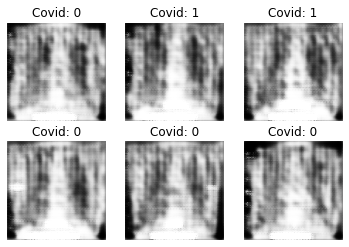

Epoch 282/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 1515.51636]
Epoch 283/300 Batch 12/12 [D loss: 29.98572, acc: 81.25%] [G loss: 1653.96802]
Epoch 284/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 1884.03271]
Epoch 285/300 Batch 12/12 [D loss: 69.69053, acc: 87.50%] [G loss: 602.36377]
Epoch 286/300 Batch 12/12 [D loss: 13.36599, acc: 87.50%] [G loss: 2049.51074]
Epoch 287/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 1570.95117]
Epoch 288/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 900.09387]
Epoch 289/300 Batch 12/12 [D loss: 20.21529, acc: 93.75%] [G loss: 1141.06555]
Epoch 290/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 1296.50757]
Epoch 291/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 752.27991]
Epoch 292/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 1150.88794]
Epoch 293/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 1488.10767]
Epoch 294/300 Batch 12/12 [D loss: 0.00000, acc: 100.00

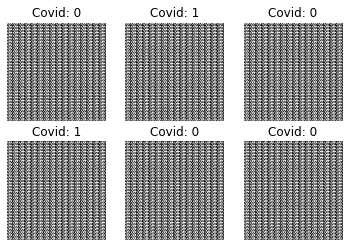

Epoch 2/300 Batch 12/12 [D loss: 0.00646, acc: 100.00%] [G loss: 5.04760]
Epoch 3/300 Batch 12/12 [D loss: 0.00160, acc: 100.00%] [G loss: 11.04732]
Epoch 4/300 Batch 12/12 [D loss: 0.00214, acc: 100.00%] [G loss: 6.69778]
Epoch 5/300 Batch 12/12 [D loss: 0.00207, acc: 100.00%] [G loss: 7.11373]
Epoch 6/300 Batch 12/12 [D loss: 0.10998, acc: 100.00%] [G loss: 2.09066]
Epoch 7/300 Batch 12/12 [D loss: 0.02130, acc: 100.00%] [G loss: 3.44708]
Epoch 8/300 Batch 12/12 [D loss: 0.01509, acc: 100.00%] [G loss: 4.14257]
Epoch 9/300 Batch 12/12 [D loss: 0.76021, acc: 93.75%] [G loss: 1.28660]
Epoch 10/300 Batch 12/12 [D loss: 0.24262, acc: 100.00%] [G loss: 2.35153]
Epoch 11/300 Batch 12/12 [D loss: 1.02925, acc: 37.50%] [G loss: 0.65613]
Epoch 12/300 Batch 12/12 [D loss: 0.60548, acc: 68.75%] [G loss: 1.63851]
Epoch 13/300 Batch 12/12 [D loss: 0.49953, acc: 81.25%] [G loss: 1.15064]
Epoch 14/300 Batch 12/12 [D loss: 0.56005, acc: 68.75%] [G loss: 1.31192]
Epoch 15/300 Batch 12/12 [D loss: 0.4

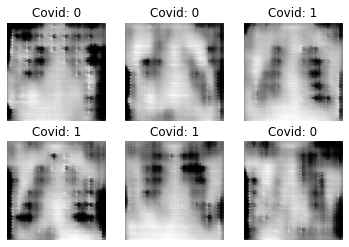

Epoch 22/300 Batch 12/12 [D loss: 0.56268, acc: 68.75%] [G loss: 1.04841]
Epoch 23/300 Batch 12/12 [D loss: 0.50465, acc: 62.50%] [G loss: 1.88346]
Epoch 24/300 Batch 12/12 [D loss: 0.66349, acc: 62.50%] [G loss: 1.61227]
Epoch 25/300 Batch 12/12 [D loss: 0.61390, acc: 75.00%] [G loss: 1.89085]
Epoch 26/300 Batch 12/12 [D loss: 0.55269, acc: 62.50%] [G loss: 1.47152]
Epoch 27/300 Batch 12/12 [D loss: 0.68315, acc: 56.25%] [G loss: 2.41256]
Epoch 28/300 Batch 12/12 [D loss: 0.46549, acc: 81.25%] [G loss: 1.58443]
Epoch 29/300 Batch 12/12 [D loss: 0.69977, acc: 56.25%] [G loss: 1.44626]
Epoch 30/300 Batch 12/12 [D loss: 0.26448, acc: 100.00%] [G loss: 1.48199]
Epoch 31/300 Batch 12/12 [D loss: 0.32800, acc: 93.75%] [G loss: 1.54719]
Epoch 32/300 Batch 12/12 [D loss: 0.40452, acc: 81.25%] [G loss: 1.19542]
Epoch 33/300 Batch 12/12 [D loss: 0.53471, acc: 68.75%] [G loss: 1.67522]
Epoch 34/300 Batch 12/12 [D loss: 0.75672, acc: 56.25%] [G loss: 1.93665]
Epoch 35/300 Batch 12/12 [D loss: 0.2

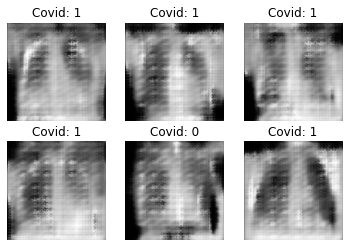

Epoch 42/300 Batch 12/12 [D loss: 0.28363, acc: 87.50%] [G loss: 1.85523]
Epoch 43/300 Batch 12/12 [D loss: 0.23360, acc: 93.75%] [G loss: 1.84676]
Epoch 44/300 Batch 12/12 [D loss: 0.25846, acc: 93.75%] [G loss: 2.41643]
Epoch 45/300 Batch 12/12 [D loss: 0.18830, acc: 100.00%] [G loss: 3.01026]
Epoch 46/300 Batch 12/12 [D loss: 0.48492, acc: 75.00%] [G loss: 3.22741]
Epoch 47/300 Batch 12/12 [D loss: 0.52352, acc: 75.00%] [G loss: 2.73944]
Epoch 48/300 Batch 12/12 [D loss: 0.26788, acc: 93.75%] [G loss: 2.71465]
Epoch 49/300 Batch 12/12 [D loss: 0.24366, acc: 93.75%] [G loss: 2.39321]
Epoch 50/300 Batch 12/12 [D loss: 0.46260, acc: 75.00%] [G loss: 3.15376]
Epoch 51/300 Batch 12/12 [D loss: 0.17266, acc: 100.00%] [G loss: 2.78714]
Epoch 52/300 Batch 12/12 [D loss: 0.56208, acc: 75.00%] [G loss: 2.42308]
Epoch 53/300 Batch 12/12 [D loss: 0.46421, acc: 81.25%] [G loss: 2.41534]
Epoch 54/300 Batch 12/12 [D loss: 0.42475, acc: 81.25%] [G loss: 3.07681]
Epoch 55/300 Batch 12/12 [D loss: 0.

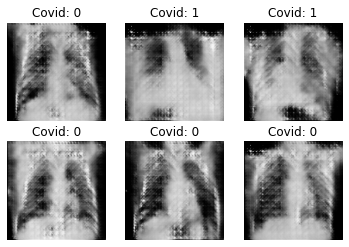

Epoch 62/300 Batch 12/12 [D loss: 0.41015, acc: 81.25%] [G loss: 3.04597]
Epoch 63/300 Batch 12/12 [D loss: 0.43236, acc: 81.25%] [G loss: 2.63585]
Epoch 64/300 Batch 12/12 [D loss: 0.61882, acc: 75.00%] [G loss: 2.66706]
Epoch 65/300 Batch 12/12 [D loss: 0.19531, acc: 100.00%] [G loss: 2.53428]
Epoch 66/300 Batch 12/12 [D loss: 0.41411, acc: 75.00%] [G loss: 1.89121]
Epoch 67/300 Batch 12/12 [D loss: 0.53222, acc: 62.50%] [G loss: 3.75740]
Epoch 68/300 Batch 12/12 [D loss: 0.45520, acc: 75.00%] [G loss: 3.01237]
Epoch 69/300 Batch 12/12 [D loss: 0.35098, acc: 81.25%] [G loss: 2.19637]
Epoch 70/300 Batch 12/12 [D loss: 0.38696, acc: 87.50%] [G loss: 3.12346]
Epoch 71/300 Batch 12/12 [D loss: 0.31994, acc: 87.50%] [G loss: 2.59032]
Epoch 72/300 Batch 12/12 [D loss: 0.31823, acc: 93.75%] [G loss: 3.34258]
Epoch 73/300 Batch 12/12 [D loss: 0.35139, acc: 81.25%] [G loss: 1.99709]
Epoch 74/300 Batch 12/12 [D loss: 0.43973, acc: 81.25%] [G loss: 3.09428]
Epoch 75/300 Batch 12/12 [D loss: 0.2

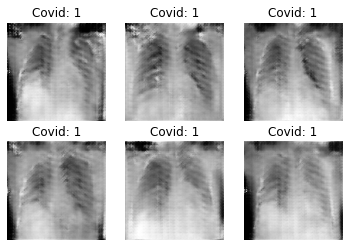

Epoch 82/300 Batch 12/12 [D loss: 0.25577, acc: 87.50%] [G loss: 3.42602]
Epoch 83/300 Batch 12/12 [D loss: 0.28236, acc: 93.75%] [G loss: 2.99474]
Epoch 84/300 Batch 12/12 [D loss: 0.29825, acc: 87.50%] [G loss: 3.11916]
Epoch 85/300 Batch 12/12 [D loss: 0.64226, acc: 62.50%] [G loss: 3.07339]
Epoch 86/300 Batch 12/12 [D loss: 0.56276, acc: 62.50%] [G loss: 7.35398]
Epoch 87/300 Batch 12/12 [D loss: 0.29661, acc: 93.75%] [G loss: 3.70796]
Epoch 88/300 Batch 12/12 [D loss: 0.38234, acc: 81.25%] [G loss: 2.54794]
Epoch 89/300 Batch 12/12 [D loss: 0.56837, acc: 81.25%] [G loss: 2.84180]
Epoch 90/300 Batch 12/12 [D loss: 0.22013, acc: 93.75%] [G loss: 2.82341]
Epoch 91/300 Batch 12/12 [D loss: 0.27500, acc: 87.50%] [G loss: 2.27086]
Epoch 92/300 Batch 12/12 [D loss: 0.37165, acc: 75.00%] [G loss: 3.64553]
Epoch 93/300 Batch 12/12 [D loss: 0.25269, acc: 93.75%] [G loss: 3.32658]
Epoch 94/300 Batch 12/12 [D loss: 0.21783, acc: 93.75%] [G loss: 4.04484]
Epoch 95/300 Batch 12/12 [D loss: 0.40

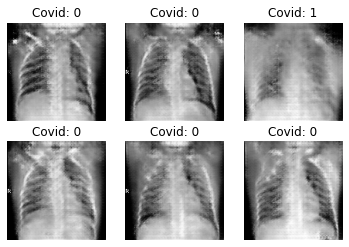

Epoch 102/300 Batch 12/12 [D loss: 0.24712, acc: 93.75%] [G loss: 2.92925]
Epoch 103/300 Batch 12/12 [D loss: 0.38975, acc: 87.50%] [G loss: 6.14747]
Epoch 104/300 Batch 12/12 [D loss: 0.16979, acc: 93.75%] [G loss: 3.93400]
Epoch 105/300 Batch 12/12 [D loss: 0.14475, acc: 93.75%] [G loss: 4.17876]
Epoch 106/300 Batch 12/12 [D loss: 0.58097, acc: 75.00%] [G loss: 4.59850]
Epoch 107/300 Batch 12/12 [D loss: 0.30501, acc: 87.50%] [G loss: 3.75738]
Epoch 108/300 Batch 12/12 [D loss: 0.48907, acc: 81.25%] [G loss: 3.86116]
Epoch 109/300 Batch 12/12 [D loss: 0.21938, acc: 93.75%] [G loss: 3.24861]
Epoch 110/300 Batch 12/12 [D loss: 0.22939, acc: 93.75%] [G loss: 5.59469]
Epoch 111/300 Batch 12/12 [D loss: 0.21267, acc: 93.75%] [G loss: 3.02605]
Epoch 112/300 Batch 12/12 [D loss: 0.32324, acc: 93.75%] [G loss: 2.84121]
Epoch 113/300 Batch 12/12 [D loss: 0.56196, acc: 68.75%] [G loss: 3.89277]
Epoch 114/300 Batch 12/12 [D loss: 0.35275, acc: 75.00%] [G loss: 3.23620]
Epoch 115/300 Batch 12/12

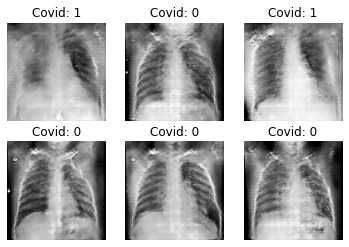

Epoch 122/300 Batch 12/12 [D loss: 0.17169, acc: 93.75%] [G loss: 3.90496]
Epoch 123/300 Batch 12/12 [D loss: 0.38380, acc: 81.25%] [G loss: 3.30283]
Epoch 124/300 Batch 12/12 [D loss: 0.48677, acc: 81.25%] [G loss: 5.77573]
Epoch 125/300 Batch 12/12 [D loss: 0.22537, acc: 87.50%] [G loss: 3.57353]
Epoch 126/300 Batch 12/12 [D loss: 0.18053, acc: 100.00%] [G loss: 3.50149]
Epoch 127/300 Batch 12/12 [D loss: 0.17669, acc: 93.75%] [G loss: 4.12787]
Epoch 128/300 Batch 12/12 [D loss: 0.03669, acc: 100.00%] [G loss: 4.29617]
Epoch 129/300 Batch 12/12 [D loss: 0.26534, acc: 87.50%] [G loss: 3.24277]
Epoch 130/300 Batch 12/12 [D loss: 0.15586, acc: 93.75%] [G loss: 4.52253]
Epoch 131/300 Batch 12/12 [D loss: 0.22302, acc: 87.50%] [G loss: 4.75329]
Epoch 132/300 Batch 12/12 [D loss: 0.42470, acc: 75.00%] [G loss: 5.17517]
Epoch 133/300 Batch 12/12 [D loss: 0.44674, acc: 81.25%] [G loss: 3.13095]
Epoch 134/300 Batch 12/12 [D loss: 0.07139, acc: 100.00%] [G loss: 3.51484]
Epoch 135/300 Batch 12

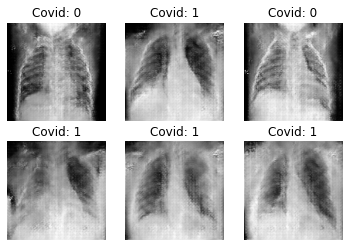

Epoch 142/300 Batch 12/12 [D loss: 0.33005, acc: 87.50%] [G loss: 3.54488]
Epoch 143/300 Batch 12/12 [D loss: 0.09984, acc: 100.00%] [G loss: 5.87359]
Epoch 144/300 Batch 12/12 [D loss: 0.19268, acc: 93.75%] [G loss: 2.76368]
Epoch 145/300 Batch 12/12 [D loss: 0.12367, acc: 100.00%] [G loss: 3.85898]
Epoch 146/300 Batch 12/12 [D loss: 0.08062, acc: 100.00%] [G loss: 4.77887]
Epoch 147/300 Batch 12/12 [D loss: 0.12649, acc: 100.00%] [G loss: 3.87142]
Epoch 148/300 Batch 12/12 [D loss: 0.14400, acc: 100.00%] [G loss: 3.10839]
Epoch 149/300 Batch 12/12 [D loss: 0.25383, acc: 81.25%] [G loss: 8.36804]
Epoch 150/300 Batch 12/12 [D loss: 0.17903, acc: 87.50%] [G loss: 3.78948]
Epoch 151/300 Batch 12/12 [D loss: 0.12923, acc: 100.00%] [G loss: 4.10564]
Epoch 152/300 Batch 12/12 [D loss: 0.10398, acc: 100.00%] [G loss: 4.13586]
Epoch 153/300 Batch 12/12 [D loss: 0.36492, acc: 81.25%] [G loss: 2.45029]
Epoch 154/300 Batch 12/12 [D loss: 0.24344, acc: 87.50%] [G loss: 5.43754]
Epoch 155/300 Batc

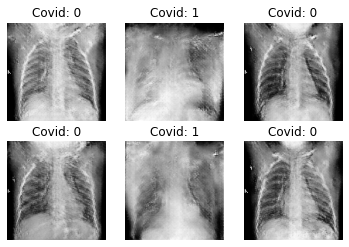

Epoch 162/300 Batch 12/12 [D loss: 0.32462, acc: 93.75%] [G loss: 3.38946]
Epoch 163/300 Batch 12/12 [D loss: 0.06584, acc: 100.00%] [G loss: 4.48238]
Epoch 164/300 Batch 12/12 [D loss: 0.27535, acc: 87.50%] [G loss: 7.48002]
Epoch 165/300 Batch 12/12 [D loss: 0.18218, acc: 93.75%] [G loss: 6.08578]
Epoch 166/300 Batch 12/12 [D loss: 0.31979, acc: 93.75%] [G loss: 7.29325]
Epoch 167/300 Batch 12/12 [D loss: 0.14571, acc: 100.00%] [G loss: 4.80689]
Epoch 168/300 Batch 12/12 [D loss: 0.23624, acc: 81.25%] [G loss: 3.67138]
Epoch 169/300 Batch 12/12 [D loss: 0.32293, acc: 87.50%] [G loss: 4.60299]
Epoch 170/300 Batch 12/12 [D loss: 0.20315, acc: 87.50%] [G loss: 3.59359]
Epoch 171/300 Batch 12/12 [D loss: 0.02427, acc: 100.00%] [G loss: 5.00606]
Epoch 172/300 Batch 12/12 [D loss: 0.07819, acc: 100.00%] [G loss: 4.72408]
Epoch 173/300 Batch 12/12 [D loss: 0.06662, acc: 100.00%] [G loss: 4.69862]
Epoch 174/300 Batch 12/12 [D loss: 0.14798, acc: 93.75%] [G loss: 5.39211]
Epoch 175/300 Batch 

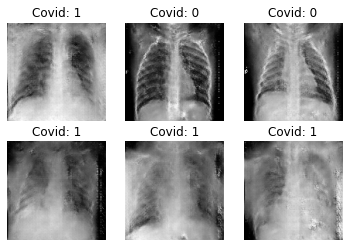

Epoch 182/300 Batch 12/12 [D loss: 0.21888, acc: 93.75%] [G loss: 6.57289]
Epoch 183/300 Batch 12/12 [D loss: 0.17709, acc: 93.75%] [G loss: 4.76766]
Epoch 184/300 Batch 12/12 [D loss: 0.11434, acc: 100.00%] [G loss: 4.65988]
Epoch 185/300 Batch 12/12 [D loss: 0.06677, acc: 100.00%] [G loss: 5.08718]
Epoch 186/300 Batch 12/12 [D loss: 0.06285, acc: 100.00%] [G loss: 5.30892]
Epoch 187/300 Batch 12/12 [D loss: 0.36080, acc: 87.50%] [G loss: 7.59441]
Epoch 188/300 Batch 12/12 [D loss: 0.22915, acc: 87.50%] [G loss: 4.02751]
Epoch 189/300 Batch 12/12 [D loss: 0.03278, acc: 100.00%] [G loss: 4.83165]
Epoch 190/300 Batch 12/12 [D loss: 0.02218, acc: 100.00%] [G loss: 4.51775]
Epoch 191/300 Batch 12/12 [D loss: 0.01808, acc: 100.00%] [G loss: 4.58154]
Epoch 192/300 Batch 12/12 [D loss: 0.02427, acc: 100.00%] [G loss: 5.51655]
Epoch 193/300 Batch 12/12 [D loss: 0.18391, acc: 93.75%] [G loss: 6.18554]
Epoch 194/300 Batch 12/12 [D loss: 0.60480, acc: 87.50%] [G loss: 4.38805]
Epoch 195/300 Batc

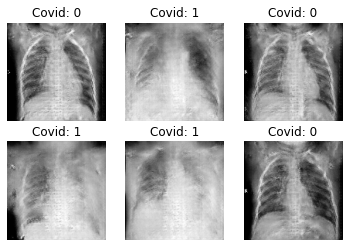

Epoch 202/300 Batch 12/12 [D loss: 0.36318, acc: 81.25%] [G loss: 6.17969]
Epoch 203/300 Batch 12/12 [D loss: 0.21351, acc: 93.75%] [G loss: 5.71949]
Epoch 204/300 Batch 12/12 [D loss: 0.19142, acc: 87.50%] [G loss: 4.09134]
Epoch 205/300 Batch 12/12 [D loss: 0.50381, acc: 87.50%] [G loss: 4.04289]
Epoch 206/300 Batch 12/12 [D loss: 0.30827, acc: 87.50%] [G loss: 8.17251]
Epoch 207/300 Batch 12/12 [D loss: 0.04671, acc: 100.00%] [G loss: 6.19627]
Epoch 208/300 Batch 12/12 [D loss: 0.29892, acc: 81.25%] [G loss: 4.71192]
Epoch 209/300 Batch 12/12 [D loss: 0.37173, acc: 87.50%] [G loss: 4.18260]
Epoch 210/300 Batch 12/12 [D loss: 0.10171, acc: 93.75%] [G loss: 6.67688]
Epoch 211/300 Batch 12/12 [D loss: 0.16632, acc: 87.50%] [G loss: 4.35517]
Epoch 212/300 Batch 12/12 [D loss: 0.11393, acc: 93.75%] [G loss: 3.27331]
Epoch 213/300 Batch 12/12 [D loss: 0.02554, acc: 100.00%] [G loss: 4.76030]
Epoch 214/300 Batch 12/12 [D loss: 0.08204, acc: 93.75%] [G loss: 6.43000]
Epoch 215/300 Batch 12/

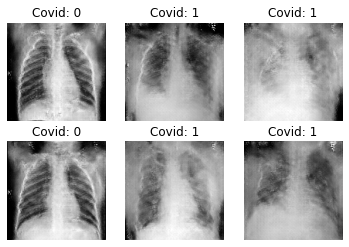

Epoch 222/300 Batch 12/12 [D loss: 0.12285, acc: 100.00%] [G loss: 7.33954]
Epoch 223/300 Batch 12/12 [D loss: 0.22806, acc: 93.75%] [G loss: 5.58415]
Epoch 224/300 Batch 12/12 [D loss: 0.02698, acc: 100.00%] [G loss: 5.38723]
Epoch 225/300 Batch 12/12 [D loss: 0.14726, acc: 93.75%] [G loss: 5.66077]
Epoch 226/300 Batch 12/12 [D loss: 0.11522, acc: 93.75%] [G loss: 5.86197]
Epoch 227/300 Batch 12/12 [D loss: 0.17001, acc: 93.75%] [G loss: 4.68149]
Epoch 228/300 Batch 12/12 [D loss: 0.10893, acc: 93.75%] [G loss: 6.67205]
Epoch 229/300 Batch 12/12 [D loss: 0.09047, acc: 100.00%] [G loss: 4.13537]
Epoch 230/300 Batch 12/12 [D loss: 0.54233, acc: 81.25%] [G loss: 6.03121]
Epoch 231/300 Batch 12/12 [D loss: 0.12239, acc: 93.75%] [G loss: 7.14946]
Epoch 232/300 Batch 12/12 [D loss: 0.11521, acc: 93.75%] [G loss: 12.76648]
Epoch 233/300 Batch 12/12 [D loss: 0.10117, acc: 93.75%] [G loss: 4.29977]
Epoch 234/300 Batch 12/12 [D loss: 0.08057, acc: 93.75%] [G loss: 4.05254]
Epoch 235/300 Batch 1

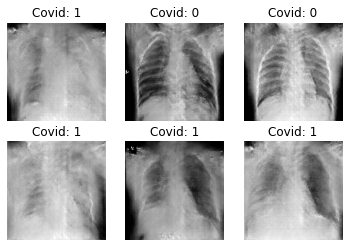

Epoch 242/300 Batch 12/12 [D loss: 0.04519, acc: 100.00%] [G loss: 4.56052]
Epoch 243/300 Batch 12/12 [D loss: 0.04539, acc: 100.00%] [G loss: 5.84470]
Epoch 244/300 Batch 12/12 [D loss: 0.20564, acc: 87.50%] [G loss: 4.57770]
Epoch 245/300 Batch 12/12 [D loss: 0.04964, acc: 100.00%] [G loss: 6.78098]
Epoch 246/300 Batch 12/12 [D loss: 0.05762, acc: 100.00%] [G loss: 5.90852]
Epoch 247/300 Batch 12/12 [D loss: 0.03704, acc: 100.00%] [G loss: 5.77399]
Epoch 248/300 Batch 12/12 [D loss: 0.01440, acc: 100.00%] [G loss: 7.31358]
Epoch 249/300 Batch 12/12 [D loss: 0.01303, acc: 100.00%] [G loss: 5.53800]
Epoch 250/300 Batch 12/12 [D loss: 0.03825, acc: 100.00%] [G loss: 4.33196]
Epoch 251/300 Batch 12/12 [D loss: 0.09301, acc: 93.75%] [G loss: 4.73716]
Epoch 252/300 Batch 12/12 [D loss: 0.02774, acc: 100.00%] [G loss: 6.71030]
Epoch 253/300 Batch 12/12 [D loss: 0.02132, acc: 100.00%] [G loss: 7.47150]
Epoch 254/300 Batch 12/12 [D loss: 0.43700, acc: 87.50%] [G loss: 3.85590]
Epoch 255/300 B

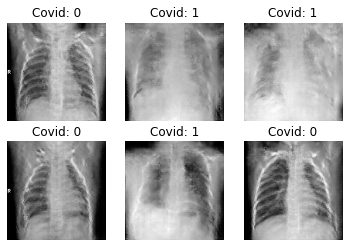

Epoch 262/300 Batch 12/12 [D loss: 0.10887, acc: 93.75%] [G loss: 6.38256]
Epoch 263/300 Batch 12/12 [D loss: 0.04163, acc: 100.00%] [G loss: 5.61395]
Epoch 264/300 Batch 12/12 [D loss: 0.04890, acc: 100.00%] [G loss: 7.20432]
Epoch 265/300 Batch 12/12 [D loss: 0.47848, acc: 68.75%] [G loss: 15.30092]
Epoch 266/300 Batch 12/12 [D loss: 0.03259, acc: 100.00%] [G loss: 6.46345]
Epoch 267/300 Batch 12/12 [D loss: 0.20679, acc: 93.75%] [G loss: 5.62394]
Epoch 268/300 Batch 12/12 [D loss: 0.10689, acc: 93.75%] [G loss: 4.92822]
Epoch 269/300 Batch 12/12 [D loss: 0.02183, acc: 100.00%] [G loss: 5.96674]
Epoch 270/300 Batch 12/12 [D loss: 0.09087, acc: 93.75%] [G loss: 6.30274]
Epoch 271/300 Batch 12/12 [D loss: 0.02984, acc: 100.00%] [G loss: 6.79559]
Epoch 272/300 Batch 12/12 [D loss: 0.32519, acc: 87.50%] [G loss: 6.78070]
Epoch 273/300 Batch 12/12 [D loss: 0.05617, acc: 100.00%] [G loss: 5.23421]
Epoch 274/300 Batch 12/12 [D loss: 0.02802, acc: 100.00%] [G loss: 5.13833]
Epoch 275/300 Bat

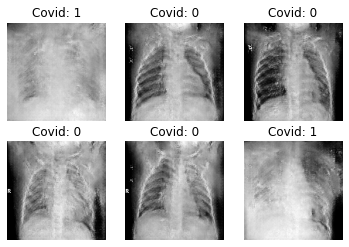

Epoch 282/300 Batch 12/12 [D loss: 0.03941, acc: 100.00%] [G loss: 4.87809]
Epoch 283/300 Batch 12/12 [D loss: 0.01586, acc: 100.00%] [G loss: 6.56965]
Epoch 284/300 Batch 12/12 [D loss: 0.00359, acc: 100.00%] [G loss: 8.48573]
Epoch 285/300 Batch 12/12 [D loss: 0.47610, acc: 87.50%] [G loss: 8.07135]
Epoch 286/300 Batch 12/12 [D loss: 0.07919, acc: 93.75%] [G loss: 9.75212]
Epoch 287/300 Batch 12/12 [D loss: 0.17153, acc: 93.75%] [G loss: 4.25112]
Epoch 288/300 Batch 12/12 [D loss: 0.00947, acc: 100.00%] [G loss: 8.97842]
Epoch 289/300 Batch 12/12 [D loss: 0.06810, acc: 100.00%] [G loss: 6.46890]
Epoch 290/300 Batch 12/12 [D loss: 0.02110, acc: 100.00%] [G loss: 7.76740]
Epoch 291/300 Batch 12/12 [D loss: 0.01957, acc: 100.00%] [G loss: 6.43845]
Epoch 292/300 Batch 12/12 [D loss: 0.04452, acc: 100.00%] [G loss: 6.62023]
Epoch 293/300 Batch 12/12 [D loss: 0.23574, acc: 93.75%] [G loss: 6.61076]
Epoch 294/300 Batch 12/12 [D loss: 0.03752, acc: 100.00%] [G loss: 7.04909]
Epoch 295/300 Ba

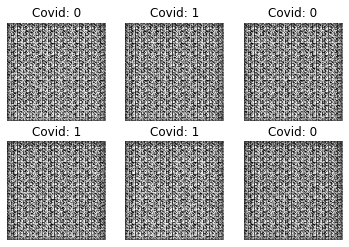

Epoch 2/300 Batch 12/12 [D loss: 0.20760, acc: 100.00%] [G loss: 2.21631]
Epoch 3/300 Batch 12/12 [D loss: 0.50953, acc: 81.25%] [G loss: 3.40354]
Epoch 4/300 Batch 12/12 [D loss: 0.51571, acc: 81.25%] [G loss: 2.17633]
Epoch 5/300 Batch 12/12 [D loss: 0.38632, acc: 68.75%] [G loss: 1.50964]
Epoch 6/300 Batch 12/12 [D loss: 0.69061, acc: 43.75%] [G loss: 1.26479]
Epoch 7/300 Batch 12/12 [D loss: 0.76523, acc: 37.50%] [G loss: 1.06625]
Epoch 8/300 Batch 12/12 [D loss: 0.68153, acc: 62.50%] [G loss: 0.99171]
Epoch 9/300 Batch 12/12 [D loss: 0.75113, acc: 31.25%] [G loss: 0.80941]
Epoch 10/300 Batch 12/12 [D loss: 0.66578, acc: 62.50%] [G loss: 0.89531]
Epoch 11/300 Batch 12/12 [D loss: 0.63397, acc: 68.75%] [G loss: 0.77822]
Epoch 12/300 Batch 12/12 [D loss: 0.58432, acc: 87.50%] [G loss: 0.85968]
Epoch 13/300 Batch 12/12 [D loss: 0.68200, acc: 50.00%] [G loss: 0.71294]
Epoch 14/300 Batch 12/12 [D loss: 0.66955, acc: 62.50%] [G loss: 0.58320]
Epoch 15/300 Batch 12/12 [D loss: 0.60221, ac

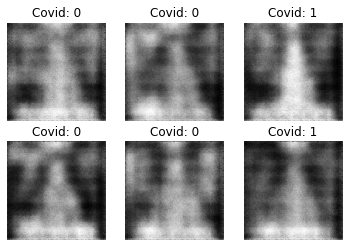

Epoch 22/300 Batch 12/12 [D loss: 0.74484, acc: 37.50%] [G loss: 0.64612]
Epoch 23/300 Batch 12/12 [D loss: 0.66332, acc: 62.50%] [G loss: 0.78916]
Epoch 24/300 Batch 12/12 [D loss: 0.66706, acc: 50.00%] [G loss: 0.72108]
Epoch 25/300 Batch 12/12 [D loss: 0.66338, acc: 56.25%] [G loss: 0.59906]
Epoch 26/300 Batch 12/12 [D loss: 0.72522, acc: 50.00%] [G loss: 0.60297]
Epoch 27/300 Batch 12/12 [D loss: 0.66706, acc: 56.25%] [G loss: 0.68714]
Epoch 28/300 Batch 12/12 [D loss: 0.67108, acc: 50.00%] [G loss: 0.68256]
Epoch 29/300 Batch 12/12 [D loss: 0.67343, acc: 62.50%] [G loss: 0.73048]
Epoch 30/300 Batch 12/12 [D loss: 0.69524, acc: 37.50%] [G loss: 0.69877]
Epoch 31/300 Batch 12/12 [D loss: 0.63605, acc: 68.75%] [G loss: 0.66681]
Epoch 32/300 Batch 12/12 [D loss: 0.69107, acc: 43.75%] [G loss: 0.65934]


In [ ]:
# build different models with different hyperparameters
for e in params['epochs']:
  for bs in params['batch_size']:
    for lr in params['learning_rate']:
      name = 'e_'+str(e)+'_bs_'+str(bs)+'_lr_'+str(lr) #create a model name
      os.mkdir('images/'+name)
      cgan = CGAN(data, lr) 
      cgan.train(e, bs, name)

### 1.2.1 - Training (Part 2)

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 64, 64, 128)       4224      
_________________________________________________________________
leaky_re_lu (LeakyReLU)      (None, 64, 64, 128)       0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 32, 32, 256)       524544    
_________________________________________________________________
leaky_re_lu_1 (LeakyReLU)    (None, 32, 32, 256)       0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 16, 16, 512)       2097664   
_________________________________________________________________
leaky_re_lu_2 (LeakyReLU)    (None, 16, 16, 512)       0         
_________________________________________________________________
conv2d_3 (Conv2D)            (None, 8, 8, 1024)        8

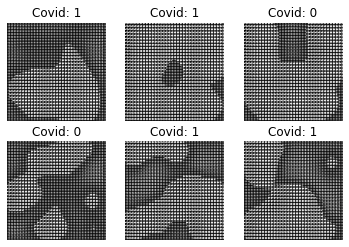

Epoch 2/300 Batch 12/12 [D loss: 3.71133, acc: 93.75%] [G loss: 2116.78662]
Epoch 3/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 721.14142]
Epoch 4/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 572.42694]
Epoch 5/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 523.38062]
Epoch 6/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 512.69446]
Epoch 7/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 511.00610]
Epoch 8/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 503.63757]
Epoch 9/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 500.78778]
Epoch 10/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 500.50195]
Epoch 11/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 501.01685]
Epoch 12/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 500.11163]
Epoch 13/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 494.61691]
Epoch 14/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 481.35291]
Epoch 1

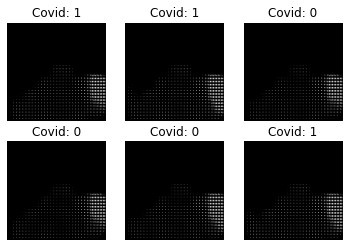

Epoch 22/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 456.73190]
Epoch 23/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 462.60291]
Epoch 24/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 454.76312]
Epoch 25/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 459.48102]
Epoch 26/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 459.06116]
Epoch 27/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 455.19879]
Epoch 28/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 450.49838]
Epoch 29/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 448.09314]
Epoch 30/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 455.46442]
Epoch 31/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 461.11603]
Epoch 32/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 456.21152]
Epoch 33/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 450.56750]
Epoch 34/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 457.02798]

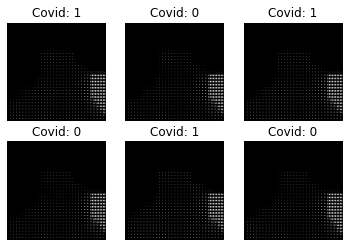

Epoch 42/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 449.19147]
Epoch 43/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 457.89700]
Epoch 44/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 452.11688]
Epoch 45/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 454.64667]
Epoch 46/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 454.98901]
Epoch 47/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 448.58304]
Epoch 48/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 455.62231]
Epoch 49/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 455.57791]
Epoch 50/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 452.43674]
Epoch 51/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 451.09735]
Epoch 52/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 451.52533]
Epoch 53/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 451.47623]
Epoch 54/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 458.21365]

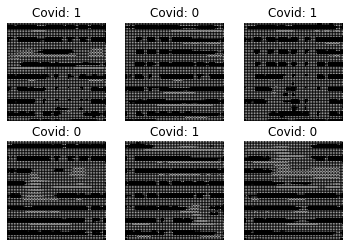

Epoch 62/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 1535757.50000]
Epoch 63/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 751193.37500]
Epoch 64/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 753203.12500]
Epoch 65/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 724965.87500]
Epoch 66/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 1238646.00000]
Epoch 67/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 315093.09375]
Epoch 68/300 Batch 12/12 [D loss: 3732.27539, acc: 93.75%] [G loss: 276179.59375]
Epoch 69/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 541514.25000]
Epoch 70/300 Batch 12/12 [D loss: 25994.51758, acc: 93.75%] [G loss: 332310.96875]
Epoch 71/300 Batch 12/12 [D loss: 30186.53711, acc: 87.50%] [G loss: 635830.25000]
Epoch 72/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 358119.56250]
Epoch 73/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 522806.15625]
Epoch 74/300 Batch 12/12 [D lo

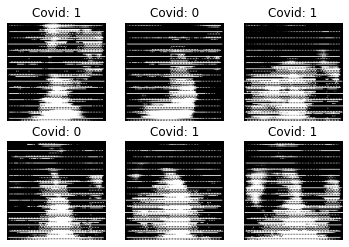

Epoch 82/300 Batch 12/12 [D loss: 779.98871, acc: 93.75%] [G loss: 203216.70312]
Epoch 83/300 Batch 12/12 [D loss: 7811.11523, acc: 81.25%] [G loss: 217451.35938]
Epoch 84/300 Batch 12/12 [D loss: 3989.19376, acc: 87.50%] [G loss: 208833.84375]
Epoch 85/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 197696.43750]
Epoch 86/300 Batch 12/12 [D loss: 7188.10510, acc: 81.25%] [G loss: 301761.43750]
Epoch 87/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 222597.87500]
Epoch 88/300 Batch 12/12 [D loss: 2261.89429, acc: 93.75%] [G loss: 259091.51562]
Epoch 89/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 131642.96875]
Epoch 90/300 Batch 12/12 [D loss: 2350.86124, acc: 75.00%] [G loss: 150382.09375]
Epoch 91/300 Batch 12/12 [D loss: 2026.76440, acc: 93.75%] [G loss: 236066.25000]
Epoch 92/300 Batch 12/12 [D loss: 1702.48022, acc: 87.50%] [G loss: 75330.21875]
Epoch 93/300 Batch 12/12 [D loss: 5947.52393, acc: 93.75%] [G loss: 115524.59375]
Epoch 94/300 Batch 12/12

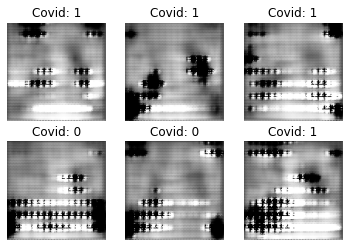

Epoch 102/300 Batch 12/12 [D loss: 1738.44348, acc: 93.75%] [G loss: 67062.82812]
Epoch 103/300 Batch 12/12 [D loss: 623.68756, acc: 93.75%] [G loss: 97286.65625]
Epoch 104/300 Batch 12/12 [D loss: 8661.18315, acc: 81.25%] [G loss: 57181.97656]
Epoch 105/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 93694.08594]
Epoch 106/300 Batch 12/12 [D loss: 2289.55762, acc: 87.50%] [G loss: 72125.50781]
Epoch 107/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 27594.38672]
Epoch 108/300 Batch 12/12 [D loss: 603.07922, acc: 87.50%] [G loss: 14475.62891]
Epoch 109/300 Batch 12/12 [D loss: 2687.79590, acc: 75.00%] [G loss: 57624.36719]
Epoch 110/300 Batch 12/12 [D loss: 3603.29718, acc: 75.00%] [G loss: 26615.56641]
Epoch 111/300 Batch 12/12 [D loss: 2628.70912, acc: 75.00%] [G loss: 32355.45703]
Epoch 112/300 Batch 12/12 [D loss: 1750.21646, acc: 75.00%] [G loss: 43277.25781]
Epoch 113/300 Batch 12/12 [D loss: 1042.99744, acc: 87.50%] [G loss: 37363.86719]
Epoch 114/300 Batch 12

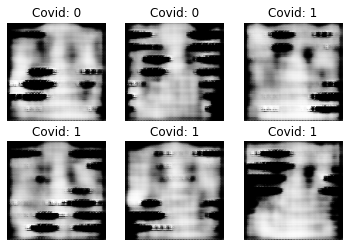

Epoch 122/300 Batch 12/12 [D loss: 921.73041, acc: 93.75%] [G loss: 41088.89844]
Epoch 123/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 37238.41797]
Epoch 124/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 25539.37109]
Epoch 125/300 Batch 12/12 [D loss: 994.49771, acc: 81.25%] [G loss: 25817.94531]
Epoch 126/300 Batch 12/12 [D loss: 1185.61728, acc: 81.25%] [G loss: 28561.84766]
Epoch 127/300 Batch 12/12 [D loss: 2517.28979, acc: 68.75%] [G loss: 20398.34375]
Epoch 128/300 Batch 12/12 [D loss: 666.00720, acc: 81.25%] [G loss: 17578.89062]
Epoch 129/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 37642.39062]
Epoch 130/300 Batch 12/12 [D loss: 1316.69275, acc: 87.50%] [G loss: 30773.95898]
Epoch 131/300 Batch 12/12 [D loss: 62.74412, acc: 93.75%] [G loss: 35794.58984]
Epoch 132/300 Batch 12/12 [D loss: 296.47992, acc: 87.50%] [G loss: 33775.81250]
Epoch 133/300 Batch 12/12 [D loss: 346.07947, acc: 87.50%] [G loss: 25297.24023]
Epoch 134/300 Batch 12/12 [D 

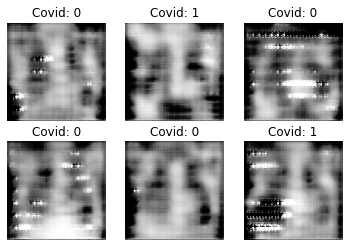

Epoch 142/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 29434.77539]
Epoch 143/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 9820.28320]
Epoch 144/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 19058.11719]
Epoch 145/300 Batch 12/12 [D loss: 462.40070, acc: 87.50%] [G loss: 21078.64453]
Epoch 146/300 Batch 12/12 [D loss: 995.29480, acc: 93.75%] [G loss: 7928.93848]
Epoch 147/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 19257.79492]
Epoch 148/300 Batch 12/12 [D loss: 85.68340, acc: 93.75%] [G loss: 16890.47656]
Epoch 149/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 11995.40039]
Epoch 150/300 Batch 12/12 [D loss: 84.87552, acc: 93.75%] [G loss: 11389.77539]
Epoch 151/300 Batch 12/12 [D loss: 525.21375, acc: 81.25%] [G loss: 11427.84570]
Epoch 152/300 Batch 12/12 [D loss: 901.82086, acc: 87.50%] [G loss: 31104.16797]
Epoch 153/300 Batch 12/12 [D loss: 633.50104, acc: 87.50%] [G loss: 17403.34375]
Epoch 154/300 Batch 12/12 [D loss: 71

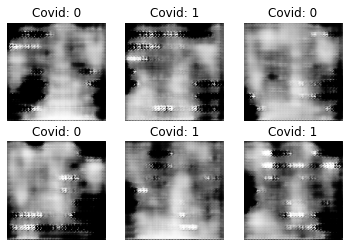

Epoch 162/300 Batch 12/12 [D loss: 61.96677, acc: 93.75%] [G loss: 8610.91406]
Epoch 163/300 Batch 12/12 [D loss: 982.54272, acc: 75.00%] [G loss: 17135.55273]
Epoch 164/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 14759.65137]
Epoch 165/300 Batch 12/12 [D loss: 826.61397, acc: 75.00%] [G loss: 6650.30225]
Epoch 166/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 14517.51855]
Epoch 167/300 Batch 12/12 [D loss: 542.54486, acc: 87.50%] [G loss: 9928.84180]
Epoch 168/300 Batch 12/12 [D loss: 747.69031, acc: 68.75%] [G loss: 9980.83984]
Epoch 169/300 Batch 12/12 [D loss: 1247.73825, acc: 75.00%] [G loss: 6518.06787]
Epoch 170/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 8417.87695]
Epoch 171/300 Batch 12/12 [D loss: 946.22656, acc: 87.50%] [G loss: 11878.79492]
Epoch 172/300 Batch 12/12 [D loss: 998.53882, acc: 81.25%] [G loss: 6713.28320]
Epoch 173/300 Batch 12/12 [D loss: 410.96132, acc: 81.25%] [G loss: 7715.19531]
Epoch 174/300 Batch 12/12 [D loss: 174.

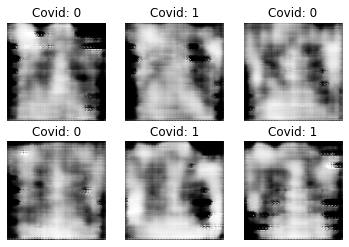

Epoch 182/300 Batch 12/12 [D loss: 131.26730, acc: 93.75%] [G loss: 6531.38672]
Epoch 183/300 Batch 12/12 [D loss: 71.33450, acc: 93.75%] [G loss: 5318.06641]
Epoch 184/300 Batch 12/12 [D loss: 538.59636, acc: 81.25%] [G loss: 5196.78711]
Epoch 185/300 Batch 12/12 [D loss: 462.66617, acc: 87.50%] [G loss: 8254.55273]
Epoch 186/300 Batch 12/12 [D loss: 106.85173, acc: 81.25%] [G loss: 6921.01514]
Epoch 187/300 Batch 12/12 [D loss: 41.63306, acc: 87.50%] [G loss: 10836.88867]
Epoch 188/300 Batch 12/12 [D loss: 603.28120, acc: 87.50%] [G loss: 8492.56641]
Epoch 189/300 Batch 12/12 [D loss: 244.98387, acc: 93.75%] [G loss: 8248.76855]
Epoch 190/300 Batch 12/12 [D loss: 140.66966, acc: 93.75%] [G loss: 9194.39844]
Epoch 191/300 Batch 12/12 [D loss: 186.99467, acc: 93.75%] [G loss: 3805.77002]
Epoch 192/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 5453.78418]
Epoch 193/300 Batch 12/12 [D loss: 186.56532, acc: 87.50%] [G loss: 7768.43115]
Epoch 194/300 Batch 12/12 [D loss: 0.00000

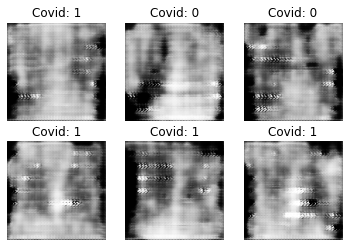

Epoch 202/300 Batch 12/12 [D loss: 1434.90393, acc: 75.00%] [G loss: 6624.48193]
Epoch 203/300 Batch 12/12 [D loss: 843.57697, acc: 68.75%] [G loss: 4824.44189]
Epoch 204/300 Batch 12/12 [D loss: 639.04361, acc: 81.25%] [G loss: 5076.41406]
Epoch 205/300 Batch 12/12 [D loss: 157.31374, acc: 93.75%] [G loss: 9026.04688]
Epoch 206/300 Batch 12/12 [D loss: 657.38637, acc: 75.00%] [G loss: 7518.07812]
Epoch 207/300 Batch 12/12 [D loss: 120.26539, acc: 93.75%] [G loss: 5088.60449]
Epoch 208/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 4732.74316]
Epoch 209/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 4646.65137]
Epoch 210/300 Batch 12/12 [D loss: 240.45474, acc: 93.75%] [G loss: 8958.72070]
Epoch 211/300 Batch 12/12 [D loss: 1422.79132, acc: 62.50%] [G loss: 8553.41406]
Epoch 212/300 Batch 12/12 [D loss: 621.82861, acc: 75.00%] [G loss: 7851.60742]
Epoch 213/300 Batch 12/12 [D loss: 153.22845, acc: 93.75%] [G loss: 8652.65332]
Epoch 214/300 Batch 12/12 [D loss: 218.7

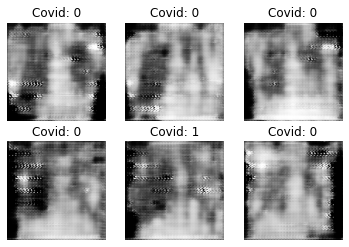

Epoch 222/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 6386.99609]
Epoch 223/300 Batch 12/12 [D loss: 93.65990, acc: 87.50%] [G loss: 6680.53516]
Epoch 224/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 4633.28516]
Epoch 225/300 Batch 12/12 [D loss: 220.67240, acc: 81.25%] [G loss: 3625.06201]
Epoch 226/300 Batch 12/12 [D loss: 139.37877, acc: 93.75%] [G loss: 5636.67480]
Epoch 227/300 Batch 12/12 [D loss: 222.68945, acc: 87.50%] [G loss: 10423.50781]
Epoch 228/300 Batch 12/12 [D loss: 371.44934, acc: 81.25%] [G loss: 5109.78662]
Epoch 229/300 Batch 12/12 [D loss: 356.05393, acc: 81.25%] [G loss: 1925.78564]
Epoch 230/300 Batch 12/12 [D loss: 526.84801, acc: 81.25%] [G loss: 6872.02686]
Epoch 231/300 Batch 12/12 [D loss: 87.79198, acc: 93.75%] [G loss: 4665.88330]
Epoch 232/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 8136.43164]
Epoch 233/300 Batch 12/12 [D loss: 603.39740, acc: 75.00%] [G loss: 6588.95850]
Epoch 234/300 Batch 12/12 [D loss: 237.35638

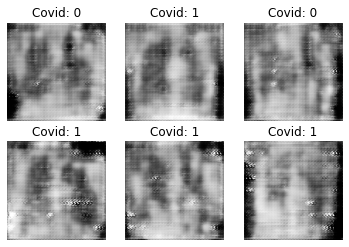

Epoch 242/300 Batch 12/12 [D loss: 258.54938, acc: 81.25%] [G loss: 5657.98438]
Epoch 243/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 5113.30322]
Epoch 244/300 Batch 12/12 [D loss: 266.98969, acc: 87.50%] [G loss: 4879.13477]
Epoch 245/300 Batch 12/12 [D loss: 155.33612, acc: 87.50%] [G loss: 2728.06641]
Epoch 246/300 Batch 12/12 [D loss: 318.53119, acc: 87.50%] [G loss: 3636.66699]
Epoch 247/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 7749.50732]
Epoch 248/300 Batch 12/12 [D loss: 144.31929, acc: 93.75%] [G loss: 15884.85547]
Epoch 249/300 Batch 12/12 [D loss: 466.93190, acc: 68.75%] [G loss: 7953.22363]
Epoch 250/300 Batch 12/12 [D loss: 36727.12402, acc: 31.25%] [G loss: 3605.95874]
Epoch 251/300 Batch 12/12 [D loss: 992.13498, acc: 81.25%] [G loss: 15268.65625]
Epoch 252/300 Batch 12/12 [D loss: 129.43781, acc: 87.50%] [G loss: 7189.90332]
Epoch 253/300 Batch 12/12 [D loss: 1069.68832, acc: 56.25%] [G loss: 4652.69922]
Epoch 254/300 Batch 12/12 [D loss: 53

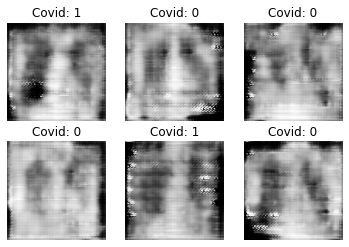

Epoch 262/300 Batch 12/12 [D loss: 115.28110, acc: 81.25%] [G loss: 2802.91162]
Epoch 263/300 Batch 12/12 [D loss: 494.74651, acc: 68.75%] [G loss: 2926.24023]
Epoch 264/300 Batch 12/12 [D loss: 478.12164, acc: 75.00%] [G loss: 1308.89355]
Epoch 265/300 Batch 12/12 [D loss: 136.69943, acc: 87.50%] [G loss: 1884.02026]
Epoch 266/300 Batch 12/12 [D loss: 133.17459, acc: 93.75%] [G loss: 4138.07324]
Epoch 267/300 Batch 12/12 [D loss: 245.52257, acc: 87.50%] [G loss: 3928.44775]
Epoch 268/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 3561.79980]
Epoch 269/300 Batch 12/12 [D loss: 46.58691, acc: 93.75%] [G loss: 5118.31592]
Epoch 270/300 Batch 12/12 [D loss: 61.16107, acc: 93.75%] [G loss: 8463.26562]
Epoch 271/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 4620.58350]
Epoch 272/300 Batch 12/12 [D loss: 206.30832, acc: 81.25%] [G loss: 2640.22070]
Epoch 273/300 Batch 12/12 [D loss: 19.32639, acc: 93.75%] [G loss: 3851.19873]
Epoch 274/300 Batch 12/12 [D loss: 306.14841,

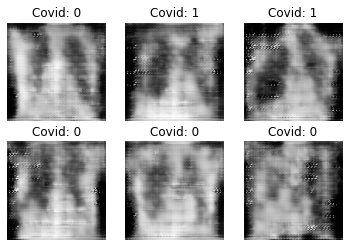

Epoch 282/300 Batch 12/12 [D loss: 50.75891, acc: 87.50%] [G loss: 4694.43604]
Epoch 283/300 Batch 12/12 [D loss: 441.69733, acc: 62.50%] [G loss: 1505.94238]
Epoch 284/300 Batch 12/12 [D loss: 60.60910, acc: 87.50%] [G loss: 2094.33179]
Epoch 285/300 Batch 12/12 [D loss: 1064.80586, acc: 62.50%] [G loss: 4143.40918]
Epoch 286/300 Batch 12/12 [D loss: 286.20963, acc: 87.50%] [G loss: 3278.16309]
Epoch 287/300 Batch 12/12 [D loss: 321.19950, acc: 68.75%] [G loss: 4254.63623]
Epoch 288/300 Batch 12/12 [D loss: 5.75875, acc: 93.75%] [G loss: 2180.35449]
Epoch 289/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 3990.85645]
Epoch 290/300 Batch 12/12 [D loss: 105.89513, acc: 81.25%] [G loss: 2495.79077]
Epoch 291/300 Batch 12/12 [D loss: 27.03626, acc: 93.75%] [G loss: 2109.01514]
Epoch 292/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 3073.94653]
Epoch 293/300 Batch 12/12 [D loss: 0.00000, acc: 100.00%] [G loss: 2325.40210]
Epoch 294/300 Batch 12/12 [D loss: 0.00000, acc

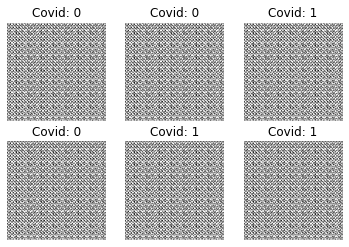

Epoch 2/300 Batch 12/12 [D loss: 0.01002, acc: 100.00%] [G loss: 20.18409]
Epoch 3/300 Batch 12/12 [D loss: 0.00125, acc: 100.00%] [G loss: 8.55501]
Epoch 4/300 Batch 12/12 [D loss: 0.02004, acc: 100.00%] [G loss: 4.46424]
Epoch 5/300 Batch 12/12 [D loss: 0.00464, acc: 100.00%] [G loss: 21.71232]
Epoch 6/300 Batch 12/12 [D loss: 0.03964, acc: 100.00%] [G loss: 6.70421]
Epoch 7/300 Batch 12/12 [D loss: 0.05863, acc: 100.00%] [G loss: 3.04590]
Epoch 8/300 Batch 12/12 [D loss: 0.09459, acc: 93.75%] [G loss: 12.68895]
Epoch 9/300 Batch 12/12 [D loss: 0.17014, acc: 93.75%] [G loss: 5.30070]
Epoch 10/300 Batch 12/12 [D loss: 0.02661, acc: 100.00%] [G loss: 4.90473]
Epoch 11/300 Batch 12/12 [D loss: 0.04374, acc: 100.00%] [G loss: 4.88167]
Epoch 12/300 Batch 12/12 [D loss: 1.90213, acc: 50.00%] [G loss: 8.53692]
Epoch 13/300 Batch 12/12 [D loss: 0.57142, acc: 68.75%] [G loss: 5.59178]
Epoch 14/300 Batch 12/12 [D loss: 0.71666, acc: 68.75%] [G loss: 3.36697]
Epoch 15/300 Batch 12/12 [D loss: 0

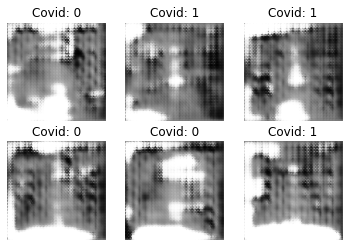

Epoch 22/300 Batch 12/12 [D loss: 0.71869, acc: 68.75%] [G loss: 2.27897]
Epoch 23/300 Batch 12/12 [D loss: 0.22533, acc: 100.00%] [G loss: 1.82787]
Epoch 24/300 Batch 12/12 [D loss: 0.59160, acc: 75.00%] [G loss: 1.88674]
Epoch 25/300 Batch 12/12 [D loss: 0.30084, acc: 81.25%] [G loss: 2.48075]
Epoch 26/300 Batch 12/12 [D loss: 0.35366, acc: 87.50%] [G loss: 2.71402]
Epoch 27/300 Batch 12/12 [D loss: 0.39345, acc: 81.25%] [G loss: 1.84902]
Epoch 28/300 Batch 12/12 [D loss: 0.52896, acc: 75.00%] [G loss: 1.28355]
Epoch 29/300 Batch 12/12 [D loss: 0.21710, acc: 100.00%] [G loss: 2.40066]
Epoch 30/300 Batch 12/12 [D loss: 0.39972, acc: 81.25%] [G loss: 3.74791]
Epoch 31/300 Batch 12/12 [D loss: 0.74778, acc: 50.00%] [G loss: 1.57384]
Epoch 32/300 Batch 12/12 [D loss: 0.65327, acc: 68.75%] [G loss: 1.99712]
Epoch 33/300 Batch 12/12 [D loss: 0.62416, acc: 75.00%] [G loss: 2.88682]
Epoch 34/300 Batch 12/12 [D loss: 0.53857, acc: 75.00%] [G loss: 3.00602]
Epoch 35/300 Batch 12/12 [D loss: 0.

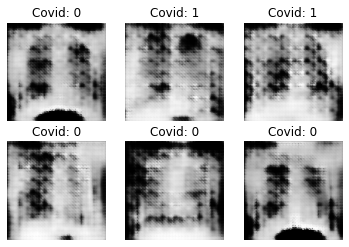

Epoch 42/300 Batch 12/12 [D loss: 0.14928, acc: 100.00%] [G loss: 3.14986]
Epoch 43/300 Batch 12/12 [D loss: 0.98108, acc: 56.25%] [G loss: 4.84829]
Epoch 44/300 Batch 12/12 [D loss: 0.14531, acc: 100.00%] [G loss: 2.32139]
Epoch 45/300 Batch 12/12 [D loss: 0.52880, acc: 62.50%] [G loss: 5.11283]
Epoch 46/300 Batch 12/12 [D loss: 0.29947, acc: 93.75%] [G loss: 2.42996]
Epoch 47/300 Batch 12/12 [D loss: 0.34168, acc: 93.75%] [G loss: 3.47693]
Epoch 48/300 Batch 12/12 [D loss: 0.12011, acc: 93.75%] [G loss: 2.32838]
Epoch 49/300 Batch 12/12 [D loss: 0.40812, acc: 81.25%] [G loss: 3.34320]
Epoch 50/300 Batch 12/12 [D loss: 0.32978, acc: 87.50%] [G loss: 2.54665]
Epoch 51/300 Batch 12/12 [D loss: 0.23125, acc: 87.50%] [G loss: 2.03747]
Epoch 52/300 Batch 12/12 [D loss: 0.53577, acc: 68.75%] [G loss: 1.32081]
Epoch 53/300 Batch 12/12 [D loss: 0.33415, acc: 68.75%] [G loss: 4.27265]
Epoch 54/300 Batch 12/12 [D loss: 0.25753, acc: 93.75%] [G loss: 1.73543]
Epoch 55/300 Batch 12/12 [D loss: 0.

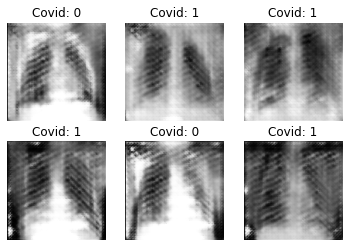

Epoch 62/300 Batch 12/12 [D loss: 0.27523, acc: 87.50%] [G loss: 3.44628]
Epoch 63/300 Batch 12/12 [D loss: 0.40124, acc: 75.00%] [G loss: 3.22177]
Epoch 64/300 Batch 12/12 [D loss: 0.36342, acc: 75.00%] [G loss: 1.97836]
Epoch 65/300 Batch 12/12 [D loss: 0.18353, acc: 93.75%] [G loss: 4.02588]
Epoch 66/300 Batch 12/12 [D loss: 0.41452, acc: 81.25%] [G loss: 3.84980]
Epoch 67/300 Batch 12/12 [D loss: 0.19112, acc: 100.00%] [G loss: 2.48988]
Epoch 68/300 Batch 12/12 [D loss: 0.61838, acc: 62.50%] [G loss: 2.98978]
Epoch 69/300 Batch 12/12 [D loss: 0.38351, acc: 75.00%] [G loss: 2.11058]
Epoch 70/300 Batch 12/12 [D loss: 0.29991, acc: 87.50%] [G loss: 3.43159]
Epoch 71/300 Batch 12/12 [D loss: 0.40850, acc: 68.75%] [G loss: 2.90858]
Epoch 72/300 Batch 12/12 [D loss: 0.58475, acc: 75.00%] [G loss: 3.07026]
Epoch 73/300 Batch 12/12 [D loss: 0.35987, acc: 81.25%] [G loss: 2.52850]
Epoch 74/300 Batch 12/12 [D loss: 0.28063, acc: 87.50%] [G loss: 3.06895]
Epoch 75/300 Batch 12/12 [D loss: 0.1

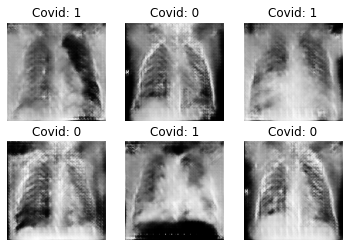

Epoch 82/300 Batch 12/12 [D loss: 0.64841, acc: 75.00%] [G loss: 1.16909]
Epoch 83/300 Batch 12/12 [D loss: 0.23426, acc: 87.50%] [G loss: 3.10277]
Epoch 84/300 Batch 12/12 [D loss: 0.23487, acc: 93.75%] [G loss: 2.10637]
Epoch 85/300 Batch 12/12 [D loss: 0.19872, acc: 93.75%] [G loss: 3.41786]
Epoch 86/300 Batch 12/12 [D loss: 0.84381, acc: 62.50%] [G loss: 5.22491]
Epoch 87/300 Batch 12/12 [D loss: 0.41963, acc: 68.75%] [G loss: 3.36477]
Epoch 88/300 Batch 12/12 [D loss: 0.23841, acc: 93.75%] [G loss: 3.38786]
Epoch 89/300 Batch 12/12 [D loss: 0.21415, acc: 100.00%] [G loss: 3.44922]
Epoch 90/300 Batch 12/12 [D loss: 0.25752, acc: 93.75%] [G loss: 4.23126]
Epoch 91/300 Batch 12/12 [D loss: 0.34536, acc: 81.25%] [G loss: 3.29631]
Epoch 92/300 Batch 12/12 [D loss: 0.42543, acc: 68.75%] [G loss: 2.39758]
Epoch 93/300 Batch 12/12 [D loss: 0.21083, acc: 100.00%] [G loss: 2.70549]
Epoch 94/300 Batch 12/12 [D loss: 0.33465, acc: 81.25%] [G loss: 2.19029]
Epoch 95/300 Batch 12/12 [D loss: 0.

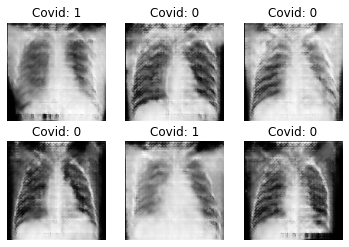

Epoch 102/300 Batch 12/12 [D loss: 0.24491, acc: 87.50%] [G loss: 4.30613]
Epoch 103/300 Batch 12/12 [D loss: 0.41896, acc: 87.50%] [G loss: 3.44780]
Epoch 104/300 Batch 12/12 [D loss: 0.21193, acc: 93.75%] [G loss: 2.86600]
Epoch 105/300 Batch 12/12 [D loss: 0.58902, acc: 68.75%] [G loss: 2.24570]
Epoch 106/300 Batch 12/12 [D loss: 0.33161, acc: 93.75%] [G loss: 2.98521]
Epoch 107/300 Batch 12/12 [D loss: 0.64295, acc: 68.75%] [G loss: 6.65207]
Epoch 108/300 Batch 12/12 [D loss: 0.25469, acc: 87.50%] [G loss: 3.30116]
Epoch 109/300 Batch 12/12 [D loss: 0.15452, acc: 100.00%] [G loss: 3.32619]
Epoch 110/300 Batch 12/12 [D loss: 0.08875, acc: 100.00%] [G loss: 3.70523]
Epoch 111/300 Batch 12/12 [D loss: 0.15608, acc: 93.75%] [G loss: 3.08613]
Epoch 112/300 Batch 12/12 [D loss: 0.29752, acc: 87.50%] [G loss: 3.47065]
Epoch 113/300 Batch 12/12 [D loss: 0.28557, acc: 93.75%] [G loss: 2.39224]
Epoch 114/300 Batch 12/12 [D loss: 0.19636, acc: 93.75%] [G loss: 4.32518]
Epoch 115/300 Batch 12/

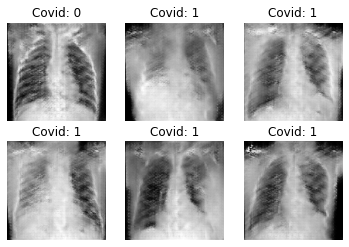

Epoch 122/300 Batch 12/12 [D loss: 0.11585, acc: 100.00%] [G loss: 3.17615]
Epoch 123/300 Batch 12/12 [D loss: 0.19856, acc: 93.75%] [G loss: 3.84963]
Epoch 124/300 Batch 12/12 [D loss: 0.27845, acc: 87.50%] [G loss: 2.39538]
Epoch 125/300 Batch 12/12 [D loss: 0.45221, acc: 81.25%] [G loss: 7.62758]
Epoch 126/300 Batch 12/12 [D loss: 0.38642, acc: 81.25%] [G loss: 3.07101]
Epoch 127/300 Batch 12/12 [D loss: 0.40749, acc: 87.50%] [G loss: 3.18247]
Epoch 128/300 Batch 12/12 [D loss: 0.24237, acc: 93.75%] [G loss: 3.40157]
Epoch 129/300 Batch 12/12 [D loss: 0.32857, acc: 87.50%] [G loss: 2.37543]
Epoch 130/300 Batch 12/12 [D loss: 0.15769, acc: 100.00%] [G loss: 3.63125]
Epoch 131/300 Batch 12/12 [D loss: 0.49499, acc: 62.50%] [G loss: 4.31351]
Epoch 132/300 Batch 12/12 [D loss: 0.27535, acc: 81.25%] [G loss: 4.71321]
Epoch 133/300 Batch 12/12 [D loss: 0.20783, acc: 93.75%] [G loss: 3.57210]
Epoch 134/300 Batch 12/12 [D loss: 0.13049, acc: 100.00%] [G loss: 2.95174]
Epoch 135/300 Batch 12

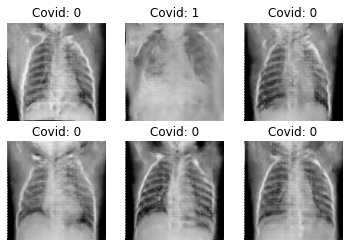

Epoch 142/300 Batch 12/12 [D loss: 0.12077, acc: 93.75%] [G loss: 3.51134]
Epoch 143/300 Batch 12/12 [D loss: 0.24787, acc: 93.75%] [G loss: 3.43207]
Epoch 144/300 Batch 12/12 [D loss: 0.52409, acc: 75.00%] [G loss: 3.65346]
Epoch 145/300 Batch 12/12 [D loss: 0.11723, acc: 100.00%] [G loss: 3.61006]
Epoch 146/300 Batch 12/12 [D loss: 0.20163, acc: 93.75%] [G loss: 3.52980]
Epoch 147/300 Batch 12/12 [D loss: 0.27562, acc: 87.50%] [G loss: 3.96551]
Epoch 148/300 Batch 12/12 [D loss: 0.48499, acc: 75.00%] [G loss: 3.03632]
Epoch 149/300 Batch 12/12 [D loss: 0.06297, acc: 100.00%] [G loss: 3.54504]
Epoch 150/300 Batch 12/12 [D loss: 0.26651, acc: 87.50%] [G loss: 4.91717]
Epoch 151/300 Batch 12/12 [D loss: 0.23543, acc: 93.75%] [G loss: 2.75362]
Epoch 152/300 Batch 12/12 [D loss: 0.23627, acc: 87.50%] [G loss: 3.97364]
Epoch 153/300 Batch 12/12 [D loss: 0.13450, acc: 100.00%] [G loss: 3.27507]
Epoch 154/300 Batch 12/12 [D loss: 0.68405, acc: 75.00%] [G loss: 3.88201]
Epoch 155/300 Batch 12

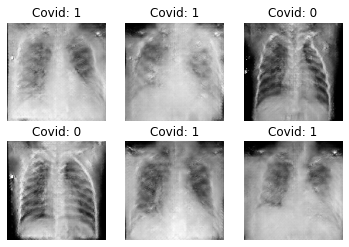

Epoch 162/300 Batch 12/12 [D loss: 0.24811, acc: 93.75%] [G loss: 3.10262]
Epoch 163/300 Batch 12/12 [D loss: 0.38043, acc: 81.25%] [G loss: 4.02248]
Epoch 164/300 Batch 12/12 [D loss: 0.04684, acc: 100.00%] [G loss: 4.67441]
Epoch 165/300 Batch 12/12 [D loss: 0.21787, acc: 87.50%] [G loss: 4.21060]
Epoch 166/300 Batch 12/12 [D loss: 0.24758, acc: 87.50%] [G loss: 4.19406]
Epoch 167/300 Batch 12/12 [D loss: 0.46561, acc: 81.25%] [G loss: 4.58196]
Epoch 168/300 Batch 12/12 [D loss: 0.19653, acc: 93.75%] [G loss: 3.08749]
Epoch 169/300 Batch 12/12 [D loss: 0.18832, acc: 93.75%] [G loss: 3.28115]
Epoch 170/300 Batch 12/12 [D loss: 0.14931, acc: 93.75%] [G loss: 3.78963]
Epoch 171/300 Batch 12/12 [D loss: 0.52171, acc: 87.50%] [G loss: 3.39544]
Epoch 172/300 Batch 12/12 [D loss: 0.21460, acc: 93.75%] [G loss: 3.95362]
Epoch 173/300 Batch 12/12 [D loss: 0.09792, acc: 100.00%] [G loss: 4.38083]
Epoch 174/300 Batch 12/12 [D loss: 0.13280, acc: 93.75%] [G loss: 3.84321]
Epoch 175/300 Batch 12/

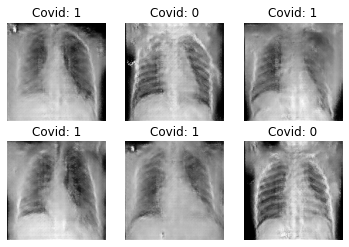

Epoch 182/300 Batch 12/12 [D loss: 0.32115, acc: 81.25%] [G loss: 3.16380]
Epoch 183/300 Batch 12/12 [D loss: 0.14131, acc: 100.00%] [G loss: 4.08006]
Epoch 184/300 Batch 12/12 [D loss: 0.13176, acc: 93.75%] [G loss: 3.84667]
Epoch 185/300 Batch 12/12 [D loss: 0.12721, acc: 100.00%] [G loss: 3.96333]
Epoch 186/300 Batch 12/12 [D loss: 0.05309, acc: 100.00%] [G loss: 3.45996]
Epoch 187/300 Batch 12/12 [D loss: 0.05953, acc: 100.00%] [G loss: 3.85415]
Epoch 188/300 Batch 12/12 [D loss: 0.11975, acc: 100.00%] [G loss: 3.49363]
Epoch 189/300 Batch 12/12 [D loss: 0.22444, acc: 87.50%] [G loss: 6.59649]
Epoch 190/300 Batch 12/12 [D loss: 0.10607, acc: 93.75%] [G loss: 5.95777]
Epoch 191/300 Batch 12/12 [D loss: 0.10784, acc: 100.00%] [G loss: 3.56924]
Epoch 192/300 Batch 12/12 [D loss: 0.14443, acc: 93.75%] [G loss: 3.67563]
Epoch 193/300 Batch 12/12 [D loss: 0.19605, acc: 93.75%] [G loss: 3.84728]
Epoch 194/300 Batch 12/12 [D loss: 0.14548, acc: 100.00%] [G loss: 2.51179]
Epoch 195/300 Batc

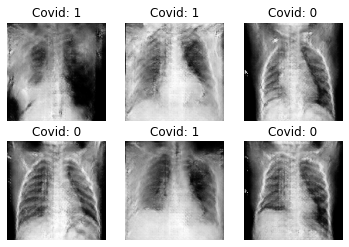

Epoch 202/300 Batch 12/12 [D loss: 0.19881, acc: 93.75%] [G loss: 4.32717]
Epoch 203/300 Batch 12/12 [D loss: 0.11281, acc: 100.00%] [G loss: 4.43499]
Epoch 204/300 Batch 12/12 [D loss: 0.05147, acc: 100.00%] [G loss: 3.46680]
Epoch 205/300 Batch 12/12 [D loss: 0.20619, acc: 93.75%] [G loss: 3.46651]
Epoch 206/300 Batch 12/12 [D loss: 0.22820, acc: 87.50%] [G loss: 4.88797]
Epoch 207/300 Batch 12/12 [D loss: 0.20848, acc: 93.75%] [G loss: 4.55262]
Epoch 208/300 Batch 12/12 [D loss: 0.03191, acc: 100.00%] [G loss: 3.88972]
Epoch 209/300 Batch 12/12 [D loss: 0.11725, acc: 93.75%] [G loss: 4.92924]
Epoch 210/300 Batch 12/12 [D loss: 0.15992, acc: 87.50%] [G loss: 6.15838]
Epoch 211/300 Batch 12/12 [D loss: 0.04631, acc: 100.00%] [G loss: 5.83061]
Epoch 212/300 Batch 12/12 [D loss: 0.10118, acc: 100.00%] [G loss: 3.58172]
Epoch 213/300 Batch 12/12 [D loss: 0.50360, acc: 87.50%] [G loss: 6.13660]
Epoch 214/300 Batch 12/12 [D loss: 0.01982, acc: 100.00%] [G loss: 8.17398]
Epoch 215/300 Batch

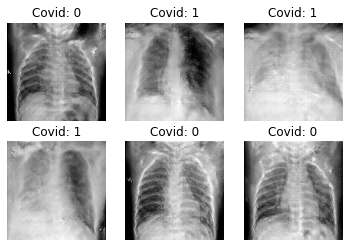

Epoch 222/300 Batch 12/12 [D loss: 0.12970, acc: 100.00%] [G loss: 3.94224]
Epoch 223/300 Batch 12/12 [D loss: 0.04648, acc: 100.00%] [G loss: 5.43999]
Epoch 224/300 Batch 12/12 [D loss: 0.01767, acc: 100.00%] [G loss: 6.94525]
Epoch 225/300 Batch 12/12 [D loss: 0.23635, acc: 87.50%] [G loss: 7.56308]
Epoch 226/300 Batch 12/12 [D loss: 0.10311, acc: 100.00%] [G loss: 5.37957]
Epoch 227/300 Batch 12/12 [D loss: 0.10007, acc: 100.00%] [G loss: 4.88156]
Epoch 228/300 Batch 12/12 [D loss: 0.28696, acc: 81.25%] [G loss: 11.20429]
Epoch 229/300 Batch 12/12 [D loss: 0.10547, acc: 100.00%] [G loss: 5.74498]
Epoch 230/300 Batch 12/12 [D loss: 0.59645, acc: 81.25%] [G loss: 9.55816]
Epoch 231/300 Batch 12/12 [D loss: 0.19726, acc: 93.75%] [G loss: 7.89610]
Epoch 232/300 Batch 12/12 [D loss: 0.31945, acc: 87.50%] [G loss: 6.02852]
Epoch 233/300 Batch 12/12 [D loss: 0.34241, acc: 81.25%] [G loss: 9.66718]
Epoch 234/300 Batch 12/12 [D loss: 0.16809, acc: 93.75%] [G loss: 4.96510]
Epoch 235/300 Batc

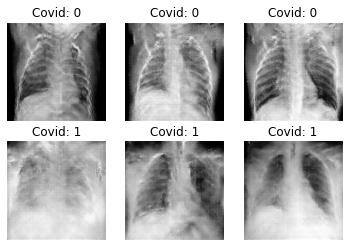

Epoch 242/300 Batch 12/12 [D loss: 0.07496, acc: 93.75%] [G loss: 2.86980]
Epoch 243/300 Batch 12/12 [D loss: 0.04456, acc: 100.00%] [G loss: 5.22827]
Epoch 244/300 Batch 12/12 [D loss: 0.12245, acc: 93.75%] [G loss: 3.19256]
Epoch 245/300 Batch 12/12 [D loss: 0.02171, acc: 100.00%] [G loss: 5.47340]
Epoch 246/300 Batch 12/12 [D loss: 0.03383, acc: 100.00%] [G loss: 2.80110]
Epoch 247/300 Batch 12/12 [D loss: 0.02245, acc: 100.00%] [G loss: 6.09901]
Epoch 248/300 Batch 12/12 [D loss: 0.09608, acc: 93.75%] [G loss: 4.10073]
Epoch 249/300 Batch 12/12 [D loss: 0.07833, acc: 93.75%] [G loss: 5.47554]
Epoch 250/300 Batch 12/12 [D loss: 0.00445, acc: 100.00%] [G loss: 7.16624]
Epoch 251/300 Batch 12/12 [D loss: 0.01527, acc: 100.00%] [G loss: 5.27818]
Epoch 252/300 Batch 12/12 [D loss: 0.00616, acc: 100.00%] [G loss: 10.30028]
Epoch 253/300 Batch 12/12 [D loss: 0.03708, acc: 100.00%] [G loss: 6.57848]
Epoch 254/300 Batch 12/12 [D loss: 0.07627, acc: 93.75%] [G loss: 3.95616]
Epoch 255/300 Ba

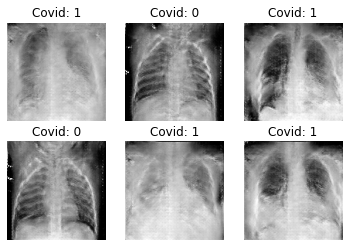

Epoch 262/300 Batch 12/12 [D loss: 0.07516, acc: 100.00%] [G loss: 5.02986]
Epoch 263/300 Batch 12/12 [D loss: 0.02122, acc: 100.00%] [G loss: 6.49411]
Epoch 264/300 Batch 12/12 [D loss: 0.16373, acc: 93.75%] [G loss: 6.50631]
Epoch 265/300 Batch 12/12 [D loss: 0.09411, acc: 93.75%] [G loss: 6.26489]
Epoch 266/300 Batch 12/12 [D loss: 0.01553, acc: 100.00%] [G loss: 5.93609]
Epoch 267/300 Batch 12/12 [D loss: 0.10041, acc: 100.00%] [G loss: 5.19384]
Epoch 268/300 Batch 12/12 [D loss: 0.65348, acc: 75.00%] [G loss: 10.96302]
Epoch 269/300 Batch 12/12 [D loss: 0.29007, acc: 87.50%] [G loss: 9.35589]
Epoch 270/300 Batch 12/12 [D loss: 0.04187, acc: 100.00%] [G loss: 5.81956]
Epoch 271/300 Batch 12/12 [D loss: 0.07454, acc: 93.75%] [G loss: 7.17809]
Epoch 272/300 Batch 12/12 [D loss: 0.35579, acc: 81.25%] [G loss: 5.28416]
Epoch 273/300 Batch 12/12 [D loss: 0.02514, acc: 100.00%] [G loss: 9.66751]
Epoch 274/300 Batch 12/12 [D loss: 0.06056, acc: 100.00%] [G loss: 6.85142]
Epoch 275/300 Bat

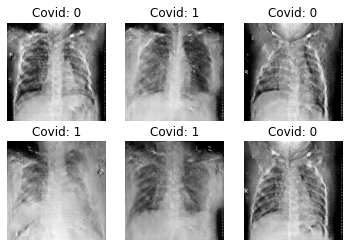

Epoch 282/300 Batch 12/12 [D loss: 0.32737, acc: 87.50%] [G loss: 3.98416]
Epoch 283/300 Batch 12/12 [D loss: 0.06020, acc: 100.00%] [G loss: 8.93698]
Epoch 284/300 Batch 12/12 [D loss: 0.42952, acc: 81.25%] [G loss: 7.28833]
Epoch 285/300 Batch 12/12 [D loss: 0.11123, acc: 93.75%] [G loss: 3.36596]
Epoch 286/300 Batch 12/12 [D loss: 0.22273, acc: 93.75%] [G loss: 15.38348]
Epoch 287/300 Batch 12/12 [D loss: 0.42179, acc: 81.25%] [G loss: 11.04037]
Epoch 288/300 Batch 12/12 [D loss: 0.03362, acc: 100.00%] [G loss: 7.62885]
Epoch 289/300 Batch 12/12 [D loss: 0.01874, acc: 100.00%] [G loss: 5.51811]
Epoch 290/300 Batch 12/12 [D loss: 0.09653, acc: 93.75%] [G loss: 3.71335]
Epoch 291/300 Batch 12/12 [D loss: 0.00973, acc: 100.00%] [G loss: 4.68710]
Epoch 292/300 Batch 12/12 [D loss: 0.10310, acc: 100.00%] [G loss: 5.86491]
Epoch 293/300 Batch 12/12 [D loss: 0.01971, acc: 100.00%] [G loss: 8.46669]
Epoch 294/300 Batch 12/12 [D loss: 0.02968, acc: 100.00%] [G loss: 5.74053]
Epoch 295/300 Ba

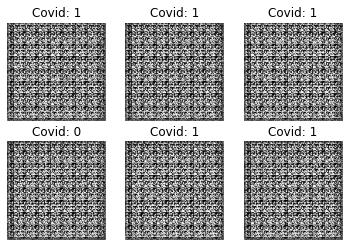

Epoch 2/300 Batch 12/12 [D loss: 0.14984, acc: 93.75%] [G loss: 3.19751]
Epoch 3/300 Batch 12/12 [D loss: 0.31430, acc: 100.00%] [G loss: 2.44284]
Epoch 4/300 Batch 12/12 [D loss: 0.45254, acc: 81.25%] [G loss: 3.99685]
Epoch 5/300 Batch 12/12 [D loss: 0.47068, acc: 75.00%] [G loss: 0.99799]
Epoch 6/300 Batch 12/12 [D loss: 0.62424, acc: 62.50%] [G loss: 2.13451]
Epoch 7/300 Batch 12/12 [D loss: 0.40335, acc: 100.00%] [G loss: 1.55936]
Epoch 8/300 Batch 12/12 [D loss: 0.67733, acc: 56.25%] [G loss: 1.13844]
Epoch 9/300 Batch 12/12 [D loss: 0.99556, acc: 25.00%] [G loss: 0.64380]
Epoch 10/300 Batch 12/12 [D loss: 0.65961, acc: 56.25%] [G loss: 0.65964]
Epoch 11/300 Batch 12/12 [D loss: 0.63357, acc: 75.00%] [G loss: 0.73642]
Epoch 12/300 Batch 12/12 [D loss: 0.70545, acc: 43.75%] [G loss: 0.63629]
Epoch 13/300 Batch 12/12 [D loss: 0.60478, acc: 81.25%] [G loss: 0.95543]
Epoch 14/300 Batch 12/12 [D loss: 0.59469, acc: 62.50%] [G loss: 0.80726]
Epoch 15/300 Batch 12/12 [D loss: 0.68778, a

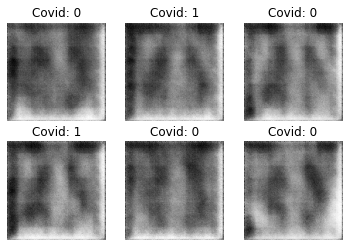

Epoch 22/300 Batch 12/12 [D loss: 0.55800, acc: 56.25%] [G loss: 0.73574]
Epoch 23/300 Batch 12/12 [D loss: 0.55025, acc: 62.50%] [G loss: 0.68115]
Epoch 24/300 Batch 12/12 [D loss: 0.83266, acc: 25.00%] [G loss: 0.53634]
Epoch 25/300 Batch 12/12 [D loss: 0.72311, acc: 56.25%] [G loss: 0.68426]
Epoch 26/300 Batch 12/12 [D loss: 0.67264, acc: 68.75%] [G loss: 0.77707]
Epoch 27/300 Batch 12/12 [D loss: 0.70797, acc: 43.75%] [G loss: 0.66672]
Epoch 28/300 Batch 12/12 [D loss: 0.71131, acc: 43.75%] [G loss: 0.59883]
Epoch 29/300 Batch 12/12 [D loss: 0.70630, acc: 56.25%] [G loss: 0.66746]
Epoch 30/300 Batch 12/12 [D loss: 0.72279, acc: 37.50%] [G loss: 0.70052]
Epoch 31/300 Batch 12/12 [D loss: 0.65511, acc: 43.75%] [G loss: 0.64218]
Epoch 32/300 Batch 12/12 [D loss: 0.67278, acc: 43.75%] [G loss: 0.64840]
Epoch 33/300 Batch 12/12 [D loss: 0.64715, acc: 56.25%] [G loss: 0.63551]
Epoch 34/300 Batch 12/12 [D loss: 0.61533, acc: 68.75%] [G loss: 0.66437]
Epoch 35/300 Batch 12/12 [D loss: 0.65

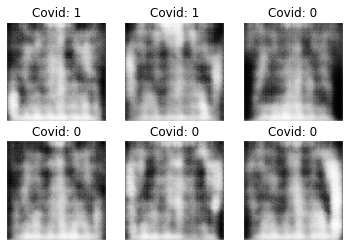

Epoch 42/300 Batch 12/12 [D loss: 0.64071, acc: 62.50%] [G loss: 0.77132]
Epoch 43/300 Batch 12/12 [D loss: 0.57617, acc: 81.25%] [G loss: 0.70064]
Epoch 44/300 Batch 12/12 [D loss: 0.69665, acc: 37.50%] [G loss: 0.68006]
Epoch 45/300 Batch 12/12 [D loss: 0.58030, acc: 87.50%] [G loss: 0.83653]
Epoch 46/300 Batch 12/12 [D loss: 0.68819, acc: 56.25%] [G loss: 0.67894]
Epoch 47/300 Batch 12/12 [D loss: 0.67487, acc: 56.25%] [G loss: 0.87322]
Epoch 48/300 Batch 12/12 [D loss: 0.61579, acc: 75.00%] [G loss: 0.76162]
Epoch 49/300 Batch 12/12 [D loss: 0.60612, acc: 75.00%] [G loss: 0.72248]
Epoch 50/300 Batch 12/12 [D loss: 0.64262, acc: 81.25%] [G loss: 0.78041]
Epoch 51/300 Batch 12/12 [D loss: 0.63385, acc: 81.25%] [G loss: 0.78026]
Epoch 52/300 Batch 12/12 [D loss: 0.62755, acc: 68.75%] [G loss: 0.69598]
Epoch 53/300 Batch 12/12 [D loss: 0.60049, acc: 68.75%] [G loss: 0.74916]
Epoch 54/300 Batch 12/12 [D loss: 0.63636, acc: 68.75%] [G loss: 0.74883]
Epoch 55/300 Batch 12/12 [D loss: 0.64

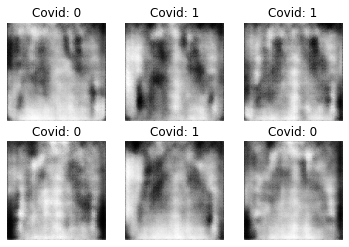

Epoch 62/300 Batch 12/12 [D loss: 0.65428, acc: 62.50%] [G loss: 0.76999]
Epoch 63/300 Batch 12/12 [D loss: 0.63854, acc: 75.00%] [G loss: 0.71040]
Epoch 64/300 Batch 12/12 [D loss: 0.55297, acc: 87.50%] [G loss: 0.99937]
Epoch 65/300 Batch 12/12 [D loss: 0.71168, acc: 43.75%] [G loss: 0.86368]
Epoch 66/300 Batch 12/12 [D loss: 0.58822, acc: 81.25%] [G loss: 0.92276]
Epoch 67/300 Batch 12/12 [D loss: 0.55324, acc: 62.50%] [G loss: 1.03201]
Epoch 68/300 Batch 12/12 [D loss: 0.63295, acc: 68.75%] [G loss: 0.86397]
Epoch 69/300 Batch 12/12 [D loss: 0.43895, acc: 81.25%] [G loss: 1.03060]
Epoch 70/300 Batch 12/12 [D loss: 0.48039, acc: 87.50%] [G loss: 0.94393]
Epoch 71/300 Batch 12/12 [D loss: 0.31838, acc: 100.00%] [G loss: 1.44519]
Epoch 72/300 Batch 12/12 [D loss: 0.29315, acc: 100.00%] [G loss: 1.08391]
Epoch 73/300 Batch 12/12 [D loss: 0.49072, acc: 75.00%] [G loss: 1.18474]
Epoch 74/300 Batch 12/12 [D loss: 0.45326, acc: 87.50%] [G loss: 1.42752]
Epoch 75/300 Batch 12/12 [D loss: 0.

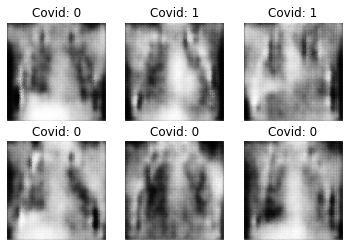

Epoch 82/300 Batch 12/12 [D loss: 0.42474, acc: 93.75%] [G loss: 1.31051]
Epoch 83/300 Batch 12/12 [D loss: 0.47480, acc: 75.00%] [G loss: 1.30794]
Epoch 84/300 Batch 12/12 [D loss: 0.69467, acc: 75.00%] [G loss: 0.82840]
Epoch 85/300 Batch 12/12 [D loss: 0.48086, acc: 68.75%] [G loss: 1.04260]
Epoch 86/300 Batch 12/12 [D loss: 0.59617, acc: 75.00%] [G loss: 0.73006]
Epoch 87/300 Batch 12/12 [D loss: 0.84669, acc: 37.50%] [G loss: 0.71288]
Epoch 88/300 Batch 12/12 [D loss: 0.64407, acc: 56.25%] [G loss: 0.72112]
Epoch 89/300 Batch 12/12 [D loss: 0.62941, acc: 56.25%] [G loss: 0.85310]
Epoch 90/300 Batch 12/12 [D loss: 0.61090, acc: 68.75%] [G loss: 0.80866]
Epoch 91/300 Batch 12/12 [D loss: 0.68187, acc: 50.00%] [G loss: 0.78813]
Epoch 92/300 Batch 12/12 [D loss: 0.62300, acc: 62.50%] [G loss: 0.86977]
Epoch 93/300 Batch 12/12 [D loss: 0.52943, acc: 81.25%] [G loss: 0.97222]
Epoch 94/300 Batch 12/12 [D loss: 0.55458, acc: 62.50%] [G loss: 0.75703]
Epoch 95/300 Batch 12/12 [D loss: 0.56

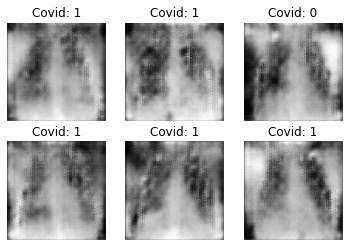

Epoch 102/300 Batch 12/12 [D loss: 0.60442, acc: 75.00%] [G loss: 1.00549]
Epoch 103/300 Batch 12/12 [D loss: 0.57962, acc: 68.75%] [G loss: 0.92401]
Epoch 104/300 Batch 12/12 [D loss: 0.47550, acc: 87.50%] [G loss: 1.10723]
Epoch 105/300 Batch 12/12 [D loss: 0.46039, acc: 87.50%] [G loss: 0.98857]
Epoch 106/300 Batch 12/12 [D loss: 0.49676, acc: 81.25%] [G loss: 1.17424]
Epoch 107/300 Batch 12/12 [D loss: 0.56191, acc: 75.00%] [G loss: 1.08710]
Epoch 108/300 Batch 12/12 [D loss: 0.51543, acc: 75.00%] [G loss: 1.01799]
Epoch 109/300 Batch 12/12 [D loss: 0.54665, acc: 75.00%] [G loss: 0.99048]
Epoch 110/300 Batch 12/12 [D loss: 0.45490, acc: 75.00%] [G loss: 1.20211]
Epoch 111/300 Batch 12/12 [D loss: 0.42250, acc: 87.50%] [G loss: 1.14051]
Epoch 112/300 Batch 12/12 [D loss: 0.63673, acc: 62.50%] [G loss: 0.97754]
Epoch 113/300 Batch 12/12 [D loss: 0.48825, acc: 75.00%] [G loss: 1.28453]
Epoch 114/300 Batch 12/12 [D loss: 0.57367, acc: 62.50%] [G loss: 1.44208]
Epoch 115/300 Batch 12/12

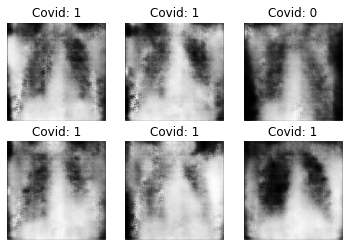

Epoch 122/300 Batch 12/12 [D loss: 0.44777, acc: 87.50%] [G loss: 1.48800]
Epoch 123/300 Batch 12/12 [D loss: 0.43477, acc: 93.75%] [G loss: 1.38585]
Epoch 124/300 Batch 12/12 [D loss: 0.50089, acc: 75.00%] [G loss: 1.16189]
Epoch 125/300 Batch 12/12 [D loss: 0.49586, acc: 75.00%] [G loss: 1.03537]
Epoch 126/300 Batch 12/12 [D loss: 0.50293, acc: 81.25%] [G loss: 1.19250]
Epoch 127/300 Batch 12/12 [D loss: 0.55147, acc: 75.00%] [G loss: 1.17424]
Epoch 128/300 Batch 12/12 [D loss: 0.64565, acc: 62.50%] [G loss: 0.97147]
Epoch 129/300 Batch 12/12 [D loss: 0.75583, acc: 43.75%] [G loss: 1.26763]
Epoch 130/300 Batch 12/12 [D loss: 0.35417, acc: 87.50%] [G loss: 1.56815]
Epoch 131/300 Batch 12/12 [D loss: 0.27169, acc: 100.00%] [G loss: 1.29987]
Epoch 132/300 Batch 12/12 [D loss: 0.58880, acc: 81.25%] [G loss: 1.47965]
Epoch 133/300 Batch 12/12 [D loss: 0.45354, acc: 87.50%] [G loss: 1.31561]
Epoch 134/300 Batch 12/12 [D loss: 0.46152, acc: 81.25%] [G loss: 1.25174]
Epoch 135/300 Batch 12/1

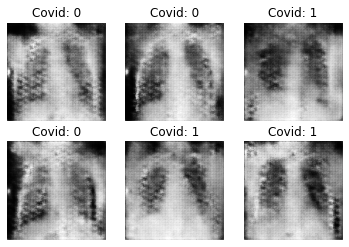

Epoch 142/300 Batch 12/12 [D loss: 0.38135, acc: 100.00%] [G loss: 1.20215]
Epoch 143/300 Batch 12/12 [D loss: 0.55339, acc: 68.75%] [G loss: 1.07409]
Epoch 144/300 Batch 12/12 [D loss: 0.49318, acc: 81.25%] [G loss: 1.13833]
Epoch 145/300 Batch 12/12 [D loss: 0.34591, acc: 93.75%] [G loss: 1.36537]
Epoch 146/300 Batch 12/12 [D loss: 0.67333, acc: 56.25%] [G loss: 1.07044]
Epoch 147/300 Batch 12/12 [D loss: 0.55555, acc: 75.00%] [G loss: 1.04852]
Epoch 148/300 Batch 12/12 [D loss: 0.47864, acc: 75.00%] [G loss: 1.20208]
Epoch 149/300 Batch 12/12 [D loss: 0.36052, acc: 81.25%] [G loss: 1.39664]
Epoch 150/300 Batch 12/12 [D loss: 0.73833, acc: 43.75%] [G loss: 1.14782]
Epoch 151/300 Batch 12/12 [D loss: 0.51886, acc: 81.25%] [G loss: 1.04792]
Epoch 152/300 Batch 12/12 [D loss: 0.51034, acc: 81.25%] [G loss: 1.07996]
Epoch 153/300 Batch 12/12 [D loss: 0.53219, acc: 81.25%] [G loss: 1.07930]
Epoch 154/300 Batch 12/12 [D loss: 0.80781, acc: 43.75%] [G loss: 0.95687]
Epoch 155/300 Batch 12/1

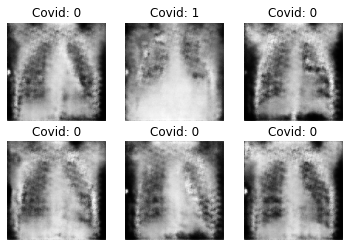

Epoch 162/300 Batch 12/12 [D loss: 0.61101, acc: 75.00%] [G loss: 0.94554]
Epoch 163/300 Batch 12/12 [D loss: 0.50852, acc: 81.25%] [G loss: 1.23861]
Epoch 164/300 Batch 12/12 [D loss: 0.53521, acc: 75.00%] [G loss: 0.94980]
Epoch 165/300 Batch 12/12 [D loss: 0.57907, acc: 68.75%] [G loss: 0.98692]
Epoch 166/300 Batch 12/12 [D loss: 0.52453, acc: 81.25%] [G loss: 1.21049]
Epoch 167/300 Batch 12/12 [D loss: 0.50048, acc: 81.25%] [G loss: 1.08300]
Epoch 168/300 Batch 12/12 [D loss: 0.64600, acc: 68.75%] [G loss: 1.15659]
Epoch 169/300 Batch 12/12 [D loss: 0.70121, acc: 50.00%] [G loss: 1.09622]
Epoch 170/300 Batch 12/12 [D loss: 0.53665, acc: 87.50%] [G loss: 0.97137]
Epoch 171/300 Batch 12/12 [D loss: 0.61123, acc: 62.50%] [G loss: 1.02851]
Epoch 172/300 Batch 12/12 [D loss: 0.59755, acc: 75.00%] [G loss: 1.03055]
Epoch 173/300 Batch 12/12 [D loss: 0.63971, acc: 56.25%] [G loss: 0.83739]
Epoch 174/300 Batch 12/12 [D loss: 0.54690, acc: 81.25%] [G loss: 0.97545]
Epoch 175/300 Batch 12/12

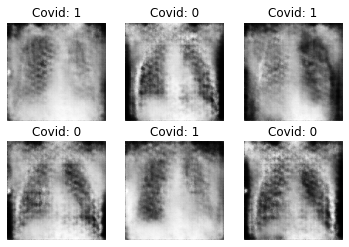

Epoch 182/300 Batch 12/12 [D loss: 0.61660, acc: 75.00%] [G loss: 0.77910]
Epoch 183/300 Batch 12/12 [D loss: 0.56860, acc: 68.75%] [G loss: 0.93375]
Epoch 184/300 Batch 12/12 [D loss: 0.58883, acc: 68.75%] [G loss: 0.97704]
Epoch 185/300 Batch 12/12 [D loss: 0.57317, acc: 81.25%] [G loss: 1.00852]
Epoch 186/300 Batch 12/12 [D loss: 0.58704, acc: 62.50%] [G loss: 0.99060]
Epoch 187/300 Batch 12/12 [D loss: 0.55583, acc: 68.75%] [G loss: 1.05177]
Epoch 188/300 Batch 12/12 [D loss: 0.60611, acc: 68.75%] [G loss: 1.05228]
Epoch 189/300 Batch 12/12 [D loss: 0.60939, acc: 75.00%] [G loss: 0.86637]
Epoch 190/300 Batch 12/12 [D loss: 0.51201, acc: 81.25%] [G loss: 1.14920]
Epoch 191/300 Batch 12/12 [D loss: 0.65502, acc: 68.75%] [G loss: 0.93215]
Epoch 192/300 Batch 12/12 [D loss: 0.66918, acc: 56.25%] [G loss: 0.88491]
Epoch 193/300 Batch 12/12 [D loss: 0.64635, acc: 75.00%] [G loss: 0.79768]
Epoch 194/300 Batch 12/12 [D loss: 0.64067, acc: 68.75%] [G loss: 0.96494]
Epoch 195/300 Batch 12/12

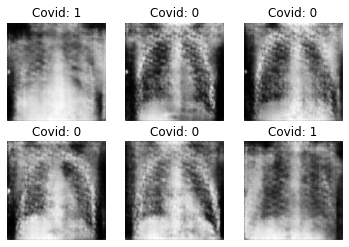

Epoch 202/300 Batch 12/12 [D loss: 0.57046, acc: 81.25%] [G loss: 1.02880]
Epoch 203/300 Batch 12/12 [D loss: 0.65695, acc: 62.50%] [G loss: 0.84632]
Epoch 204/300 Batch 12/12 [D loss: 0.53889, acc: 75.00%] [G loss: 1.12709]
Epoch 205/300 Batch 12/12 [D loss: 0.56493, acc: 81.25%] [G loss: 0.93080]
Epoch 206/300 Batch 12/12 [D loss: 0.55256, acc: 81.25%] [G loss: 0.99905]
Epoch 207/300 Batch 12/12 [D loss: 0.65989, acc: 62.50%] [G loss: 0.90781]
Epoch 208/300 Batch 12/12 [D loss: 0.55482, acc: 81.25%] [G loss: 0.94396]
Epoch 209/300 Batch 12/12 [D loss: 0.58480, acc: 62.50%] [G loss: 0.86115]
Epoch 210/300 Batch 12/12 [D loss: 0.61489, acc: 87.50%] [G loss: 0.80538]
Epoch 211/300 Batch 12/12 [D loss: 0.63075, acc: 68.75%] [G loss: 1.05390]
Epoch 212/300 Batch 12/12 [D loss: 0.63375, acc: 68.75%] [G loss: 1.13454]
Epoch 213/300 Batch 12/12 [D loss: 0.61731, acc: 68.75%] [G loss: 1.03609]
Epoch 214/300 Batch 12/12 [D loss: 0.60103, acc: 68.75%] [G loss: 1.06293]
Epoch 215/300 Batch 12/12

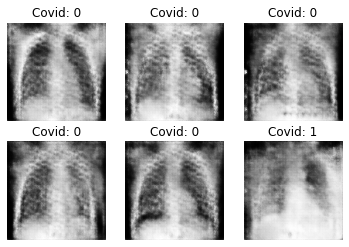

Epoch 222/300 Batch 12/12 [D loss: 0.58643, acc: 62.50%] [G loss: 1.21114]
Epoch 223/300 Batch 12/12 [D loss: 0.54394, acc: 62.50%] [G loss: 1.01912]
Epoch 224/300 Batch 12/12 [D loss: 0.50926, acc: 75.00%] [G loss: 1.24530]
Epoch 225/300 Batch 12/12 [D loss: 0.53041, acc: 81.25%] [G loss: 1.12953]
Epoch 226/300 Batch 12/12 [D loss: 0.41571, acc: 87.50%] [G loss: 1.35172]
Epoch 227/300 Batch 12/12 [D loss: 0.52415, acc: 87.50%] [G loss: 1.32652]
Epoch 228/300 Batch 12/12 [D loss: 0.45031, acc: 87.50%] [G loss: 1.10666]
Epoch 229/300 Batch 12/12 [D loss: 0.65714, acc: 62.50%] [G loss: 0.74533]
Epoch 230/300 Batch 12/12 [D loss: 0.49732, acc: 87.50%] [G loss: 1.14151]
Epoch 231/300 Batch 12/12 [D loss: 0.53746, acc: 81.25%] [G loss: 0.99298]
Epoch 232/300 Batch 12/12 [D loss: 0.52486, acc: 81.25%] [G loss: 1.05641]
Epoch 233/300 Batch 12/12 [D loss: 0.62108, acc: 68.75%] [G loss: 0.89528]
Epoch 234/300 Batch 12/12 [D loss: 0.52660, acc: 81.25%] [G loss: 1.30462]
Epoch 235/300 Batch 12/12

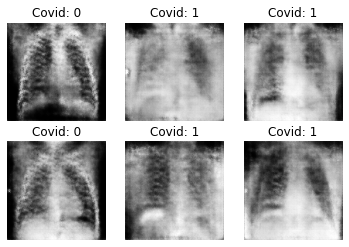

Epoch 242/300 Batch 12/12 [D loss: 0.52762, acc: 75.00%] [G loss: 1.21093]
Epoch 243/300 Batch 12/12 [D loss: 0.47335, acc: 75.00%] [G loss: 1.43721]
Epoch 244/300 Batch 12/12 [D loss: 0.42648, acc: 93.75%] [G loss: 1.24817]
Epoch 245/300 Batch 12/12 [D loss: 0.58530, acc: 68.75%] [G loss: 0.99363]
Epoch 246/300 Batch 12/12 [D loss: 0.55661, acc: 68.75%] [G loss: 1.25563]
Epoch 247/300 Batch 12/12 [D loss: 0.60414, acc: 56.25%] [G loss: 1.06515]
Epoch 248/300 Batch 12/12 [D loss: 0.69774, acc: 50.00%] [G loss: 0.76001]
Epoch 249/300 Batch 12/12 [D loss: 0.53848, acc: 75.00%] [G loss: 0.94544]
Epoch 250/300 Batch 12/12 [D loss: 0.56320, acc: 75.00%] [G loss: 1.05995]
Epoch 251/300 Batch 12/12 [D loss: 0.48697, acc: 93.75%] [G loss: 1.17323]
Epoch 252/300 Batch 12/12 [D loss: 0.64715, acc: 68.75%] [G loss: 1.03371]
Epoch 253/300 Batch 12/12 [D loss: 0.47658, acc: 87.50%] [G loss: 1.15331]
Epoch 254/300 Batch 12/12 [D loss: 0.55077, acc: 75.00%] [G loss: 0.99175]
Epoch 255/300 Batch 12/12

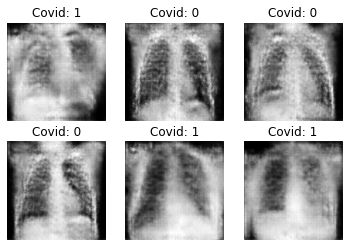

Epoch 262/300 Batch 12/12 [D loss: 0.62543, acc: 50.00%] [G loss: 0.83490]
Epoch 263/300 Batch 12/12 [D loss: 0.42918, acc: 93.75%] [G loss: 1.33052]
Epoch 264/300 Batch 12/12 [D loss: 0.49125, acc: 87.50%] [G loss: 1.02228]
Epoch 265/300 Batch 12/12 [D loss: 0.74327, acc: 56.25%] [G loss: 0.77097]
Epoch 266/300 Batch 12/12 [D loss: 0.57227, acc: 75.00%] [G loss: 0.95950]
Epoch 267/300 Batch 12/12 [D loss: 0.48563, acc: 75.00%] [G loss: 1.21388]
Epoch 268/300 Batch 12/12 [D loss: 0.64521, acc: 50.00%] [G loss: 1.14323]
Epoch 269/300 Batch 12/12 [D loss: 0.53015, acc: 87.50%] [G loss: 1.13671]
Epoch 270/300 Batch 12/12 [D loss: 0.43266, acc: 81.25%] [G loss: 1.33905]
Epoch 271/300 Batch 12/12 [D loss: 0.53075, acc: 75.00%] [G loss: 1.12597]
Epoch 272/300 Batch 12/12 [D loss: 0.53941, acc: 75.00%] [G loss: 0.93375]
Epoch 273/300 Batch 12/12 [D loss: 0.41996, acc: 93.75%] [G loss: 1.21314]
Epoch 274/300 Batch 12/12 [D loss: 0.42612, acc: 87.50%] [G loss: 1.44838]
Epoch 275/300 Batch 12/12

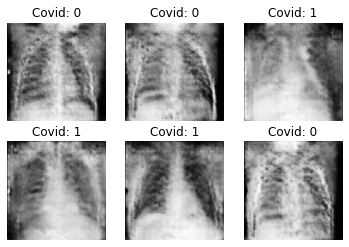

Epoch 282/300 Batch 12/12 [D loss: 0.54448, acc: 75.00%] [G loss: 1.32426]
Epoch 283/300 Batch 12/12 [D loss: 0.57817, acc: 56.25%] [G loss: 1.01215]
Epoch 284/300 Batch 12/12 [D loss: 0.46917, acc: 87.50%] [G loss: 1.13899]
Epoch 285/300 Batch 12/12 [D loss: 0.41299, acc: 87.50%] [G loss: 1.37535]
Epoch 286/300 Batch 12/12 [D loss: 0.49382, acc: 81.25%] [G loss: 1.29838]
Epoch 287/300 Batch 12/12 [D loss: 0.46403, acc: 87.50%] [G loss: 1.05872]
Epoch 288/300 Batch 12/12 [D loss: 0.49573, acc: 81.25%] [G loss: 1.21888]
Epoch 289/300 Batch 12/12 [D loss: 0.59951, acc: 62.50%] [G loss: 0.92072]
Epoch 290/300 Batch 12/12 [D loss: 0.52162, acc: 81.25%] [G loss: 1.10108]
Epoch 291/300 Batch 12/12 [D loss: 0.59103, acc: 81.25%] [G loss: 0.92704]
Epoch 292/300 Batch 12/12 [D loss: 0.51543, acc: 87.50%] [G loss: 1.17120]
Epoch 293/300 Batch 12/12 [D loss: 0.50825, acc: 87.50%] [G loss: 1.07134]
Epoch 294/300 Batch 12/12 [D loss: 0.55164, acc: 62.50%] [G loss: 0.80251]
Epoch 295/300 Batch 12/12

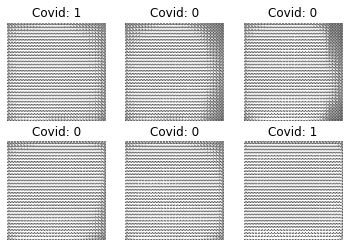

Epoch 2/300 Batch 6/6 [D loss: 4.12185, acc: 96.88%] [G loss: 2601.66016]
Epoch 3/300 Batch 6/6 [D loss: 0.99816, acc: 93.75%] [G loss: 78.03127]
Epoch 4/300 Batch 6/6 [D loss: 0.04478, acc: 96.88%] [G loss: 15.41780]
Epoch 5/300 Batch 6/6 [D loss: 0.00726, acc: 100.00%] [G loss: 15.69394]
Epoch 6/300 Batch 6/6 [D loss: 0.21001, acc: 96.88%] [G loss: 14.17001]
Epoch 7/300 Batch 6/6 [D loss: 0.03057, acc: 100.00%] [G loss: 9.20564]
Epoch 8/300 Batch 6/6 [D loss: 0.17936, acc: 93.75%] [G loss: 10.92357]
Epoch 9/300 Batch 6/6 [D loss: 0.04148, acc: 96.88%] [G loss: 11.01498]
Epoch 10/300 Batch 6/6 [D loss: 0.13048, acc: 96.88%] [G loss: 8.12801]
Epoch 11/300 Batch 6/6 [D loss: 0.16162, acc: 90.62%] [G loss: 9.40062]
Epoch 12/300 Batch 6/6 [D loss: 0.00990, acc: 100.00%] [G loss: 10.18116]
Epoch 13/300 Batch 6/6 [D loss: 0.06039, acc: 96.88%] [G loss: 8.98014]
Epoch 14/300 Batch 6/6 [D loss: 0.00402, acc: 100.00%] [G loss: 10.35504]
Epoch 15/300 Batch 6/6 [D loss: 0.35790, acc: 90.62%] [G 

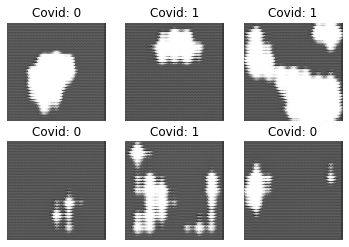

Epoch 22/300 Batch 6/6 [D loss: 0.00251, acc: 100.00%] [G loss: 8.46961]
Epoch 23/300 Batch 6/6 [D loss: 0.03793, acc: 100.00%] [G loss: 8.20323]
Epoch 24/300 Batch 6/6 [D loss: 0.00870, acc: 100.00%] [G loss: 9.71181]
Epoch 25/300 Batch 6/6 [D loss: 0.02363, acc: 100.00%] [G loss: 7.60072]
Epoch 26/300 Batch 6/6 [D loss: 0.00178, acc: 100.00%] [G loss: 7.50715]
Epoch 27/300 Batch 6/6 [D loss: 0.02495, acc: 100.00%] [G loss: 5.46789]
Epoch 28/300 Batch 6/6 [D loss: 0.00660, acc: 100.00%] [G loss: 7.33449]
Epoch 29/300 Batch 6/6 [D loss: 0.01811, acc: 100.00%] [G loss: 6.52152]
Epoch 30/300 Batch 6/6 [D loss: 0.01104, acc: 100.00%] [G loss: 7.43871]
Epoch 31/300 Batch 6/6 [D loss: 0.02827, acc: 96.88%] [G loss: 7.84319]
Epoch 32/300 Batch 6/6 [D loss: 0.00012, acc: 100.00%] [G loss: 10.93908]
Epoch 33/300 Batch 6/6 [D loss: 0.06252, acc: 96.88%] [G loss: 5.29046]
Epoch 34/300 Batch 6/6 [D loss: 0.00074, acc: 100.00%] [G loss: 11.02649]
Epoch 35/300 Batch 6/6 [D loss: 0.06491, acc: 96.88

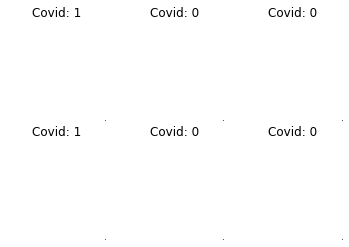

Epoch 42/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 7675412.50000]
Epoch 43/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5200146.00000]
Epoch 44/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5146407.00000]
Epoch 45/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5185221.00000]
Epoch 46/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5213919.50000]
Epoch 47/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5149259.50000]
Epoch 48/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5152729.00000]
Epoch 49/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5238120.50000]
Epoch 50/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5216987.00000]
Epoch 51/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5212053.00000]
Epoch 52/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5155716.00000]
Epoch 53/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5156723.50000]
Epoch 54/300 Batch 6/6 [D loss: 0.00000, acc: 100.00

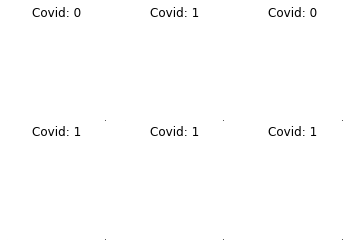

Epoch 62/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5143709.00000]
Epoch 63/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5213555.00000]
Epoch 64/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5210810.00000]
Epoch 65/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5215524.00000]
Epoch 66/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5188912.50000]
Epoch 67/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5276722.50000]
Epoch 68/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5223566.00000]
Epoch 69/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5194510.00000]
Epoch 70/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5258936.50000]
Epoch 71/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5220404.00000]
Epoch 72/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5196771.00000]
Epoch 73/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5170356.00000]
Epoch 74/300 Batch 6/6 [D loss: 0.00000, acc: 100.00

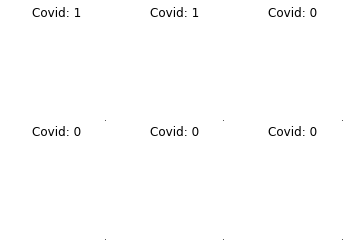

Epoch 82/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5191864.50000]
Epoch 83/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5189928.00000]
Epoch 84/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5170491.50000]
Epoch 85/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5192056.00000]
Epoch 86/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5217465.00000]
Epoch 87/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5225730.50000]
Epoch 88/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5142019.00000]
Epoch 89/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5227239.00000]
Epoch 90/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5160004.00000]
Epoch 91/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5243845.00000]
Epoch 92/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5181802.00000]
Epoch 93/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5131687.00000]
Epoch 94/300 Batch 6/6 [D loss: 0.00000, acc: 100.00

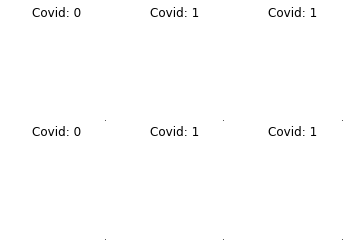

Epoch 102/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5197094.50000]
Epoch 103/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5153066.00000]
Epoch 104/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5153752.00000]
Epoch 105/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5116897.00000]
Epoch 106/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5161849.00000]
Epoch 107/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5230542.00000]
Epoch 108/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5139098.00000]
Epoch 109/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5293805.00000]
Epoch 110/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5252414.50000]
Epoch 111/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5248288.00000]
Epoch 112/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5185597.00000]
Epoch 113/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5217930.50000]
Epoch 114/300 Batch 6/6 [D loss: 0.00000

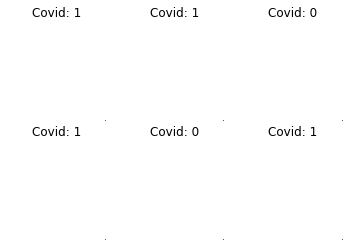

Epoch 122/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5200795.00000]
Epoch 123/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5239743.00000]
Epoch 124/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5173003.50000]
Epoch 125/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5288094.00000]
Epoch 126/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5238974.00000]
Epoch 127/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5184507.00000]
Epoch 128/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5203188.00000]
Epoch 129/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5241266.50000]
Epoch 130/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5146246.00000]
Epoch 131/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5201321.00000]
Epoch 132/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5204024.00000]
Epoch 133/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5228607.00000]
Epoch 134/300 Batch 6/6 [D loss: 0.00000

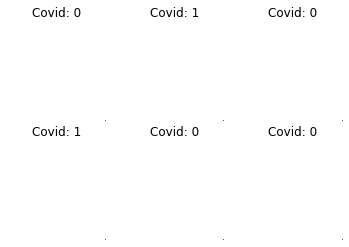

Epoch 142/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5210158.00000]
Epoch 143/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5163421.00000]
Epoch 144/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5148437.50000]
Epoch 145/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5163749.50000]
Epoch 146/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5119778.00000]
Epoch 147/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5153119.00000]
Epoch 148/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5202771.00000]
Epoch 149/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5205551.00000]
Epoch 150/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5191463.00000]
Epoch 151/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5151756.50000]
Epoch 152/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5187082.00000]
Epoch 153/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5186587.00000]
Epoch 154/300 Batch 6/6 [D loss: 0.00000

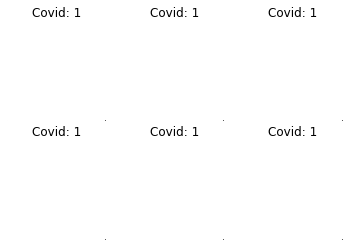

Epoch 162/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5207390.00000]
Epoch 163/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5107068.00000]
Epoch 164/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5192749.00000]
Epoch 165/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5107828.00000]
Epoch 166/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5151209.00000]
Epoch 167/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5270863.00000]
Epoch 168/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5199285.50000]
Epoch 169/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5164924.00000]
Epoch 170/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5229798.00000]
Epoch 171/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5151294.00000]
Epoch 172/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5187133.00000]
Epoch 173/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5205860.00000]
Epoch 174/300 Batch 6/6 [D loss: 0.00000

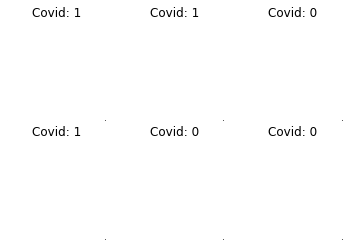

Epoch 182/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5147672.00000]
Epoch 183/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5194196.00000]
Epoch 184/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5243913.00000]
Epoch 185/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5188444.00000]
Epoch 186/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5167777.50000]
Epoch 187/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5196282.00000]
Epoch 188/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5191367.00000]
Epoch 189/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5243480.00000]
Epoch 190/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5162922.50000]
Epoch 191/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5203757.00000]
Epoch 192/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5192479.00000]
Epoch 193/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5278162.00000]
Epoch 194/300 Batch 6/6 [D loss: 0.00000

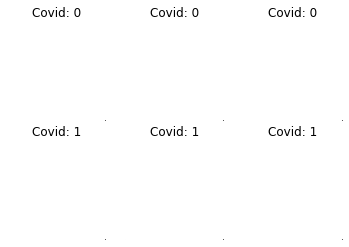

Epoch 202/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5143300.00000]
Epoch 203/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5164245.00000]
Epoch 204/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5184047.50000]
Epoch 205/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5187108.00000]
Epoch 206/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5194456.50000]
Epoch 207/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5175555.00000]
Epoch 208/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5186809.00000]
Epoch 209/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5153959.50000]
Epoch 210/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5174621.00000]
Epoch 211/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5109759.50000]
Epoch 212/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5144557.00000]
Epoch 213/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5097089.00000]
Epoch 214/300 Batch 6/6 [D loss: 0.00000

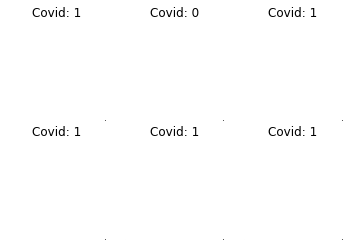

Epoch 222/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5208565.50000]
Epoch 223/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5222501.00000]
Epoch 224/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5197405.00000]
Epoch 225/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5188655.00000]
Epoch 226/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5148710.00000]
Epoch 227/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5204343.50000]
Epoch 228/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5089510.00000]
Epoch 229/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5151511.00000]
Epoch 230/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5207136.50000]
Epoch 231/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5198415.00000]
Epoch 232/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5120489.50000]
Epoch 233/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5120120.50000]
Epoch 234/300 Batch 6/6 [D loss: 0.00000

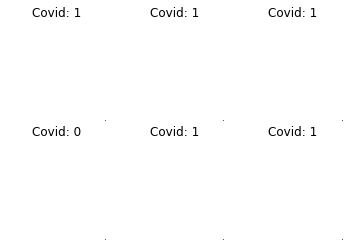

Epoch 242/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5225705.00000]
Epoch 243/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5110193.00000]
Epoch 244/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5155648.00000]
Epoch 245/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5196021.50000]
Epoch 246/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5153947.00000]
Epoch 247/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5190371.50000]
Epoch 248/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5174276.00000]
Epoch 249/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5231747.00000]
Epoch 250/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5220171.50000]
Epoch 251/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5105081.00000]
Epoch 252/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5151962.00000]
Epoch 253/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5181056.00000]
Epoch 254/300 Batch 6/6 [D loss: 0.00000

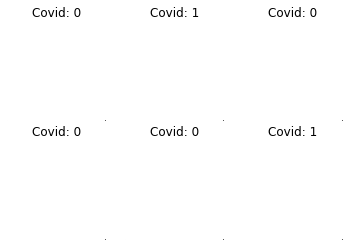

Epoch 262/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5250685.00000]
Epoch 263/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5162979.00000]
Epoch 264/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5157488.00000]
Epoch 265/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5201814.00000]
Epoch 266/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5299201.00000]
Epoch 267/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5145548.50000]
Epoch 268/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5227541.00000]
Epoch 269/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5155103.50000]
Epoch 270/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5144095.50000]
Epoch 271/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5180188.00000]
Epoch 272/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5208377.00000]
Epoch 273/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5175645.50000]
Epoch 274/300 Batch 6/6 [D loss: 0.00000

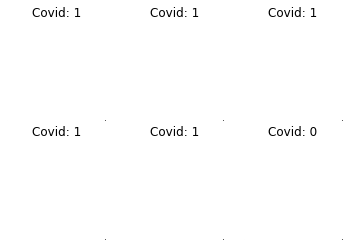

Epoch 282/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5226029.50000]
Epoch 283/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5104503.50000]
Epoch 284/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5222338.50000]
Epoch 285/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5189198.00000]
Epoch 286/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5189655.50000]
Epoch 287/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5204627.50000]
Epoch 288/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5202077.00000]
Epoch 289/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5187551.00000]
Epoch 290/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5206174.00000]
Epoch 291/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5247172.00000]
Epoch 292/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5123666.00000]
Epoch 293/300 Batch 6/6 [D loss: 0.00000, acc: 100.00%] [G loss: 5171979.00000]
Epoch 294/300 Batch 6/6 [D loss: 0.00000

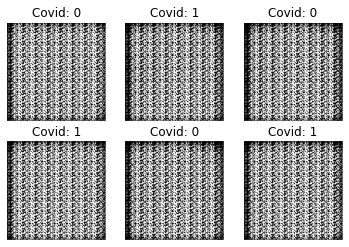

Epoch 2/300 Batch 6/6 [D loss: 0.07040, acc: 100.00%] [G loss: 3.64833]
Epoch 3/300 Batch 6/6 [D loss: 0.01503, acc: 100.00%] [G loss: 4.81141]
Epoch 4/300 Batch 6/6 [D loss: 0.00148, acc: 100.00%] [G loss: 5.85401]
Epoch 5/300 Batch 6/6 [D loss: 0.03645, acc: 96.88%] [G loss: 5.76941]
Epoch 6/300 Batch 6/6 [D loss: 0.00904, acc: 100.00%] [G loss: 5.50750]
Epoch 7/300 Batch 6/6 [D loss: 0.82614, acc: 75.00%] [G loss: 6.61428]
Epoch 8/300 Batch 6/6 [D loss: 0.11397, acc: 100.00%] [G loss: 4.57867]
Epoch 9/300 Batch 6/6 [D loss: 0.04543, acc: 100.00%] [G loss: 4.99455]
Epoch 10/300 Batch 6/6 [D loss: 0.18289, acc: 93.75%] [G loss: 6.67213]
Epoch 11/300 Batch 6/6 [D loss: 0.11768, acc: 96.88%] [G loss: 4.38892]
Epoch 12/300 Batch 6/6 [D loss: 0.21218, acc: 96.88%] [G loss: 3.69734]
Epoch 13/300 Batch 6/6 [D loss: 0.04223, acc: 100.00%] [G loss: 3.08568]
Epoch 14/300 Batch 6/6 [D loss: 0.00175, acc: 100.00%] [G loss: 5.52838]
Epoch 15/300 Batch 6/6 [D loss: 0.61089, acc: 78.12%] [G loss: 1

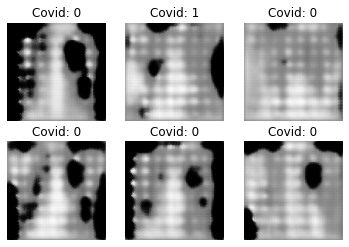

Epoch 22/300 Batch 6/6 [D loss: 0.63789, acc: 75.00%] [G loss: 1.37922]
Epoch 23/300 Batch 6/6 [D loss: 0.55900, acc: 78.12%] [G loss: 1.14437]
Epoch 24/300 Batch 6/6 [D loss: 0.87481, acc: 43.75%] [G loss: 0.70524]
Epoch 25/300 Batch 6/6 [D loss: 0.65185, acc: 68.75%] [G loss: 2.03951]
Epoch 26/300 Batch 6/6 [D loss: 0.40726, acc: 87.50%] [G loss: 2.18455]
Epoch 27/300 Batch 6/6 [D loss: 0.40343, acc: 84.38%] [G loss: 2.27211]
Epoch 28/300 Batch 6/6 [D loss: 0.55206, acc: 87.50%] [G loss: 2.18096]
Epoch 29/300 Batch 6/6 [D loss: 0.35316, acc: 93.75%] [G loss: 2.05216]
Epoch 30/300 Batch 6/6 [D loss: 0.28148, acc: 100.00%] [G loss: 2.43029]
Epoch 31/300 Batch 6/6 [D loss: 0.45288, acc: 87.50%] [G loss: 2.49649]
Epoch 32/300 Batch 6/6 [D loss: 0.65997, acc: 56.25%] [G loss: 1.56728]
Epoch 33/300 Batch 6/6 [D loss: 0.46383, acc: 75.00%] [G loss: 2.05423]
Epoch 34/300 Batch 6/6 [D loss: 0.31543, acc: 90.62%] [G loss: 2.88942]
Epoch 35/300 Batch 6/6 [D loss: 0.41722, acc: 75.00%] [G loss: 

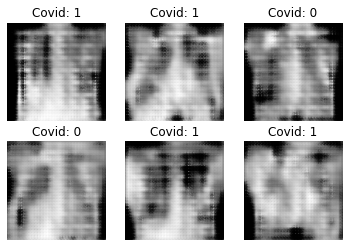

Epoch 42/300 Batch 6/6 [D loss: 0.46180, acc: 75.00%] [G loss: 2.16991]
Epoch 43/300 Batch 6/6 [D loss: 0.23312, acc: 93.75%] [G loss: 2.50511]
Epoch 44/300 Batch 6/6 [D loss: 0.34832, acc: 84.38%] [G loss: 2.56083]
Epoch 45/300 Batch 6/6 [D loss: 0.48052, acc: 75.00%] [G loss: 2.34715]
Epoch 46/300 Batch 6/6 [D loss: 0.28025, acc: 93.75%] [G loss: 2.62368]
Epoch 47/300 Batch 6/6 [D loss: 0.19254, acc: 93.75%] [G loss: 3.24141]
Epoch 48/300 Batch 6/6 [D loss: 0.26037, acc: 93.75%] [G loss: 3.25185]
Epoch 49/300 Batch 6/6 [D loss: 0.47699, acc: 84.38%] [G loss: 2.16984]
Epoch 50/300 Batch 6/6 [D loss: 0.28393, acc: 90.62%] [G loss: 2.30336]
Epoch 51/300 Batch 6/6 [D loss: 0.31933, acc: 87.50%] [G loss: 3.71291]
Epoch 52/300 Batch 6/6 [D loss: 0.19019, acc: 93.75%] [G loss: 3.43824]
Epoch 53/300 Batch 6/6 [D loss: 0.35190, acc: 84.38%] [G loss: 3.47147]
Epoch 54/300 Batch 6/6 [D loss: 0.29090, acc: 87.50%] [G loss: 3.00530]
Epoch 55/300 Batch 6/6 [D loss: 0.25591, acc: 93.75%] [G loss: 2

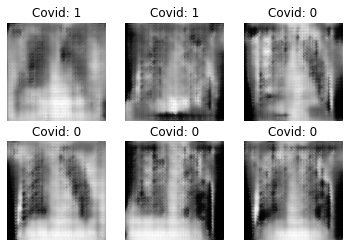

Epoch 62/300 Batch 6/6 [D loss: 0.29630, acc: 87.50%] [G loss: 2.82598]
Epoch 63/300 Batch 6/6 [D loss: 0.34547, acc: 90.62%] [G loss: 2.56962]
Epoch 64/300 Batch 6/6 [D loss: 0.33684, acc: 84.38%] [G loss: 2.18278]
Epoch 65/300 Batch 6/6 [D loss: 0.35225, acc: 87.50%] [G loss: 2.69682]
Epoch 66/300 Batch 6/6 [D loss: 0.25735, acc: 90.62%] [G loss: 3.34238]
Epoch 67/300 Batch 6/6 [D loss: 0.33724, acc: 87.50%] [G loss: 2.63993]
Epoch 68/300 Batch 6/6 [D loss: 0.24117, acc: 93.75%] [G loss: 3.48800]
Epoch 69/300 Batch 6/6 [D loss: 0.22330, acc: 93.75%] [G loss: 3.11627]
Epoch 70/300 Batch 6/6 [D loss: 0.27111, acc: 93.75%] [G loss: 3.68182]
Epoch 71/300 Batch 6/6 [D loss: 0.14897, acc: 96.88%] [G loss: 2.68491]
Epoch 72/300 Batch 6/6 [D loss: 0.28338, acc: 87.50%] [G loss: 3.45315]
Epoch 73/300 Batch 6/6 [D loss: 0.52880, acc: 81.25%] [G loss: 2.77525]
Epoch 74/300 Batch 6/6 [D loss: 0.22964, acc: 84.38%] [G loss: 3.03024]
Epoch 75/300 Batch 6/6 [D loss: 0.56898, acc: 78.12%] [G loss: 3

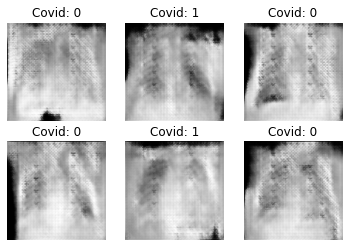

Epoch 82/300 Batch 6/6 [D loss: 0.20456, acc: 93.75%] [G loss: 2.41054]
Epoch 83/300 Batch 6/6 [D loss: 0.32192, acc: 90.62%] [G loss: 2.80614]
Epoch 84/300 Batch 6/6 [D loss: 0.21750, acc: 93.75%] [G loss: 2.57261]
Epoch 85/300 Batch 6/6 [D loss: 0.29701, acc: 90.62%] [G loss: 2.59937]
Epoch 86/300 Batch 6/6 [D loss: 0.35235, acc: 81.25%] [G loss: 2.99006]
Epoch 87/300 Batch 6/6 [D loss: 0.36789, acc: 81.25%] [G loss: 2.97682]
Epoch 88/300 Batch 6/6 [D loss: 0.48782, acc: 78.12%] [G loss: 2.27606]
Epoch 89/300 Batch 6/6 [D loss: 0.25752, acc: 96.88%] [G loss: 3.99007]
Epoch 90/300 Batch 6/6 [D loss: 0.31133, acc: 87.50%] [G loss: 3.23623]
Epoch 91/300 Batch 6/6 [D loss: 0.26602, acc: 90.62%] [G loss: 3.06291]
Epoch 92/300 Batch 6/6 [D loss: 0.50175, acc: 75.00%] [G loss: 3.89159]
Epoch 93/300 Batch 6/6 [D loss: 0.23462, acc: 96.88%] [G loss: 3.12775]
Epoch 94/300 Batch 6/6 [D loss: 0.32647, acc: 81.25%] [G loss: 2.69568]
Epoch 95/300 Batch 6/6 [D loss: 0.50445, acc: 71.88%] [G loss: 2

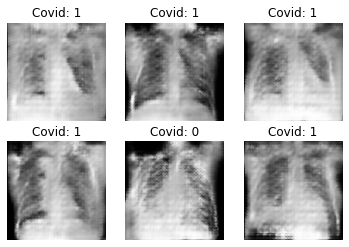

Epoch 102/300 Batch 6/6 [D loss: 0.43298, acc: 78.12%] [G loss: 3.23371]
Epoch 103/300 Batch 6/6 [D loss: 0.28078, acc: 93.75%] [G loss: 2.45427]
Epoch 104/300 Batch 6/6 [D loss: 0.13984, acc: 93.75%] [G loss: 2.56531]
Epoch 105/300 Batch 6/6 [D loss: 0.37248, acc: 78.12%] [G loss: 3.07859]
Epoch 106/300 Batch 6/6 [D loss: 0.45244, acc: 78.12%] [G loss: 3.69961]
Epoch 107/300 Batch 6/6 [D loss: 0.30799, acc: 87.50%] [G loss: 2.60525]
Epoch 108/300 Batch 6/6 [D loss: 0.31474, acc: 87.50%] [G loss: 2.46285]
Epoch 109/300 Batch 6/6 [D loss: 0.71002, acc: 65.62%] [G loss: 3.80295]
Epoch 110/300 Batch 6/6 [D loss: 0.37727, acc: 84.38%] [G loss: 2.96147]
Epoch 111/300 Batch 6/6 [D loss: 0.42477, acc: 78.12%] [G loss: 3.03281]
Epoch 112/300 Batch 6/6 [D loss: 0.25373, acc: 93.75%] [G loss: 4.43506]
Epoch 113/300 Batch 6/6 [D loss: 0.18972, acc: 90.62%] [G loss: 3.89160]
Epoch 114/300 Batch 6/6 [D loss: 0.36776, acc: 84.38%] [G loss: 3.66221]
Epoch 115/300 Batch 6/6 [D loss: 0.12256, acc: 96.8

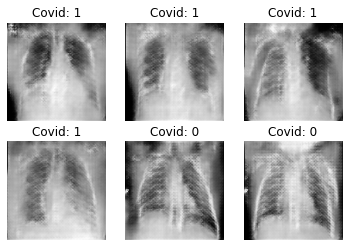

Epoch 122/300 Batch 6/6 [D loss: 0.45173, acc: 75.00%] [G loss: 2.22740]
Epoch 123/300 Batch 6/6 [D loss: 0.25100, acc: 87.50%] [G loss: 2.68296]
Epoch 124/300 Batch 6/6 [D loss: 0.34223, acc: 90.62%] [G loss: 3.34904]
Epoch 125/300 Batch 6/6 [D loss: 0.40347, acc: 87.50%] [G loss: 4.46700]
Epoch 126/300 Batch 6/6 [D loss: 0.42450, acc: 75.00%] [G loss: 2.98067]
Epoch 127/300 Batch 6/6 [D loss: 0.26237, acc: 87.50%] [G loss: 3.68877]
Epoch 128/300 Batch 6/6 [D loss: 0.26037, acc: 96.88%] [G loss: 3.40057]
Epoch 129/300 Batch 6/6 [D loss: 0.48323, acc: 78.12%] [G loss: 3.03805]
Epoch 130/300 Batch 6/6 [D loss: 0.43872, acc: 81.25%] [G loss: 3.21124]
Epoch 131/300 Batch 6/6 [D loss: 0.13030, acc: 100.00%] [G loss: 2.72445]
Epoch 132/300 Batch 6/6 [D loss: 0.40855, acc: 71.88%] [G loss: 4.63736]
Epoch 133/300 Batch 6/6 [D loss: 0.33204, acc: 81.25%] [G loss: 3.05059]
Epoch 134/300 Batch 6/6 [D loss: 0.25961, acc: 87.50%] [G loss: 3.36147]
Epoch 135/300 Batch 6/6 [D loss: 0.30049, acc: 87.

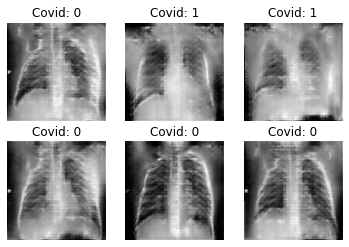

Epoch 142/300 Batch 6/6 [D loss: 0.73716, acc: 68.75%] [G loss: 3.92162]
Epoch 143/300 Batch 6/6 [D loss: 0.23356, acc: 93.75%] [G loss: 3.57183]
Epoch 144/300 Batch 6/6 [D loss: 0.16584, acc: 96.88%] [G loss: 4.06748]
Epoch 145/300 Batch 6/6 [D loss: 0.33459, acc: 87.50%] [G loss: 2.67245]
Epoch 146/300 Batch 6/6 [D loss: 0.54431, acc: 81.25%] [G loss: 3.20862]
Epoch 147/300 Batch 6/6 [D loss: 0.40518, acc: 84.38%] [G loss: 1.98941]
Epoch 148/300 Batch 6/6 [D loss: 0.37779, acc: 84.38%] [G loss: 2.66472]
Epoch 149/300 Batch 6/6 [D loss: 0.34631, acc: 87.50%] [G loss: 2.89516]
Epoch 150/300 Batch 6/6 [D loss: 0.26191, acc: 87.50%] [G loss: 3.96507]
Epoch 151/300 Batch 6/6 [D loss: 0.22127, acc: 90.62%] [G loss: 3.64475]
Epoch 152/300 Batch 6/6 [D loss: 0.16354, acc: 100.00%] [G loss: 3.30328]
Epoch 153/300 Batch 6/6 [D loss: 0.33214, acc: 84.38%] [G loss: 3.04201]
Epoch 154/300 Batch 6/6 [D loss: 0.24454, acc: 93.75%] [G loss: 3.92147]
Epoch 155/300 Batch 6/6 [D loss: 0.19913, acc: 90.

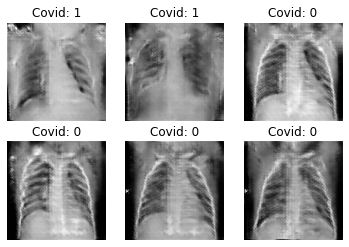

Epoch 162/300 Batch 6/6 [D loss: 0.19120, acc: 93.75%] [G loss: 3.69222]
Epoch 163/300 Batch 6/6 [D loss: 0.26690, acc: 90.62%] [G loss: 2.59202]
Epoch 164/300 Batch 6/6 [D loss: 0.27039, acc: 87.50%] [G loss: 3.23515]
Epoch 165/300 Batch 6/6 [D loss: 0.25121, acc: 87.50%] [G loss: 3.13076]
Epoch 166/300 Batch 6/6 [D loss: 0.13177, acc: 96.88%] [G loss: 2.99127]
Epoch 167/300 Batch 6/6 [D loss: 0.18295, acc: 100.00%] [G loss: 3.88295]
Epoch 168/300 Batch 6/6 [D loss: 0.60263, acc: 59.38%] [G loss: 3.60453]
Epoch 169/300 Batch 6/6 [D loss: 0.48199, acc: 78.12%] [G loss: 3.57460]
Epoch 170/300 Batch 6/6 [D loss: 0.27700, acc: 90.62%] [G loss: 3.02766]
Epoch 171/300 Batch 6/6 [D loss: 0.35498, acc: 84.38%] [G loss: 3.62155]
Epoch 172/300 Batch 6/6 [D loss: 0.15320, acc: 90.62%] [G loss: 4.19156]
Epoch 173/300 Batch 6/6 [D loss: 0.15403, acc: 100.00%] [G loss: 4.01051]
Epoch 174/300 Batch 6/6 [D loss: 0.30817, acc: 84.38%] [G loss: 3.43049]
Epoch 175/300 Batch 6/6 [D loss: 0.28166, acc: 84

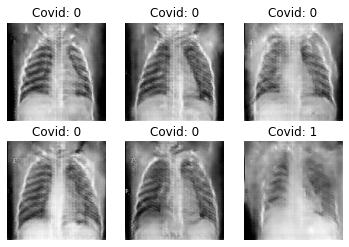

Epoch 182/300 Batch 6/6 [D loss: 0.27300, acc: 96.88%] [G loss: 4.46559]
Epoch 183/300 Batch 6/6 [D loss: 0.25184, acc: 90.62%] [G loss: 3.26143]
Epoch 184/300 Batch 6/6 [D loss: 0.46293, acc: 78.12%] [G loss: 4.23341]
Epoch 185/300 Batch 6/6 [D loss: 0.32344, acc: 87.50%] [G loss: 5.03464]
Epoch 186/300 Batch 6/6 [D loss: 0.26090, acc: 90.62%] [G loss: 3.05777]
Epoch 187/300 Batch 6/6 [D loss: 0.23257, acc: 90.62%] [G loss: 3.29919]
Epoch 188/300 Batch 6/6 [D loss: 0.20108, acc: 90.62%] [G loss: 3.67484]
Epoch 189/300 Batch 6/6 [D loss: 0.14111, acc: 96.88%] [G loss: 3.58265]
Epoch 190/300 Batch 6/6 [D loss: 0.37871, acc: 87.50%] [G loss: 4.46208]
Epoch 191/300 Batch 6/6 [D loss: 0.24391, acc: 87.50%] [G loss: 2.90507]
Epoch 192/300 Batch 6/6 [D loss: 0.14330, acc: 93.75%] [G loss: 3.81502]
Epoch 193/300 Batch 6/6 [D loss: 0.28370, acc: 84.38%] [G loss: 3.06848]
Epoch 194/300 Batch 6/6 [D loss: 0.15129, acc: 96.88%] [G loss: 3.13747]
Epoch 195/300 Batch 6/6 [D loss: 0.30459, acc: 90.6

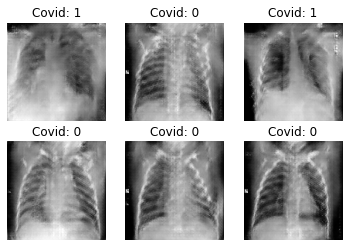

Epoch 202/300 Batch 6/6 [D loss: 0.14964, acc: 96.88%] [G loss: 2.71270]
Epoch 203/300 Batch 6/6 [D loss: 0.21215, acc: 96.88%] [G loss: 4.44479]
Epoch 204/300 Batch 6/6 [D loss: 0.19481, acc: 93.75%] [G loss: 4.32783]
Epoch 205/300 Batch 6/6 [D loss: 0.17491, acc: 90.62%] [G loss: 4.68185]
Epoch 206/300 Batch 6/6 [D loss: 0.24479, acc: 87.50%] [G loss: 4.31855]
Epoch 207/300 Batch 6/6 [D loss: 0.40093, acc: 81.25%] [G loss: 2.58460]
Epoch 208/300 Batch 6/6 [D loss: 0.38260, acc: 84.38%] [G loss: 4.32329]
Epoch 209/300 Batch 6/6 [D loss: 0.19984, acc: 96.88%] [G loss: 3.17709]
Epoch 210/300 Batch 6/6 [D loss: 0.38674, acc: 78.12%] [G loss: 4.62419]
Epoch 211/300 Batch 6/6 [D loss: 0.10473, acc: 100.00%] [G loss: 3.71897]
Epoch 212/300 Batch 6/6 [D loss: 0.18336, acc: 93.75%] [G loss: 4.19542]
Epoch 213/300 Batch 6/6 [D loss: 0.42131, acc: 90.62%] [G loss: 3.68337]
Epoch 214/300 Batch 6/6 [D loss: 0.24674, acc: 93.75%] [G loss: 2.56352]
Epoch 215/300 Batch 6/6 [D loss: 0.14101, acc: 96.

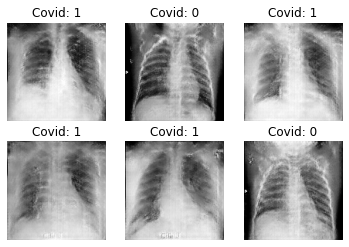

Epoch 222/300 Batch 6/6 [D loss: 0.38558, acc: 84.38%] [G loss: 3.56836]
Epoch 223/300 Batch 6/6 [D loss: 0.13983, acc: 96.88%] [G loss: 3.64236]
Epoch 224/300 Batch 6/6 [D loss: 0.20923, acc: 93.75%] [G loss: 3.97271]
Epoch 225/300 Batch 6/6 [D loss: 0.15283, acc: 100.00%] [G loss: 4.36842]
Epoch 226/300 Batch 6/6 [D loss: 0.18414, acc: 96.88%] [G loss: 4.46545]
Epoch 227/300 Batch 6/6 [D loss: 0.14068, acc: 96.88%] [G loss: 5.47776]
Epoch 228/300 Batch 6/6 [D loss: 0.23988, acc: 93.75%] [G loss: 3.45858]
Epoch 229/300 Batch 6/6 [D loss: 0.06855, acc: 96.88%] [G loss: 4.10933]
Epoch 230/300 Batch 6/6 [D loss: 0.19138, acc: 93.75%] [G loss: 4.64830]
Epoch 231/300 Batch 6/6 [D loss: 0.25742, acc: 93.75%] [G loss: 4.78134]
Epoch 232/300 Batch 6/6 [D loss: 0.32332, acc: 81.25%] [G loss: 3.54178]
Epoch 233/300 Batch 6/6 [D loss: 0.21507, acc: 90.62%] [G loss: 4.68961]
Epoch 234/300 Batch 6/6 [D loss: 0.05858, acc: 100.00%] [G loss: 4.68826]
Epoch 235/300 Batch 6/6 [D loss: 0.20632, acc: 93

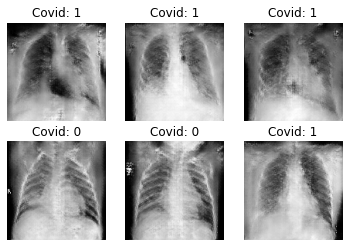

Epoch 242/300 Batch 6/6 [D loss: 0.08925, acc: 100.00%] [G loss: 3.65066]
Epoch 243/300 Batch 6/6 [D loss: 0.12021, acc: 96.88%] [G loss: 3.63798]
Epoch 244/300 Batch 6/6 [D loss: 0.24692, acc: 90.62%] [G loss: 5.95942]
Epoch 245/300 Batch 6/6 [D loss: 0.07611, acc: 100.00%] [G loss: 3.07058]
Epoch 246/300 Batch 6/6 [D loss: 0.20942, acc: 93.75%] [G loss: 3.50510]
Epoch 247/300 Batch 6/6 [D loss: 0.08080, acc: 100.00%] [G loss: 4.02994]
Epoch 248/300 Batch 6/6 [D loss: 0.06500, acc: 100.00%] [G loss: 5.02009]
Epoch 249/300 Batch 6/6 [D loss: 0.19512, acc: 90.62%] [G loss: 4.24333]
Epoch 250/300 Batch 6/6 [D loss: 0.21818, acc: 93.75%] [G loss: 6.60524]
Epoch 251/300 Batch 6/6 [D loss: 0.22046, acc: 90.62%] [G loss: 3.56905]
Epoch 252/300 Batch 6/6 [D loss: 0.09829, acc: 100.00%] [G loss: 4.44667]
Epoch 253/300 Batch 6/6 [D loss: 0.16732, acc: 93.75%] [G loss: 5.00010]
Epoch 254/300 Batch 6/6 [D loss: 0.07992, acc: 96.88%] [G loss: 3.21055]
Epoch 255/300 Batch 6/6 [D loss: 0.12414, acc:

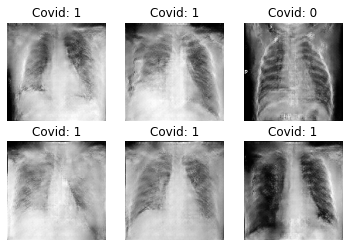

Epoch 262/300 Batch 6/6 [D loss: 0.36400, acc: 81.25%] [G loss: 7.96596]
Epoch 263/300 Batch 6/6 [D loss: 0.19900, acc: 87.50%] [G loss: 4.85189]
Epoch 264/300 Batch 6/6 [D loss: 0.16426, acc: 93.75%] [G loss: 3.44996]
Epoch 265/300 Batch 6/6 [D loss: 0.21743, acc: 90.62%] [G loss: 5.67529]
Epoch 266/300 Batch 6/6 [D loss: 0.13724, acc: 96.88%] [G loss: 6.31430]
Epoch 267/300 Batch 6/6 [D loss: 0.21763, acc: 90.62%] [G loss: 4.74680]
Epoch 268/300 Batch 6/6 [D loss: 0.08003, acc: 96.88%] [G loss: 4.00610]
Epoch 269/300 Batch 6/6 [D loss: 0.25131, acc: 90.62%] [G loss: 5.58883]
Epoch 270/300 Batch 6/6 [D loss: 0.07875, acc: 96.88%] [G loss: 5.03514]
Epoch 271/300 Batch 6/6 [D loss: 0.13689, acc: 93.75%] [G loss: 4.60591]
Epoch 272/300 Batch 6/6 [D loss: 0.07105, acc: 100.00%] [G loss: 4.87273]
Epoch 273/300 Batch 6/6 [D loss: 0.12743, acc: 96.88%] [G loss: 4.46201]
Epoch 274/300 Batch 6/6 [D loss: 0.05603, acc: 100.00%] [G loss: 4.28729]
Epoch 275/300 Batch 6/6 [D loss: 0.32085, acc: 78

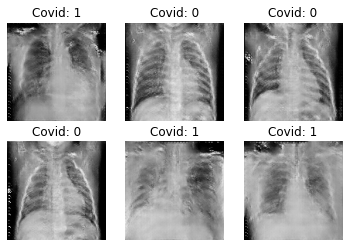

Epoch 282/300 Batch 6/6 [D loss: 0.03482, acc: 100.00%] [G loss: 2.58262]
Epoch 283/300 Batch 6/6 [D loss: 0.12216, acc: 96.88%] [G loss: 5.15300]
Epoch 284/300 Batch 6/6 [D loss: 0.06065, acc: 100.00%] [G loss: 4.31670]
Epoch 285/300 Batch 6/6 [D loss: 0.11954, acc: 96.88%] [G loss: 3.68737]
Epoch 286/300 Batch 6/6 [D loss: 0.04416, acc: 100.00%] [G loss: 4.42836]
Epoch 287/300 Batch 6/6 [D loss: 0.03583, acc: 100.00%] [G loss: 5.29784]
Epoch 288/300 Batch 6/6 [D loss: 0.02750, acc: 100.00%] [G loss: 4.53295]
Epoch 289/300 Batch 6/6 [D loss: 0.12355, acc: 100.00%] [G loss: 3.73546]
Epoch 290/300 Batch 6/6 [D loss: 0.13394, acc: 96.88%] [G loss: 5.19054]
Epoch 291/300 Batch 6/6 [D loss: 0.14041, acc: 96.88%] [G loss: 4.60591]
Epoch 292/300 Batch 6/6 [D loss: 0.15590, acc: 93.75%] [G loss: 4.88752]
Epoch 293/300 Batch 6/6 [D loss: 0.05564, acc: 100.00%] [G loss: 4.34525]
Epoch 294/300 Batch 6/6 [D loss: 0.11056, acc: 96.88%] [G loss: 4.75213]
Epoch 295/300 Batch 6/6 [D loss: 0.02267, ac

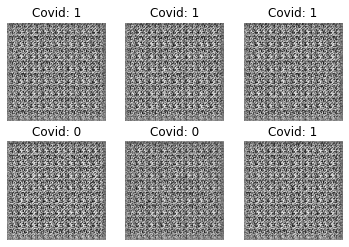

Epoch 2/300 Batch 6/6 [D loss: 0.42556, acc: 100.00%] [G loss: 1.11501]
Epoch 3/300 Batch 6/6 [D loss: 0.25698, acc: 100.00%] [G loss: 1.95108]
Epoch 4/300 Batch 6/6 [D loss: 0.14870, acc: 100.00%] [G loss: 2.34546]
Epoch 5/300 Batch 6/6 [D loss: 0.13814, acc: 100.00%] [G loss: 2.45733]
Epoch 6/300 Batch 6/6 [D loss: 0.34739, acc: 93.75%] [G loss: 2.78774]
Epoch 7/300 Batch 6/6 [D loss: 0.46354, acc: 71.88%] [G loss: 3.39423]
Epoch 8/300 Batch 6/6 [D loss: 0.56081, acc: 71.88%] [G loss: 2.01133]
Epoch 9/300 Batch 6/6 [D loss: 0.79857, acc: 65.62%] [G loss: 0.83187]
Epoch 10/300 Batch 6/6 [D loss: 0.77038, acc: 62.50%] [G loss: 1.46055]
Epoch 11/300 Batch 6/6 [D loss: 0.68602, acc: 59.38%] [G loss: 1.68748]
Epoch 12/300 Batch 6/6 [D loss: 0.54840, acc: 78.12%] [G loss: 1.17832]
Epoch 13/300 Batch 6/6 [D loss: 0.53477, acc: 78.12%] [G loss: 0.93881]
Epoch 14/300 Batch 6/6 [D loss: 0.62232, acc: 65.62%] [G loss: 1.18653]
Epoch 15/300 Batch 6/6 [D loss: 0.73839, acc: 53.12%] [G loss: 1.286

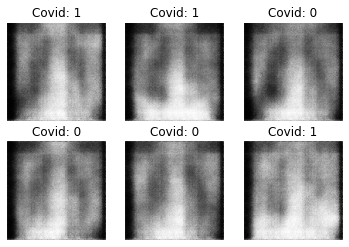

Epoch 22/300 Batch 6/6 [D loss: 0.56875, acc: 71.88%] [G loss: 1.12285]
Epoch 23/300 Batch 6/6 [D loss: 0.60379, acc: 75.00%] [G loss: 0.88226]
Epoch 24/300 Batch 6/6 [D loss: 0.67001, acc: 56.25%] [G loss: 0.72195]
Epoch 25/300 Batch 6/6 [D loss: 0.81196, acc: 40.62%] [G loss: 0.58340]
Epoch 26/300 Batch 6/6 [D loss: 0.77191, acc: 37.50%] [G loss: 0.65526]
Epoch 27/300 Batch 6/6 [D loss: 0.73255, acc: 34.38%] [G loss: 0.67580]
Epoch 28/300 Batch 6/6 [D loss: 0.68101, acc: 43.75%] [G loss: 0.75389]
Epoch 29/300 Batch 6/6 [D loss: 0.50355, acc: 75.00%] [G loss: 0.91212]
Epoch 30/300 Batch 6/6 [D loss: 0.51943, acc: 78.12%] [G loss: 0.80844]
Epoch 31/300 Batch 6/6 [D loss: 0.85472, acc: 34.38%] [G loss: 0.40782]
Epoch 32/300 Batch 6/6 [D loss: 0.70185, acc: 34.38%] [G loss: 0.64664]
Epoch 33/300 Batch 6/6 [D loss: 0.72455, acc: 40.62%] [G loss: 0.68027]
Epoch 34/300 Batch 6/6 [D loss: 0.65464, acc: 50.00%] [G loss: 0.72016]
Epoch 35/300 Batch 6/6 [D loss: 0.60956, acc: 68.75%] [G loss: 0

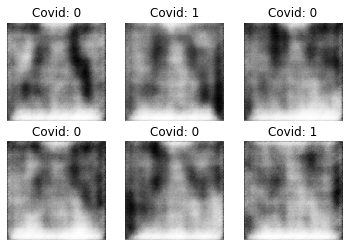

Epoch 42/300 Batch 6/6 [D loss: 0.61220, acc: 68.75%] [G loss: 0.65259]
Epoch 43/300 Batch 6/6 [D loss: 0.66587, acc: 46.88%] [G loss: 0.63694]
Epoch 44/300 Batch 6/6 [D loss: 0.66142, acc: 62.50%] [G loss: 0.66498]
Epoch 45/300 Batch 6/6 [D loss: 0.76864, acc: 31.25%] [G loss: 0.63970]
Epoch 46/300 Batch 6/6 [D loss: 0.73238, acc: 25.00%] [G loss: 0.70676]
Epoch 47/300 Batch 6/6 [D loss: 0.70982, acc: 43.75%] [G loss: 0.73461]
Epoch 48/300 Batch 6/6 [D loss: 0.68863, acc: 59.38%] [G loss: 0.74627]
Epoch 49/300 Batch 6/6 [D loss: 0.63770, acc: 68.75%] [G loss: 0.69786]
Epoch 50/300 Batch 6/6 [D loss: 0.77078, acc: 28.12%] [G loss: 0.60862]
Epoch 51/300 Batch 6/6 [D loss: 0.74783, acc: 43.75%] [G loss: 0.61955]
Epoch 52/300 Batch 6/6 [D loss: 0.71814, acc: 46.88%] [G loss: 0.65714]
Epoch 53/300 Batch 6/6 [D loss: 0.65585, acc: 65.62%] [G loss: 0.65957]
Epoch 54/300 Batch 6/6 [D loss: 0.64286, acc: 50.00%] [G loss: 0.71272]
Epoch 55/300 Batch 6/6 [D loss: 0.62682, acc: 59.38%] [G loss: 0

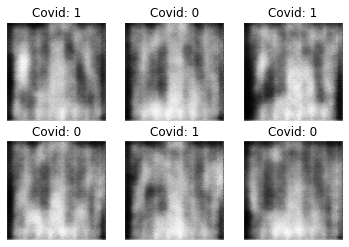

Epoch 62/300 Batch 6/6 [D loss: 0.64993, acc: 50.00%] [G loss: 0.65788]
Epoch 63/300 Batch 6/6 [D loss: 0.66863, acc: 50.00%] [G loss: 0.62439]
Epoch 64/300 Batch 6/6 [D loss: 0.67457, acc: 56.25%] [G loss: 0.60633]
Epoch 65/300 Batch 6/6 [D loss: 0.66644, acc: 56.25%] [G loss: 0.61834]
Epoch 66/300 Batch 6/6 [D loss: 0.65032, acc: 68.75%] [G loss: 0.69845]
Epoch 67/300 Batch 6/6 [D loss: 0.67521, acc: 56.25%] [G loss: 0.71227]
Epoch 68/300 Batch 6/6 [D loss: 0.60601, acc: 71.88%] [G loss: 0.67094]
Epoch 69/300 Batch 6/6 [D loss: 0.70328, acc: 43.75%] [G loss: 0.66303]
Epoch 70/300 Batch 6/6 [D loss: 0.68689, acc: 56.25%] [G loss: 0.65959]
Epoch 71/300 Batch 6/6 [D loss: 0.68065, acc: 50.00%] [G loss: 0.68440]
Epoch 72/300 Batch 6/6 [D loss: 0.66138, acc: 68.75%] [G loss: 0.68250]
Epoch 73/300 Batch 6/6 [D loss: 0.62748, acc: 71.88%] [G loss: 0.69751]
Epoch 74/300 Batch 6/6 [D loss: 0.65229, acc: 59.38%] [G loss: 0.66577]
Epoch 75/300 Batch 6/6 [D loss: 0.67192, acc: 53.12%] [G loss: 0

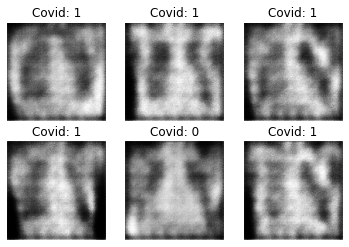

Epoch 82/300 Batch 6/6 [D loss: 0.65794, acc: 68.75%] [G loss: 0.76045]
Epoch 83/300 Batch 6/6 [D loss: 0.64149, acc: 68.75%] [G loss: 0.72558]
Epoch 84/300 Batch 6/6 [D loss: 0.63260, acc: 65.62%] [G loss: 0.62764]
Epoch 85/300 Batch 6/6 [D loss: 0.70603, acc: 43.75%] [G loss: 0.61191]
Epoch 86/300 Batch 6/6 [D loss: 0.66663, acc: 53.12%] [G loss: 0.67334]
Epoch 87/300 Batch 6/6 [D loss: 0.62913, acc: 56.25%] [G loss: 0.70239]
Epoch 88/300 Batch 6/6 [D loss: 0.61854, acc: 75.00%] [G loss: 0.73356]
Epoch 89/300 Batch 6/6 [D loss: 0.63484, acc: 68.75%] [G loss: 0.70868]
Epoch 90/300 Batch 6/6 [D loss: 0.66133, acc: 59.38%] [G loss: 0.72623]
Epoch 91/300 Batch 6/6 [D loss: 0.67683, acc: 53.12%] [G loss: 0.72205]
Epoch 92/300 Batch 6/6 [D loss: 0.63175, acc: 84.38%] [G loss: 0.78141]
Epoch 93/300 Batch 6/6 [D loss: 0.67961, acc: 59.38%] [G loss: 0.72330]
Epoch 94/300 Batch 6/6 [D loss: 0.68584, acc: 59.38%] [G loss: 0.74406]
Epoch 95/300 Batch 6/6 [D loss: 0.66963, acc: 59.38%] [G loss: 0

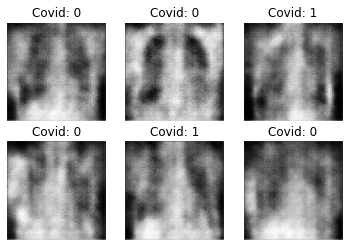

Epoch 102/300 Batch 6/6 [D loss: 0.66600, acc: 68.75%] [G loss: 0.71221]
Epoch 103/300 Batch 6/6 [D loss: 0.64942, acc: 65.62%] [G loss: 0.73756]
Epoch 104/300 Batch 6/6 [D loss: 0.62691, acc: 78.12%] [G loss: 0.72889]
Epoch 105/300 Batch 6/6 [D loss: 0.66404, acc: 65.62%] [G loss: 0.71922]
Epoch 106/300 Batch 6/6 [D loss: 0.66953, acc: 71.88%] [G loss: 0.71230]
Epoch 107/300 Batch 6/6 [D loss: 0.62441, acc: 59.38%] [G loss: 0.74788]
Epoch 108/300 Batch 6/6 [D loss: 0.69358, acc: 40.62%] [G loss: 0.73099]
Epoch 109/300 Batch 6/6 [D loss: 0.61026, acc: 68.75%] [G loss: 0.76253]
Epoch 110/300 Batch 6/6 [D loss: 0.67045, acc: 46.88%] [G loss: 0.71313]
Epoch 111/300 Batch 6/6 [D loss: 0.65888, acc: 56.25%] [G loss: 0.74616]
Epoch 112/300 Batch 6/6 [D loss: 0.65805, acc: 71.88%] [G loss: 0.77288]
Epoch 113/300 Batch 6/6 [D loss: 0.60657, acc: 84.38%] [G loss: 0.73294]
Epoch 114/300 Batch 6/6 [D loss: 0.62876, acc: 65.62%] [G loss: 0.69147]
Epoch 115/300 Batch 6/6 [D loss: 0.64347, acc: 59.3

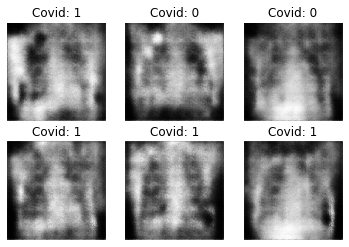

Epoch 122/300 Batch 6/6 [D loss: 0.63522, acc: 68.75%] [G loss: 0.73265]
Epoch 123/300 Batch 6/6 [D loss: 0.64450, acc: 62.50%] [G loss: 0.70763]
Epoch 124/300 Batch 6/6 [D loss: 0.66538, acc: 53.12%] [G loss: 0.78110]
Epoch 125/300 Batch 6/6 [D loss: 0.65407, acc: 50.00%] [G loss: 0.73216]
Epoch 126/300 Batch 6/6 [D loss: 0.61776, acc: 75.00%] [G loss: 0.72098]
Epoch 127/300 Batch 6/6 [D loss: 0.63233, acc: 62.50%] [G loss: 0.72434]
Epoch 128/300 Batch 6/6 [D loss: 0.63918, acc: 65.62%] [G loss: 0.74306]
Epoch 129/300 Batch 6/6 [D loss: 0.64408, acc: 65.62%] [G loss: 0.78553]
Epoch 130/300 Batch 6/6 [D loss: 0.63821, acc: 84.38%] [G loss: 0.76348]
Epoch 131/300 Batch 6/6 [D loss: 0.66875, acc: 56.25%] [G loss: 0.75881]
Epoch 132/300 Batch 6/6 [D loss: 0.60382, acc: 87.50%] [G loss: 0.79548]
Epoch 133/300 Batch 6/6 [D loss: 0.64972, acc: 62.50%] [G loss: 0.80131]
Epoch 134/300 Batch 6/6 [D loss: 0.62219, acc: 81.25%] [G loss: 0.83208]
Epoch 135/300 Batch 6/6 [D loss: 0.56978, acc: 81.2

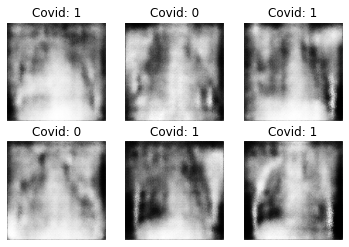

Epoch 142/300 Batch 6/6 [D loss: 0.55062, acc: 78.12%] [G loss: 1.13505]
Epoch 143/300 Batch 6/6 [D loss: 0.59660, acc: 75.00%] [G loss: 1.09172]
Epoch 144/300 Batch 6/6 [D loss: 0.58085, acc: 78.12%] [G loss: 1.24309]
Epoch 145/300 Batch 6/6 [D loss: 0.61823, acc: 71.88%] [G loss: 0.93570]
Epoch 146/300 Batch 6/6 [D loss: 0.56122, acc: 71.88%] [G loss: 1.05910]
Epoch 147/300 Batch 6/6 [D loss: 0.50032, acc: 87.50%] [G loss: 1.29337]
Epoch 148/300 Batch 6/6 [D loss: 0.59402, acc: 71.88%] [G loss: 1.25374]
Epoch 149/300 Batch 6/6 [D loss: 0.60909, acc: 65.62%] [G loss: 1.26513]
Epoch 150/300 Batch 6/6 [D loss: 0.47808, acc: 84.38%] [G loss: 1.20815]
Epoch 151/300 Batch 6/6 [D loss: 0.45164, acc: 87.50%] [G loss: 1.52897]
Epoch 152/300 Batch 6/6 [D loss: 0.38474, acc: 93.75%] [G loss: 1.48450]
Epoch 153/300 Batch 6/6 [D loss: 0.45630, acc: 81.25%] [G loss: 1.33159]
Epoch 154/300 Batch 6/6 [D loss: 0.44515, acc: 90.62%] [G loss: 1.47998]
Epoch 155/300 Batch 6/6 [D loss: 0.42532, acc: 84.3

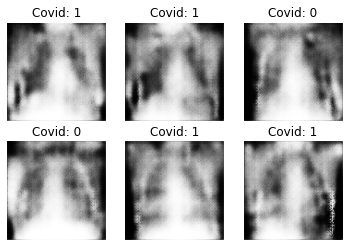

Epoch 162/300 Batch 6/6 [D loss: 0.43773, acc: 75.00%] [G loss: 1.99305]
Epoch 163/300 Batch 6/6 [D loss: 0.21981, acc: 96.88%] [G loss: 1.84423]
Epoch 164/300 Batch 6/6 [D loss: 0.43324, acc: 90.62%] [G loss: 1.46721]
Epoch 165/300 Batch 6/6 [D loss: 0.43791, acc: 81.25%] [G loss: 2.40773]
Epoch 166/300 Batch 6/6 [D loss: 0.32736, acc: 81.25%] [G loss: 2.43859]
Epoch 167/300 Batch 6/6 [D loss: 0.27470, acc: 93.75%] [G loss: 2.23061]
Epoch 168/300 Batch 6/6 [D loss: 0.85359, acc: 40.62%] [G loss: 1.04581]
Epoch 169/300 Batch 6/6 [D loss: 0.44149, acc: 75.00%] [G loss: 1.54577]
Epoch 170/300 Batch 6/6 [D loss: 0.60165, acc: 59.38%] [G loss: 0.91057]
Epoch 171/300 Batch 6/6 [D loss: 0.52054, acc: 78.12%] [G loss: 1.29039]
Epoch 172/300 Batch 6/6 [D loss: 0.56543, acc: 78.12%] [G loss: 1.22168]
Epoch 173/300 Batch 6/6 [D loss: 0.78903, acc: 56.25%] [G loss: 1.42132]
Epoch 174/300 Batch 6/6 [D loss: 0.62253, acc: 62.50%] [G loss: 0.97578]
Epoch 175/300 Batch 6/6 [D loss: 0.41493, acc: 87.5

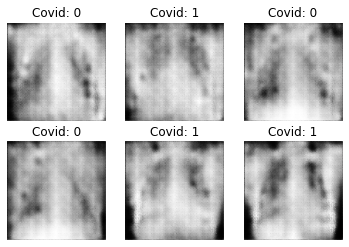

Epoch 182/300 Batch 6/6 [D loss: 0.61583, acc: 53.12%] [G loss: 0.82042]
Epoch 183/300 Batch 6/6 [D loss: 0.52151, acc: 75.00%] [G loss: 0.79947]
Epoch 184/300 Batch 6/6 [D loss: 0.73568, acc: 56.25%] [G loss: 0.70125]
Epoch 185/300 Batch 6/6 [D loss: 0.56445, acc: 65.62%] [G loss: 0.64411]
Epoch 186/300 Batch 6/6 [D loss: 0.60080, acc: 62.50%] [G loss: 0.66646]
Epoch 187/300 Batch 6/6 [D loss: 0.56314, acc: 46.88%] [G loss: 0.71960]
Epoch 188/300 Batch 6/6 [D loss: 0.56427, acc: 65.62%] [G loss: 0.76161]
Epoch 189/300 Batch 6/6 [D loss: 0.50273, acc: 81.25%] [G loss: 0.85301]
Epoch 190/300 Batch 6/6 [D loss: 0.61606, acc: 59.38%] [G loss: 0.85425]
Epoch 191/300 Batch 6/6 [D loss: 0.56846, acc: 71.88%] [G loss: 0.79470]
Epoch 192/300 Batch 6/6 [D loss: 0.57694, acc: 84.38%] [G loss: 0.87996]
Epoch 193/300 Batch 6/6 [D loss: 0.60507, acc: 65.62%] [G loss: 0.85216]
Epoch 194/300 Batch 6/6 [D loss: 0.59174, acc: 59.38%] [G loss: 0.90946]
Epoch 195/300 Batch 6/6 [D loss: 0.60541, acc: 59.3

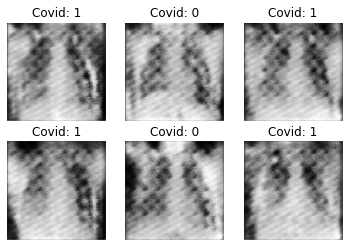

Epoch 202/300 Batch 6/6 [D loss: 0.41013, acc: 96.88%] [G loss: 0.96025]
Epoch 203/300 Batch 6/6 [D loss: 0.54403, acc: 81.25%] [G loss: 1.11038]
Epoch 204/300 Batch 6/6 [D loss: 0.57358, acc: 81.25%] [G loss: 0.92632]
Epoch 205/300 Batch 6/6 [D loss: 0.69338, acc: 56.25%] [G loss: 0.97784]
Epoch 206/300 Batch 6/6 [D loss: 0.58765, acc: 75.00%] [G loss: 0.89024]
Epoch 207/300 Batch 6/6 [D loss: 0.47382, acc: 93.75%] [G loss: 1.08345]
Epoch 208/300 Batch 6/6 [D loss: 0.60569, acc: 71.88%] [G loss: 0.97053]
Epoch 209/300 Batch 6/6 [D loss: 0.49853, acc: 81.25%] [G loss: 1.03920]
Epoch 210/300 Batch 6/6 [D loss: 0.54312, acc: 78.12%] [G loss: 0.91394]
Epoch 211/300 Batch 6/6 [D loss: 0.55715, acc: 68.75%] [G loss: 1.06560]
Epoch 212/300 Batch 6/6 [D loss: 0.59964, acc: 71.88%] [G loss: 0.91999]
Epoch 213/300 Batch 6/6 [D loss: 0.56262, acc: 78.12%] [G loss: 0.91971]
Epoch 214/300 Batch 6/6 [D loss: 0.55181, acc: 81.25%] [G loss: 0.96926]
Epoch 215/300 Batch 6/6 [D loss: 0.50117, acc: 87.5

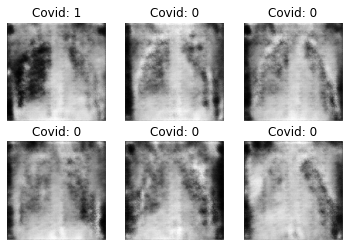

Epoch 222/300 Batch 6/6 [D loss: 0.55113, acc: 75.00%] [G loss: 1.01169]
Epoch 223/300 Batch 6/6 [D loss: 0.74453, acc: 62.50%] [G loss: 1.08177]
Epoch 224/300 Batch 6/6 [D loss: 0.58172, acc: 78.12%] [G loss: 1.04777]
Epoch 225/300 Batch 6/6 [D loss: 0.55926, acc: 75.00%] [G loss: 0.99187]
Epoch 226/300 Batch 6/6 [D loss: 0.67400, acc: 59.38%] [G loss: 0.87803]
Epoch 227/300 Batch 6/6 [D loss: 0.54524, acc: 71.88%] [G loss: 1.17858]
Epoch 228/300 Batch 6/6 [D loss: 0.50056, acc: 81.25%] [G loss: 1.02489]
Epoch 229/300 Batch 6/6 [D loss: 0.60433, acc: 71.88%] [G loss: 0.99248]
Epoch 230/300 Batch 6/6 [D loss: 0.72595, acc: 50.00%] [G loss: 0.90981]
Epoch 231/300 Batch 6/6 [D loss: 0.55531, acc: 75.00%] [G loss: 1.01574]
Epoch 232/300 Batch 6/6 [D loss: 0.67117, acc: 56.25%] [G loss: 1.01928]
Epoch 233/300 Batch 6/6 [D loss: 0.53002, acc: 78.12%] [G loss: 1.04664]
Epoch 234/300 Batch 6/6 [D loss: 0.49399, acc: 81.25%] [G loss: 1.08393]
Epoch 235/300 Batch 6/6 [D loss: 0.48753, acc: 90.6

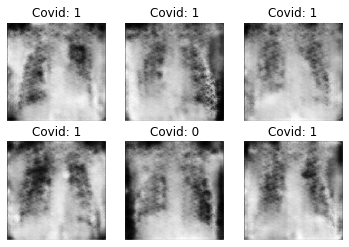

Epoch 242/300 Batch 6/6 [D loss: 0.50339, acc: 87.50%] [G loss: 1.27844]
Epoch 243/300 Batch 6/6 [D loss: 0.51280, acc: 84.38%] [G loss: 1.10809]
Epoch 244/300 Batch 6/6 [D loss: 0.58151, acc: 62.50%] [G loss: 0.98641]
Epoch 245/300 Batch 6/6 [D loss: 0.48596, acc: 81.25%] [G loss: 1.08478]
Epoch 246/300 Batch 6/6 [D loss: 0.57610, acc: 68.75%] [G loss: 1.24540]
Epoch 247/300 Batch 6/6 [D loss: 0.65684, acc: 65.62%] [G loss: 1.14943]
Epoch 248/300 Batch 6/6 [D loss: 0.61650, acc: 71.88%] [G loss: 1.04048]
Epoch 249/300 Batch 6/6 [D loss: 0.53020, acc: 84.38%] [G loss: 1.07475]
Epoch 250/300 Batch 6/6 [D loss: 0.49060, acc: 81.25%] [G loss: 1.14776]
Epoch 251/300 Batch 6/6 [D loss: 0.56115, acc: 62.50%] [G loss: 1.05791]
Epoch 252/300 Batch 6/6 [D loss: 0.55527, acc: 71.88%] [G loss: 1.00189]
Epoch 253/300 Batch 6/6 [D loss: 0.57181, acc: 62.50%] [G loss: 1.08384]
Epoch 254/300 Batch 6/6 [D loss: 0.60665, acc: 68.75%] [G loss: 0.97228]
Epoch 255/300 Batch 6/6 [D loss: 0.51031, acc: 90.6

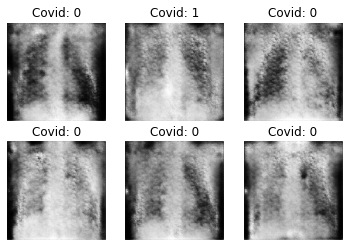

Epoch 262/300 Batch 6/6 [D loss: 0.50172, acc: 78.12%] [G loss: 0.98119]
Epoch 263/300 Batch 6/6 [D loss: 0.52647, acc: 78.12%] [G loss: 1.12453]
Epoch 264/300 Batch 6/6 [D loss: 0.48782, acc: 84.38%] [G loss: 1.02847]
Epoch 265/300 Batch 6/6 [D loss: 0.50922, acc: 84.38%] [G loss: 0.94360]
Epoch 266/300 Batch 6/6 [D loss: 0.55438, acc: 65.62%] [G loss: 1.18704]
Epoch 267/300 Batch 6/6 [D loss: 0.53368, acc: 75.00%] [G loss: 0.98628]
Epoch 268/300 Batch 6/6 [D loss: 0.52185, acc: 84.38%] [G loss: 1.01360]
Epoch 269/300 Batch 6/6 [D loss: 0.44066, acc: 90.62%] [G loss: 0.93754]
Epoch 270/300 Batch 6/6 [D loss: 0.49157, acc: 87.50%] [G loss: 0.94537]
Epoch 271/300 Batch 6/6 [D loss: 0.60741, acc: 56.25%] [G loss: 1.00833]
Epoch 272/300 Batch 6/6 [D loss: 0.43196, acc: 90.62%] [G loss: 1.05848]
Epoch 273/300 Batch 6/6 [D loss: 0.44849, acc: 84.38%] [G loss: 1.21105]
Epoch 274/300 Batch 6/6 [D loss: 0.46179, acc: 84.38%] [G loss: 1.32132]
Epoch 275/300 Batch 6/6 [D loss: 0.48294, acc: 78.1

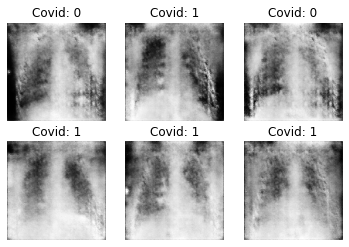

Epoch 282/300 Batch 6/6 [D loss: 0.52778, acc: 71.88%] [G loss: 1.10483]
Epoch 283/300 Batch 6/6 [D loss: 0.57060, acc: 71.88%] [G loss: 1.06005]
Epoch 284/300 Batch 6/6 [D loss: 0.46411, acc: 81.25%] [G loss: 1.05630]
Epoch 285/300 Batch 6/6 [D loss: 0.58615, acc: 75.00%] [G loss: 1.22347]
Epoch 286/300 Batch 6/6 [D loss: 0.51397, acc: 68.75%] [G loss: 1.20926]
Epoch 287/300 Batch 6/6 [D loss: 0.56926, acc: 62.50%] [G loss: 1.15875]
Epoch 288/300 Batch 6/6 [D loss: 0.65960, acc: 65.62%] [G loss: 0.84760]
Epoch 289/300 Batch 6/6 [D loss: 0.63256, acc: 68.75%] [G loss: 1.15114]
Epoch 290/300 Batch 6/6 [D loss: 0.64127, acc: 65.62%] [G loss: 0.84815]
Epoch 291/300 Batch 6/6 [D loss: 0.42112, acc: 96.88%] [G loss: 1.38126]
Epoch 292/300 Batch 6/6 [D loss: 0.46238, acc: 78.12%] [G loss: 1.15702]
Epoch 293/300 Batch 6/6 [D loss: 0.52674, acc: 75.00%] [G loss: 0.99290]
Epoch 294/300 Batch 6/6 [D loss: 0.48767, acc: 78.12%] [G loss: 1.16844]
Epoch 295/300 Batch 6/6 [D loss: 0.50530, acc: 75.0

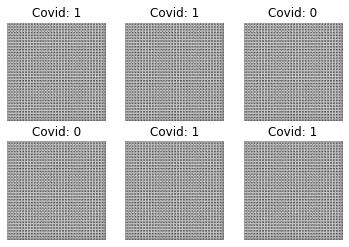

Epoch 2/300 Batch 3/3 [D loss: 253.88256, acc: 28.12%] [G loss: 568.81189]
Epoch 3/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 112.17699]
Epoch 4/300 Batch 3/3 [D loss: 114.25209, acc: 48.44%] [G loss: 66.75836]
Epoch 5/300 Batch 3/3 [D loss: 0.82107, acc: 92.19%] [G loss: 146.43799]
Epoch 6/300 Batch 3/3 [D loss: 0.96381, acc: 96.88%] [G loss: 6.24185]
Epoch 7/300 Batch 3/3 [D loss: 0.11668, acc: 98.44%] [G loss: 647.55750]
Epoch 8/300 Batch 3/3 [D loss: 0.21426, acc: 96.88%] [G loss: 548.80634]
Epoch 9/300 Batch 3/3 [D loss: 13.30207, acc: 75.00%] [G loss: 695.75861]
Epoch 10/300 Batch 3/3 [D loss: 8.68859, acc: 82.81%] [G loss: 178.99594]
Epoch 11/300 Batch 3/3 [D loss: 0.87505, acc: 90.62%] [G loss: 39.15900]
Epoch 12/300 Batch 3/3 [D loss: 3.02491, acc: 54.69%] [G loss: 55.32766]
Epoch 13/300 Batch 3/3 [D loss: 0.57466, acc: 93.75%] [G loss: 14.23917]
Epoch 14/300 Batch 3/3 [D loss: 0.82438, acc: 93.75%] [G loss: 10.79570]
Epoch 15/300 Batch 3/3 [D loss: 0.13711, acc: 9

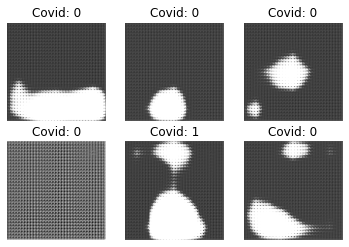

Epoch 22/300 Batch 3/3 [D loss: 0.13174, acc: 95.31%] [G loss: 4.68907]
Epoch 23/300 Batch 3/3 [D loss: 0.01667, acc: 100.00%] [G loss: 5.18204]
Epoch 24/300 Batch 3/3 [D loss: 0.08996, acc: 96.88%] [G loss: 5.23605]
Epoch 25/300 Batch 3/3 [D loss: 0.01281, acc: 100.00%] [G loss: 7.76294]
Epoch 26/300 Batch 3/3 [D loss: 0.04014, acc: 98.44%] [G loss: 6.05412]
Epoch 27/300 Batch 3/3 [D loss: 0.03816, acc: 98.44%] [G loss: 5.45162]
Epoch 28/300 Batch 3/3 [D loss: 0.02479, acc: 100.00%] [G loss: 7.04892]
Epoch 29/300 Batch 3/3 [D loss: 0.04170, acc: 98.44%] [G loss: 5.47087]
Epoch 30/300 Batch 3/3 [D loss: 0.00990, acc: 100.00%] [G loss: 7.09069]
Epoch 31/300 Batch 3/3 [D loss: 0.05888, acc: 98.44%] [G loss: 6.70929]
Epoch 32/300 Batch 3/3 [D loss: 0.06259, acc: 98.44%] [G loss: 5.83637]
Epoch 33/300 Batch 3/3 [D loss: 0.01861, acc: 100.00%] [G loss: 6.81937]
Epoch 34/300 Batch 3/3 [D loss: 0.60042, acc: 78.12%] [G loss: 17.40343]
Epoch 35/300 Batch 3/3 [D loss: 0.09523, acc: 98.44%] [G l

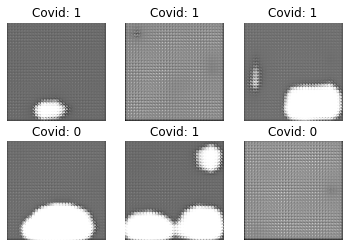

Epoch 42/300 Batch 3/3 [D loss: 0.00223, acc: 100.00%] [G loss: 6.41458]
Epoch 43/300 Batch 3/3 [D loss: 0.01483, acc: 98.44%] [G loss: 5.60373]
Epoch 44/300 Batch 3/3 [D loss: 0.05991, acc: 98.44%] [G loss: 5.22857]
Epoch 45/300 Batch 3/3 [D loss: 0.00449, acc: 100.00%] [G loss: 6.12926]
Epoch 46/300 Batch 3/3 [D loss: 0.02715, acc: 98.44%] [G loss: 6.06326]
Epoch 47/300 Batch 3/3 [D loss: 0.01890, acc: 100.00%] [G loss: 5.30214]
Epoch 48/300 Batch 3/3 [D loss: 0.02975, acc: 98.44%] [G loss: 4.95019]
Epoch 49/300 Batch 3/3 [D loss: 0.00203, acc: 100.00%] [G loss: 6.33513]
Epoch 50/300 Batch 3/3 [D loss: 0.05000, acc: 98.44%] [G loss: 5.06064]
Epoch 51/300 Batch 3/3 [D loss: 0.06191, acc: 96.88%] [G loss: 5.18739]
Epoch 52/300 Batch 3/3 [D loss: 0.04281, acc: 98.44%] [G loss: 5.44394]
Epoch 53/300 Batch 3/3 [D loss: 0.00098, acc: 100.00%] [G loss: 8.32652]
Epoch 54/300 Batch 3/3 [D loss: 0.08600, acc: 98.44%] [G loss: 5.84374]
Epoch 55/300 Batch 3/3 [D loss: 0.03463, acc: 98.44%] [G lo

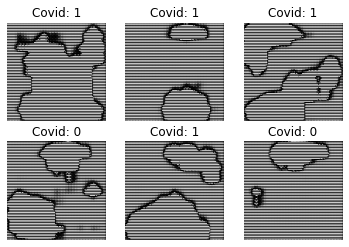

Epoch 62/300 Batch 3/3 [D loss: 17934.98340, acc: 89.06%] [G loss: 590787.37500]
Epoch 63/300 Batch 3/3 [D loss: 1097.94189, acc: 98.44%] [G loss: 618522.25000]
Epoch 64/300 Batch 3/3 [D loss: 2152.25049, acc: 98.44%] [G loss: 163470.29688]
Epoch 65/300 Batch 3/3 [D loss: 1587.65295, acc: 98.44%] [G loss: 303722.28125]
Epoch 66/300 Batch 3/3 [D loss: 1008.14557, acc: 98.44%] [G loss: 169017.90625]
Epoch 67/300 Batch 3/3 [D loss: 19254.22607, acc: 70.31%] [G loss: 428827.37500]
Epoch 68/300 Batch 3/3 [D loss: 13811.27344, acc: 95.31%] [G loss: 414820.87500]
Epoch 69/300 Batch 3/3 [D loss: 5594.69678, acc: 96.88%] [G loss: 162968.26562]
Epoch 70/300 Batch 3/3 [D loss: 206.03922, acc: 95.31%] [G loss: 120898.24219]
Epoch 71/300 Batch 3/3 [D loss: 3542.18311, acc: 84.38%] [G loss: 198503.06250]
Epoch 72/300 Batch 3/3 [D loss: 16050.02338, acc: 62.50%] [G loss: 190061.68750]
Epoch 73/300 Batch 3/3 [D loss: 19883.92773, acc: 76.56%] [G loss: 133994.95312]
Epoch 74/300 Batch 3/3 [D loss: 88.3

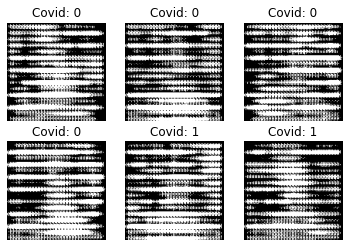

Epoch 82/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 58730.95312]
Epoch 83/300 Batch 3/3 [D loss: 6155.11987, acc: 56.25%] [G loss: 39677.11719]
Epoch 84/300 Batch 3/3 [D loss: 24591.69336, acc: 7.81%] [G loss: 103877.17188]
Epoch 85/300 Batch 3/3 [D loss: 6739.38721, acc: 76.56%] [G loss: 22057.00000]
Epoch 86/300 Batch 3/3 [D loss: 2218.71387, acc: 84.38%] [G loss: 44436.63281]
Epoch 87/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 23693.32031]
Epoch 88/300 Batch 3/3 [D loss: 105.26004, acc: 98.44%] [G loss: 38848.46875]
Epoch 89/300 Batch 3/3 [D loss: 1468.58569, acc: 85.94%] [G loss: 24982.37500]
Epoch 90/300 Batch 3/3 [D loss: 849.47942, acc: 84.38%] [G loss: 34072.84766]
Epoch 91/300 Batch 3/3 [D loss: 420.15893, acc: 84.38%] [G loss: 51445.17188]
Epoch 92/300 Batch 3/3 [D loss: 119.33086, acc: 98.44%] [G loss: 22869.96289]
Epoch 93/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 16541.49219]
Epoch 94/300 Batch 3/3 [D loss: 743.52063, acc: 90.62%] [G lo

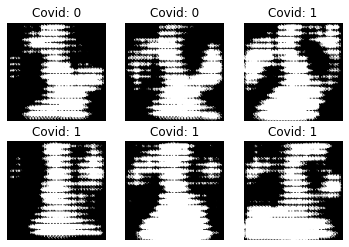

Epoch 102/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 29227.53125]
Epoch 103/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 35999.89062]
Epoch 104/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 25639.16211]
Epoch 105/300 Batch 3/3 [D loss: 189.27061, acc: 96.88%] [G loss: 36479.33203]
Epoch 106/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 24751.44922]
Epoch 107/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 23635.12109]
Epoch 108/300 Batch 3/3 [D loss: 68.77461, acc: 98.44%] [G loss: 28662.50781]
Epoch 109/300 Batch 3/3 [D loss: 6.33105, acc: 98.44%] [G loss: 26055.14258]
Epoch 110/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 26362.34375]
Epoch 111/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 19661.72656]
Epoch 112/300 Batch 3/3 [D loss: 1179.35400, acc: 85.94%] [G loss: 13651.48438]
Epoch 113/300 Batch 3/3 [D loss: 70.93208, acc: 98.44%] [G loss: 36165.38281]
Epoch 114/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G los

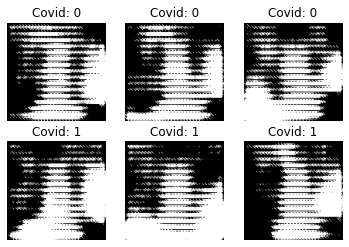

Epoch 122/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 19655.70312]
Epoch 123/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 16328.12402]
Epoch 124/300 Batch 3/3 [D loss: 1191.89502, acc: 87.50%] [G loss: 35830.14844]
Epoch 125/300 Batch 3/3 [D loss: 75.53599, acc: 98.44%] [G loss: 26439.78516]
Epoch 126/300 Batch 3/3 [D loss: 137.93442, acc: 98.44%] [G loss: 16837.63867]
Epoch 127/300 Batch 3/3 [D loss: 6.25607, acc: 98.44%] [G loss: 16353.68848]
Epoch 128/300 Batch 3/3 [D loss: 8953.81250, acc: 50.00%] [G loss: 506.90894]
Epoch 129/300 Batch 3/3 [D loss: 7077.87939, acc: 60.94%] [G loss: 18039.65234]
Epoch 130/300 Batch 3/3 [D loss: 273.11661, acc: 98.44%] [G loss: 60125.66016]
Epoch 131/300 Batch 3/3 [D loss: 158.55731, acc: 98.44%] [G loss: 30592.42188]
Epoch 132/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 21805.20898]
Epoch 133/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 19640.82031]
Epoch 134/300 Batch 3/3 [D loss: 91.78262, acc: 98.44%] [G

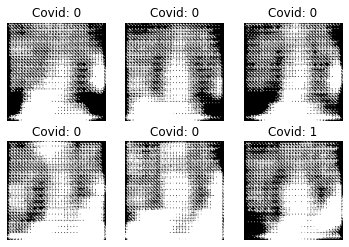

Epoch 142/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 13136.77539]
Epoch 143/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 15274.74902]
Epoch 144/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 13073.96582]
Epoch 145/300 Batch 3/3 [D loss: 3.73805, acc: 98.44%] [G loss: 12439.09375]
Epoch 146/300 Batch 3/3 [D loss: 173.67439, acc: 96.88%] [G loss: 14878.78906]
Epoch 147/300 Batch 3/3 [D loss: 172.30427, acc: 93.75%] [G loss: 19813.66406]
Epoch 148/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 12719.16113]
Epoch 149/300 Batch 3/3 [D loss: 4.76220, acc: 98.44%] [G loss: 12737.24707]
Epoch 150/300 Batch 3/3 [D loss: 30.64820, acc: 98.44%] [G loss: 7996.75098]
Epoch 151/300 Batch 3/3 [D loss: 22.18225, acc: 98.44%] [G loss: 13784.26074]
Epoch 152/300 Batch 3/3 [D loss: 40.10990, acc: 95.31%] [G loss: 7773.33154]
Epoch 153/300 Batch 3/3 [D loss: 11.15215, acc: 98.44%] [G loss: 14533.44336]
Epoch 154/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 9

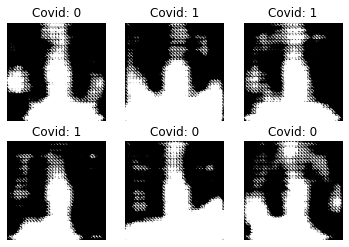

Epoch 162/300 Batch 3/3 [D loss: 19.08470, acc: 98.44%] [G loss: 55834.90234]
Epoch 163/300 Batch 3/3 [D loss: 24.26739, acc: 96.88%] [G loss: 47785.47266]
Epoch 164/300 Batch 3/3 [D loss: 391.59531, acc: 92.19%] [G loss: 15014.22949]
Epoch 165/300 Batch 3/3 [D loss: 14061.64636, acc: 43.75%] [G loss: 45064.50000]
Epoch 166/300 Batch 3/3 [D loss: 62.68573, acc: 98.44%] [G loss: 16142.74219]
Epoch 167/300 Batch 3/3 [D loss: 56.54210, acc: 96.88%] [G loss: 16899.70312]
Epoch 168/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 19688.82031]
Epoch 169/300 Batch 3/3 [D loss: 33.81146, acc: 98.44%] [G loss: 18265.24805]
Epoch 170/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 20007.07617]
Epoch 171/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 14509.72559]
Epoch 172/300 Batch 3/3 [D loss: 65.75145, acc: 98.44%] [G loss: 17937.31055]
Epoch 173/300 Batch 3/3 [D loss: 71.12435, acc: 98.44%] [G loss: 16735.55273]
Epoch 174/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G l

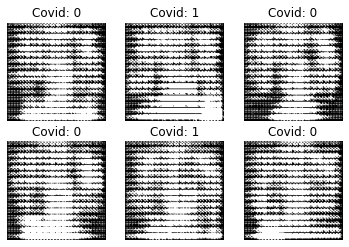

Epoch 182/300 Batch 3/3 [D loss: 13.72430, acc: 96.88%] [G loss: 18938.74023]
Epoch 183/300 Batch 3/3 [D loss: 30.48640, acc: 98.44%] [G loss: 15624.55469]
Epoch 184/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 20350.11914]
Epoch 185/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 15170.73145]
Epoch 186/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 12121.10547]
Epoch 187/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 32530.29688]
Epoch 188/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 21256.31250]
Epoch 189/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 18329.27148]
Epoch 190/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 15504.21484]
Epoch 191/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 13799.88867]
Epoch 192/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 16089.98828]
Epoch 193/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 22877.66016]
Epoch 194/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss:

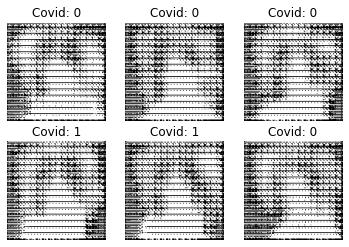

Epoch 202/300 Batch 3/3 [D loss: 22.79987, acc: 98.44%] [G loss: 108762.56250]
Epoch 203/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 91003.60938]
Epoch 204/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 70514.36719]
Epoch 205/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 48523.39453]
Epoch 206/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 30641.06250]
Epoch 207/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 19107.85156]
Epoch 208/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 36916.63281]
Epoch 209/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 31120.42969]
Epoch 210/300 Batch 3/3 [D loss: 25.33599, acc: 98.44%] [G loss: 25031.23047]
Epoch 211/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 23653.55469]
Epoch 212/300 Batch 3/3 [D loss: 16.24968, acc: 98.44%] [G loss: 36980.54688]
Epoch 213/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 19966.12109]
Epoch 214/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss

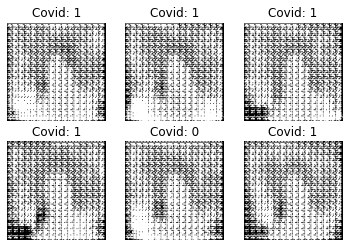

Epoch 222/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 22996.45117]
Epoch 223/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 18132.63672]
Epoch 224/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 12879.79688]
Epoch 225/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 68260.23438]
Epoch 226/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 35652.34375]
Epoch 227/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 29744.41797]
Epoch 228/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 26031.91211]
Epoch 229/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 28632.96875]
Epoch 230/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 20301.85352]
Epoch 231/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 17461.41406]
Epoch 232/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 17840.70117]
Epoch 233/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 8405.04102]
Epoch 234/300 Batch 3/3 [D loss: 1923.41113, acc: 90.62%] [G loss

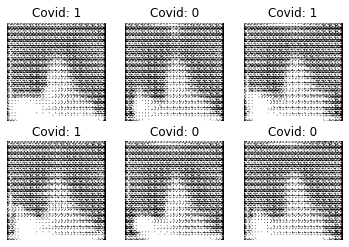

Epoch 242/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 12080.03418]
Epoch 243/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 10069.93750]
Epoch 244/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 21509.74609]
Epoch 245/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 14471.79395]
Epoch 246/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 11612.89844]
Epoch 247/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 10914.58789]
Epoch 248/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 10035.04688]
Epoch 249/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 8824.50195]
Epoch 250/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 32805.34375]
Epoch 251/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 19872.33984]
Epoch 252/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 19860.58203]
Epoch 253/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 19565.22656]
Epoch 254/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 

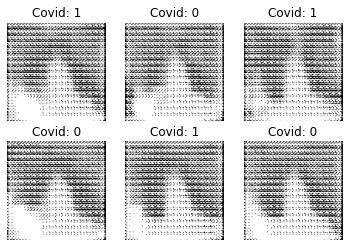

Epoch 262/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 14132.35938]
Epoch 263/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 13367.94336]
Epoch 264/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 22882.61328]
Epoch 265/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 25200.98828]
Epoch 266/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 25394.39648]
Epoch 267/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 14134.82812]
Epoch 268/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 12802.83887]
Epoch 269/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 12143.90820]
Epoch 270/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 12702.73633]
Epoch 271/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 12605.48438]
Epoch 272/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 9122.75195]
Epoch 273/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 7454.68457]
Epoch 274/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 2

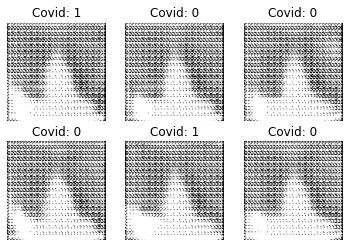

Epoch 282/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 19232.54883]
Epoch 283/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 13020.83008]
Epoch 284/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 12837.58203]
Epoch 285/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 14331.61523]
Epoch 286/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 11355.90430]
Epoch 287/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 17517.68359]
Epoch 288/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 12592.43457]
Epoch 289/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 10584.59668]
Epoch 290/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 10328.69922]
Epoch 291/300 Batch 3/3 [D loss: 27.50990, acc: 98.44%] [G loss: 8734.28809]
Epoch 292/300 Batch 3/3 [D loss: 94.62983, acc: 98.44%] [G loss: 57691.35156]
Epoch 293/300 Batch 3/3 [D loss: 36.90919, acc: 96.88%] [G loss: 31792.12109]
Epoch 294/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 

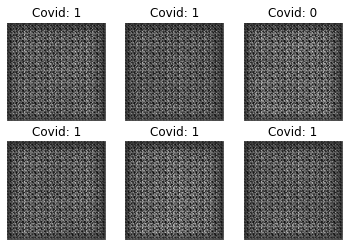

Epoch 2/300 Batch 3/3 [D loss: 0.03813, acc: 100.00%] [G loss: 10.41769]
Epoch 3/300 Batch 3/3 [D loss: 0.06557, acc: 100.00%] [G loss: 15.40725]
Epoch 4/300 Batch 3/3 [D loss: 0.00029, acc: 100.00%] [G loss: 10.50179]
Epoch 5/300 Batch 3/3 [D loss: 0.00012, acc: 100.00%] [G loss: 11.11713]
Epoch 6/300 Batch 3/3 [D loss: 0.27150, acc: 95.31%] [G loss: 20.43718]
Epoch 7/300 Batch 3/3 [D loss: 0.02719, acc: 100.00%] [G loss: 0.55255]
Epoch 8/300 Batch 3/3 [D loss: 0.00108, acc: 100.00%] [G loss: 11.01809]
Epoch 9/300 Batch 3/3 [D loss: 0.00168, acc: 100.00%] [G loss: 7.45140]
Epoch 10/300 Batch 3/3 [D loss: 0.01616, acc: 100.00%] [G loss: 4.80536]
Epoch 11/300 Batch 3/3 [D loss: 0.43747, acc: 95.31%] [G loss: 7.60694]
Epoch 12/300 Batch 3/3 [D loss: 1.15937, acc: 65.62%] [G loss: 13.42898]
Epoch 13/300 Batch 3/3 [D loss: 0.00353, acc: 100.00%] [G loss: 10.84515]
Epoch 14/300 Batch 3/3 [D loss: 0.13234, acc: 98.44%] [G loss: 2.73960]
Epoch 15/300 Batch 3/3 [D loss: 1.42757, acc: 78.12%] [

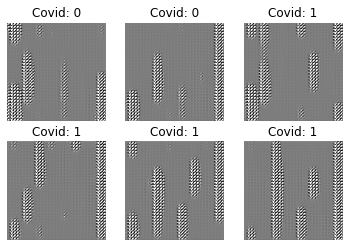

Epoch 22/300 Batch 3/3 [D loss: 0.35269, acc: 78.12%] [G loss: 4.88148]
Epoch 23/300 Batch 3/3 [D loss: 0.01318, acc: 100.00%] [G loss: 5.56524]
Epoch 24/300 Batch 3/3 [D loss: 0.03200, acc: 98.44%] [G loss: 3.93460]
Epoch 25/300 Batch 3/3 [D loss: 0.01243, acc: 100.00%] [G loss: 5.39781]
Epoch 26/300 Batch 3/3 [D loss: 0.01054, acc: 100.00%] [G loss: 5.29359]
Epoch 27/300 Batch 3/3 [D loss: 0.01420, acc: 100.00%] [G loss: 5.39527]
Epoch 28/300 Batch 3/3 [D loss: 0.01307, acc: 100.00%] [G loss: 5.48673]
Epoch 29/300 Batch 3/3 [D loss: 0.00727, acc: 100.00%] [G loss: 7.48836]
Epoch 30/300 Batch 3/3 [D loss: 0.10659, acc: 98.44%] [G loss: 21.46171]
Epoch 31/300 Batch 3/3 [D loss: 0.98684, acc: 73.44%] [G loss: 33.48172]
Epoch 32/300 Batch 3/3 [D loss: 0.44178, acc: 87.50%] [G loss: 10.06207]
Epoch 33/300 Batch 3/3 [D loss: 0.05869, acc: 98.44%] [G loss: 6.15208]
Epoch 34/300 Batch 3/3 [D loss: 0.07488, acc: 98.44%] [G loss: 5.57969]
Epoch 35/300 Batch 3/3 [D loss: 0.26475, acc: 90.62%] [

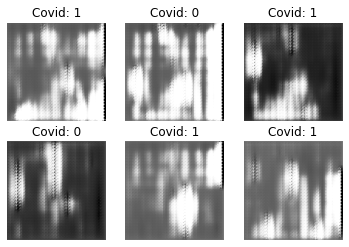

Epoch 42/300 Batch 3/3 [D loss: 0.79754, acc: 67.19%] [G loss: 3.17513]
Epoch 43/300 Batch 3/3 [D loss: 0.16375, acc: 92.19%] [G loss: 3.04386]
Epoch 44/300 Batch 3/3 [D loss: 0.12093, acc: 95.31%] [G loss: 3.15596]
Epoch 45/300 Batch 3/3 [D loss: 0.11278, acc: 98.44%] [G loss: 3.39078]
Epoch 46/300 Batch 3/3 [D loss: 0.10111, acc: 96.88%] [G loss: 3.82553]
Epoch 47/300 Batch 3/3 [D loss: 0.16651, acc: 92.19%] [G loss: 4.42811]
Epoch 48/300 Batch 3/3 [D loss: 0.65769, acc: 76.56%] [G loss: 9.80118]
Epoch 49/300 Batch 3/3 [D loss: 0.53971, acc: 79.69%] [G loss: 2.48693]
Epoch 50/300 Batch 3/3 [D loss: 0.35870, acc: 85.94%] [G loss: 2.83845]
Epoch 51/300 Batch 3/3 [D loss: 0.43679, acc: 81.25%] [G loss: 2.08690]
Epoch 52/300 Batch 3/3 [D loss: 0.32655, acc: 84.38%] [G loss: 2.00751]
Epoch 53/300 Batch 3/3 [D loss: 0.46355, acc: 76.56%] [G loss: 3.51267]
Epoch 54/300 Batch 3/3 [D loss: 0.33638, acc: 89.06%] [G loss: 3.77110]
Epoch 55/300 Batch 3/3 [D loss: 0.41712, acc: 82.81%] [G loss: 2

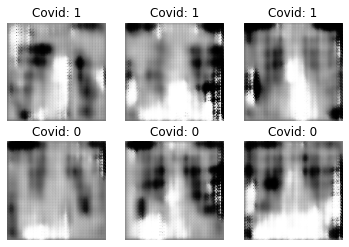

Epoch 62/300 Batch 3/3 [D loss: 0.53720, acc: 78.12%] [G loss: 1.99062]
Epoch 63/300 Batch 3/3 [D loss: 0.51403, acc: 73.44%] [G loss: 2.20839]
Epoch 64/300 Batch 3/3 [D loss: 0.40942, acc: 85.94%] [G loss: 1.91002]
Epoch 65/300 Batch 3/3 [D loss: 0.48931, acc: 75.00%] [G loss: 1.89591]
Epoch 66/300 Batch 3/3 [D loss: 0.43870, acc: 75.00%] [G loss: 2.60302]
Epoch 67/300 Batch 3/3 [D loss: 0.38119, acc: 84.38%] [G loss: 2.62990]
Epoch 68/300 Batch 3/3 [D loss: 0.68062, acc: 62.50%] [G loss: 1.92683]
Epoch 69/300 Batch 3/3 [D loss: 0.37054, acc: 85.94%] [G loss: 2.08158]
Epoch 70/300 Batch 3/3 [D loss: 0.27496, acc: 92.19%] [G loss: 2.61166]
Epoch 71/300 Batch 3/3 [D loss: 0.33911, acc: 85.94%] [G loss: 3.57122]
Epoch 72/300 Batch 3/3 [D loss: 0.45197, acc: 79.69%] [G loss: 3.28619]
Epoch 73/300 Batch 3/3 [D loss: 0.42578, acc: 81.25%] [G loss: 2.35405]
Epoch 74/300 Batch 3/3 [D loss: 0.43168, acc: 81.25%] [G loss: 2.66351]
Epoch 75/300 Batch 3/3 [D loss: 0.66652, acc: 57.81%] [G loss: 2

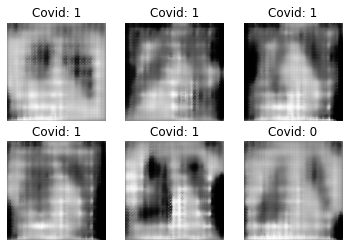

Epoch 82/300 Batch 3/3 [D loss: 0.39897, acc: 82.81%] [G loss: 1.80431]
Epoch 83/300 Batch 3/3 [D loss: 0.49743, acc: 81.25%] [G loss: 2.58305]
Epoch 84/300 Batch 3/3 [D loss: 0.34299, acc: 89.06%] [G loss: 2.13790]
Epoch 85/300 Batch 3/3 [D loss: 0.37876, acc: 81.25%] [G loss: 2.50350]
Epoch 86/300 Batch 3/3 [D loss: 0.33561, acc: 89.06%] [G loss: 2.14872]
Epoch 87/300 Batch 3/3 [D loss: 0.35375, acc: 84.38%] [G loss: 2.06966]
Epoch 88/300 Batch 3/3 [D loss: 0.23468, acc: 95.31%] [G loss: 2.93520]
Epoch 89/300 Batch 3/3 [D loss: 0.30690, acc: 89.06%] [G loss: 2.20769]
Epoch 90/300 Batch 3/3 [D loss: 0.27278, acc: 92.19%] [G loss: 2.82336]
Epoch 91/300 Batch 3/3 [D loss: 0.34892, acc: 84.38%] [G loss: 2.44405]
Epoch 92/300 Batch 3/3 [D loss: 0.25329, acc: 90.62%] [G loss: 2.91504]
Epoch 93/300 Batch 3/3 [D loss: 0.74950, acc: 64.06%] [G loss: 2.91949]
Epoch 94/300 Batch 3/3 [D loss: 0.46225, acc: 73.44%] [G loss: 4.46243]
Epoch 95/300 Batch 3/3 [D loss: 0.09089, acc: 98.44%] [G loss: 3

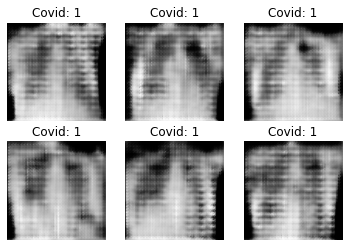

Epoch 102/300 Batch 3/3 [D loss: 0.39557, acc: 85.94%] [G loss: 3.30918]
Epoch 103/300 Batch 3/3 [D loss: 0.39518, acc: 81.25%] [G loss: 2.70930]
Epoch 104/300 Batch 3/3 [D loss: 0.26155, acc: 92.19%] [G loss: 3.30046]
Epoch 105/300 Batch 3/3 [D loss: 0.19512, acc: 96.88%] [G loss: 2.57987]
Epoch 106/300 Batch 3/3 [D loss: 0.50304, acc: 81.25%] [G loss: 2.29208]
Epoch 107/300 Batch 3/3 [D loss: 0.48591, acc: 79.69%] [G loss: 2.21052]
Epoch 108/300 Batch 3/3 [D loss: 0.29250, acc: 90.62%] [G loss: 2.60241]
Epoch 109/300 Batch 3/3 [D loss: 0.23497, acc: 96.88%] [G loss: 2.89308]
Epoch 110/300 Batch 3/3 [D loss: 0.31506, acc: 84.38%] [G loss: 2.74371]
Epoch 111/300 Batch 3/3 [D loss: 0.31943, acc: 87.50%] [G loss: 3.66138]
Epoch 112/300 Batch 3/3 [D loss: 0.43530, acc: 79.69%] [G loss: 3.04922]
Epoch 113/300 Batch 3/3 [D loss: 0.19055, acc: 96.88%] [G loss: 3.01040]
Epoch 114/300 Batch 3/3 [D loss: 0.34233, acc: 81.25%] [G loss: 2.61240]
Epoch 115/300 Batch 3/3 [D loss: 0.17495, acc: 95.3

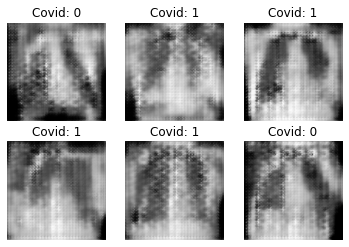

Epoch 122/300 Batch 3/3 [D loss: 0.30919, acc: 89.06%] [G loss: 2.69885]
Epoch 123/300 Batch 3/3 [D loss: 0.28401, acc: 85.94%] [G loss: 2.69200]
Epoch 124/300 Batch 3/3 [D loss: 0.27056, acc: 93.75%] [G loss: 2.57138]
Epoch 125/300 Batch 3/3 [D loss: 0.25913, acc: 90.62%] [G loss: 2.95531]
Epoch 126/300 Batch 3/3 [D loss: 0.24578, acc: 95.31%] [G loss: 3.03598]
Epoch 127/300 Batch 3/3 [D loss: 0.39103, acc: 84.38%] [G loss: 2.80798]
Epoch 128/300 Batch 3/3 [D loss: 0.26889, acc: 93.75%] [G loss: 3.20514]
Epoch 129/300 Batch 3/3 [D loss: 0.25851, acc: 92.19%] [G loss: 2.79033]
Epoch 130/300 Batch 3/3 [D loss: 0.28875, acc: 93.75%] [G loss: 2.96717]
Epoch 131/300 Batch 3/3 [D loss: 0.22633, acc: 92.19%] [G loss: 2.90274]
Epoch 132/300 Batch 3/3 [D loss: 0.22043, acc: 93.75%] [G loss: 3.66827]
Epoch 133/300 Batch 3/3 [D loss: 0.38607, acc: 76.56%] [G loss: 3.91148]
Epoch 134/300 Batch 3/3 [D loss: 0.21774, acc: 89.06%] [G loss: 2.77267]
Epoch 135/300 Batch 3/3 [D loss: 0.17646, acc: 93.7

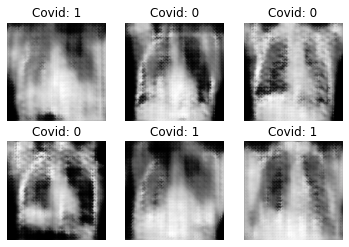

Epoch 142/300 Batch 3/3 [D loss: 0.30762, acc: 84.38%] [G loss: 2.65137]
Epoch 143/300 Batch 3/3 [D loss: 0.27619, acc: 89.06%] [G loss: 2.98010]
Epoch 144/300 Batch 3/3 [D loss: 0.18808, acc: 95.31%] [G loss: 3.29221]
Epoch 145/300 Batch 3/3 [D loss: 0.37978, acc: 81.25%] [G loss: 3.91592]
Epoch 146/300 Batch 3/3 [D loss: 0.21825, acc: 95.31%] [G loss: 3.29906]
Epoch 147/300 Batch 3/3 [D loss: 0.35506, acc: 81.25%] [G loss: 3.26365]
Epoch 148/300 Batch 3/3 [D loss: 0.18365, acc: 95.31%] [G loss: 3.51938]
Epoch 149/300 Batch 3/3 [D loss: 0.39599, acc: 79.69%] [G loss: 2.97313]
Epoch 150/300 Batch 3/3 [D loss: 0.16968, acc: 96.88%] [G loss: 3.40626]
Epoch 151/300 Batch 3/3 [D loss: 0.35655, acc: 82.81%] [G loss: 2.66274]
Epoch 152/300 Batch 3/3 [D loss: 0.27266, acc: 89.06%] [G loss: 3.15292]
Epoch 153/300 Batch 3/3 [D loss: 0.39036, acc: 79.69%] [G loss: 3.41827]
Epoch 154/300 Batch 3/3 [D loss: 0.42472, acc: 78.12%] [G loss: 3.28660]
Epoch 155/300 Batch 3/3 [D loss: 0.35299, acc: 85.9

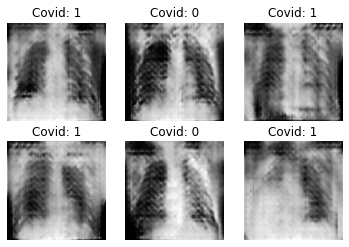

Epoch 162/300 Batch 3/3 [D loss: 0.78772, acc: 59.38%] [G loss: 2.44948]
Epoch 163/300 Batch 3/3 [D loss: 0.35692, acc: 85.94%] [G loss: 1.99647]
Epoch 164/300 Batch 3/3 [D loss: 0.24373, acc: 95.31%] [G loss: 2.59077]
Epoch 165/300 Batch 3/3 [D loss: 0.30829, acc: 87.50%] [G loss: 2.05128]
Epoch 166/300 Batch 3/3 [D loss: 0.45132, acc: 75.00%] [G loss: 2.32852]
Epoch 167/300 Batch 3/3 [D loss: 0.38177, acc: 87.50%] [G loss: 2.97352]
Epoch 168/300 Batch 3/3 [D loss: 0.40327, acc: 78.12%] [G loss: 3.42024]
Epoch 169/300 Batch 3/3 [D loss: 0.27560, acc: 96.88%] [G loss: 2.73600]
Epoch 170/300 Batch 3/3 [D loss: 0.24840, acc: 92.19%] [G loss: 2.70496]
Epoch 171/300 Batch 3/3 [D loss: 0.33614, acc: 85.94%] [G loss: 2.96961]
Epoch 172/300 Batch 3/3 [D loss: 0.33303, acc: 85.94%] [G loss: 2.93937]
Epoch 173/300 Batch 3/3 [D loss: 0.43161, acc: 71.88%] [G loss: 2.54775]
Epoch 174/300 Batch 3/3 [D loss: 0.34543, acc: 85.94%] [G loss: 2.75134]
Epoch 175/300 Batch 3/3 [D loss: 0.45897, acc: 84.3

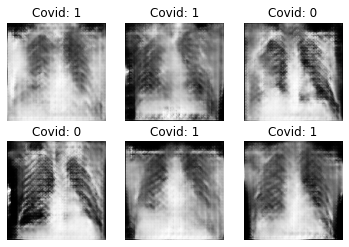

Epoch 182/300 Batch 3/3 [D loss: 0.49896, acc: 70.31%] [G loss: 2.82276]
Epoch 183/300 Batch 3/3 [D loss: 0.27546, acc: 89.06%] [G loss: 2.07766]
Epoch 184/300 Batch 3/3 [D loss: 0.30976, acc: 93.75%] [G loss: 2.59073]
Epoch 185/300 Batch 3/3 [D loss: 0.34532, acc: 82.81%] [G loss: 2.97225]
Epoch 186/300 Batch 3/3 [D loss: 0.42393, acc: 82.81%] [G loss: 3.29636]
Epoch 187/300 Batch 3/3 [D loss: 0.43661, acc: 82.81%] [G loss: 3.69207]
Epoch 188/300 Batch 3/3 [D loss: 0.41632, acc: 79.69%] [G loss: 3.22591]
Epoch 189/300 Batch 3/3 [D loss: 0.31358, acc: 84.38%] [G loss: 2.74843]
Epoch 190/300 Batch 3/3 [D loss: 0.40979, acc: 85.94%] [G loss: 2.39502]
Epoch 191/300 Batch 3/3 [D loss: 0.34833, acc: 84.38%] [G loss: 2.98950]
Epoch 192/300 Batch 3/3 [D loss: 0.40079, acc: 81.25%] [G loss: 4.50249]
Epoch 193/300 Batch 3/3 [D loss: 0.25895, acc: 84.38%] [G loss: 3.39458]
Epoch 194/300 Batch 3/3 [D loss: 0.34388, acc: 87.50%] [G loss: 2.64093]
Epoch 195/300 Batch 3/3 [D loss: 0.49091, acc: 73.4

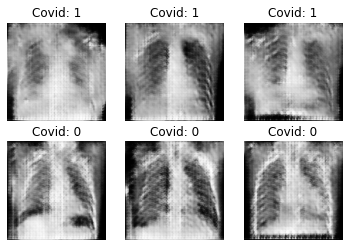

Epoch 202/300 Batch 3/3 [D loss: 0.37322, acc: 82.81%] [G loss: 4.17135]
Epoch 203/300 Batch 3/3 [D loss: 0.48265, acc: 71.88%] [G loss: 2.35327]
Epoch 204/300 Batch 3/3 [D loss: 0.37068, acc: 84.38%] [G loss: 3.08796]
Epoch 205/300 Batch 3/3 [D loss: 0.38748, acc: 82.81%] [G loss: 2.15271]
Epoch 206/300 Batch 3/3 [D loss: 0.34646, acc: 89.06%] [G loss: 2.54580]
Epoch 207/300 Batch 3/3 [D loss: 0.45775, acc: 71.88%] [G loss: 3.29741]
Epoch 208/300 Batch 3/3 [D loss: 0.36627, acc: 89.06%] [G loss: 4.32873]
Epoch 209/300 Batch 3/3 [D loss: 0.21739, acc: 93.75%] [G loss: 2.62016]
Epoch 210/300 Batch 3/3 [D loss: 0.45522, acc: 78.12%] [G loss: 2.33058]
Epoch 211/300 Batch 3/3 [D loss: 0.31678, acc: 92.19%] [G loss: 3.48861]
Epoch 212/300 Batch 3/3 [D loss: 0.32830, acc: 89.06%] [G loss: 4.73259]
Epoch 213/300 Batch 3/3 [D loss: 0.26953, acc: 93.75%] [G loss: 3.05716]
Epoch 214/300 Batch 3/3 [D loss: 0.28170, acc: 92.19%] [G loss: 3.18846]
Epoch 215/300 Batch 3/3 [D loss: 0.36038, acc: 82.8

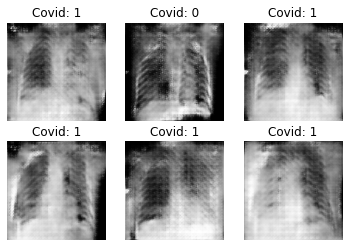

Epoch 222/300 Batch 3/3 [D loss: 0.37739, acc: 82.81%] [G loss: 3.53513]
Epoch 223/300 Batch 3/3 [D loss: 0.24650, acc: 92.19%] [G loss: 3.25960]
Epoch 224/300 Batch 3/3 [D loss: 0.29796, acc: 87.50%] [G loss: 3.76552]
Epoch 225/300 Batch 3/3 [D loss: 0.43005, acc: 81.25%] [G loss: 3.22127]
Epoch 226/300 Batch 3/3 [D loss: 0.25890, acc: 92.19%] [G loss: 3.14548]
Epoch 227/300 Batch 3/3 [D loss: 0.35601, acc: 84.38%] [G loss: 3.13737]
Epoch 228/300 Batch 3/3 [D loss: 0.23426, acc: 93.75%] [G loss: 3.23672]
Epoch 229/300 Batch 3/3 [D loss: 0.38636, acc: 82.81%] [G loss: 3.53068]
Epoch 230/300 Batch 3/3 [D loss: 0.33738, acc: 87.50%] [G loss: 3.67885]
Epoch 231/300 Batch 3/3 [D loss: 0.56913, acc: 68.75%] [G loss: 4.57577]
Epoch 232/300 Batch 3/3 [D loss: 0.25678, acc: 89.06%] [G loss: 3.56597]
Epoch 233/300 Batch 3/3 [D loss: 0.19512, acc: 96.88%] [G loss: 3.24907]
Epoch 234/300 Batch 3/3 [D loss: 0.31362, acc: 89.06%] [G loss: 2.96879]
Epoch 235/300 Batch 3/3 [D loss: 0.38503, acc: 82.8

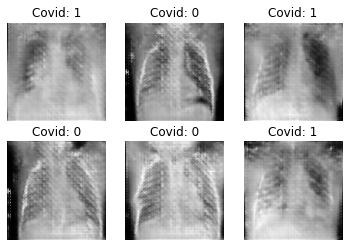

Epoch 242/300 Batch 3/3 [D loss: 0.21836, acc: 90.62%] [G loss: 3.08582]
Epoch 243/300 Batch 3/3 [D loss: 0.55295, acc: 70.31%] [G loss: 3.83501]
Epoch 244/300 Batch 3/3 [D loss: 0.22162, acc: 96.88%] [G loss: 3.66058]
Epoch 245/300 Batch 3/3 [D loss: 0.32947, acc: 81.25%] [G loss: 3.59552]
Epoch 246/300 Batch 3/3 [D loss: 0.23930, acc: 92.19%] [G loss: 3.86933]
Epoch 247/300 Batch 3/3 [D loss: 0.31589, acc: 89.06%] [G loss: 3.68964]
Epoch 248/300 Batch 3/3 [D loss: 0.32805, acc: 85.94%] [G loss: 3.48739]
Epoch 249/300 Batch 3/3 [D loss: 0.22469, acc: 95.31%] [G loss: 3.56291]
Epoch 250/300 Batch 3/3 [D loss: 0.34981, acc: 84.38%] [G loss: 3.11190]
Epoch 251/300 Batch 3/3 [D loss: 0.20258, acc: 93.75%] [G loss: 3.52667]
Epoch 252/300 Batch 3/3 [D loss: 0.32082, acc: 90.62%] [G loss: 3.18983]
Epoch 253/300 Batch 3/3 [D loss: 0.31100, acc: 90.62%] [G loss: 2.83416]
Epoch 254/300 Batch 3/3 [D loss: 0.22292, acc: 93.75%] [G loss: 3.27320]
Epoch 255/300 Batch 3/3 [D loss: 1.17519, acc: 37.5

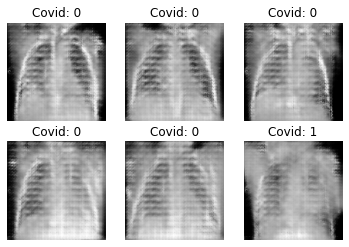

Epoch 262/300 Batch 3/3 [D loss: 0.17432, acc: 95.31%] [G loss: 3.96460]
Epoch 263/300 Batch 3/3 [D loss: 0.13541, acc: 96.88%] [G loss: 2.66413]
Epoch 264/300 Batch 3/3 [D loss: 0.29015, acc: 89.06%] [G loss: 3.45999]
Epoch 265/300 Batch 3/3 [D loss: 0.27274, acc: 89.06%] [G loss: 3.45405]
Epoch 266/300 Batch 3/3 [D loss: 0.30361, acc: 87.50%] [G loss: 2.65031]
Epoch 267/300 Batch 3/3 [D loss: 0.16865, acc: 96.88%] [G loss: 3.65954]
Epoch 268/300 Batch 3/3 [D loss: 0.24895, acc: 92.19%] [G loss: 3.81209]
Epoch 269/300 Batch 3/3 [D loss: 0.30765, acc: 92.19%] [G loss: 3.60081]
Epoch 270/300 Batch 3/3 [D loss: 0.23413, acc: 96.88%] [G loss: 3.36736]
Epoch 271/300 Batch 3/3 [D loss: 0.17021, acc: 98.44%] [G loss: 3.70218]
Epoch 272/300 Batch 3/3 [D loss: 0.31444, acc: 89.06%] [G loss: 3.07334]
Epoch 273/300 Batch 3/3 [D loss: 0.21684, acc: 98.44%] [G loss: 3.18489]
Epoch 274/300 Batch 3/3 [D loss: 0.26598, acc: 92.19%] [G loss: 4.70129]
Epoch 275/300 Batch 3/3 [D loss: 0.22300, acc: 92.1

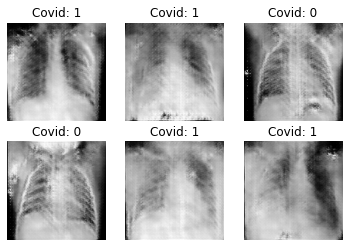

Epoch 282/300 Batch 3/3 [D loss: 0.22959, acc: 95.31%] [G loss: 3.21722]
Epoch 283/300 Batch 3/3 [D loss: 0.36228, acc: 82.81%] [G loss: 3.16258]
Epoch 284/300 Batch 3/3 [D loss: 0.49282, acc: 76.56%] [G loss: 4.34247]
Epoch 285/300 Batch 3/3 [D loss: 0.41609, acc: 76.56%] [G loss: 5.33606]
Epoch 286/300 Batch 3/3 [D loss: 0.33314, acc: 84.38%] [G loss: 3.52843]
Epoch 287/300 Batch 3/3 [D loss: 0.30689, acc: 92.19%] [G loss: 4.40383]
Epoch 288/300 Batch 3/3 [D loss: 0.30489, acc: 84.38%] [G loss: 3.58403]
Epoch 289/300 Batch 3/3 [D loss: 0.29041, acc: 87.50%] [G loss: 3.10686]
Epoch 290/300 Batch 3/3 [D loss: 0.24394, acc: 92.19%] [G loss: 2.77690]
Epoch 291/300 Batch 3/3 [D loss: 0.23472, acc: 93.75%] [G loss: 3.05816]
Epoch 292/300 Batch 3/3 [D loss: 0.36327, acc: 82.81%] [G loss: 3.45314]
Epoch 293/300 Batch 3/3 [D loss: 0.16953, acc: 98.44%] [G loss: 3.18961]
Epoch 294/300 Batch 3/3 [D loss: 0.26577, acc: 89.06%] [G loss: 3.20017]
Epoch 295/300 Batch 3/3 [D loss: 0.14986, acc: 98.4

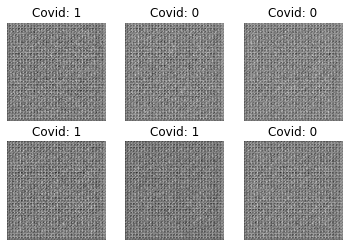

Epoch 2/300 Batch 3/3 [D loss: 0.66917, acc: 50.00%] [G loss: 0.56936]
Epoch 3/300 Batch 3/3 [D loss: 0.54613, acc: 100.00%] [G loss: 0.90154]
Epoch 4/300 Batch 3/3 [D loss: 0.43754, acc: 100.00%] [G loss: 1.12717]
Epoch 5/300 Batch 3/3 [D loss: 0.33485, acc: 100.00%] [G loss: 1.37613]
Epoch 6/300 Batch 3/3 [D loss: 0.25091, acc: 100.00%] [G loss: 1.85907]
Epoch 7/300 Batch 3/3 [D loss: 0.22315, acc: 98.44%] [G loss: 2.27730]
Epoch 8/300 Batch 3/3 [D loss: 0.22649, acc: 98.44%] [G loss: 2.70322]
Epoch 9/300 Batch 3/3 [D loss: 0.38687, acc: 90.62%] [G loss: 2.32438]
Epoch 10/300 Batch 3/3 [D loss: 0.42725, acc: 90.62%] [G loss: 2.42758]
Epoch 11/300 Batch 3/3 [D loss: 0.44198, acc: 84.38%] [G loss: 2.61798]
Epoch 12/300 Batch 3/3 [D loss: 0.43818, acc: 89.06%] [G loss: 2.44027]
Epoch 13/300 Batch 3/3 [D loss: 0.47014, acc: 78.12%] [G loss: 2.41071]
Epoch 14/300 Batch 3/3 [D loss: 0.57312, acc: 68.75%] [G loss: 1.51855]
Epoch 15/300 Batch 3/3 [D loss: 0.57030, acc: 75.00%] [G loss: 0.818

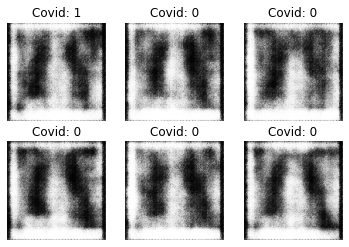

Epoch 22/300 Batch 3/3 [D loss: 0.51363, acc: 75.00%] [G loss: 1.05620]
Epoch 23/300 Batch 3/3 [D loss: 0.77512, acc: 45.31%] [G loss: 0.85612]
Epoch 24/300 Batch 3/3 [D loss: 0.59695, acc: 73.44%] [G loss: 1.35954]
Epoch 25/300 Batch 3/3 [D loss: 0.65587, acc: 62.50%] [G loss: 0.61047]
Epoch 26/300 Batch 3/3 [D loss: 0.84978, acc: 42.19%] [G loss: 1.02861]
Epoch 27/300 Batch 3/3 [D loss: 0.89571, acc: 15.62%] [G loss: 0.70938]
Epoch 28/300 Batch 3/3 [D loss: 0.85830, acc: 39.06%] [G loss: 0.92322]
Epoch 29/300 Batch 3/3 [D loss: 0.82380, acc: 32.81%] [G loss: 0.99503]
Epoch 30/300 Batch 3/3 [D loss: 0.83328, acc: 39.06%] [G loss: 0.90204]
Epoch 31/300 Batch 3/3 [D loss: 0.73181, acc: 51.56%] [G loss: 0.92906]
Epoch 32/300 Batch 3/3 [D loss: 0.67159, acc: 67.19%] [G loss: 0.92139]
Epoch 33/300 Batch 3/3 [D loss: 0.64011, acc: 73.44%] [G loss: 0.85195]
Epoch 34/300 Batch 3/3 [D loss: 0.63166, acc: 75.00%] [G loss: 0.85728]
Epoch 35/300 Batch 3/3 [D loss: 0.59588, acc: 79.69%] [G loss: 0

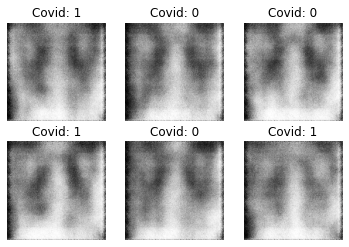

Epoch 42/300 Batch 3/3 [D loss: 0.68629, acc: 56.25%] [G loss: 0.78268]
Epoch 43/300 Batch 3/3 [D loss: 0.69901, acc: 51.56%] [G loss: 0.78651]
Epoch 44/300 Batch 3/3 [D loss: 0.65822, acc: 53.12%] [G loss: 0.80069]
Epoch 45/300 Batch 3/3 [D loss: 0.59642, acc: 70.31%] [G loss: 0.85954]
Epoch 46/300 Batch 3/3 [D loss: 0.59137, acc: 70.31%] [G loss: 0.86293]
Epoch 47/300 Batch 3/3 [D loss: 0.52905, acc: 79.69%] [G loss: 0.85514]
Epoch 48/300 Batch 3/3 [D loss: 0.58118, acc: 79.69%] [G loss: 0.68083]
Epoch 49/300 Batch 3/3 [D loss: 0.79012, acc: 40.62%] [G loss: 0.48001]
Epoch 50/300 Batch 3/3 [D loss: 0.82914, acc: 31.25%] [G loss: 0.68584]
Epoch 51/300 Batch 3/3 [D loss: 0.73584, acc: 39.06%] [G loss: 0.75529]
Epoch 52/300 Batch 3/3 [D loss: 0.70586, acc: 48.44%] [G loss: 0.72745]
Epoch 53/300 Batch 3/3 [D loss: 0.72105, acc: 45.31%] [G loss: 0.70814]
Epoch 54/300 Batch 3/3 [D loss: 0.67624, acc: 51.56%] [G loss: 0.75422]
Epoch 55/300 Batch 3/3 [D loss: 0.62337, acc: 75.00%] [G loss: 0

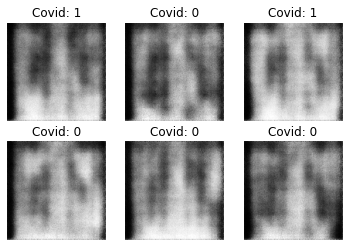

Epoch 62/300 Batch 3/3 [D loss: 0.71770, acc: 51.56%] [G loss: 0.54268]
Epoch 63/300 Batch 3/3 [D loss: 0.74597, acc: 39.06%] [G loss: 0.54903]
Epoch 64/300 Batch 3/3 [D loss: 0.79877, acc: 25.00%] [G loss: 0.62377]
Epoch 65/300 Batch 3/3 [D loss: 0.69548, acc: 53.12%] [G loss: 0.66278]
Epoch 66/300 Batch 3/3 [D loss: 0.74575, acc: 39.06%] [G loss: 0.67483]
Epoch 67/300 Batch 3/3 [D loss: 0.71551, acc: 45.31%] [G loss: 0.61818]
Epoch 68/300 Batch 3/3 [D loss: 0.68448, acc: 54.69%] [G loss: 0.69898]
Epoch 69/300 Batch 3/3 [D loss: 0.62151, acc: 75.00%] [G loss: 0.77265]
Epoch 70/300 Batch 3/3 [D loss: 0.61147, acc: 67.19%] [G loss: 0.77337]
Epoch 71/300 Batch 3/3 [D loss: 0.64130, acc: 59.38%] [G loss: 0.72711]
Epoch 72/300 Batch 3/3 [D loss: 0.64919, acc: 65.62%] [G loss: 0.69699]
Epoch 73/300 Batch 3/3 [D loss: 0.61789, acc: 65.62%] [G loss: 0.62820]
Epoch 74/300 Batch 3/3 [D loss: 0.61862, acc: 68.75%] [G loss: 0.63847]
Epoch 75/300 Batch 3/3 [D loss: 0.73051, acc: 45.31%] [G loss: 0

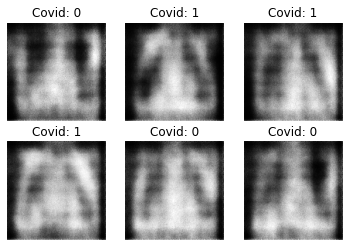

Epoch 82/300 Batch 3/3 [D loss: 0.68654, acc: 60.94%] [G loss: 0.80484]
Epoch 83/300 Batch 3/3 [D loss: 0.63908, acc: 68.75%] [G loss: 0.80184]
Epoch 84/300 Batch 3/3 [D loss: 0.67740, acc: 56.25%] [G loss: 0.72236]
Epoch 85/300 Batch 3/3 [D loss: 0.66417, acc: 54.69%] [G loss: 0.72184]
Epoch 86/300 Batch 3/3 [D loss: 0.71584, acc: 46.88%] [G loss: 0.69027]
Epoch 87/300 Batch 3/3 [D loss: 0.70259, acc: 56.25%] [G loss: 0.66331]
Epoch 88/300 Batch 3/3 [D loss: 0.71913, acc: 51.56%] [G loss: 0.65610]
Epoch 89/300 Batch 3/3 [D loss: 0.72568, acc: 39.06%] [G loss: 0.62105]
Epoch 90/300 Batch 3/3 [D loss: 0.72308, acc: 42.19%] [G loss: 0.63159]
Epoch 91/300 Batch 3/3 [D loss: 0.67311, acc: 51.56%] [G loss: 0.66155]
Epoch 92/300 Batch 3/3 [D loss: 0.71016, acc: 40.62%] [G loss: 0.69489]
Epoch 93/300 Batch 3/3 [D loss: 0.67233, acc: 51.56%] [G loss: 0.68191]
Epoch 94/300 Batch 3/3 [D loss: 0.65844, acc: 60.94%] [G loss: 0.70918]
Epoch 95/300 Batch 3/3 [D loss: 0.67135, acc: 46.88%] [G loss: 0

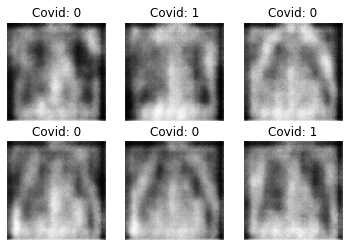

Epoch 102/300 Batch 3/3 [D loss: 0.70622, acc: 37.50%] [G loss: 0.64899]
Epoch 103/300 Batch 3/3 [D loss: 0.70652, acc: 35.94%] [G loss: 0.65663]
Epoch 104/300 Batch 3/3 [D loss: 0.68992, acc: 51.56%] [G loss: 0.65930]
Epoch 105/300 Batch 3/3 [D loss: 0.68340, acc: 53.12%] [G loss: 0.65679]
Epoch 106/300 Batch 3/3 [D loss: 0.68193, acc: 46.88%] [G loss: 0.67011]
Epoch 107/300 Batch 3/3 [D loss: 0.65238, acc: 67.19%] [G loss: 0.66901]
Epoch 108/300 Batch 3/3 [D loss: 0.67381, acc: 54.69%] [G loss: 0.69577]
Epoch 109/300 Batch 3/3 [D loss: 0.66400, acc: 57.81%] [G loss: 0.67500]
Epoch 110/300 Batch 3/3 [D loss: 0.65716, acc: 54.69%] [G loss: 0.67764]
Epoch 111/300 Batch 3/3 [D loss: 0.65775, acc: 59.38%] [G loss: 0.65391]
Epoch 112/300 Batch 3/3 [D loss: 0.66335, acc: 54.69%] [G loss: 0.64534]
Epoch 113/300 Batch 3/3 [D loss: 0.67767, acc: 51.56%] [G loss: 0.65188]
Epoch 114/300 Batch 3/3 [D loss: 0.68689, acc: 48.44%] [G loss: 0.64757]


In [ ]:
# build only models for 300 epochs because runtime was disconnected
for e in [300]:
  for bs in params['batch_size']:
    for lr in params['learning_rate']:
      name = 'e_'+str(e)+'_bs_'+str(bs)+'_lr_'+str(lr) #create a model name
      os.mkdir('images/'+name)
      cgan = CGAN(data, lr)  
      cgan.train(e, bs, name)  

### 1.2.1 - Training (Part 3)

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 64, 64, 128)       4224      
_________________________________________________________________
leaky_re_lu (LeakyReLU)      (None, 64, 64, 128)       0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 32, 32, 256)       524544    
_________________________________________________________________
leaky_re_lu_1 (LeakyReLU)    (None, 32, 32, 256)       0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 16, 16, 512)       2097664   
_________________________________________________________________
leaky_re_lu_2 (LeakyReLU)    (None, 16, 16, 512)       0         
_________________________________________________________________
conv2d_3 (Conv2D)            (None, 8, 8, 1024)        8

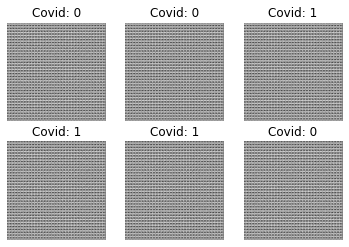

Epoch 2/300 Batch 3/3 [D loss: 213.98065, acc: 50.00%] [G loss: 403.48508]
Epoch 3/300 Batch 3/3 [D loss: 1.14980, acc: 98.44%] [G loss: 252.66959]
Epoch 4/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 221.28505]
Epoch 5/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 222.69070]
Epoch 6/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 215.23044]
Epoch 7/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 211.07880]
Epoch 8/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 212.06410]
Epoch 9/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 213.68500]
Epoch 10/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 210.40659]
Epoch 11/300 Batch 3/3 [D loss: 44.91441, acc: 76.56%] [G loss: 4693.84766]
Epoch 12/300 Batch 3/3 [D loss: 303.75089, acc: 50.00%] [G loss: 28166.62500]
Epoch 13/300 Batch 3/3 [D loss: 21665.55762, acc: 18.75%] [G loss: 1011113.75000]
Epoch 14/300 Batch 3/3 [D loss: 13347.53906, acc: 34.38%] [G loss: 38229.46875]
Epoch 15/300 Batc

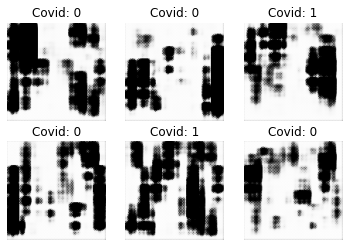

Epoch 22/300 Batch 3/3 [D loss: 57.44978, acc: 95.31%] [G loss: 3606.83789]
Epoch 23/300 Batch 3/3 [D loss: 461.94397, acc: 64.06%] [G loss: 1862.11963]
Epoch 24/300 Batch 3/3 [D loss: 128.49350, acc: 87.50%] [G loss: 1098.77588]
Epoch 25/300 Batch 3/3 [D loss: 243.22072, acc: 81.25%] [G loss: 2362.37427]
Epoch 26/300 Batch 3/3 [D loss: 112.69320, acc: 85.94%] [G loss: 2844.30566]
Epoch 27/300 Batch 3/3 [D loss: 101.96734, acc: 89.06%] [G loss: 1249.62085]
Epoch 28/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 1158.59790]
Epoch 29/300 Batch 3/3 [D loss: 15.16241, acc: 98.44%] [G loss: 734.80304]
Epoch 30/300 Batch 3/3 [D loss: 1.44657, acc: 98.44%] [G loss: 420.38129]
Epoch 31/300 Batch 3/3 [D loss: 61.30079, acc: 85.94%] [G loss: 1032.98303]
Epoch 32/300 Batch 3/3 [D loss: 0.23548, acc: 98.44%] [G loss: 1403.02246]
Epoch 33/300 Batch 3/3 [D loss: 17.79803, acc: 90.62%] [G loss: 1644.72510]
Epoch 34/300 Batch 3/3 [D loss: 27.55644, acc: 90.62%] [G loss: 752.07678]
Epoch 35/300

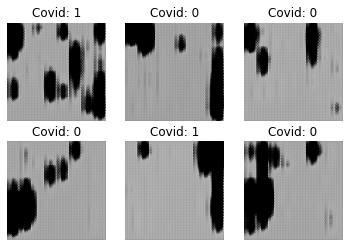

Epoch 42/300 Batch 3/3 [D loss: 2.39846, acc: 95.31%] [G loss: 445.62201]
Epoch 43/300 Batch 3/3 [D loss: 10.65660, acc: 92.19%] [G loss: 444.14435]
Epoch 44/300 Batch 3/3 [D loss: 2.76942, acc: 98.44%] [G loss: 473.25766]
Epoch 45/300 Batch 3/3 [D loss: 2.53238, acc: 98.44%] [G loss: 347.21677]
Epoch 46/300 Batch 3/3 [D loss: 0.50886, acc: 98.44%] [G loss: 476.77646]
Epoch 47/300 Batch 3/3 [D loss: 7.55512, acc: 92.19%] [G loss: 304.28229]
Epoch 48/300 Batch 3/3 [D loss: 0.03056, acc: 98.44%] [G loss: 455.92859]
Epoch 49/300 Batch 3/3 [D loss: 3.16497, acc: 90.62%] [G loss: 561.38220]
Epoch 50/300 Batch 3/3 [D loss: 16.10555, acc: 92.19%] [G loss: 610.04584]
Epoch 51/300 Batch 3/3 [D loss: 5.18500, acc: 96.88%] [G loss: 476.07312]
Epoch 52/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 453.92896]
Epoch 53/300 Batch 3/3 [D loss: 4.68557, acc: 93.75%] [G loss: 426.14401]
Epoch 54/300 Batch 3/3 [D loss: 0.00000, acc: 100.00%] [G loss: 280.40271]
Epoch 55/300 Batch 3/3 [D loss: 28

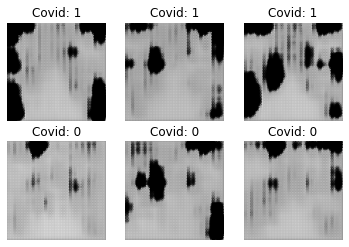

Epoch 62/300 Batch 3/3 [D loss: 7.23148, acc: 93.75%] [G loss: 667.99585]
Epoch 63/300 Batch 3/3 [D loss: 25.69509, acc: 81.25%] [G loss: 371.47141]
Epoch 64/300 Batch 3/3 [D loss: 137.77604, acc: 54.69%] [G loss: 758.04736]
Epoch 65/300 Batch 3/3 [D loss: 19.36773, acc: 90.62%] [G loss: 372.74219]
Epoch 66/300 Batch 3/3 [D loss: 111.68426, acc: 48.44%] [G loss: 462.22745]
Epoch 67/300 Batch 3/3 [D loss: 21.31561, acc: 81.25%] [G loss: 331.86505]
Epoch 68/300 Batch 3/3 [D loss: 15.64774, acc: 82.81%] [G loss: 257.69482]
Epoch 69/300 Batch 3/3 [D loss: 28.25222, acc: 68.75%] [G loss: 426.56775]
Epoch 70/300 Batch 3/3 [D loss: 25.46007, acc: 67.19%] [G loss: 389.22333]
Epoch 71/300 Batch 3/3 [D loss: 55.54001, acc: 56.25%] [G loss: 168.93040]
Epoch 72/300 Batch 3/3 [D loss: 15.42986, acc: 75.00%] [G loss: 97.03223]
Epoch 73/300 Batch 3/3 [D loss: 60.87118, acc: 42.19%] [G loss: 291.30737]
Epoch 74/300 Batch 3/3 [D loss: 22.78157, acc: 71.88%] [G loss: 273.66980]
Epoch 75/300 Batch 3/3 [D

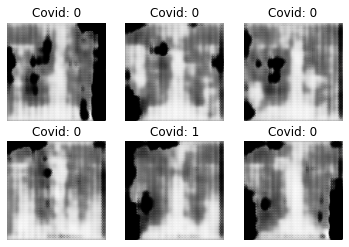

Epoch 82/300 Batch 3/3 [D loss: 22.55021, acc: 65.62%] [G loss: 199.03922]
Epoch 83/300 Batch 3/3 [D loss: 15.00927, acc: 73.44%] [G loss: 175.46127]
Epoch 84/300 Batch 3/3 [D loss: 8.35719, acc: 81.25%] [G loss: 97.45432]
Epoch 85/300 Batch 3/3 [D loss: 5.76834, acc: 87.50%] [G loss: 115.36241]
Epoch 86/300 Batch 3/3 [D loss: 77.39253, acc: 42.19%] [G loss: 188.90219]
Epoch 87/300 Batch 3/3 [D loss: 6.38785, acc: 87.50%] [G loss: 107.98772]
Epoch 88/300 Batch 3/3 [D loss: 57.29101, acc: 29.69%] [G loss: 209.67694]
Epoch 89/300 Batch 3/3 [D loss: 4.96961, acc: 93.75%] [G loss: 73.59932]
Epoch 90/300 Batch 3/3 [D loss: 6.42789, acc: 79.69%] [G loss: 130.83664]
Epoch 91/300 Batch 3/3 [D loss: 14.66160, acc: 84.38%] [G loss: 102.31927]
Epoch 92/300 Batch 3/3 [D loss: 25.72247, acc: 45.31%] [G loss: 142.86740]
Epoch 93/300 Batch 3/3 [D loss: 4.07460, acc: 90.62%] [G loss: 90.76289]
Epoch 94/300 Batch 3/3 [D loss: 3.33046, acc: 90.62%] [G loss: 98.92885]
Epoch 95/300 Batch 3/3 [D loss: 11.6

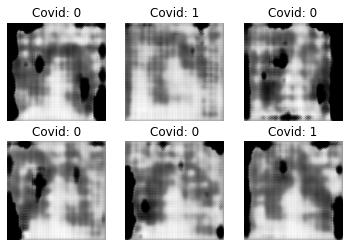

Epoch 102/300 Batch 3/3 [D loss: 7.84841, acc: 73.44%] [G loss: 92.75256]
Epoch 103/300 Batch 3/3 [D loss: 5.80112, acc: 73.44%] [G loss: 109.18080]
Epoch 104/300 Batch 3/3 [D loss: 3.56031, acc: 90.62%] [G loss: 83.13373]
Epoch 105/300 Batch 3/3 [D loss: 3.24100, acc: 89.06%] [G loss: 59.11569]
Epoch 106/300 Batch 3/3 [D loss: 14.52935, acc: 64.06%] [G loss: 176.71150]
Epoch 107/300 Batch 3/3 [D loss: 1.42222, acc: 95.31%] [G loss: 108.52853]
Epoch 108/300 Batch 3/3 [D loss: 9.54400, acc: 68.75%] [G loss: 70.07689]
Epoch 109/300 Batch 3/3 [D loss: 5.77857, acc: 82.81%] [G loss: 55.20253]
Epoch 110/300 Batch 3/3 [D loss: 8.47956, acc: 71.88%] [G loss: 58.94190]
Epoch 111/300 Batch 3/3 [D loss: 8.47927, acc: 68.75%] [G loss: 126.85213]
Epoch 112/300 Batch 3/3 [D loss: 0.92145, acc: 90.62%] [G loss: 41.47173]
Epoch 113/300 Batch 3/3 [D loss: 3.35315, acc: 89.06%] [G loss: 79.30128]
Epoch 114/300 Batch 3/3 [D loss: 2.09304, acc: 90.62%] [G loss: 59.42090]
Epoch 115/300 Batch 3/3 [D loss: 

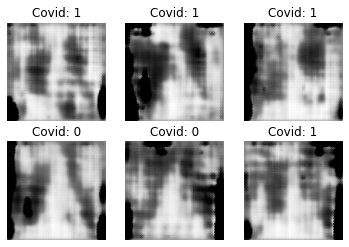

Epoch 122/300 Batch 3/3 [D loss: 9.43797, acc: 70.31%] [G loss: 81.75277]
Epoch 123/300 Batch 3/3 [D loss: 5.06593, acc: 75.00%] [G loss: 113.16212]
Epoch 124/300 Batch 3/3 [D loss: 1.63877, acc: 95.31%] [G loss: 87.56566]
Epoch 125/300 Batch 3/3 [D loss: 2.60977, acc: 84.38%] [G loss: 64.76046]
Epoch 126/300 Batch 3/3 [D loss: 2.36296, acc: 85.94%] [G loss: 44.03153]
Epoch 127/300 Batch 3/3 [D loss: 14.31086, acc: 53.12%] [G loss: 123.30054]
Epoch 128/300 Batch 3/3 [D loss: 4.74455, acc: 76.56%] [G loss: 86.30075]
Epoch 129/300 Batch 3/3 [D loss: 6.38620, acc: 79.69%] [G loss: 86.09314]
Epoch 130/300 Batch 3/3 [D loss: 7.19426, acc: 71.88%] [G loss: 68.54276]
Epoch 131/300 Batch 3/3 [D loss: 5.59871, acc: 79.69%] [G loss: 47.40626]
Epoch 132/300 Batch 3/3 [D loss: 8.19941, acc: 65.62%] [G loss: 128.54272]
Epoch 133/300 Batch 3/3 [D loss: 13.75430, acc: 64.06%] [G loss: 54.61699]
Epoch 134/300 Batch 3/3 [D loss: 1.61008, acc: 92.19%] [G loss: 58.41201]
Epoch 135/300 Batch 3/3 [D loss: 

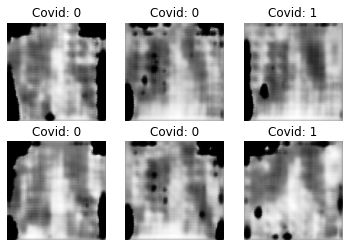

Epoch 142/300 Batch 3/3 [D loss: 0.10624, acc: 98.44%] [G loss: 77.06136]
Epoch 143/300 Batch 3/3 [D loss: 1.29080, acc: 92.19%] [G loss: 58.23700]
Epoch 144/300 Batch 3/3 [D loss: 2.07895, acc: 89.06%] [G loss: 59.91499]
Epoch 145/300 Batch 3/3 [D loss: 7.25755, acc: 75.00%] [G loss: 63.50621]
Epoch 146/300 Batch 3/3 [D loss: 3.73366, acc: 79.69%] [G loss: 37.87789]
Epoch 147/300 Batch 3/3 [D loss: 5.18826, acc: 79.69%] [G loss: 48.86345]
Epoch 148/300 Batch 3/3 [D loss: 11.33577, acc: 53.12%] [G loss: 58.11629]
Epoch 149/300 Batch 3/3 [D loss: 7.97574, acc: 64.06%] [G loss: 59.73409]
Epoch 150/300 Batch 3/3 [D loss: 11.48071, acc: 65.62%] [G loss: 50.55102]
Epoch 151/300 Batch 3/3 [D loss: 11.98533, acc: 54.69%] [G loss: 31.75702]
Epoch 152/300 Batch 3/3 [D loss: 4.16608, acc: 78.12%] [G loss: 61.21295]
Epoch 153/300 Batch 3/3 [D loss: 3.53313, acc: 84.38%] [G loss: 57.50449]
Epoch 154/300 Batch 3/3 [D loss: 2.81448, acc: 85.94%] [G loss: 45.46080]
Epoch 155/300 Batch 3/3 [D loss: 1.

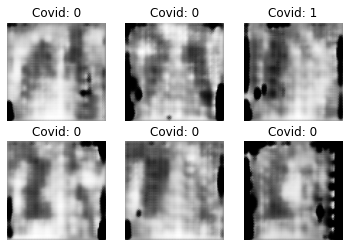

Epoch 162/300 Batch 3/3 [D loss: 0.46535, acc: 93.75%] [G loss: 45.95947]
Epoch 163/300 Batch 3/3 [D loss: 9.49666, acc: 56.25%] [G loss: 51.56401]
Epoch 164/300 Batch 3/3 [D loss: 1.86789, acc: 82.81%] [G loss: 69.09455]
Epoch 165/300 Batch 3/3 [D loss: 3.34742, acc: 82.81%] [G loss: 43.55440]
Epoch 166/300 Batch 3/3 [D loss: 2.01877, acc: 82.81%] [G loss: 32.64783]
Epoch 167/300 Batch 3/3 [D loss: 0.56770, acc: 92.19%] [G loss: 37.60376]
Epoch 168/300 Batch 3/3 [D loss: 5.10024, acc: 78.12%] [G loss: 53.02590]
Epoch 169/300 Batch 3/3 [D loss: 2.49955, acc: 82.81%] [G loss: 50.70553]
Epoch 170/300 Batch 3/3 [D loss: 5.21482, acc: 75.00%] [G loss: 28.45602]
Epoch 171/300 Batch 3/3 [D loss: 2.80842, acc: 82.81%] [G loss: 41.90045]
Epoch 172/300 Batch 3/3 [D loss: 1.31686, acc: 89.06%] [G loss: 37.55222]
Epoch 173/300 Batch 3/3 [D loss: 2.87831, acc: 79.69%] [G loss: 50.21373]
Epoch 174/300 Batch 3/3 [D loss: 4.47043, acc: 71.88%] [G loss: 86.16436]
Epoch 175/300 Batch 3/3 [D loss: 9.001

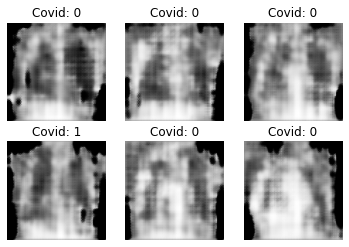

Epoch 182/300 Batch 3/3 [D loss: 3.93221, acc: 79.69%] [G loss: 36.83270]
Epoch 183/300 Batch 3/3 [D loss: 1.94874, acc: 76.56%] [G loss: 31.08137]
Epoch 184/300 Batch 3/3 [D loss: 1.36622, acc: 93.75%] [G loss: 53.15373]
Epoch 185/300 Batch 3/3 [D loss: 1.04247, acc: 87.50%] [G loss: 30.29660]
Epoch 186/300 Batch 3/3 [D loss: 2.88446, acc: 79.69%] [G loss: 51.66114]
Epoch 187/300 Batch 3/3 [D loss: 2.55458, acc: 85.94%] [G loss: 62.58852]
Epoch 188/300 Batch 3/3 [D loss: 1.65742, acc: 92.19%] [G loss: 15.14447]
Epoch 189/300 Batch 3/3 [D loss: 6.25324, acc: 62.50%] [G loss: 71.27829]
Epoch 190/300 Batch 3/3 [D loss: 1.41108, acc: 85.94%] [G loss: 27.78716]
Epoch 191/300 Batch 3/3 [D loss: 1.53059, acc: 85.94%] [G loss: 23.89067]
Epoch 192/300 Batch 3/3 [D loss: 1.12559, acc: 84.38%] [G loss: 22.30481]
Epoch 193/300 Batch 3/3 [D loss: 1.17731, acc: 84.38%] [G loss: 41.38366]
Epoch 194/300 Batch 3/3 [D loss: 0.62531, acc: 92.19%] [G loss: 39.99557]
Epoch 195/300 Batch 3/3 [D loss: 2.775

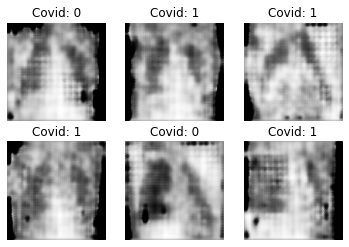

Epoch 202/300 Batch 3/3 [D loss: 1.24613, acc: 85.94%] [G loss: 35.28405]
Epoch 203/300 Batch 3/3 [D loss: 1.64964, acc: 87.50%] [G loss: 32.34853]
Epoch 204/300 Batch 3/3 [D loss: 2.17053, acc: 78.12%] [G loss: 36.21332]
Epoch 205/300 Batch 3/3 [D loss: 0.79119, acc: 90.62%] [G loss: 35.29043]
Epoch 206/300 Batch 3/3 [D loss: 2.25683, acc: 78.12%] [G loss: 20.41313]
Epoch 207/300 Batch 3/3 [D loss: 1.49280, acc: 84.38%] [G loss: 39.16204]
Epoch 208/300 Batch 3/3 [D loss: 0.69718, acc: 92.19%] [G loss: 27.31455]
Epoch 209/300 Batch 3/3 [D loss: 1.39563, acc: 87.50%] [G loss: 29.07449]
Epoch 210/300 Batch 3/3 [D loss: 1.37619, acc: 84.38%] [G loss: 24.40998]
Epoch 211/300 Batch 3/3 [D loss: 1.03733, acc: 87.50%] [G loss: 33.77438]
Epoch 212/300 Batch 3/3 [D loss: 4.08728, acc: 76.56%] [G loss: 47.92381]
Epoch 213/300 Batch 3/3 [D loss: 1.91918, acc: 81.25%] [G loss: 15.75313]
Epoch 214/300 Batch 3/3 [D loss: 1.17826, acc: 90.62%] [G loss: 12.19827]
Epoch 215/300 Batch 3/3 [D loss: 3.196

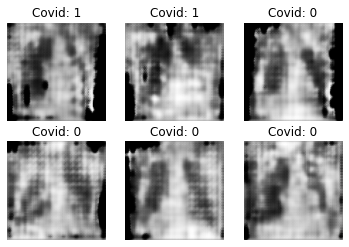

Epoch 222/300 Batch 3/3 [D loss: 4.11733, acc: 68.75%] [G loss: 23.42290]
Epoch 223/300 Batch 3/3 [D loss: 0.62913, acc: 89.06%] [G loss: 17.21098]
Epoch 224/300 Batch 3/3 [D loss: 3.62482, acc: 62.50%] [G loss: 21.95792]
Epoch 225/300 Batch 3/3 [D loss: 3.73646, acc: 64.06%] [G loss: 38.53979]
Epoch 226/300 Batch 3/3 [D loss: 1.01760, acc: 90.62%] [G loss: 31.65764]
Epoch 227/300 Batch 3/3 [D loss: 1.72404, acc: 79.69%] [G loss: 15.12136]
Epoch 228/300 Batch 3/3 [D loss: 1.05986, acc: 87.50%] [G loss: 34.95471]
Epoch 229/300 Batch 3/3 [D loss: 1.40048, acc: 82.81%] [G loss: 31.79829]
Epoch 230/300 Batch 3/3 [D loss: 0.29827, acc: 93.75%] [G loss: 21.11887]
Epoch 231/300 Batch 3/3 [D loss: 1.09413, acc: 89.06%] [G loss: 21.38332]
Epoch 232/300 Batch 3/3 [D loss: 1.24009, acc: 81.25%] [G loss: 28.59804]
Epoch 233/300 Batch 3/3 [D loss: 0.30729, acc: 95.31%] [G loss: 31.73902]
Epoch 234/300 Batch 3/3 [D loss: 0.89317, acc: 92.19%] [G loss: 26.41378]
Epoch 235/300 Batch 3/3 [D loss: 0.661

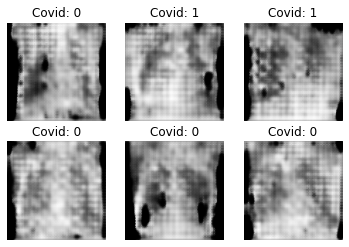

Epoch 242/300 Batch 3/3 [D loss: 2.18694, acc: 79.69%] [G loss: 24.78795]
Epoch 243/300 Batch 3/3 [D loss: 1.14903, acc: 78.12%] [G loss: 30.78307]
Epoch 244/300 Batch 3/3 [D loss: 1.11552, acc: 89.06%] [G loss: 24.12887]
Epoch 245/300 Batch 3/3 [D loss: 1.96592, acc: 78.12%] [G loss: 45.52914]
Epoch 246/300 Batch 3/3 [D loss: 4.28522, acc: 65.62%] [G loss: 16.35619]
Epoch 247/300 Batch 3/3 [D loss: 1.87656, acc: 82.81%] [G loss: 27.71817]
Epoch 248/300 Batch 3/3 [D loss: 2.02150, acc: 78.12%] [G loss: 25.94981]
Epoch 249/300 Batch 3/3 [D loss: 1.73339, acc: 84.38%] [G loss: 32.38580]
Epoch 250/300 Batch 3/3 [D loss: 2.43990, acc: 73.44%] [G loss: 23.31540]
Epoch 251/300 Batch 3/3 [D loss: 2.76874, acc: 76.56%] [G loss: 15.20678]
Epoch 252/300 Batch 3/3 [D loss: 1.79035, acc: 84.38%] [G loss: 24.56818]
Epoch 253/300 Batch 3/3 [D loss: 0.10532, acc: 96.88%] [G loss: 21.45085]
Epoch 254/300 Batch 3/3 [D loss: 1.83132, acc: 82.81%] [G loss: 25.71232]
Epoch 255/300 Batch 3/3 [D loss: 0.253

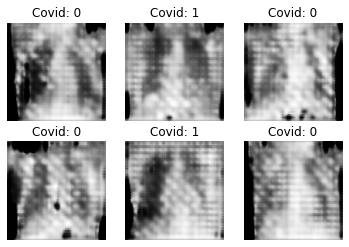

Epoch 262/300 Batch 3/3 [D loss: 1.34116, acc: 82.81%] [G loss: 27.98496]
Epoch 263/300 Batch 3/3 [D loss: 0.20919, acc: 93.75%] [G loss: 20.25517]
Epoch 264/300 Batch 3/3 [D loss: 1.31877, acc: 89.06%] [G loss: 24.52344]
Epoch 265/300 Batch 3/3 [D loss: 1.76801, acc: 81.25%] [G loss: 35.49862]
Epoch 266/300 Batch 3/3 [D loss: 2.05516, acc: 75.00%] [G loss: 28.21533]
Epoch 267/300 Batch 3/3 [D loss: 3.34805, acc: 71.88%] [G loss: 20.76499]
Epoch 268/300 Batch 3/3 [D loss: 1.63621, acc: 92.19%] [G loss: 22.91370]
Epoch 269/300 Batch 3/3 [D loss: 3.88757, acc: 68.75%] [G loss: 75.35423]
Epoch 270/300 Batch 3/3 [D loss: 7.58697, acc: 65.62%] [G loss: 25.72454]
Epoch 271/300 Batch 3/3 [D loss: 0.45584, acc: 92.19%] [G loss: 27.06633]
Epoch 272/300 Batch 3/3 [D loss: 1.47002, acc: 84.38%] [G loss: 29.43930]
Epoch 273/300 Batch 3/3 [D loss: 2.81704, acc: 68.75%] [G loss: 15.25252]
Epoch 274/300 Batch 3/3 [D loss: 1.52398, acc: 84.38%] [G loss: 27.09892]
Epoch 275/300 Batch 3/3 [D loss: 1.355

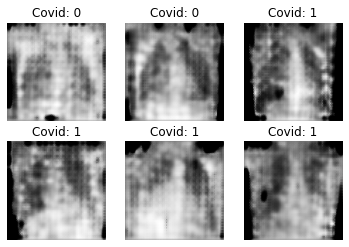

Epoch 282/300 Batch 3/3 [D loss: 1.10507, acc: 90.62%] [G loss: 24.22147]
Epoch 283/300 Batch 3/3 [D loss: 1.41494, acc: 78.12%] [G loss: 20.54340]
Epoch 284/300 Batch 3/3 [D loss: 1.17259, acc: 84.38%] [G loss: 29.96371]
Epoch 285/300 Batch 3/3 [D loss: 2.08562, acc: 73.44%] [G loss: 17.93708]
Epoch 286/300 Batch 3/3 [D loss: 0.65858, acc: 90.62%] [G loss: 23.34688]
Epoch 287/300 Batch 3/3 [D loss: 1.96686, acc: 82.81%] [G loss: 23.95500]
Epoch 288/300 Batch 3/3 [D loss: 0.61725, acc: 87.50%] [G loss: 24.63451]
Epoch 289/300 Batch 3/3 [D loss: 0.33998, acc: 93.75%] [G loss: 15.61296]
Epoch 290/300 Batch 3/3 [D loss: 1.51293, acc: 79.69%] [G loss: 25.01196]
Epoch 291/300 Batch 3/3 [D loss: 1.12408, acc: 87.50%] [G loss: 15.76121]
Epoch 292/300 Batch 3/3 [D loss: 3.85354, acc: 48.44%] [G loss: 37.32539]
Epoch 293/300 Batch 3/3 [D loss: 0.93695, acc: 89.06%] [G loss: 33.66086]
Epoch 294/300 Batch 3/3 [D loss: 1.40623, acc: 87.50%] [G loss: 16.01324]
Epoch 295/300 Batch 3/3 [D loss: 3.981

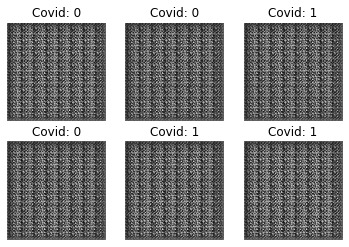

Epoch 2/300 Batch 3/3 [D loss: 0.00111, acc: 100.00%] [G loss: 7.95790]
Epoch 3/300 Batch 3/3 [D loss: 0.01088, acc: 100.00%] [G loss: 7.64545]
Epoch 4/300 Batch 3/3 [D loss: 0.00075, acc: 100.00%] [G loss: 8.03739]
Epoch 5/300 Batch 3/3 [D loss: 0.00384, acc: 100.00%] [G loss: 13.06312]
Epoch 6/300 Batch 3/3 [D loss: 1.51260, acc: 70.31%] [G loss: 39.14300]
Epoch 7/300 Batch 3/3 [D loss: 0.12126, acc: 98.44%] [G loss: 4.49022]
Epoch 8/300 Batch 3/3 [D loss: 0.04226, acc: 98.44%] [G loss: 2.67256]
Epoch 9/300 Batch 3/3 [D loss: 0.11193, acc: 98.44%] [G loss: 6.25642]
Epoch 10/300 Batch 3/3 [D loss: 0.02320, acc: 100.00%] [G loss: 8.45602]
Epoch 11/300 Batch 3/3 [D loss: 0.01357, acc: 100.00%] [G loss: 4.85491]
Epoch 12/300 Batch 3/3 [D loss: 0.03768, acc: 100.00%] [G loss: 4.79826]
Epoch 13/300 Batch 3/3 [D loss: 0.04216, acc: 100.00%] [G loss: 9.76786]
Epoch 14/300 Batch 3/3 [D loss: 0.02387, acc: 100.00%] [G loss: 6.65761]
Epoch 15/300 Batch 3/3 [D loss: 0.00828, acc: 100.00%] [G los

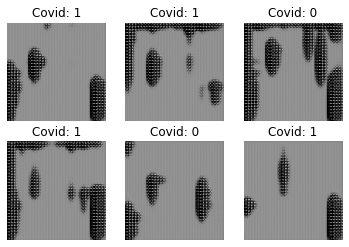

Epoch 22/300 Batch 3/3 [D loss: 0.20217, acc: 96.88%] [G loss: 3.16317]
Epoch 23/300 Batch 3/3 [D loss: 0.08763, acc: 100.00%] [G loss: 4.09067]
Epoch 24/300 Batch 3/3 [D loss: 0.07954, acc: 96.88%] [G loss: 3.32620]
Epoch 25/300 Batch 3/3 [D loss: 0.04041, acc: 100.00%] [G loss: 4.00146]
Epoch 26/300 Batch 3/3 [D loss: 0.04374, acc: 98.44%] [G loss: 4.71286]
Epoch 27/300 Batch 3/3 [D loss: 0.32800, acc: 87.50%] [G loss: 8.73679]
Epoch 28/300 Batch 3/3 [D loss: 0.07366, acc: 98.44%] [G loss: 3.61608]
Epoch 29/300 Batch 3/3 [D loss: 0.29892, acc: 93.75%] [G loss: 3.83911]
Epoch 30/300 Batch 3/3 [D loss: 0.56183, acc: 78.12%] [G loss: 5.49619]
Epoch 31/300 Batch 3/3 [D loss: 1.04008, acc: 54.69%] [G loss: 47.10931]
Epoch 32/300 Batch 3/3 [D loss: 0.52039, acc: 75.00%] [G loss: 1.05570]
Epoch 33/300 Batch 3/3 [D loss: 0.23814, acc: 95.31%] [G loss: 2.54530]
Epoch 34/300 Batch 3/3 [D loss: 0.20022, acc: 96.88%] [G loss: 2.70806]
Epoch 35/300 Batch 3/3 [D loss: 0.15974, acc: 96.88%] [G loss

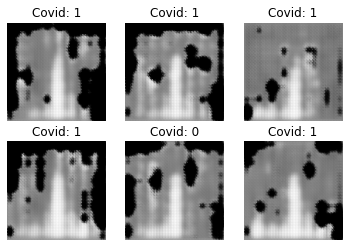

Epoch 42/300 Batch 3/3 [D loss: 0.50419, acc: 84.38%] [G loss: 1.28978]
Epoch 43/300 Batch 3/3 [D loss: 0.50657, acc: 84.38%] [G loss: 1.47867]
Epoch 44/300 Batch 3/3 [D loss: 0.48512, acc: 82.81%] [G loss: 1.27651]
Epoch 45/300 Batch 3/3 [D loss: 0.42486, acc: 84.38%] [G loss: 1.92711]
Epoch 46/300 Batch 3/3 [D loss: 0.26336, acc: 90.62%] [G loss: 1.71190]
Epoch 47/300 Batch 3/3 [D loss: 1.13952, acc: 50.00%] [G loss: 2.69382]
Epoch 48/300 Batch 3/3 [D loss: 0.39169, acc: 79.69%] [G loss: 3.64979]
Epoch 49/300 Batch 3/3 [D loss: 0.17418, acc: 95.31%] [G loss: 3.05928]
Epoch 50/300 Batch 3/3 [D loss: 0.18434, acc: 95.31%] [G loss: 1.55351]
Epoch 51/300 Batch 3/3 [D loss: 0.99656, acc: 54.69%] [G loss: 1.80174]
Epoch 52/300 Batch 3/3 [D loss: 0.51179, acc: 73.44%] [G loss: 1.52664]
Epoch 53/300 Batch 3/3 [D loss: 0.47836, acc: 85.94%] [G loss: 1.47161]
Epoch 54/300 Batch 3/3 [D loss: 0.41209, acc: 95.31%] [G loss: 1.57526]
Epoch 55/300 Batch 3/3 [D loss: 0.34832, acc: 90.62%] [G loss: 1

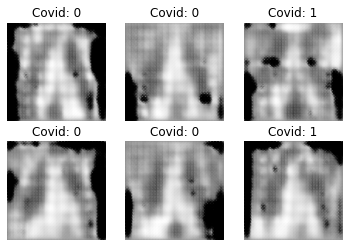

Epoch 62/300 Batch 3/3 [D loss: 0.55032, acc: 71.88%] [G loss: 1.81073]
Epoch 63/300 Batch 3/3 [D loss: 0.39680, acc: 87.50%] [G loss: 1.74932]
Epoch 64/300 Batch 3/3 [D loss: 0.57092, acc: 78.12%] [G loss: 1.91006]
Epoch 65/300 Batch 3/3 [D loss: 0.43368, acc: 89.06%] [G loss: 1.53642]
Epoch 66/300 Batch 3/3 [D loss: 0.49262, acc: 79.69%] [G loss: 2.03383]
Epoch 67/300 Batch 3/3 [D loss: 0.41176, acc: 85.94%] [G loss: 2.06889]
Epoch 68/300 Batch 3/3 [D loss: 0.60156, acc: 67.19%] [G loss: 1.20259]
Epoch 69/300 Batch 3/3 [D loss: 0.48287, acc: 84.38%] [G loss: 2.64188]
Epoch 70/300 Batch 3/3 [D loss: 0.84157, acc: 68.75%] [G loss: 1.46062]
Epoch 71/300 Batch 3/3 [D loss: 0.49298, acc: 78.12%] [G loss: 1.89145]
Epoch 72/300 Batch 3/3 [D loss: 0.54910, acc: 65.62%] [G loss: 1.55409]
Epoch 73/300 Batch 3/3 [D loss: 0.70337, acc: 62.50%] [G loss: 1.34316]
Epoch 74/300 Batch 3/3 [D loss: 0.46049, acc: 85.94%] [G loss: 1.41703]
Epoch 75/300 Batch 3/3 [D loss: 0.60162, acc: 73.44%] [G loss: 1

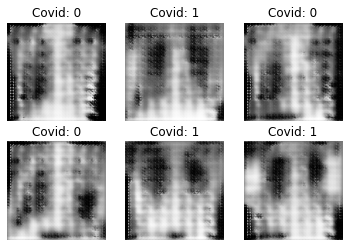

Epoch 82/300 Batch 3/3 [D loss: 0.48768, acc: 82.81%] [G loss: 1.58666]
Epoch 83/300 Batch 3/3 [D loss: 0.55271, acc: 68.75%] [G loss: 1.73679]
Epoch 84/300 Batch 3/3 [D loss: 0.66693, acc: 62.50%] [G loss: 1.54303]
Epoch 85/300 Batch 3/3 [D loss: 0.40864, acc: 92.19%] [G loss: 1.54217]
Epoch 86/300 Batch 3/3 [D loss: 0.53060, acc: 71.88%] [G loss: 1.33345]
Epoch 87/300 Batch 3/3 [D loss: 0.57418, acc: 65.62%] [G loss: 1.56259]
Epoch 88/300 Batch 3/3 [D loss: 0.44815, acc: 76.56%] [G loss: 1.76410]
Epoch 89/300 Batch 3/3 [D loss: 0.55936, acc: 76.56%] [G loss: 1.91075]
Epoch 90/300 Batch 3/3 [D loss: 0.44934, acc: 81.25%] [G loss: 1.49536]
Epoch 91/300 Batch 3/3 [D loss: 0.48069, acc: 76.56%] [G loss: 1.49103]
Epoch 92/300 Batch 3/3 [D loss: 0.46698, acc: 79.69%] [G loss: 1.59648]
Epoch 93/300 Batch 3/3 [D loss: 0.59510, acc: 65.62%] [G loss: 1.19287]
Epoch 94/300 Batch 3/3 [D loss: 0.43051, acc: 81.25%] [G loss: 1.52019]
Epoch 95/300 Batch 3/3 [D loss: 0.30290, acc: 95.31%] [G loss: 2

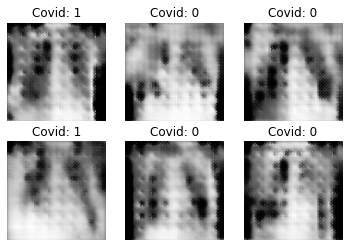

Epoch 102/300 Batch 3/3 [D loss: 0.42437, acc: 82.81%] [G loss: 1.84163]
Epoch 103/300 Batch 3/3 [D loss: 0.44278, acc: 84.38%] [G loss: 2.51936]
Epoch 104/300 Batch 3/3 [D loss: 0.41260, acc: 78.12%] [G loss: 2.05517]
Epoch 105/300 Batch 3/3 [D loss: 0.48500, acc: 78.12%] [G loss: 1.98173]
Epoch 106/300 Batch 3/3 [D loss: 0.34633, acc: 90.62%] [G loss: 1.60982]
Epoch 107/300 Batch 3/3 [D loss: 0.47468, acc: 76.56%] [G loss: 2.32662]
Epoch 108/300 Batch 3/3 [D loss: 0.60497, acc: 71.88%] [G loss: 1.43601]
Epoch 109/300 Batch 3/3 [D loss: 0.45687, acc: 78.12%] [G loss: 1.65681]
Epoch 110/300 Batch 3/3 [D loss: 0.47239, acc: 81.25%] [G loss: 1.58154]
Epoch 111/300 Batch 3/3 [D loss: 0.49229, acc: 81.25%] [G loss: 1.90822]
Epoch 112/300 Batch 3/3 [D loss: 0.42973, acc: 81.25%] [G loss: 1.66695]
Epoch 113/300 Batch 3/3 [D loss: 0.31939, acc: 90.62%] [G loss: 2.03921]
Epoch 114/300 Batch 3/3 [D loss: 0.27654, acc: 93.75%] [G loss: 2.25520]
Epoch 115/300 Batch 3/3 [D loss: 0.32900, acc: 85.9

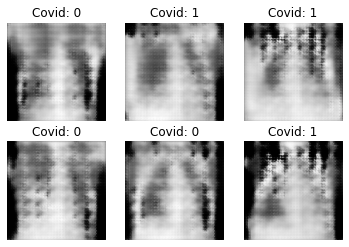

Epoch 122/300 Batch 3/3 [D loss: 0.65074, acc: 65.62%] [G loss: 2.33654]
Epoch 123/300 Batch 3/3 [D loss: 0.54764, acc: 64.06%] [G loss: 1.66265]
Epoch 124/300 Batch 3/3 [D loss: 0.48984, acc: 75.00%] [G loss: 1.65448]
Epoch 125/300 Batch 3/3 [D loss: 0.45921, acc: 78.12%] [G loss: 1.74334]
Epoch 126/300 Batch 3/3 [D loss: 0.59203, acc: 70.31%] [G loss: 1.73321]
Epoch 127/300 Batch 3/3 [D loss: 0.41872, acc: 79.69%] [G loss: 2.19329]
Epoch 128/300 Batch 3/3 [D loss: 0.31048, acc: 96.88%] [G loss: 2.01455]
Epoch 129/300 Batch 3/3 [D loss: 0.53521, acc: 75.00%] [G loss: 1.81467]
Epoch 130/300 Batch 3/3 [D loss: 0.44527, acc: 78.12%] [G loss: 2.01670]
Epoch 131/300 Batch 3/3 [D loss: 0.60175, acc: 64.06%] [G loss: 2.11251]
Epoch 132/300 Batch 3/3 [D loss: 0.32909, acc: 95.31%] [G loss: 1.91161]
Epoch 133/300 Batch 3/3 [D loss: 0.51083, acc: 78.12%] [G loss: 1.77853]
Epoch 134/300 Batch 3/3 [D loss: 0.54393, acc: 73.44%] [G loss: 1.66684]
Epoch 135/300 Batch 3/3 [D loss: 0.52452, acc: 71.8

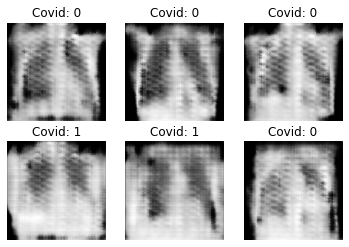

Epoch 142/300 Batch 3/3 [D loss: 0.36480, acc: 87.50%] [G loss: 3.00343]
Epoch 143/300 Batch 3/3 [D loss: 0.28854, acc: 90.62%] [G loss: 2.12845]
Epoch 144/300 Batch 3/3 [D loss: 0.42114, acc: 84.38%] [G loss: 2.13527]
Epoch 145/300 Batch 3/3 [D loss: 0.58852, acc: 73.44%] [G loss: 1.73944]
Epoch 146/300 Batch 3/3 [D loss: 0.33526, acc: 85.94%] [G loss: 1.74153]
Epoch 147/300 Batch 3/3 [D loss: 0.77619, acc: 51.56%] [G loss: 2.03165]
Epoch 148/300 Batch 3/3 [D loss: 0.25299, acc: 92.19%] [G loss: 2.47268]
Epoch 149/300 Batch 3/3 [D loss: 0.23488, acc: 92.19%] [G loss: 1.84387]
Epoch 150/300 Batch 3/3 [D loss: 0.41876, acc: 81.25%] [G loss: 2.58984]
Epoch 151/300 Batch 3/3 [D loss: 0.36401, acc: 87.50%] [G loss: 2.08221]
Epoch 152/300 Batch 3/3 [D loss: 0.26604, acc: 92.19%] [G loss: 2.15034]
Epoch 153/300 Batch 3/3 [D loss: 0.36749, acc: 79.69%] [G loss: 2.31930]
Epoch 154/300 Batch 3/3 [D loss: 0.39717, acc: 82.81%] [G loss: 2.25711]
Epoch 155/300 Batch 3/3 [D loss: 0.46383, acc: 76.5

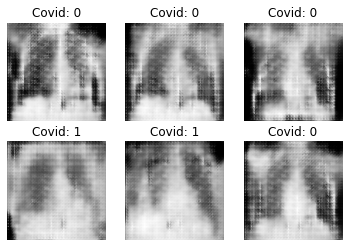

Epoch 162/300 Batch 3/3 [D loss: 0.34685, acc: 89.06%] [G loss: 1.99894]
Epoch 163/300 Batch 3/3 [D loss: 0.39800, acc: 87.50%] [G loss: 1.94525]
Epoch 164/300 Batch 3/3 [D loss: 0.40554, acc: 87.50%] [G loss: 2.11954]
Epoch 165/300 Batch 3/3 [D loss: 0.47783, acc: 79.69%] [G loss: 2.04305]
Epoch 166/300 Batch 3/3 [D loss: 0.71707, acc: 53.12%] [G loss: 2.32734]
Epoch 167/300 Batch 3/3 [D loss: 0.41687, acc: 84.38%] [G loss: 2.22805]
Epoch 168/300 Batch 3/3 [D loss: 0.48168, acc: 75.00%] [G loss: 2.52003]
Epoch 169/300 Batch 3/3 [D loss: 0.45488, acc: 75.00%] [G loss: 2.62629]
Epoch 170/300 Batch 3/3 [D loss: 0.44784, acc: 78.12%] [G loss: 3.05510]
Epoch 171/300 Batch 3/3 [D loss: 0.32983, acc: 89.06%] [G loss: 1.89448]
Epoch 172/300 Batch 3/3 [D loss: 0.26910, acc: 92.19%] [G loss: 2.04897]
Epoch 173/300 Batch 3/3 [D loss: 0.37251, acc: 85.94%] [G loss: 1.72461]
Epoch 174/300 Batch 3/3 [D loss: 0.30378, acc: 90.62%] [G loss: 2.43309]
Epoch 175/300 Batch 3/3 [D loss: 0.43523, acc: 78.1

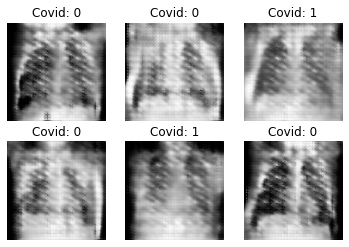

Epoch 182/300 Batch 3/3 [D loss: 0.35730, acc: 93.75%] [G loss: 2.62896]
Epoch 183/300 Batch 3/3 [D loss: 0.41353, acc: 84.38%] [G loss: 2.12623]
Epoch 184/300 Batch 3/3 [D loss: 0.36180, acc: 79.69%] [G loss: 2.64117]
Epoch 185/300 Batch 3/3 [D loss: 0.35945, acc: 87.50%] [G loss: 2.43371]
Epoch 186/300 Batch 3/3 [D loss: 0.33333, acc: 90.62%] [G loss: 3.15773]
Epoch 187/300 Batch 3/3 [D loss: 0.39443, acc: 79.69%] [G loss: 2.03758]
Epoch 188/300 Batch 3/3 [D loss: 0.48502, acc: 71.88%] [G loss: 3.35239]
Epoch 189/300 Batch 3/3 [D loss: 0.50115, acc: 73.44%] [G loss: 3.05471]
Epoch 190/300 Batch 3/3 [D loss: 0.45693, acc: 78.12%] [G loss: 2.65793]
Epoch 191/300 Batch 3/3 [D loss: 0.44595, acc: 85.94%] [G loss: 2.26824]
Epoch 192/300 Batch 3/3 [D loss: 0.51091, acc: 71.88%] [G loss: 2.08948]
Epoch 193/300 Batch 3/3 [D loss: 0.47885, acc: 71.88%] [G loss: 3.53654]
Epoch 194/300 Batch 3/3 [D loss: 0.40711, acc: 81.25%] [G loss: 2.20780]
Epoch 195/300 Batch 3/3 [D loss: 0.55025, acc: 71.8

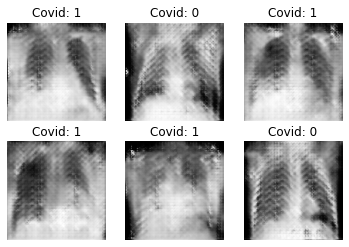

Epoch 202/300 Batch 3/3 [D loss: 0.42007, acc: 85.94%] [G loss: 2.25338]
Epoch 203/300 Batch 3/3 [D loss: 0.54578, acc: 65.62%] [G loss: 3.61145]
Epoch 204/300 Batch 3/3 [D loss: 0.59463, acc: 68.75%] [G loss: 2.45438]
Epoch 205/300 Batch 3/3 [D loss: 0.38636, acc: 87.50%] [G loss: 3.42359]
Epoch 206/300 Batch 3/3 [D loss: 0.31715, acc: 95.31%] [G loss: 2.33771]
Epoch 207/300 Batch 3/3 [D loss: 0.45632, acc: 82.81%] [G loss: 2.40312]
Epoch 208/300 Batch 3/3 [D loss: 0.38535, acc: 84.38%] [G loss: 2.79220]
Epoch 209/300 Batch 3/3 [D loss: 0.45130, acc: 79.69%] [G loss: 1.86418]
Epoch 210/300 Batch 3/3 [D loss: 0.50634, acc: 79.69%] [G loss: 1.85930]
Epoch 211/300 Batch 3/3 [D loss: 0.60953, acc: 64.06%] [G loss: 2.42576]
Epoch 212/300 Batch 3/3 [D loss: 0.33691, acc: 92.19%] [G loss: 2.06873]
Epoch 213/300 Batch 3/3 [D loss: 0.35063, acc: 85.94%] [G loss: 2.08564]
Epoch 214/300 Batch 3/3 [D loss: 0.36069, acc: 89.06%] [G loss: 2.18318]
Epoch 215/300 Batch 3/3 [D loss: 0.31525, acc: 93.7

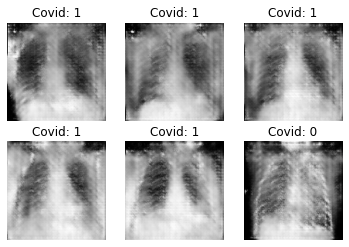

Epoch 222/300 Batch 3/3 [D loss: 0.40080, acc: 82.81%] [G loss: 2.65357]
Epoch 223/300 Batch 3/3 [D loss: 0.39988, acc: 84.38%] [G loss: 2.08590]
Epoch 224/300 Batch 3/3 [D loss: 0.47508, acc: 76.56%] [G loss: 2.79236]
Epoch 225/300 Batch 3/3 [D loss: 0.36208, acc: 85.94%] [G loss: 2.44586]
Epoch 226/300 Batch 3/3 [D loss: 0.36605, acc: 82.81%] [G loss: 3.10784]
Epoch 227/300 Batch 3/3 [D loss: 0.26220, acc: 82.81%] [G loss: 2.58938]
Epoch 228/300 Batch 3/3 [D loss: 0.38024, acc: 79.69%] [G loss: 2.48388]
Epoch 229/300 Batch 3/3 [D loss: 0.39770, acc: 89.06%] [G loss: 2.92709]
Epoch 230/300 Batch 3/3 [D loss: 0.31349, acc: 87.50%] [G loss: 2.77701]
Epoch 231/300 Batch 3/3 [D loss: 0.43955, acc: 82.81%] [G loss: 2.90812]
Epoch 232/300 Batch 3/3 [D loss: 0.23119, acc: 96.88%] [G loss: 2.31904]
Epoch 233/300 Batch 3/3 [D loss: 0.38011, acc: 82.81%] [G loss: 2.48218]
Epoch 234/300 Batch 3/3 [D loss: 0.39924, acc: 85.94%] [G loss: 3.04779]
Epoch 235/300 Batch 3/3 [D loss: 0.41563, acc: 78.1

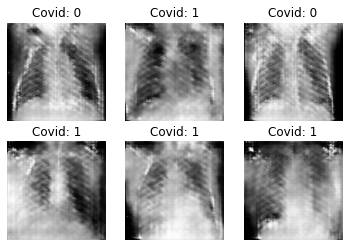

Epoch 242/300 Batch 3/3 [D loss: 0.49119, acc: 71.88%] [G loss: 3.38191]
Epoch 243/300 Batch 3/3 [D loss: 0.44246, acc: 75.00%] [G loss: 2.75696]
Epoch 244/300 Batch 3/3 [D loss: 0.42192, acc: 87.50%] [G loss: 2.15653]
Epoch 245/300 Batch 3/3 [D loss: 0.35517, acc: 87.50%] [G loss: 2.83095]
Epoch 246/300 Batch 3/3 [D loss: 0.54085, acc: 67.19%] [G loss: 5.84047]
Epoch 247/300 Batch 3/3 [D loss: 0.38450, acc: 85.94%] [G loss: 2.96175]
Epoch 248/300 Batch 3/3 [D loss: 0.34036, acc: 84.38%] [G loss: 1.78241]
Epoch 249/300 Batch 3/3 [D loss: 0.41293, acc: 82.81%] [G loss: 2.22491]
Epoch 250/300 Batch 3/3 [D loss: 0.40998, acc: 79.69%] [G loss: 2.64328]
Epoch 251/300 Batch 3/3 [D loss: 0.39231, acc: 85.94%] [G loss: 2.50422]
Epoch 252/300 Batch 3/3 [D loss: 0.31996, acc: 89.06%] [G loss: 2.49435]
Epoch 253/300 Batch 3/3 [D loss: 0.50858, acc: 70.31%] [G loss: 2.25315]
Epoch 254/300 Batch 3/3 [D loss: 0.41397, acc: 79.69%] [G loss: 1.90525]
Epoch 255/300 Batch 3/3 [D loss: 0.44606, acc: 79.6

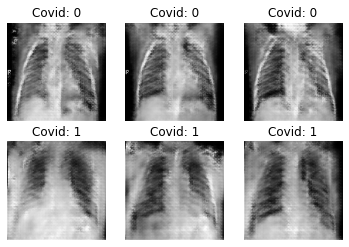

Epoch 262/300 Batch 3/3 [D loss: 0.36244, acc: 84.38%] [G loss: 3.14712]
Epoch 263/300 Batch 3/3 [D loss: 0.37420, acc: 87.50%] [G loss: 2.15008]
Epoch 264/300 Batch 3/3 [D loss: 0.49136, acc: 73.44%] [G loss: 3.28855]
Epoch 265/300 Batch 3/3 [D loss: 0.41003, acc: 79.69%] [G loss: 3.07430]
Epoch 266/300 Batch 3/3 [D loss: 0.41797, acc: 79.69%] [G loss: 2.60953]
Epoch 267/300 Batch 3/3 [D loss: 0.31353, acc: 90.62%] [G loss: 3.14024]
Epoch 268/300 Batch 3/3 [D loss: 0.36023, acc: 82.81%] [G loss: 3.20224]
Epoch 269/300 Batch 3/3 [D loss: 0.38339, acc: 84.38%] [G loss: 3.20477]
Epoch 270/300 Batch 3/3 [D loss: 0.37389, acc: 84.38%] [G loss: 2.99569]
Epoch 271/300 Batch 3/3 [D loss: 0.38368, acc: 84.38%] [G loss: 2.82764]
Epoch 272/300 Batch 3/3 [D loss: 0.47995, acc: 75.00%] [G loss: 2.27692]
Epoch 273/300 Batch 3/3 [D loss: 0.32625, acc: 93.75%] [G loss: 2.35051]
Epoch 274/300 Batch 3/3 [D loss: 0.29051, acc: 89.06%] [G loss: 3.31639]
Epoch 275/300 Batch 3/3 [D loss: 0.28230, acc: 92.1

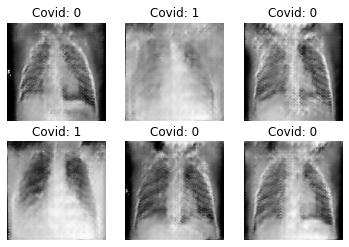

Epoch 282/300 Batch 3/3 [D loss: 0.32536, acc: 93.75%] [G loss: 3.01992]
Epoch 283/300 Batch 3/3 [D loss: 0.44025, acc: 79.69%] [G loss: 3.58503]
Epoch 284/300 Batch 3/3 [D loss: 0.44893, acc: 75.00%] [G loss: 2.45909]
Epoch 285/300 Batch 3/3 [D loss: 0.37043, acc: 79.69%] [G loss: 2.96308]
Epoch 286/300 Batch 3/3 [D loss: 0.45340, acc: 70.31%] [G loss: 3.10735]
Epoch 287/300 Batch 3/3 [D loss: 0.27260, acc: 89.06%] [G loss: 3.13973]
Epoch 288/300 Batch 3/3 [D loss: 0.36706, acc: 89.06%] [G loss: 2.33258]
Epoch 289/300 Batch 3/3 [D loss: 0.26672, acc: 92.19%] [G loss: 3.13093]
Epoch 290/300 Batch 3/3 [D loss: 0.34738, acc: 87.50%] [G loss: 2.92126]
Epoch 291/300 Batch 3/3 [D loss: 0.27088, acc: 92.19%] [G loss: 3.33610]
Epoch 292/300 Batch 3/3 [D loss: 0.22265, acc: 93.75%] [G loss: 3.23279]
Epoch 293/300 Batch 3/3 [D loss: 0.36422, acc: 81.25%] [G loss: 3.22873]
Epoch 294/300 Batch 3/3 [D loss: 0.27043, acc: 92.19%] [G loss: 2.64546]
Epoch 295/300 Batch 3/3 [D loss: 0.25334, acc: 90.6

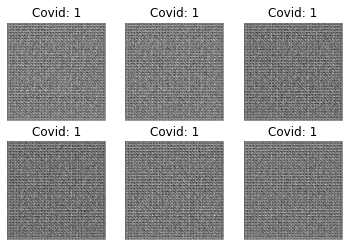

Epoch 2/300 Batch 3/3 [D loss: 0.64759, acc: 50.00%] [G loss: 0.64486]
Epoch 3/300 Batch 3/3 [D loss: 0.52235, acc: 98.44%] [G loss: 0.98605]
Epoch 4/300 Batch 3/3 [D loss: 0.37263, acc: 96.88%] [G loss: 1.40447]
Epoch 5/300 Batch 3/3 [D loss: 0.25544, acc: 98.44%] [G loss: 1.89355]
Epoch 6/300 Batch 3/3 [D loss: 0.16301, acc: 98.44%] [G loss: 2.41411]
Epoch 7/300 Batch 3/3 [D loss: 0.09697, acc: 100.00%] [G loss: 3.03506]
Epoch 8/300 Batch 3/3 [D loss: 0.06907, acc: 100.00%] [G loss: 3.38411]
Epoch 9/300 Batch 3/3 [D loss: 0.08305, acc: 100.00%] [G loss: 3.63862]
Epoch 10/300 Batch 3/3 [D loss: 0.16437, acc: 98.44%] [G loss: 3.18743]
Epoch 11/300 Batch 3/3 [D loss: 0.65774, acc: 57.81%] [G loss: 3.56611]
Epoch 12/300 Batch 3/3 [D loss: 0.36873, acc: 89.06%] [G loss: 2.07313]
Epoch 13/300 Batch 3/3 [D loss: 0.40067, acc: 92.19%] [G loss: 3.04140]
Epoch 14/300 Batch 3/3 [D loss: 0.44531, acc: 90.62%] [G loss: 2.73116]
Epoch 15/300 Batch 3/3 [D loss: 0.44807, acc: 84.38%] [G loss: 3.3106

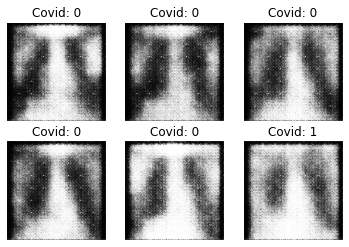

Epoch 22/300 Batch 3/3 [D loss: 0.78929, acc: 51.56%] [G loss: 1.22265]
Epoch 23/300 Batch 3/3 [D loss: 0.73817, acc: 48.44%] [G loss: 1.15184]
Epoch 24/300 Batch 3/3 [D loss: 0.65275, acc: 59.38%] [G loss: 1.71047]
Epoch 25/300 Batch 3/3 [D loss: 0.58139, acc: 78.12%] [G loss: 1.59694]
Epoch 26/300 Batch 3/3 [D loss: 0.58053, acc: 75.00%] [G loss: 1.49554]
Epoch 27/300 Batch 3/3 [D loss: 0.48535, acc: 78.12%] [G loss: 1.33587]
Epoch 28/300 Batch 3/3 [D loss: 0.43785, acc: 76.56%] [G loss: 1.22970]
Epoch 29/300 Batch 3/3 [D loss: 0.81129, acc: 43.75%] [G loss: 1.24048]
Epoch 30/300 Batch 3/3 [D loss: 0.56625, acc: 71.88%] [G loss: 1.21074]
Epoch 31/300 Batch 3/3 [D loss: 0.63900, acc: 64.06%] [G loss: 1.13005]
Epoch 32/300 Batch 3/3 [D loss: 0.81206, acc: 45.31%] [G loss: 0.97051]
Epoch 33/300 Batch 3/3 [D loss: 0.68930, acc: 73.44%] [G loss: 1.22236]
Epoch 34/300 Batch 3/3 [D loss: 0.77089, acc: 31.25%] [G loss: 0.95944]
Epoch 35/300 Batch 3/3 [D loss: 0.67576, acc: 62.50%] [G loss: 0

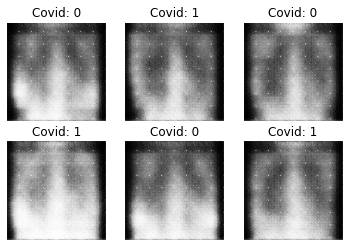

Epoch 42/300 Batch 3/3 [D loss: 0.60348, acc: 76.56%] [G loss: 0.96605]
Epoch 43/300 Batch 3/3 [D loss: 0.47843, acc: 90.62%] [G loss: 1.30254]
Epoch 44/300 Batch 3/3 [D loss: 0.57365, acc: 82.81%] [G loss: 1.08374]
Epoch 45/300 Batch 3/3 [D loss: 0.53169, acc: 92.19%] [G loss: 1.17426]
Epoch 46/300 Batch 3/3 [D loss: 0.54128, acc: 82.81%] [G loss: 1.18677]
Epoch 47/300 Batch 3/3 [D loss: 0.52370, acc: 92.19%] [G loss: 1.17830]
Epoch 48/300 Batch 3/3 [D loss: 0.55519, acc: 78.12%] [G loss: 1.09149]
Epoch 49/300 Batch 3/3 [D loss: 0.56310, acc: 78.12%] [G loss: 1.15445]
Epoch 50/300 Batch 3/3 [D loss: 0.53426, acc: 81.25%] [G loss: 1.24310]
Epoch 51/300 Batch 3/3 [D loss: 0.55834, acc: 81.25%] [G loss: 1.15028]
Epoch 52/300 Batch 3/3 [D loss: 0.54849, acc: 79.69%] [G loss: 1.12462]
Epoch 53/300 Batch 3/3 [D loss: 0.58908, acc: 71.88%] [G loss: 1.21041]
Epoch 54/300 Batch 3/3 [D loss: 0.60236, acc: 75.00%] [G loss: 1.20704]
Epoch 55/300 Batch 3/3 [D loss: 0.56993, acc: 82.81%] [G loss: 1

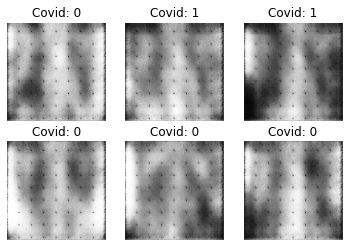

Epoch 62/300 Batch 3/3 [D loss: 0.78742, acc: 28.12%] [G loss: 0.69131]
Epoch 63/300 Batch 3/3 [D loss: 0.71646, acc: 48.44%] [G loss: 0.76960]
Epoch 64/300 Batch 3/3 [D loss: 0.65183, acc: 62.50%] [G loss: 0.72559]
Epoch 65/300 Batch 3/3 [D loss: 0.66180, acc: 50.00%] [G loss: 0.63662]
Epoch 66/300 Batch 3/3 [D loss: 0.58496, acc: 71.88%] [G loss: 0.71086]
Epoch 67/300 Batch 3/3 [D loss: 0.58008, acc: 68.75%] [G loss: 0.73248]
Epoch 68/300 Batch 3/3 [D loss: 0.56704, acc: 78.12%] [G loss: 0.74264]
Epoch 69/300 Batch 3/3 [D loss: 0.57155, acc: 73.44%] [G loss: 0.73115]
Epoch 70/300 Batch 3/3 [D loss: 0.63887, acc: 54.69%] [G loss: 0.66533]
Epoch 71/300 Batch 3/3 [D loss: 0.64220, acc: 62.50%] [G loss: 0.67410]
Epoch 72/300 Batch 3/3 [D loss: 0.71839, acc: 43.75%] [G loss: 0.57844]
Epoch 73/300 Batch 3/3 [D loss: 0.66408, acc: 54.69%] [G loss: 0.73356]
Epoch 74/300 Batch 3/3 [D loss: 0.64297, acc: 71.88%] [G loss: 0.73582]
Epoch 75/300 Batch 3/3 [D loss: 0.69599, acc: 48.44%] [G loss: 0

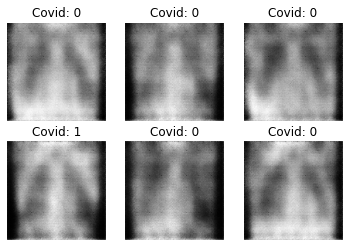

Epoch 82/300 Batch 3/3 [D loss: 0.68797, acc: 51.56%] [G loss: 0.65545]
Epoch 83/300 Batch 3/3 [D loss: 0.70090, acc: 46.88%] [G loss: 0.63976]
Epoch 84/300 Batch 3/3 [D loss: 0.69594, acc: 48.44%] [G loss: 0.75361]
Epoch 85/300 Batch 3/3 [D loss: 0.68413, acc: 48.44%] [G loss: 0.71194]
Epoch 86/300 Batch 3/3 [D loss: 0.70365, acc: 40.62%] [G loss: 0.71549]
Epoch 87/300 Batch 3/3 [D loss: 0.71062, acc: 40.62%] [G loss: 0.73238]
Epoch 88/300 Batch 3/3 [D loss: 0.71369, acc: 40.62%] [G loss: 0.64674]
Epoch 89/300 Batch 3/3 [D loss: 0.68982, acc: 50.00%] [G loss: 0.62757]
Epoch 90/300 Batch 3/3 [D loss: 0.73957, acc: 35.94%] [G loss: 0.62348]
Epoch 91/300 Batch 3/3 [D loss: 0.74644, acc: 35.94%] [G loss: 0.64991]
Epoch 92/300 Batch 3/3 [D loss: 0.73905, acc: 28.12%] [G loss: 0.64168]
Epoch 93/300 Batch 3/3 [D loss: 0.75867, acc: 31.25%] [G loss: 0.64851]
Epoch 94/300 Batch 3/3 [D loss: 0.71487, acc: 39.06%] [G loss: 0.67106]
Epoch 95/300 Batch 3/3 [D loss: 0.71494, acc: 40.62%] [G loss: 0

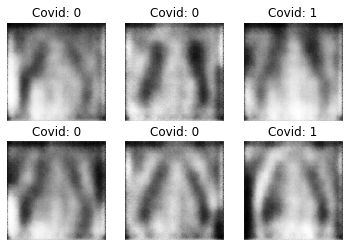

Epoch 102/300 Batch 3/3 [D loss: 0.72731, acc: 39.06%] [G loss: 0.64478]
Epoch 103/300 Batch 3/3 [D loss: 0.74162, acc: 29.69%] [G loss: 0.61446]
Epoch 104/300 Batch 3/3 [D loss: 0.71357, acc: 43.75%] [G loss: 0.62136]
Epoch 105/300 Batch 3/3 [D loss: 0.69970, acc: 46.88%] [G loss: 0.63545]
Epoch 106/300 Batch 3/3 [D loss: 0.71368, acc: 39.06%] [G loss: 0.63165]
Epoch 107/300 Batch 3/3 [D loss: 0.70638, acc: 39.06%] [G loss: 0.63995]
Epoch 108/300 Batch 3/3 [D loss: 0.69192, acc: 42.19%] [G loss: 0.63534]
Epoch 109/300 Batch 3/3 [D loss: 0.69973, acc: 43.75%] [G loss: 0.64414]
Epoch 110/300 Batch 3/3 [D loss: 0.67662, acc: 48.44%] [G loss: 0.66527]
Epoch 111/300 Batch 3/3 [D loss: 0.68025, acc: 46.88%] [G loss: 0.66810]
Epoch 112/300 Batch 3/3 [D loss: 0.67118, acc: 51.56%] [G loss: 0.65805]
Epoch 113/300 Batch 3/3 [D loss: 0.65362, acc: 54.69%] [G loss: 0.65502]
Epoch 114/300 Batch 3/3 [D loss: 0.66670, acc: 51.56%] [G loss: 0.64402]
Epoch 115/300 Batch 3/3 [D loss: 0.65273, acc: 54.6

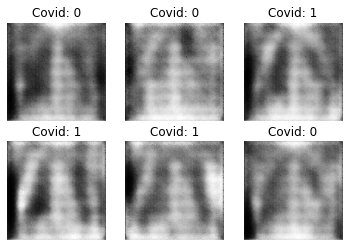

Epoch 122/300 Batch 3/3 [D loss: 0.68496, acc: 50.00%] [G loss: 0.61300]
Epoch 123/300 Batch 3/3 [D loss: 0.68598, acc: 51.56%] [G loss: 0.62722]
Epoch 124/300 Batch 3/3 [D loss: 0.66861, acc: 57.81%] [G loss: 0.64386]
Epoch 125/300 Batch 3/3 [D loss: 0.64366, acc: 59.38%] [G loss: 0.67826]
Epoch 126/300 Batch 3/3 [D loss: 0.64192, acc: 62.50%] [G loss: 0.69077]
Epoch 127/300 Batch 3/3 [D loss: 0.65097, acc: 60.94%] [G loss: 0.69994]
Epoch 128/300 Batch 3/3 [D loss: 0.65948, acc: 60.94%] [G loss: 0.68064]
Epoch 129/300 Batch 3/3 [D loss: 0.65295, acc: 57.81%] [G loss: 0.68340]
Epoch 130/300 Batch 3/3 [D loss: 0.64916, acc: 64.06%] [G loss: 0.68850]
Epoch 131/300 Batch 3/3 [D loss: 0.66902, acc: 54.69%] [G loss: 0.69349]
Epoch 132/300 Batch 3/3 [D loss: 0.68274, acc: 64.06%] [G loss: 0.66203]
Epoch 133/300 Batch 3/3 [D loss: 0.69542, acc: 45.31%] [G loss: 0.66861]
Epoch 134/300 Batch 3/3 [D loss: 0.69445, acc: 50.00%] [G loss: 0.69056]
Epoch 135/300 Batch 3/3 [D loss: 0.69045, acc: 56.2

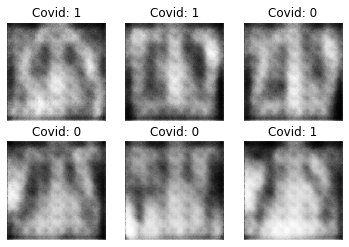

Epoch 142/300 Batch 3/3 [D loss: 0.63031, acc: 79.69%] [G loss: 0.71701]
Epoch 143/300 Batch 3/3 [D loss: 0.63550, acc: 71.88%] [G loss: 0.69888]
Epoch 144/300 Batch 3/3 [D loss: 0.64443, acc: 65.62%] [G loss: 0.68606]
Epoch 145/300 Batch 3/3 [D loss: 0.63131, acc: 71.88%] [G loss: 0.68602]
Epoch 146/300 Batch 3/3 [D loss: 0.68567, acc: 53.12%] [G loss: 0.66130]
Epoch 147/300 Batch 3/3 [D loss: 0.66294, acc: 57.81%] [G loss: 0.64494]
Epoch 148/300 Batch 3/3 [D loss: 0.67077, acc: 50.00%] [G loss: 0.63934]
Epoch 149/300 Batch 3/3 [D loss: 0.68080, acc: 46.88%] [G loss: 0.64379]
Epoch 150/300 Batch 3/3 [D loss: 0.65504, acc: 53.12%] [G loss: 0.64108]
Epoch 151/300 Batch 3/3 [D loss: 0.65412, acc: 54.69%] [G loss: 0.63744]
Epoch 152/300 Batch 3/3 [D loss: 0.64906, acc: 53.12%] [G loss: 0.65109]
Epoch 153/300 Batch 3/3 [D loss: 0.65268, acc: 51.56%] [G loss: 0.65120]
Epoch 154/300 Batch 3/3 [D loss: 0.66730, acc: 48.44%] [G loss: 0.66235]
Epoch 155/300 Batch 3/3 [D loss: 0.65717, acc: 46.8

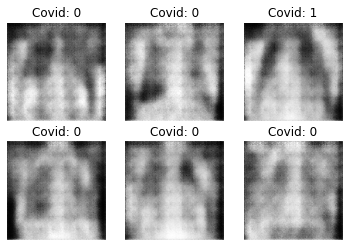

Epoch 162/300 Batch 3/3 [D loss: 0.66948, acc: 53.12%] [G loss: 0.68007]
Epoch 163/300 Batch 3/3 [D loss: 0.67502, acc: 45.31%] [G loss: 0.66178]
Epoch 164/300 Batch 3/3 [D loss: 0.65999, acc: 59.38%] [G loss: 0.67524]
Epoch 165/300 Batch 3/3 [D loss: 0.65582, acc: 60.94%] [G loss: 0.68738]
Epoch 166/300 Batch 3/3 [D loss: 0.67022, acc: 57.81%] [G loss: 0.66906]
Epoch 167/300 Batch 3/3 [D loss: 0.66220, acc: 50.00%] [G loss: 0.66887]
Epoch 168/300 Batch 3/3 [D loss: 0.66972, acc: 60.94%] [G loss: 0.67576]
Epoch 169/300 Batch 3/3 [D loss: 0.66001, acc: 56.25%] [G loss: 0.66622]
Epoch 170/300 Batch 3/3 [D loss: 0.66610, acc: 48.44%] [G loss: 0.68529]
Epoch 171/300 Batch 3/3 [D loss: 0.66435, acc: 54.69%] [G loss: 0.66916]
Epoch 172/300 Batch 3/3 [D loss: 0.67774, acc: 50.00%] [G loss: 0.65827]
Epoch 173/300 Batch 3/3 [D loss: 0.65234, acc: 51.56%] [G loss: 0.64876]
Epoch 174/300 Batch 3/3 [D loss: 0.64986, acc: 53.12%] [G loss: 0.66891]
Epoch 175/300 Batch 3/3 [D loss: 0.66307, acc: 56.2

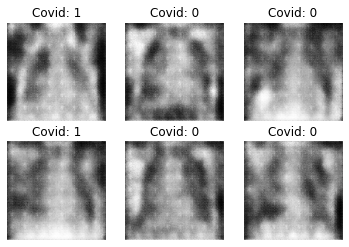

Epoch 182/300 Batch 3/3 [D loss: 0.65053, acc: 51.56%] [G loss: 0.68843]
Epoch 183/300 Batch 3/3 [D loss: 0.64269, acc: 64.06%] [G loss: 0.69781]
Epoch 184/300 Batch 3/3 [D loss: 0.64617, acc: 67.19%] [G loss: 0.71085]
Epoch 185/300 Batch 3/3 [D loss: 0.66482, acc: 59.38%] [G loss: 0.69789]
Epoch 186/300 Batch 3/3 [D loss: 0.66655, acc: 56.25%] [G loss: 0.67506]
Epoch 187/300 Batch 3/3 [D loss: 0.65841, acc: 64.06%] [G loss: 0.68262]
Epoch 188/300 Batch 3/3 [D loss: 0.65719, acc: 57.81%] [G loss: 0.70108]
Epoch 189/300 Batch 3/3 [D loss: 0.65436, acc: 60.94%] [G loss: 0.69882]
Epoch 190/300 Batch 3/3 [D loss: 0.68076, acc: 51.56%] [G loss: 0.69454]
Epoch 191/300 Batch 3/3 [D loss: 0.68207, acc: 51.56%] [G loss: 0.68290]
Epoch 192/300 Batch 3/3 [D loss: 0.68953, acc: 53.12%] [G loss: 0.69733]
Epoch 193/300 Batch 3/3 [D loss: 0.67578, acc: 60.94%] [G loss: 0.68782]
Epoch 194/300 Batch 3/3 [D loss: 0.66371, acc: 53.12%] [G loss: 0.68976]
Epoch 195/300 Batch 3/3 [D loss: 0.66633, acc: 57.8

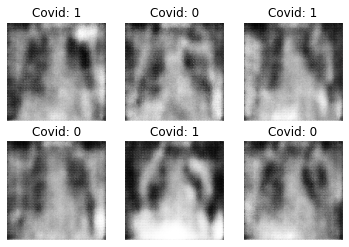

Epoch 202/300 Batch 3/3 [D loss: 0.64392, acc: 70.31%] [G loss: 0.74139]
Epoch 203/300 Batch 3/3 [D loss: 0.64640, acc: 57.81%] [G loss: 0.70970]
Epoch 204/300 Batch 3/3 [D loss: 0.64803, acc: 67.19%] [G loss: 0.73624]
Epoch 205/300 Batch 3/3 [D loss: 0.66387, acc: 57.81%] [G loss: 0.71775]
Epoch 206/300 Batch 3/3 [D loss: 0.63574, acc: 73.44%] [G loss: 0.70979]
Epoch 207/300 Batch 3/3 [D loss: 0.65428, acc: 70.31%] [G loss: 0.72608]
Epoch 208/300 Batch 3/3 [D loss: 0.66212, acc: 64.06%] [G loss: 0.75050]
Epoch 209/300 Batch 3/3 [D loss: 0.63484, acc: 70.31%] [G loss: 0.73927]
Epoch 210/300 Batch 3/3 [D loss: 0.64992, acc: 65.62%] [G loss: 0.75452]
Epoch 211/300 Batch 3/3 [D loss: 0.64794, acc: 70.31%] [G loss: 0.73337]
Epoch 212/300 Batch 3/3 [D loss: 0.65466, acc: 62.50%] [G loss: 0.71871]
Epoch 213/300 Batch 3/3 [D loss: 0.67483, acc: 53.12%] [G loss: 0.69560]
Epoch 214/300 Batch 3/3 [D loss: 0.64381, acc: 64.06%] [G loss: 0.72067]
Epoch 215/300 Batch 3/3 [D loss: 0.65969, acc: 54.6

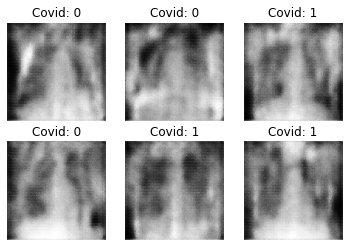

Epoch 222/300 Batch 3/3 [D loss: 0.66806, acc: 59.38%] [G loss: 0.72371]
Epoch 223/300 Batch 3/3 [D loss: 0.64084, acc: 67.19%] [G loss: 0.72454]
Epoch 224/300 Batch 3/3 [D loss: 0.65006, acc: 60.94%] [G loss: 0.71662]
Epoch 225/300 Batch 3/3 [D loss: 0.65381, acc: 62.50%] [G loss: 0.73216]
Epoch 226/300 Batch 3/3 [D loss: 0.65415, acc: 64.06%] [G loss: 0.73193]
Epoch 227/300 Batch 3/3 [D loss: 0.63152, acc: 71.88%] [G loss: 0.73447]
Epoch 228/300 Batch 3/3 [D loss: 0.63559, acc: 68.75%] [G loss: 0.72826]
Epoch 229/300 Batch 3/3 [D loss: 0.66523, acc: 54.69%] [G loss: 0.70952]
Epoch 230/300 Batch 3/3 [D loss: 0.64810, acc: 59.38%] [G loss: 0.72464]
Epoch 231/300 Batch 3/3 [D loss: 0.66884, acc: 59.38%] [G loss: 0.72600]
Epoch 232/300 Batch 3/3 [D loss: 0.65685, acc: 68.75%] [G loss: 0.72450]
Epoch 233/300 Batch 3/3 [D loss: 0.65704, acc: 64.06%] [G loss: 0.72105]
Epoch 234/300 Batch 3/3 [D loss: 0.63837, acc: 68.75%] [G loss: 0.72170]
Epoch 235/300 Batch 3/3 [D loss: 0.65279, acc: 57.8

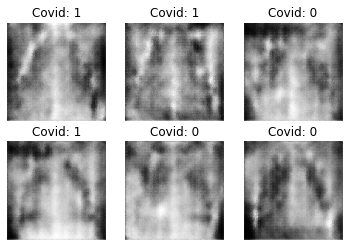

Epoch 242/300 Batch 3/3 [D loss: 0.61199, acc: 81.25%] [G loss: 0.74075]
Epoch 243/300 Batch 3/3 [D loss: 0.64294, acc: 62.50%] [G loss: 0.72426]
Epoch 244/300 Batch 3/3 [D loss: 0.64915, acc: 57.81%] [G loss: 0.72957]
Epoch 245/300 Batch 3/3 [D loss: 0.61267, acc: 73.44%] [G loss: 0.76914]
Epoch 246/300 Batch 3/3 [D loss: 0.62152, acc: 68.75%] [G loss: 0.73749]
Epoch 247/300 Batch 3/3 [D loss: 0.62639, acc: 68.75%] [G loss: 0.77145]
Epoch 248/300 Batch 3/3 [D loss: 0.62101, acc: 71.88%] [G loss: 0.75994]
Epoch 249/300 Batch 3/3 [D loss: 0.62155, acc: 68.75%] [G loss: 0.72067]
Epoch 250/300 Batch 3/3 [D loss: 0.63700, acc: 65.62%] [G loss: 0.74853]
Epoch 251/300 Batch 3/3 [D loss: 0.63284, acc: 70.31%] [G loss: 0.76312]
Epoch 252/300 Batch 3/3 [D loss: 0.63182, acc: 67.19%] [G loss: 0.74903]
Epoch 253/300 Batch 3/3 [D loss: 0.60623, acc: 82.81%] [G loss: 0.77562]
Epoch 254/300 Batch 3/3 [D loss: 0.62558, acc: 73.44%] [G loss: 0.76603]
Epoch 255/300 Batch 3/3 [D loss: 0.60574, acc: 78.1

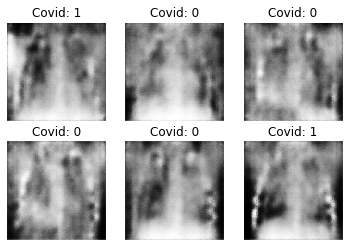

Epoch 262/300 Batch 3/3 [D loss: 0.58172, acc: 82.81%] [G loss: 0.80437]
Epoch 263/300 Batch 3/3 [D loss: 0.58380, acc: 79.69%] [G loss: 0.82530]
Epoch 264/300 Batch 3/3 [D loss: 0.61921, acc: 67.19%] [G loss: 0.78637]
Epoch 265/300 Batch 3/3 [D loss: 0.58867, acc: 76.56%] [G loss: 0.76619]
Epoch 266/300 Batch 3/3 [D loss: 0.57789, acc: 79.69%] [G loss: 0.80798]
Epoch 267/300 Batch 3/3 [D loss: 0.59017, acc: 78.12%] [G loss: 0.81874]
Epoch 268/300 Batch 3/3 [D loss: 0.62541, acc: 68.75%] [G loss: 0.88511]
Epoch 269/300 Batch 3/3 [D loss: 0.62132, acc: 75.00%] [G loss: 0.83336]
Epoch 270/300 Batch 3/3 [D loss: 0.55329, acc: 82.81%] [G loss: 0.84991]
Epoch 271/300 Batch 3/3 [D loss: 0.61847, acc: 70.31%] [G loss: 0.80793]
Epoch 272/300 Batch 3/3 [D loss: 0.57279, acc: 78.12%] [G loss: 0.86953]
Epoch 273/300 Batch 3/3 [D loss: 0.58039, acc: 75.00%] [G loss: 0.81135]
Epoch 274/300 Batch 3/3 [D loss: 0.57295, acc: 76.56%] [G loss: 0.88215]
Epoch 275/300 Batch 3/3 [D loss: 0.58571, acc: 70.3

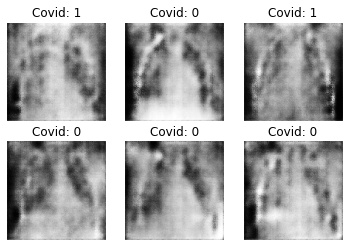

Epoch 282/300 Batch 3/3 [D loss: 0.61964, acc: 78.12%] [G loss: 0.86222]
Epoch 283/300 Batch 3/3 [D loss: 0.54255, acc: 82.81%] [G loss: 0.90815]
Epoch 284/300 Batch 3/3 [D loss: 0.59152, acc: 78.12%] [G loss: 0.90005]
Epoch 285/300 Batch 3/3 [D loss: 0.51019, acc: 85.94%] [G loss: 1.02156]
Epoch 286/300 Batch 3/3 [D loss: 0.53685, acc: 79.69%] [G loss: 0.83517]
Epoch 287/300 Batch 3/3 [D loss: 0.54828, acc: 78.12%] [G loss: 0.93130]
Epoch 288/300 Batch 3/3 [D loss: 0.52135, acc: 85.94%] [G loss: 0.94250]
Epoch 289/300 Batch 3/3 [D loss: 0.58503, acc: 71.88%] [G loss: 0.97872]
Epoch 290/300 Batch 3/3 [D loss: 0.58105, acc: 70.31%] [G loss: 0.90794]
Epoch 291/300 Batch 3/3 [D loss: 0.47803, acc: 89.06%] [G loss: 1.06136]
Epoch 292/300 Batch 3/3 [D loss: 0.54775, acc: 71.88%] [G loss: 1.08827]
Epoch 293/300 Batch 3/3 [D loss: 0.53275, acc: 84.38%] [G loss: 1.17710]
Epoch 294/300 Batch 3/3 [D loss: 0.46188, acc: 85.94%] [G loss: 1.13667]
Epoch 295/300 Batch 3/3 [D loss: 0.58578, acc: 68.7

In [ ]:
# build only models for 300 epochs and bs 64 because runtime was disconnected (again)
for e in [300]:
  for bs in [64]:
    for lr in params['learning_rate']:
      name = 'e_'+str(e)+'_bs_'+str(bs)+'_lr_'+str(lr) #create a model name
      os.mkdir('images/'+name)
      cgan = CGAN(data, lr)  
      cgan.train(e, bs, name)  

### 1.2.2 - Generating Images (Part 1)


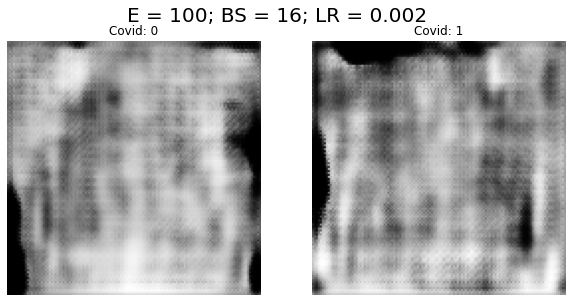

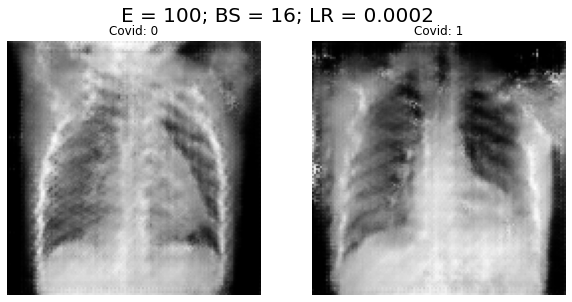

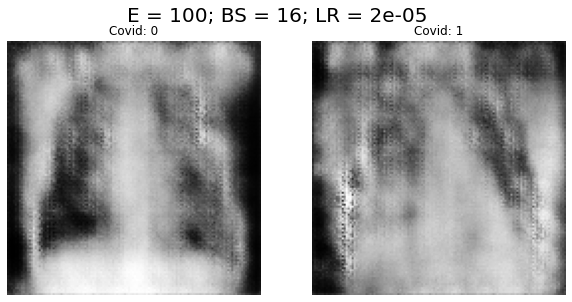

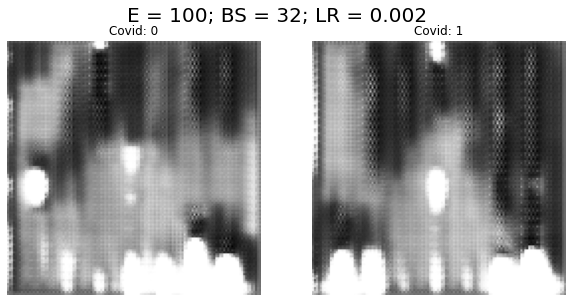

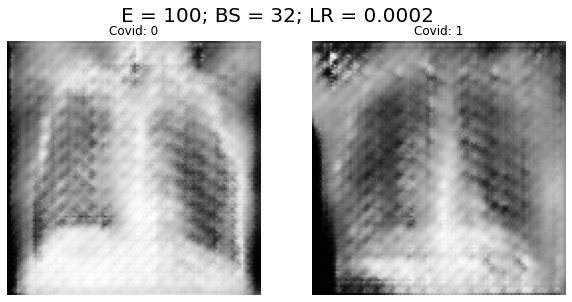

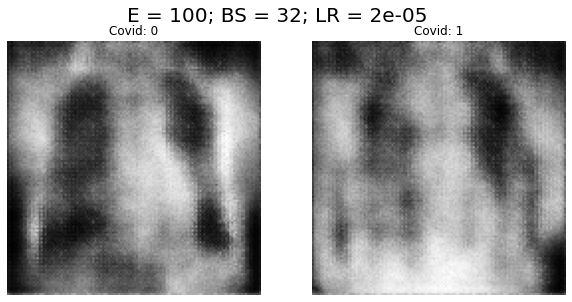

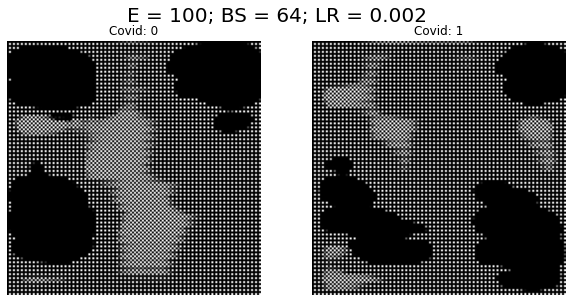

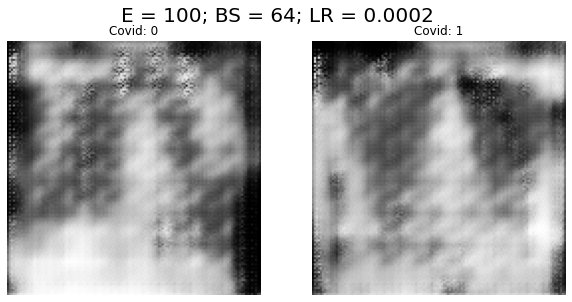

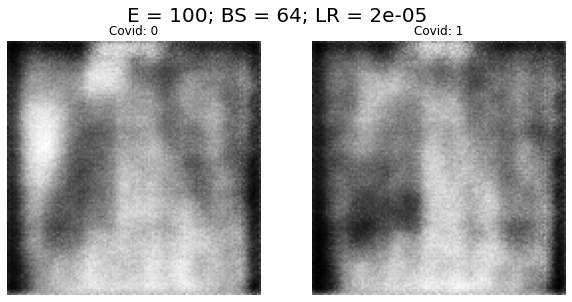

In [ ]:
def generate_images(model_name, r, c, title, latent_dim=100, num_classes=2):
    # load model
    model = load_model('models/'+model_name+'.h5')
    # generate random noise + labels
    noise = np.random.normal(0, 1, (r*c, 100))
    labels = np.array([0,1])
    # generate images
    imgs = model.predict([noise, labels])
    imgs = 0.5 * imgs + 0.5  # rescale images 0 - 1
    plot_images(imgs, labels, r, c, title) # visualize images

# create plot of generated images
def plot_images(imgs, labels, r, c, title):
    fig, axs = plt.subplots(r, c)
    fig.set_figheight(5)
    fig.set_figwidth(10)
    fig.suptitle(title, size=20, y=0.95)
    cnt = 0
    for j in range(c):
      axs[j].imshow(imgs[cnt,:,:,0], cmap='gray')
      axs[j].set_title("Covid: %d" % labels[cnt])
      axs[j].axis('off')
      cnt += 1
    plt.show()
    plt.close()

# visualize generated images of different models with different hyperparameters
for e in [100]:
  for bs in params['batch_size']:
    for lr in params['learning_rate']:
      name = 'e_'+str(e)+'_bs_'+str(bs)+'_lr_'+str(lr) #create a model name
      title = 'E = ' + str(e) + '; BS = ' + str(bs) + '; LR = ' + str(lr)
      generate_images(name, 1, 2, title)

### 1.2.2 - Generating Images (Part 2)


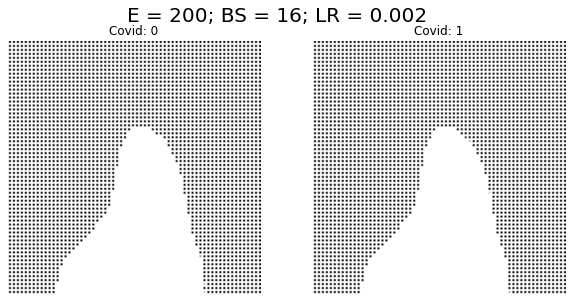

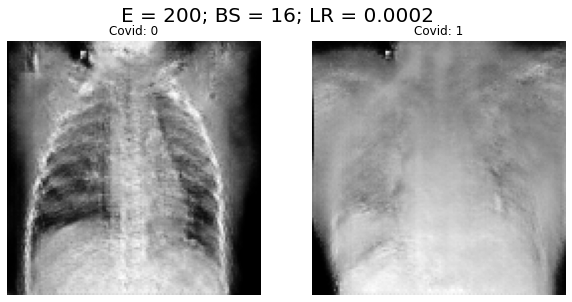

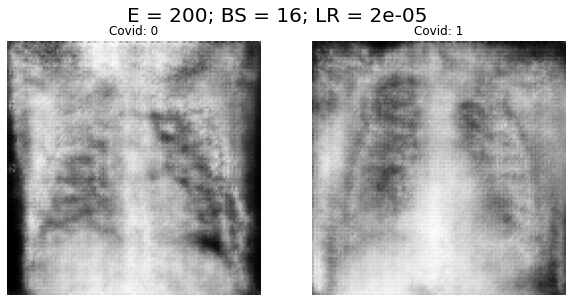

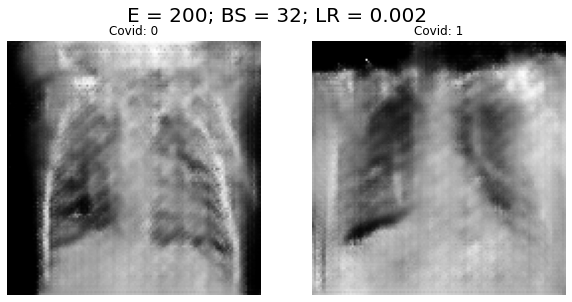

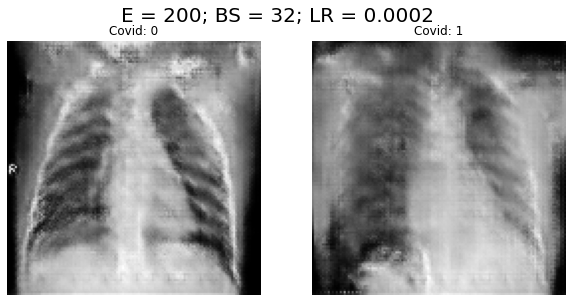

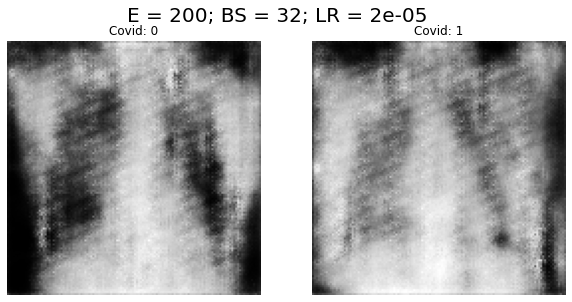

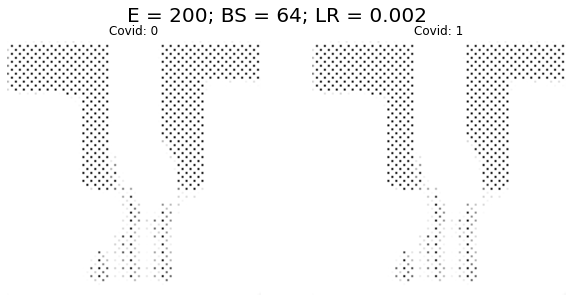

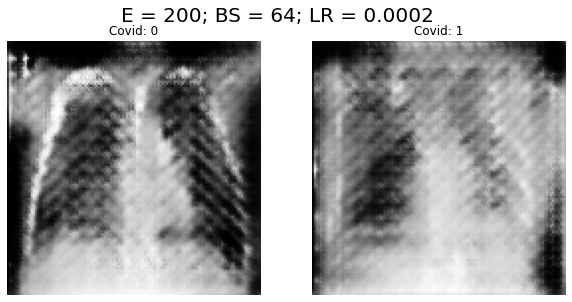

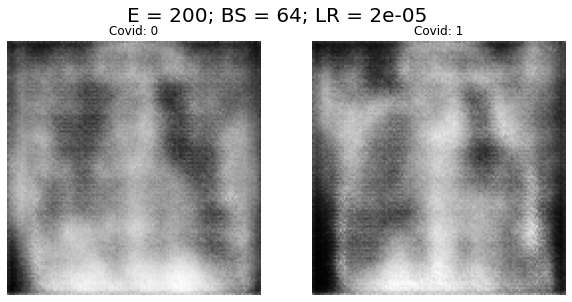

In [ ]:
def generate_images(model_name, r, c, title, latent_dim=100, num_classes=2):
    # load model
    model = load_model('models/'+model_name+'.h5')
    # generate random noise + labels
    noise = np.random.normal(0, 1, (r*c, 100))
    labels = np.array([0,1])
    # generate images
    imgs = model.predict([noise, labels])
    imgs = 0.5 * imgs + 0.5  # rescale images 0 - 1
    plot_images(imgs, labels, r, c, title) # visualize images

# create plot of generated images
def plot_images(imgs, labels, r, c, title):
    fig, axs = plt.subplots(r, c)
    fig.set_figheight(5)
    fig.set_figwidth(10)
    fig.suptitle(title, size=20, y=0.95)
    cnt = 0
    for j in range(c):
      axs[j].imshow(imgs[cnt,:,:,0], cmap='gray')
      axs[j].set_title("Covid: %d" % labels[cnt])
      axs[j].axis('off')
      cnt += 1
    plt.show()
    plt.close()

# visualize generated images of different models with different hyperparameters
for e in [200]:
  for bs in params['batch_size']:
    for lr in params['learning_rate']:
      name = 'e_'+str(e)+'_bs_'+str(bs)+'_lr_'+str(lr) #create a model name
      title = 'E = ' + str(e) + '; BS = ' + str(bs) + '; LR = ' + str(lr)
      generate_images(name, 1, 2, title)

### 1.2.2 - Generating Images (Part 3)


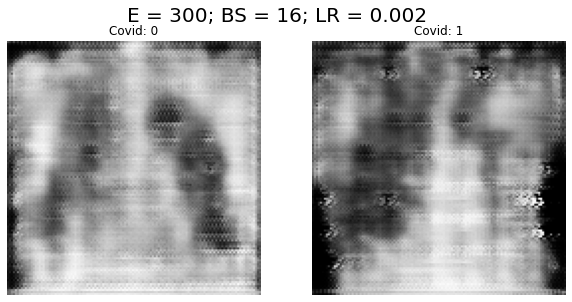

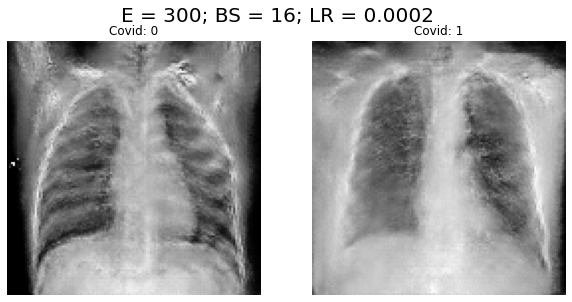

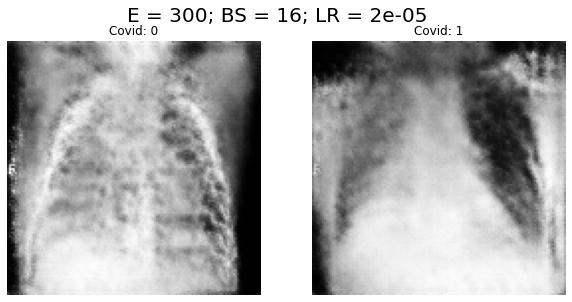

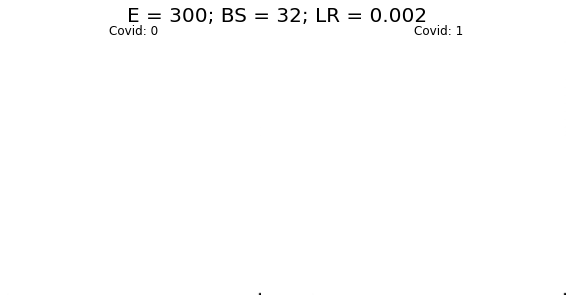

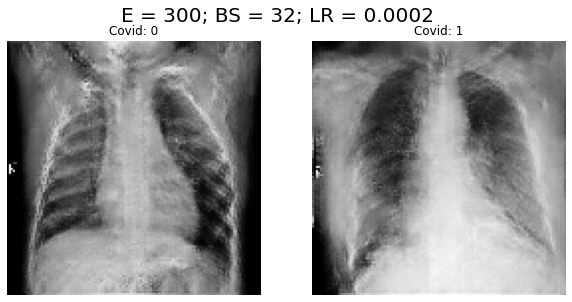

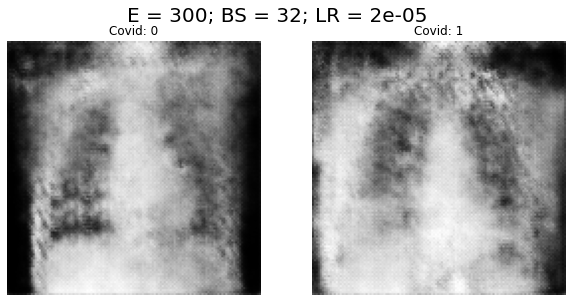

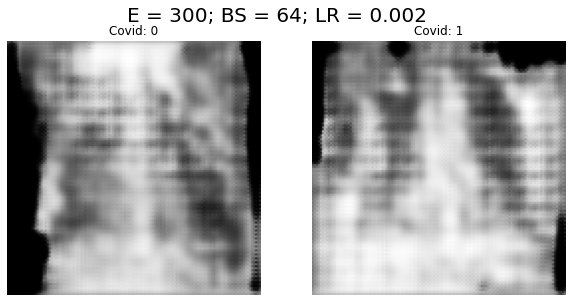

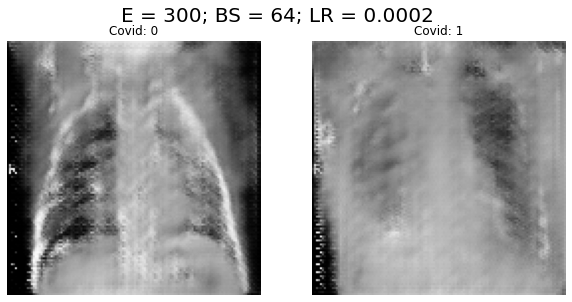

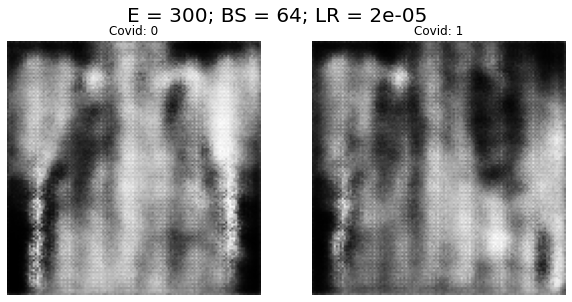

In [ ]:
def generate_images(model_name, r, c, title, latent_dim=100, num_classes=2):
    # load model
    model = load_model('models/'+model_name+'.h5')
    # generate random noise + labels
    noise = np.random.normal(0, 1, (r*c, 100))
    labels = np.array([0,1])
    # generate images
    imgs = model.predict([noise, labels])
    imgs = 0.5 * imgs + 0.5  # rescale images 0 - 1
    plot_images(imgs, labels, r, c, title) # visualize images

# create plot of generated images
def plot_images(imgs, labels, r, c, title):
    fig, axs = plt.subplots(r, c)
    fig.set_figheight(5)
    fig.set_figwidth(10)
    fig.suptitle(title, size=20, y=0.95)
    cnt = 0
    for j in range(c):
      axs[j].imshow(imgs[cnt,:,:,0], cmap='gray')
      axs[j].set_title("Covid: %d" % labels[cnt])
      axs[j].axis('off')
      cnt += 1
    plt.show()
    plt.close()
    

# visualize generated images of different models with different hyperparameters
for e in [300]:
  for bs in params['batch_size']:
    for lr in params['learning_rate']:
      name = 'e_'+str(e)+'_bs_'+str(bs)+'_lr_'+str(lr) #create a model name
      title = 'E = ' + str(e) + '; BS = ' + str(bs) + '; LR = ' + str(lr)
      generate_images(name, 1, 2, title)

# **Task 2: Detect Covid-19 from Chest X-Ray Images using pre-trained networks**

In subtask 2.1, I created a script which loads a pretrained ResNet-50 model with imagenet weights and with the last fully connected layer removed (include_top=False). I then freeze the whole pretrained model (by settting all layers to trainable=False) and add a **flatten**, **dense**, **dropout** and another **dense** layer as a binary classifier to the end of the model. I split the dataset into 80% training and 20% training. I also used 10% of the training set as a validation set during training. I created a function 'plot_training_metrics' to illustrate the model's training and validation loss/accuracy. At the end of the script the model is evaluated using the test set, and a function 'plot_cf_and_classification' to display the confusion matrix and classification report (containing accuracy, and other metrics).

In subtask 2.2, I use the except same functions as subtask 2.1, however I manipulate the X_train values so that they include 50 randomly selected images of COVID labelled X-Ray images from the real dataset, 50 randomly generated images of COVID (using the best performing pretrained cGAN model from Subtask 1.2) images and 100 of the NORMAL labelled X-RAY images from the real dataset.


## Subtask 2.1 - Building a binary classification model using transfer learning

Model: "resnet50"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_9 (InputLayer)            [(None, 128, 128, 3) 0                                            
__________________________________________________________________________________________________
conv1_pad (ZeroPadding2D)       (None, 134, 134, 3)  0           input_9[0][0]                    
__________________________________________________________________________________________________
conv1_conv (Conv2D)             (None, 64, 64, 64)   9472        conv1_pad[0][0]                  
__________________________________________________________________________________________________
conv1_bn (BatchNormalization)   (None, 64, 64, 64)   256         conv1_conv[0][0]                 
___________________________________________________________________________________________

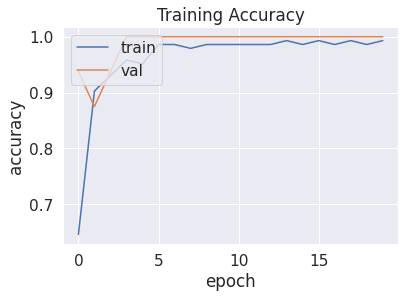

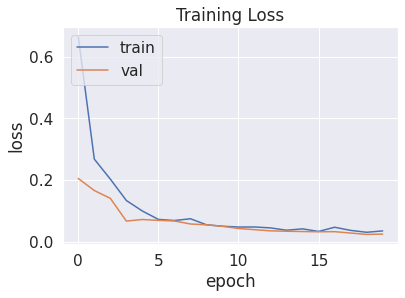

              precision    recall  f1-score   support

           0       1.00      1.00      1.00        20
           1       1.00      1.00      1.00        20

    accuracy                           1.00        40
   macro avg       1.00      1.00      1.00        40
weighted avg       1.00      1.00      1.00        40



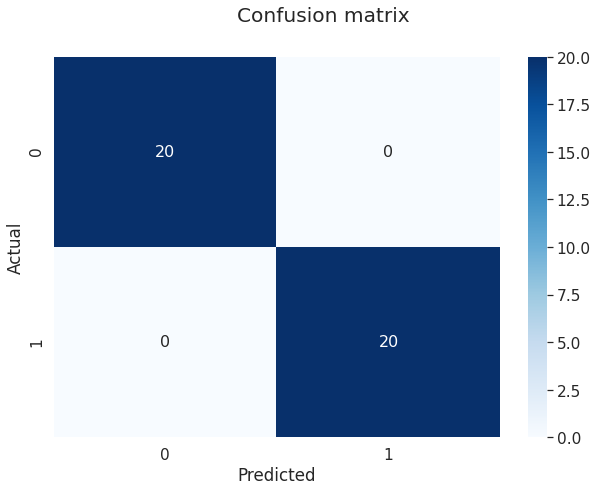

In [ ]:
def plot_training_metrics(history):
  # show training history and accuracy
  plt.plot(history.history['accuracy'])
  plt.plot(history.history['val_accuracy'])
  plt.title('Training Accuracy')
  plt.ylabel('accuracy')
  plt.xlabel('epoch')
  plt.legend(['train', 'val'], loc='upper left')
  plt.show()

  plt.plot(history.history['loss'])
  plt.plot(history.history['val_loss'])
  plt.title('Training Loss')
  plt.ylabel('loss')
  plt.xlabel('epoch')
  plt.legend(['train', 'val'], loc='upper left')
  plt.show()

def plot_cf_and_classification(y_test, y_pred):
  # display confusion matrix and classification report
  df_cm = pd.DataFrame(confusion_matrix(y_test, y_pred), index = ['0','1'], columns = ['0','1'])
  df_cm.index.name = 'Actual'
  df_cm.columns.name = 'Predicted'
  plt.figure(figsize = (10,7))
  plt.suptitle("Confusion matrix")
  sns.set(font_scale=1.4) #for label size
  sns.heatmap(df_cm, cmap="Blues", annot=True, annot_kws={"size": 16}) # font size

  target_names = ['0', '1']
  print(classification_report(y_test, y_pred))

# load 100 COVID images and normal images (preprocessed)
data = pickle.load(open("preprocessed_data.pkl", "rb"))
X = data['X_train']
y = data['y_train']
X = np.repeat(X, 3, -1) # convert to 3-channel
# split data into 80% train and 20% test
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20, stratify=y, shuffle=True)

# load ResNet50 model with imagenet weight and remove last fully connected layer (include_top = False)
model = ResNet50(weights = 'imagenet', include_top=False, input_tensor=Input(shape=(128, 128, 3)))
model.summary()
# freeze whole pretrained model
for layer in model.layers:
  layer.trainable = False
last_layer = model.layers[-1].output  # get last layer from ResNet
# add two new trainable layers
new_layer = Flatten()(last_layer)
new_layer = Dense(1024, activation='relu')(new_layer)
new_layer = Dropout(0.2)(new_layer)
new_layer = Dense(1, activation='sigmoid')(new_layer)
# build and compile model
new_model = Model(model.input, new_layer)
new_model.compile(optimizer=Adam(lr=0.0002), loss='binary_crossentropy', metrics=['accuracy'])

# train new model
epochs = 20
batch_size = 16
callback = EarlyStopping(monitor='loss', patience=3)
history = new_model.fit(X_train, y_train, epochs=epochs, batch_size=batch_size, callbacks=[callback], verbose=1, validation_split=0.1)
plot_training_metrics(history) # show training and validation scores

# evaluate new model
y_pred = new_model.predict(X_test)
y_pred = [1 * (x[0]>=0.5) for x in y_pred]
plot_cf_and_classification(y_test, y_pred)

## Subtask 2.2 - Repeat with 50 generated images

Model: "resnet50"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_12 (InputLayer)           [(None, 128, 128, 3) 0                                            
__________________________________________________________________________________________________
conv1_pad (ZeroPadding2D)       (None, 134, 134, 3)  0           input_12[0][0]                   
__________________________________________________________________________________________________
conv1_conv (Conv2D)             (None, 64, 64, 64)   9472        conv1_pad[0][0]                  
__________________________________________________________________________________________________
conv1_bn (BatchNormalization)   (None, 64, 64, 64)   256         conv1_conv[0][0]                 
___________________________________________________________________________________________

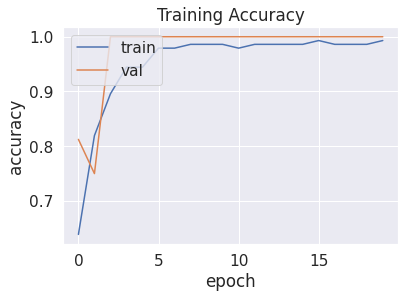

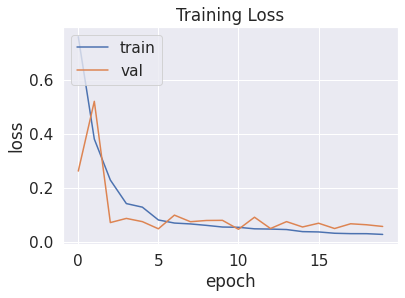

              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00        20
         1.0       1.00      1.00      1.00        20

    accuracy                           1.00        40
   macro avg       1.00      1.00      1.00        40
weighted avg       1.00      1.00      1.00        40



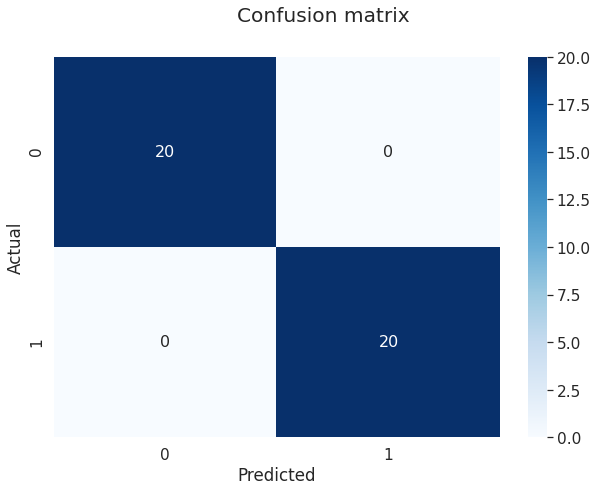

In [ ]:
# load 100 COVID images and normal images (preprocessed)
data = pickle.load(open("preprocessed_data.pkl", "rb"))
X = data['X_train']
y = data['y_train']

# ---------- select 50 random COVID images from X ----------
X_normal_only = [x for i, x in enumerate(X) if y[i] == 0]
X_covid_only = [x for i, x in enumerate(X) if y[i] == 1]
X_half_covid_only = random.sample(X_covid_only, 50) # randomly select 50 COVID images

# ---------- generate 50 random COVID images ---------------
model_name = 'final_model'
model = load_model('models/'+model_name+'.h5')
# generate random noise + labels
noise = np.random.normal(0, 1, (50, 100))
labels = np.ones((50, 1)) # only covid labels
# generate 50 random COVID images
gen_imgs = model.predict([noise, labels])

# combine 50 + 50 COVID images and add to 100 normal images and set appropriate labels
X_covid_only = np.concatenate((X_half_covid_only, gen_imgs))
X = np.concatenate((X_normal_only, X_covid_only))
y = np.concatenate((np.zeros(100), np.ones(100)))

# ------------------------------------------------------------
# --------------- (SAME AS BEFORE) ---------------------------
# ------------------------------------------------------------
X = np.repeat(X, 3, -1) # convert to 3-channel
# split data into 80% train and 20% test
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20, stratify=y, shuffle=True)

# load ResNet50 model with imagenet weight and remove last fully connected layer (include_top = False)
model = ResNet50(weights = 'imagenet', include_top=False, input_tensor=Input(shape=(128, 128, 3)))
model.summary()
# freeze whole pretrained model
for layer in model.layers:
  layer.trainable = False
last_layer = model.layers[-1].output  # get last layer from ResNet
# add two new trainable layers
new_layer = Flatten()(last_layer)
new_layer = Dense(1024, activation='relu')(new_layer)
new_layer = Dropout(0.2)(new_layer)
new_layer = Dense(1, activation='sigmoid')(new_layer)
# build and compile model
new_model = Model(model.input, new_layer)
new_model.compile(optimizer=Adam(lr=0.0002), loss='binary_crossentropy', metrics=['accuracy'])

# train new model
epochs = 20
batch_size = 16
callback = EarlyStopping(monitor='loss', patience=3)
history = new_model.fit(X_train, y_train, epochs=epochs, batch_size=batch_size, callbacks=[callback], verbose=1, validation_split=0.1)
plot_training_metrics(history) # show training and validation scores

# evaluate new model
y_pred = new_model.predict(X_test)
y_pred = [1 * (x[0]>=0.5) for x in y_pred]
plot_cf_and_classification(y_test, y_pred)